In [ ]:
# in this notebook, I will try to fit a model relating the mean behavior of L4, L2/3, SST and VIP cells

In [ ]:
# load the data

In [1]:
import pyute as ut
import autograd.numpy as np
import matplotlib.pyplot as plt
import sklearn
import h5py
import pdb
import scipy.optimize as sop
from mpl_toolkits.mplot3d import Axes3D
import sklearn.discriminant_analysis as skd
import autograd.scipy.special as ssp
from autograd import elementwise_grad as egrad
from autograd import grad
from autograd import jacobian
from autograd import hessian
import size_contrast_analysis as sca
import scipy.stats as sst
import sim_utils
from importlib import reload
reload(sim_utils)
import calnet.utils
import calnet.fitting_spatial_feature_opto
import opto_utils
import glob
import scipy.signal as ssi
%matplotlib notebook

/Users/dan/Documents/code/downloads/OASIS/oasis/functions.py:14: UserWarning: Could not find cvxpy. Don't worry, you can still use OASIS, just not the slower interior point methods we compared to in the papers.
  "just not the slower interior point methods we compared to in the papers.")


In [2]:
npfile = np.load('rs_vm_denoise_200605.npy',allow_pickle=True)[()]#,{'rs':rs,'rs_denoise':rs_denoise},allow_pickle=True)
rs = npfile['rs']
rs_denoise = npfile['rs_denoise']

In [3]:
nsize,ncontrast,ndir = 6,6,8
ori_dirs = [[0,4],[2,6]] #[[0,4],[1,3,5,7],[2,6]]
nT = len(ori_dirs)
nS = len(rs_denoise[0])

def sum_to_1(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nansum(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

def norm_to_mean(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nanmean(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

Rs = [[None,None] for i in range(len(rs))]
Rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]
rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]

for iR,r in enumerate(rs):#_denoise):
    print(iR)
    for ialign in range(nS):
        Rs[iR][ialign] = sum_to_1(r[ialign][:,:nsize,:])
#         Rs[iR][ialign] = von_mises_denoise(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir)))

kernel = np.ones((1,2,2))
kernel = kernel/kernel.sum()

for iR,r in enumerate(rs):
    for ialign in range(nS):
        for iori in range(nT):
            Rso[iR][ialign][iori] = np.nanmean(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir))[:,:,:,ori_dirs[iori]],-1)
            Rso[iR][ialign][iori][:,:,0] = np.nanmean(Rso[iR][ialign][iori][:,:,0],1)[:,np.newaxis]
            Rso[iR][ialign][iori][:,1:,1:] = ssi.convolve(Rso[iR][ialign][iori],kernel,'valid')
            Rso[iR][ialign][iori] = Rso[iR][ialign][iori].reshape(Rso[iR][ialign][iori].shape[0],-1)

0
1
2
3
4


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


In [17]:
nS = 2
nT = 2
ndims = 5
ncelltypes = 5
Yhat = [[None for iT in range(nT)] for iS in range(nS)]
Xhat = [[None for iT in range(nT)] for iS in range(nS)]
Ypc_list = [[None for iT in range(nT)] for iS in range(nS)]
Xpc_list = [[None for iT in range(nT)] for iS in range(nS)]
for iS in range(nS):
    mx = np.zeros((ncelltypes,))
    yy = [None for icelltype in range(ncelltypes)]
    for icelltype in range(ncelltypes):
        yy[icelltype] = np.nanmean(Rso[icelltype][iS][0],0)
        mx[icelltype] = np.nanmax(yy[icelltype])
    for iT in range(nT):
        y = [np.nanmean(Rso[icelltype][iS][iT]/mx[icelltype],axis=0)[:,np.newaxis] for icelltype in range(1,ncelltypes)]#
        Ypc_list[iS][iT] = [None for icelltype in range(1,ncelltypes)]
        for icelltype in range(1,ncelltypes):
            print((icelltype,iS,iT))
            rss = Rso[icelltype][iS][iT].copy() #.reshape(Rs[icelltype][ialign].shape[0],-1)
            rss = rss[np.isnan(rss).sum(1)==0]
    #         print(rss.max())
    #         rss[rss<0] = 0
    #         rss = rss[np.random.randn(rss.shape[0])>0]
            try:
                u,s,v = np.linalg.svd(rss-np.mean(rss,0)[np.newaxis])
                Ypc_list[iS][iT][icelltype-1] = [(s[idim],v[idim]) for idim in range(ndims)]
#                 print('yep on Y')
#                 print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
            except:
#                 print('nope on Y')
                print(np.mean(np.isnan(rss)))
                print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
        Yhat[iS][iT] = np.concatenate(y,axis=1)
#         x = sim_utils.columnize(Rso[0][iS][iT])[:,np.newaxis]
        icelltype = 0
        x = np.nanmean(Rso[icelltype][iS][iT]/mx[icelltype],0)[:,np.newaxis]#/mx[icelltype]
#         opto_column = np.concatenate((np.zeros((nN,)),np.zeros((nNO/2,)),np.ones((nNO/2,))),axis=0)[:,np.newaxis]
        Xhat[iS][iT] = np.concatenate((x,np.ones_like(x)),axis=1)
#         Xhat[iS][iT] = np.concatenate((x,np.ones_like(x),opto_column),axis=1)
        icelltype = 0
        rss = Rso[icelltype][iS][iT].copy()
        rss = rss[np.isnan(rss).sum(1)==0]
#         try:
        u,s,v = np.linalg.svd(rss-rss.mean(0)[np.newaxis])
        Xpc_list[iS][iT] = [None for iinput in range(2)]
        Xpc_list[iS][iT][0] = [(s[idim],v[idim]) for idim in range(ndims)]
        Xpc_list[iS][iT][1] = [(0,np.zeros((Xhat[0][0].shape[0],))) for idim in range(ndims)]
#         except:
#             print('nope on X')
#             print(np.mean(np.isnan(rss)))
#             print(np.min(np.sum(Rso[icelltype][iS][iT],axis=1)))
nN,nP = Xhat[0][0].shape
nQ = Yhat[0][0].shape[1]

(1, 0, 0)
(2, 0, 0)
(3, 0, 0)
(4, 0, 0)
(1, 0, 1)
(2, 0, 1)
(3, 0, 1)
(4, 0, 1)
(1, 1, 0)
(2, 1, 0)
(3, 1, 0)
(4, 1, 0)
(1, 1, 1)
(2, 1, 1)
(3, 1, 1)
(4, 1, 1)


In [4]:
def compute_f_(Eta,Xi,s02):
    return sim_utils.f_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))

def compute_fprime_m_(Eta,Xi,s02):
    return sim_utils.fprime_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))*Xi

def compute_fprime_s_(Eta,Xi,s02):
    s2 = Xi**2+np.concatenate((s02,s02),axis=0)
    return sim_utils.fprime_s_miller_troyer(Eta,s2)*(Xi/s2)

def sorted_r_eigs(w):
    drW,prW = np.linalg.eig(w)
    srtinds = np.argsort(drW)
    return drW[srtinds],prW[:,srtinds]

# def gen_Weight(W,K,kappa):
#     WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
#     WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
#     WW = np.concatenate((WW0,WW1),axis=0)
#     return WW

def u_fn(XX,YY,Wx,Wy,k,kappa):
    WWx,WWy = [gen_Weight(W,k,kappa) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def compute_steady_state(Wlist,Niter=int(4e2),max_val=2.5,Ny=50,fix_dim=None,stim_vals=None,dt=1e-2,perturbation_size=5e-2):
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wlist
    nQ = Wmy.shape[0]
    nN = Eta.shape[0]
    nS = int(Eta.shape[1]/nQ)
    
    if fix_dim is None:
        fix_dim = [None]
        Nfix = 1
        yvals = (0,)
        Ny = 1
        max_val = 0
    else:
        Nfix = len(fix_dim)
        yvals = np.linspace(0,max_val,Ny)
    
    if stim_vals is None:
        stim_vals = np.arange(nN)
    Nstim = len(stim_vals)
    
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    
    def fY(XX,YY):
        return compute_f_(resEta[stim_val]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[stim_val]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY_fix_dim(XX,YY0,fix_dim=None,run_backward=False,):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0 #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = dt*dYYdt(YY[iiter])
            if not fix_dim is None:
                dYY[fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_ss = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ifix in range(Nfix):
                yy0 = YY0[stim_val] + perturbation_size*np.random.randn(*(YY0[stim_val].shape))
                if not fix_dim[ifix] is None:
                    yy0[fix_dim[ifix]] = yval
                YY_ss[ifix,istim,iy] = predict_YY_fix_dim(XX[stim_val],yy0,fix_dim=fix_dim[ifix])
    if fix_dim[0] is None:
        YY_ss = YY_ss[0,:,0,:,:]
    return YY_ss

In [5]:
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_halo_data_for_sim.npy',allow_pickle=True)[()]
Yhat_opto = npyfile['Yhat_opto']

In [6]:
Yhat_opto.shape

(72, 16)

<IPython.core.display.Javascript object>


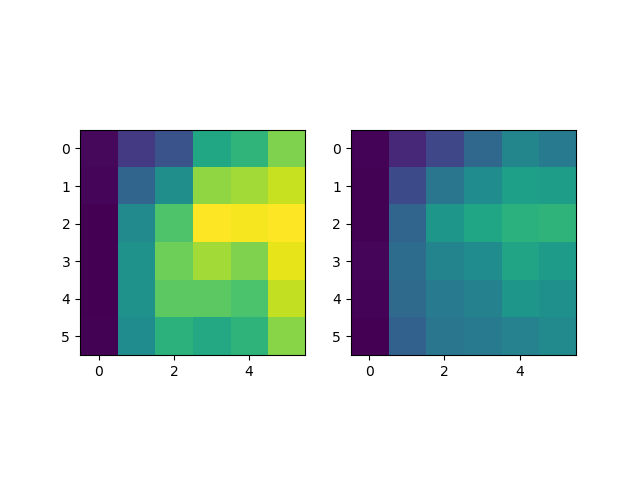

<IPython.core.display.Javascript object>


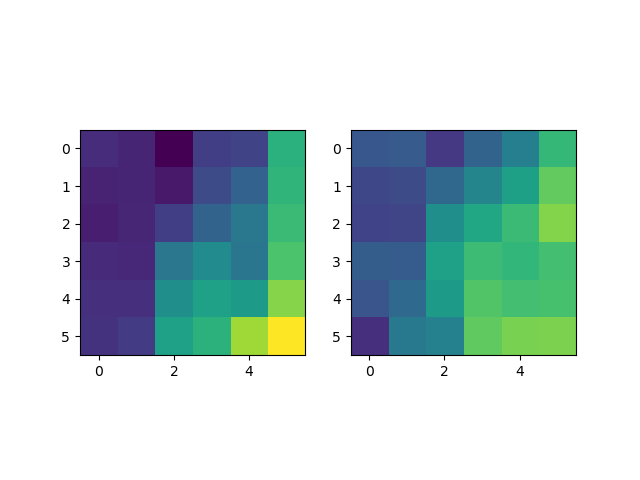

<IPython.core.display.Javascript object>


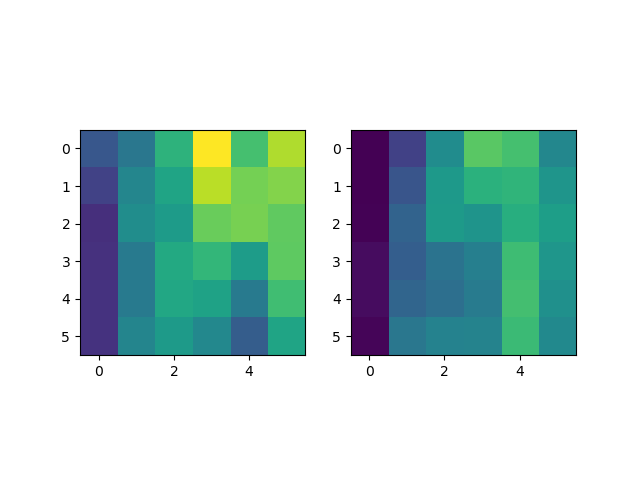

<IPython.core.display.Javascript object>


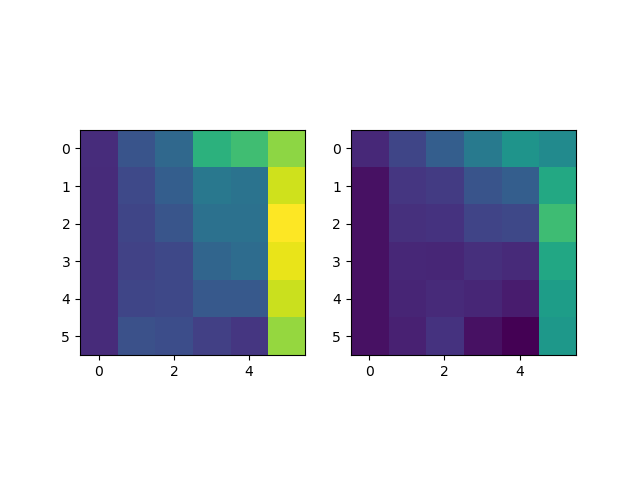

In [7]:
for itype in range(4):
    data = Yhat_opto.reshape((6,6,2,16))[:,:,:,itype]
    plt.figure()
    for ilight in range(2):
        plt.subplot(1,2,ilight+1)
        plt.imshow(data[:,:,ilight],vmin=data.min(),vmax=data.max())

In [ ]:
YYhat = calnet.fitting_spatial_feature_opto.flatten_nested_list_of_2d_arrays(Yhat)
XXhat = calnet.fitting_spatial_feature_opto.flatten_nested_list_of_2d_arrays(Xhat)

In [10]:
    def gen_Weight(W,K,kappa,T):
        MuT = np.array((1,2,1))
        MuK = np.array((1,kappa))
        WT = circulate(W,T,nT,Mu=MuT)
        KKlist = [K for iT in range(nT)]
        KK = np.concatenate(KKlist,axis=0)
        WW = circulate(WT,KK,nS,Mu=MuK)
        return WW

In [11]:
    def circulate(V,M,nZ,Mu=None):
        Vpartlist = [V*(M[np.newaxis,:]**np.abs(iZ)) for iZ in range(-nZ+1,nZ)]
        if Mu is None:
            Mu = np.ones((nZ,))
        #VVlist = [np.concatenate([m*v for m,v in zip(Mu,Vpartlist[nZ-iZ-1:2*nZ-iZ-1])],axis=1) for iZ in range(nZ)]
        VVlist = [np.concatenate(Vpartlist[nZ-iZ-1:2*nZ-iZ-1],axis=1) for iZ in range(nZ)]
        #VV = np.concatenate(VVlist,axis=0)
        VV = np.concatenate([m*v for m,v in zip(Mu,VVlist)],axis=0)
        return VV

In [15]:
lkat = (losses < 40)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in less
  """Entry point for launching an IPython kernel.


In [16]:
# trystars_i,trystars_j = [0],[0]
# itry = 0
# Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi,h = Wt[trystars_i[itry]][trystars_j[itry]]
# Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list']
# def gen_Weight(W,K,kappa):
#     WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
#     WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
#     WW = np.concatenate((WW0,WW1),axis=0)
#     return WW

def u_fn(XX,YY,Wx,Wy,k,kappa,T):
    WWx,WWy = [gen_Weight(W,k,kappa,T) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def colorful_scatter(a,b):
    for icelltype in range(ncelltypes-1):
        plt.scatter(a[:,icelltype],b[:,icelltype],s=10)

for weights_file in weights_files:
    plt.close('all')
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    
    weights_filename = weights_file.split('/')[-1][:-4]

    XXhat = np.concatenate([np.concatenate(x,axis=1) for x in Xhat],axis=1)
    YYhat = np.concatenate([np.concatenate(x,axis=1) for x in Yhat],axis=1)
    YY = compute_f_(Eta,Xi,s02)
    Etastar = u_fn(XX,YY,Wmx,Wmy,K,kappa,T)
    Xistar = u_fn(XX,YY,Wsx,Wsy,K,kappa,T)
    YYstar = compute_f_(Etastar,Xistar,s02)
    nrows = 3
    ncols = 2
    plt.figure(1,figsize=(2*ncols,2*nrows))
    plt.subplot(nrows,ncols,1)
    colorful_scatter(YYhat,YY)
    plt.xlabel('Measured Y')
    plt.ylabel('Modeled Y')
    plt.plot((0,1),(0,1),c='k')
    plt.subplot(nrows,ncols,2)
    plt.scatter(XXhat,XX,s=10)
    plt.xlabel('Measured X')
    plt.ylabel('Modeled X')
    plt.plot((0,1),(0,1),c='k')
    plt.subplot(nrows,ncols,3)
    colorful_scatter(Eta,Etastar)
    plt.xlabel('Modeled input current')
    plt.ylabel('Self-consistent input current')
    lim = np.max(np.abs(Etastar))
    plt.plot((-lim,lim),(-lim,lim),c='k')
    plt.subplot(nrows,ncols,4)
    colorful_scatter(Xi,Xistar)
    plt.xlabel('Modeled input current var')
    plt.ylabel('Self-consistent input current var')
    lim = np.max(np.abs(Xistar))
    plt.plot((-lim,lim),(-lim,lim),c='k')
    plt.subplot(nrows,ncols,5)
    colorful_scatter(YY,YYstar)
    plt.xlabel('Modeled Y')
    plt.ylabel('Self-consistent Y')
    plt.plot((0,1),(0,1),c='k')
    plt.subplot(nrows,ncols,6)
    colorful_scatter(YYhat,YYstar)
    plt.xlabel('Measured Y')
    plt.ylabel('Self-consistent Y')
    plt.plot((0,1),(0,1),c='k')
    plt.tight_layout()
#     plt.savefig(plots_fold+weights_filename+'.jpg',dpi=300)

NameError: name 'Xhat' is not defined

In [22]:
basefold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'

# subfold = 'weights_200901i/'
# plots_fold = basefold + 'fit_graphics/' + subfold
# ut.mkdir(plots_fold)
# weights_fold = basefold + 'weights/' + subfold
# weights_files = glob.glob(weights_fold+'*.npy')

# subfold = 'weights_200902e/'
# plots_fold = basefold + 'fit_graphics/' + subfold
# ut.mkdir(plots_fold)
# weights_fold = basefold + 'weights/' + subfold
# weights_files = weights_files + glob.glob(weights_fold+'*.npy')

subfold = 'weights_201026a/'
plots_fold = basefold + 'fit_graphics/' + subfold
ut.mkdir(plots_fold)
weights_fold = basefold + 'weights/' + subfold
weights_files = glob.glob(weights_fold+'*.npy')

weights_files.sort()
# # weights_filenames = [s.split('/')[-1][:-4] for s in weights_files]


In [23]:
nfiles = len(weights_files)
Ts = np.zeros((nfiles,nQ))
Ks = np.zeros((nfiles,nQ))
Wmys = np.zeros((nfiles,nQ,nQ))
Wmxs = np.zeros((nfiles,nP,nQ))
Wsys = np.zeros((nfiles,nQ,nQ))
Wsxs = np.zeros((nfiles,nP,nQ))
s02s = np.zeros((nfiles,nQ))
YYs = np.zeros((nfiles,6,6,nQ*nS*nT))
XXs = np.zeros((nfiles,6,6,nP*nS*nT))
couplings = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
# couplings with phiPV = phiPC fixed
couplings_pcpv = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
Xcouplings = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
phis = np.zeros((nfiles,6,6,nQ*nS*nT))
losses = np.zeros((nfiles,))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    losses[iwt] = Wstar_dict['loss']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
    tiled_s02 = np.tile(s02,nS*nT)
    Ts[iwt] = T
    Ks[iwt] = K
    Wmys[iwt] = Wmy
    Wmxs[iwt] = Wmx
    Wsys[iwt] = Wsy
    Wsxs[iwt] = Wsx
    s02s[iwt] = s02
    YYs[iwt] = sim_utils.f_miller_troyer(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT))
    XXs[iwt] = XX.reshape((6,6,nP*nS*nT))
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        phis[iwt,iistim,jjstim] = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
        phipcpv = phis[iwt,iistim,jjstim].copy()
        phipcpv[3::4] = phipcpv[0::4]
        Phi = np.diag(phis[iwt,iistim,jjstim])
        Phipcpv = np.diag(phipcpv)
        couplings[iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
        Xcouplings[iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
        couplings_pcpv[iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
# couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))


In [24]:
lkat = losses < 30


In [25]:
Wpcpc = np.zeros((len(weights_files),nsize,ncontrast))
max_eig = np.zeros((len(weights_files),nsize,ncontrast))
min_eig = np.zeros((len(weights_files),nsize,ncontrast))
vs = np.zeros((len(weights_files),nsize,ncontrast,8,8))
pcpvinds = [0,3,4,7,8,11,12,15]
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
    tiled_s02 = np.tile(s02,nS*nT)
#     plt.figure()
    Weff = np.zeros((nsize,ncontrast,8,8))
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
        Weff[iistim,jjstim] = WWmy[pcpvinds][:,pcpvinds] @ Phi[pcpvinds][:,pcpvinds]
        Wpcpc[iwt,iistim,jjstim] = Wmy[0,0] * Phi[0,0]
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(nsize,ncontrast))
#         plt.subplot(nsize,ncontrast,istim+1)
#         plt.imshow(Weff[iistim,jjstim],vmin=Weff.min(),vmax=Weff.max())
        w,v = np.linalg.eig(Weff[iistim,jjstim].T)
        vs[iwt,iistim,jjstim] = v[:,np.argsort(w)]
        max_eig[iwt,iistim,jjstim] = np.max(w)
        min_eig[iwt,iistim,jjstim] = np.min(w)
    # plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:23: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:24: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: ComplexWarning: Casting complex values to real discards the imaginary part


In [26]:
nsize,ncontrast = 6,6

<IPython.core.display.Javascript object>


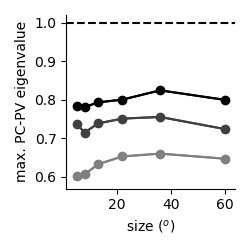

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8142565808563352


In [28]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,max_eig[lkat][:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_l23)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('max. PC-PV eigenvalue')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/pc_pv_stability_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


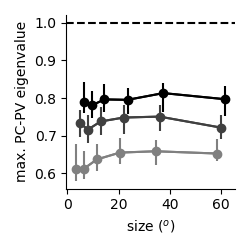

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [29]:
reload(ut)
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_pct_errorbars_hillel(usize,max_eig[lkat][:,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),colors=c_l23,delta=1)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('max. PC-PV eigenvalue')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/pc_pv_stability_size_by_3_contrasts_distribution.eps')

In [30]:
nfiles = len(weights_files)
# couplings with one of the phi's fixed, phiI = mean(phiI)
couplings_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
Xcouplings_fixed = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT,nQ))
# couplings with phiPC = mean(phiPC) and phiPV = mean(phiPV) fixed
couplings_pcpv_rec_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_fixed_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
    tiled_s02 = np.tile(s02,nS*nT)
    all_phis = calnet.utils.fprime_miller_troyer(Eta,Xi**2+tiled_s02)
    for icelltype in range(nQ):
        mean_phi = np.mean(all_phis[:,icelltype::nQ])
        for istim in range(nN):
            iistim,jjstim = np.unravel_index(istim,(6,6))        
            these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            couplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            Xcouplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
    mean_phi_pc = np.mean(all_phis[:,0::nQ])
    mean_phi_pv = np.mean(all_phis[:,3::nQ])
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))        
        these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
        
        Phi = np.diag(these_phis)
        Phirec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
        Phirec[0::nQ][:,0::nQ] = mean_phi_pc
        Phirec[3::nQ][:,0::nQ] = mean_phi_pc
        Phirec[0::nQ][:,3::nQ] = mean_phi_pv
        Phirec[3::nQ][:,3::nQ] = mean_phi_pv
        couplings_pcpv_rec_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phirec)
#         if (iwt==0) & (istim==35):
#             plt.figure()
#             plt.imshow(Phirec)
#             print(Phirec[list(np.arange(0,nQ*nS*nT,nQ))+list(np.arange(3,nQ*nS*nT,nQ))][:,0::nQ])
        
        these_phis[0::nQ] = mean_phi_pc
        these_phis[3::nQ] = mean_phi_pv
        Phi = np.diag(these_phis)
        couplings_pcpv_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
    for icelltype in range(nQ):
        for istim in range(nN):
            mean_phi = np.mean(all_phis[:,icelltype::nQ])
            iistim,jjstim = np.unravel_index(istim,(6,6))        
            these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            these_phis[0::nQ] = mean_phi_pc
            these_phis[3::nQ] = mean_phi_pv
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            couplings_pcpv_fixed_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

In [134]:
nfiles = len(weights_files)
# couplings with phiPC = phiPV fixed, and phiI = mean(phiI) fixed
couplings_pcpv_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
Xcouplings_pcpv_plus_fixed = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT,nQ))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
    tiled_s02 = np.tile(s02,nS*nT)
    for icelltype in range(nQ):
        all_phis = calnet.utils.fprime_miller_troyer(Eta,Xi**2+tiled_s02)
        mean_phi = np.mean(all_phis[:,icelltype::nQ])
        for istim in range(nN):
            iistim,jjstim = np.unravel_index(istim,(6,6))        
            these_phis = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            these_phis[3::nQ] = these_phis[0::nQ]
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            couplings_pcpv_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            Xcouplings_pcpv_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            couplings_pcpv_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

In [123]:
nfiles = len(weights_files)
couplings_no_wpcsst = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    Wmy[0,1] = 0.*Wmy[0,1]
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
    tiled_s02 = np.tile(s02,nS*nT)
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        these_phis = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
        Phi = np.diag(these_phis)
        couplings_no_wpcsst[iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
# couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))


<IPython.core.display.Javascript object>


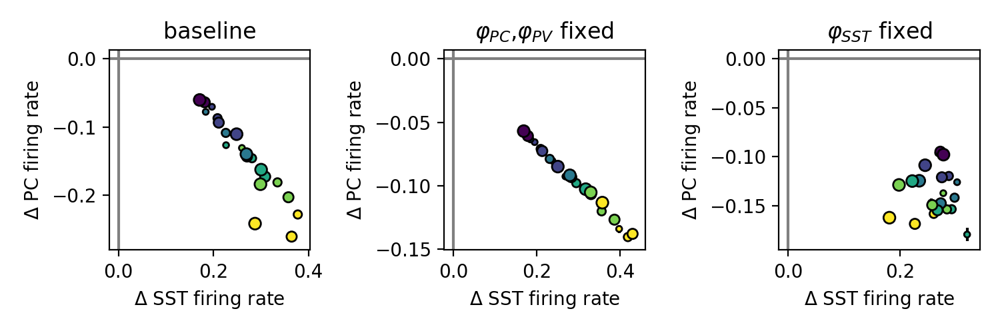

In [135]:
h = -1
sizes = [0,2,3,5]
xlim = (-0.1,0.6)
ylim = (-0.4,0.05)
rg = lkat # slice(None)

plt.figure(figsize=(7.5,2.5))
plt.subplot(1,3,1)
plt.title('baseline')
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings[rg,:,:,2,1]
ydata = h*couplings[rg,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
# plt.xlim(xlim)
# plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

plt.subplot(1,3,2)
plt.title(r'$\varphi_{PC}$,$\varphi_{PV}$ fixed')
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_pcpv_fixed[rg,:,:,2,1]
ydata = h*couplings_pcpv_fixed[rg,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
# plt.ylim(-3,1)
# plt.xlim(-1,3)
# plt.xlim(xlim)
# plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

plt.subplot(1,3,3)
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_fixed[rg,:,:,2,1,1]
ydata = h*couplings_fixed[rg,:,:,2,0,1]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
# plt.ylim(-3,1)
# plt.xlim(-1,3)
plt.title(r'$\varphi_{SST}$ fixed')
# plt.xlim(xlim)
# plt.ylim(ylim)
plt.tight_layout()


<IPython.core.display.Javascript object>


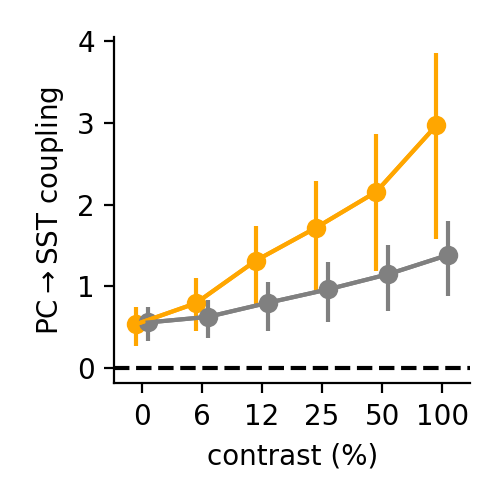

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


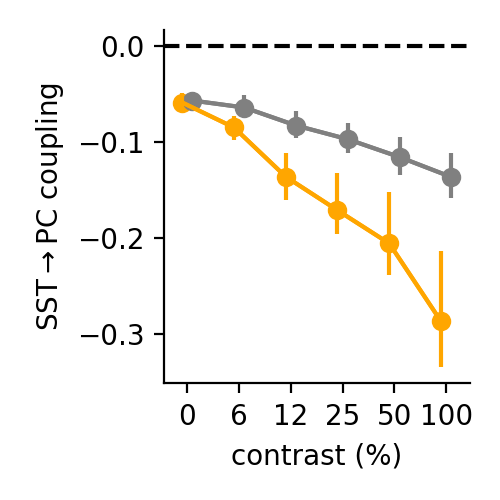

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


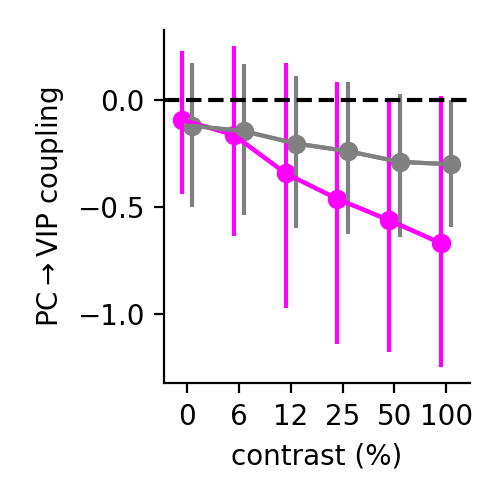

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


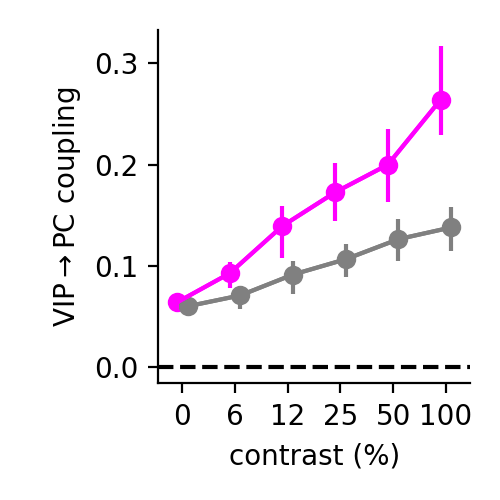

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [136]:
isize = 3

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

delta = 0.1

lbls = ['PC','SST','VIP','PV']

ijs = [[0,1],[1,0],[0,2],[2,0]]
these_colors = [[np.array((1,0.65,0))[np.newaxis],np.array((0.5,0.5,0.5))[np.newaxis]] for iij in range(2)]
these_colors = these_colors + [[np.array((1,0,1))[np.newaxis],np.array((0.5,0.5,0.5))[np.newaxis]] for iij in range(2)]

for iij,ij in enumerate(ijs):
    i,j = ij
    
    ylabel = r'%s$\rightarrow$%s coupling'%(lbls[i],lbls[j])

    plt.figure(figsize=(2.5,2.5))
    # plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
    ut.plot_pct_errorbars_hillel(np.arange(6)-delta,couplings[lkat,isize,np.newaxis,:,i,j],pct=(16,84),colors=these_colors[iij][0])
    # ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
    ut.plot_pct_errorbars_hillel(np.arange(6)+delta,couplings_pcpv_fixed[lkat,isize,np.newaxis,:,i,j],pct=(16,84),colors=these_colors[iij][1])
#     ut.plot_pct_errorbars_hillel(np.arange(6),couplings_pcpv_rec_fixed[lkat,isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
    # ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed_plus_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])

    plt.xticks(np.arange(6),[0,6,12,25,50,100])
    plt.xlabel('contrast (%)')
    plt.ylabel(ylabel)
    ut.erase_top_right()
    # plt.legend(['baseline','SST fixed','PC/PV fixed','both fixed','PC & PV fixed'])
    plt.tight_layout()
    plt.axhline(0,c='k',linestyle='dashed')
#     plt.savefig('figures/%s_%s_coupling_pcpv_fixed.eps'%(lbls[i],lbls[j]))

<IPython.core.display.Javascript object>


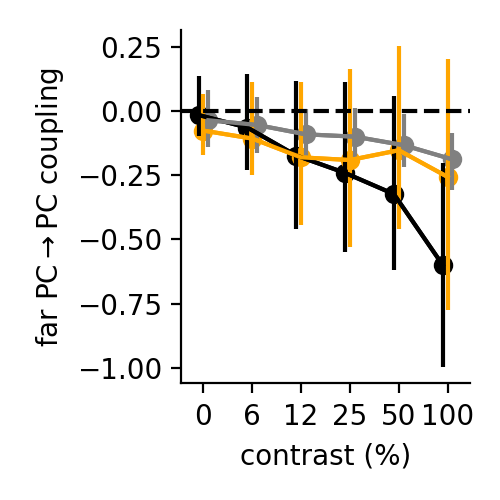

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [102]:
reload(ut)
isize = 3

delta = 0.1

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
ut.plot_pct_errorbars_hillel(np.arange(6)-delta,couplings[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6),couplings_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6)+delta,couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed_plus_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])

plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xlabel('contrast (%)')
plt.ylabel(r'far PC$\rightarrow$PC coupling')
plt.axhline(0,c='k',linestyle='dashed')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed','PC/PV fixed','both fixed','PC & PV fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_pcpv_fixed_distribution.eps')

In [137]:
losses[lkat]

array([28.31454105, 29.29096287, 27.89764502, 28.43889206, 27.69499258,
       29.48231781, 28.66134645, 26.97431266, 27.62446913, 27.3992333 ,
       28.14590555, 27.97791471, 29.53545488, 28.39063198, 28.97908431,
       28.38384877, 29.78857138, 27.80834686, 29.99335727, 29.9908888 ,
       28.07272727, 29.15306046, 28.49549062, 27.92285252, 29.42991243,
       27.21144453, 29.58158129, 29.2822623 , 28.69061426, 29.29737955,
       28.06466789, 29.75691235, 28.01715008, 27.24404625, 28.30991808,
       28.47529597, 27.68208151, 29.13717373, 28.31007039, 27.68254861,
       29.24178074, 27.09286864, 27.89446665, 28.4168166 , 29.73686636,
       28.13696093, 29.94242118, 29.62756942, 28.01332098, 28.90748583,
       29.44976632, 27.38880254, 28.64211712, 29.51025321, 28.33972861,
       27.80480176, 29.42260265, 29.00392777, 29.30470832, 27.64675202])

<IPython.core.display.Javascript object>


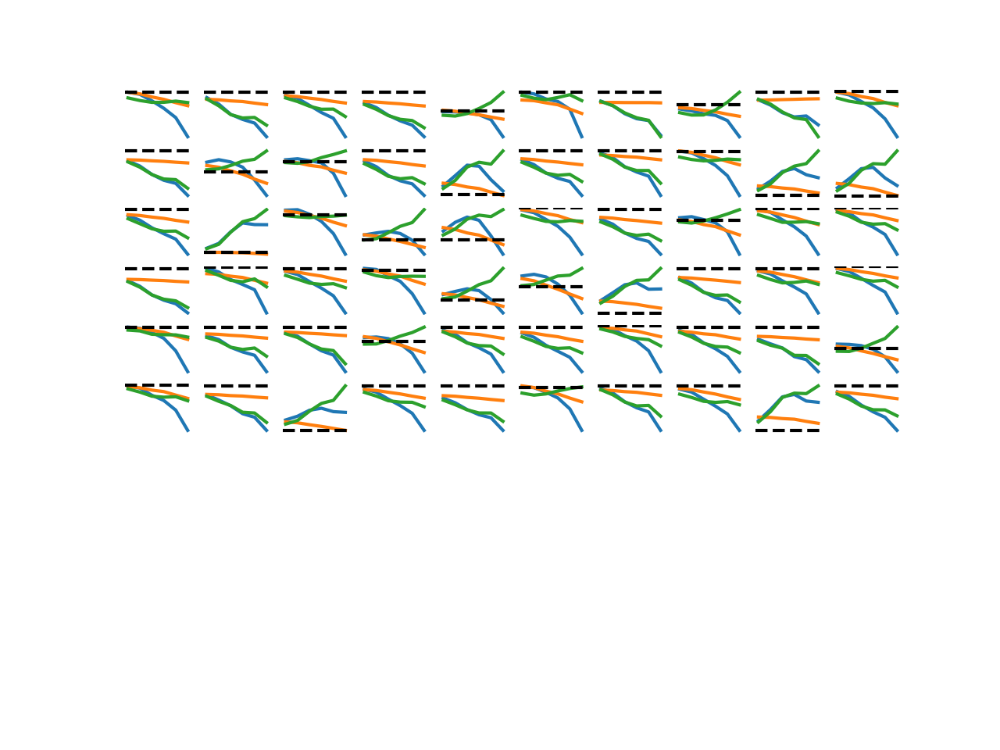

In [138]:
plt.close('all')
plt.figure()
i,j = 8,0
for imodel in range(np.minimum(lkat.sum(),100)):
#     plt.figure(figsize=(2.5,2.5))
    plt.subplot(10,10,imodel+1)
    plt.plot(np.arange(6),couplings[lkat,isize,:,i,j][imodel])
    plt.plot(np.arange(6),couplings_pcpv_fixed[lkat,isize,:,i,j][imodel])
    plt.plot(np.arange(6),couplings_fixed[lkat,isize,:,i,j,1][imodel])
#     plt.plot(np.arange(6),couplings_fixed[lkat,isize,:,4,0,2][imodel])
    plt.axhline(0,linestyle='dashed',c='k')
    plt.axis('off')
    

<IPython.core.display.Javascript object>


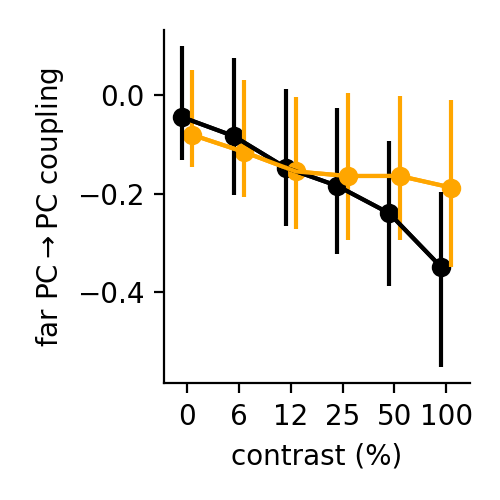

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [139]:
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()

from_arr = np.zeros((16,))
to_arr = np.zeros((16,))
from_arr[[8,12]] = 0.5
to_arr[[0,4]] = 0.5
these_couplings = from_arr @ couplings @ to_arr
these_couplings_sst_fixed = from_arr @ couplings_fixed[:,:,:,:,:,1] @ to_arr

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
isize = 3
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6)-0.1,these_couplings[lkat,isize,np.newaxis,:],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6)+0.1,these_couplings_sst_fixed[lkat,isize,np.newaxis,:],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])

plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xlabel('contrast (%)')
plt.ylabel(r'far PC$\rightarrow$PC coupling')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed.eps')

<IPython.core.display.Javascript object>


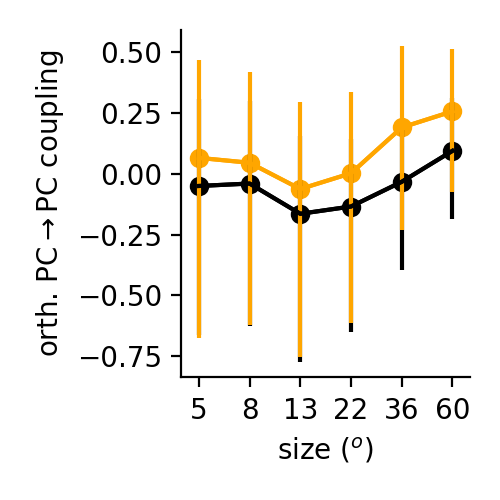

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [140]:
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()

from_arr = np.zeros((16,))
to_arr = np.zeros((16,))
from_arr[[4,12]] = 0.5
to_arr[[0,8]] = 0.5
these_couplings = from_arr @ couplings @ to_arr
these_couplings_sst_fixed = from_arr @ couplings_fixed[:,:,:,:,:,1] @ to_arr
# these_couplings_sst_fixed = from_arr @ couplings_pcpv[:,:,:,:,:] @ to_arr


plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
icontrast = 5
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings[lkat,np.newaxis,:,icontrast,4,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6),these_couplings[lkat,np.newaxis,:,icontrast],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_fixed[lkat,np.newaxis,:,icontrast,4,0,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6),these_couplings_sst_fixed[lkat,np.newaxis,:,icontrast],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])

plt.xticks(np.arange(6),usize)
plt.xlabel('size ($^o$)')
plt.ylabel(r'orth. PC$\rightarrow$PC coupling')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed.eps')

<IPython.core.display.Javascript object>


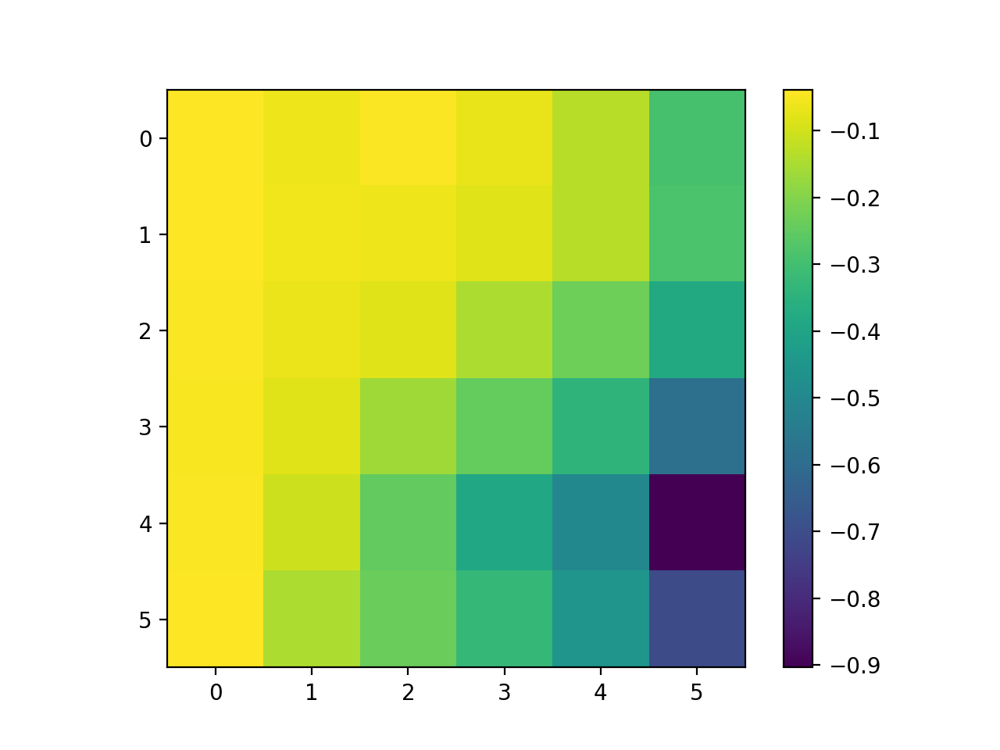

In [141]:
plt.figure()
plt.imshow(np.nanmean(couplings[lkat,:,:,8,0],0))
plt.colorbar()

In [573]:
couplings[lkat,:,icontrast,np.newaxis,4,0].shape

(80, 6, 1)

<IPython.core.display.Javascript object>


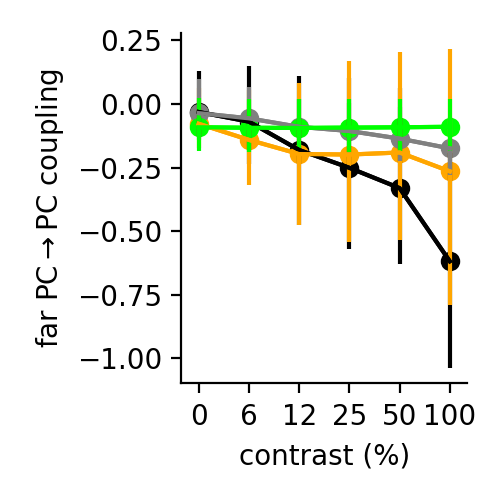

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

In [142]:
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
isize = 3
ut.plot_pct_errorbars_hillel(np.arange(6),couplings[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
ut.plot_pct_errorbars_hillel(np.arange(6),couplings_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])
ut.plot_pct_errorbars_hillel(np.arange(6),couplings_pcpv_fixed_plus_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])

plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xlabel('contrast (%)')
plt.ylabel(r'far PC$\rightarrow$PC coupling')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed','PC/PV fixed','both fixed','PC & PV fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed.eps')

<IPython.core.display.Javascript object>


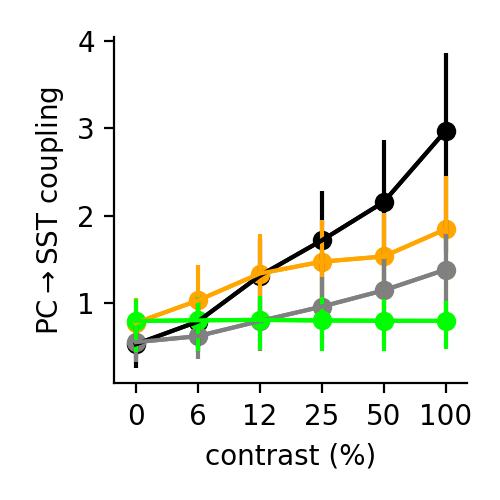

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


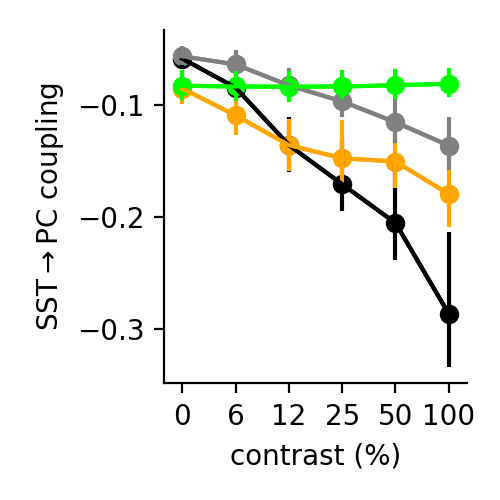

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


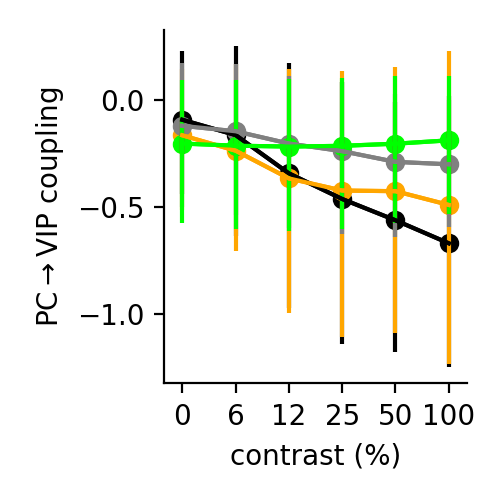

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


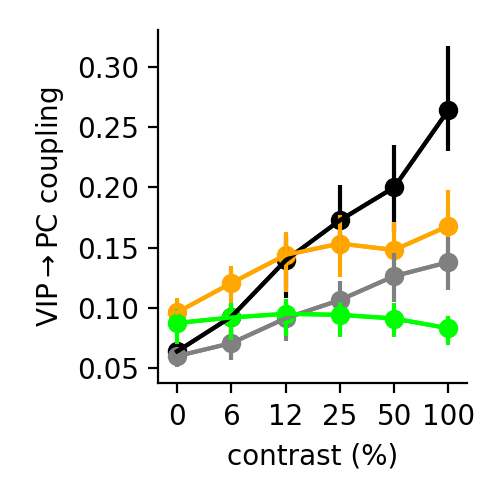

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

In [144]:
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()

i,j = 1,0

ind_pairs = [[0,1],[1,0],[0,2],[2,0]]
lbls = ['PC','SST','VIP']
ylabel_fmt = r'%s$\rightarrow$%s coupling'

for ind_pair in ind_pairs:
    i,j = ind_pair

    plt.figure(figsize=(2.5,2.5))
    isize = 3
    ut.plot_pct_errorbars_hillel(np.arange(6),couplings[lkat,isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
    ut.plot_pct_errorbars_hillel(np.arange(6),couplings_fixed[lkat,isize,np.newaxis,:,i,j,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
    ut.plot_pct_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])
    ut.plot_pct_errorbars_hillel(np.arange(6),couplings_pcpv_fixed_plus_fixed[lkat,isize,np.newaxis,:,i,j,1],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])

    plt.xticks(np.arange(6),[0,6,12,25,50,100])
    plt.xlabel('contrast (%)')
    plt.ylabel(ylabel_fmt%(lbls[i],lbls[j]))
    ut.erase_top_right()
    # plt.legend(['baseline','SST fixed','PC/PV fixed','both fixed','PC & PV fixed'])
    plt.tight_layout()
#     plt.savefig('figures/far_pc_coupling_sst_fixed.eps')

<IPython.core.display.Javascript object>


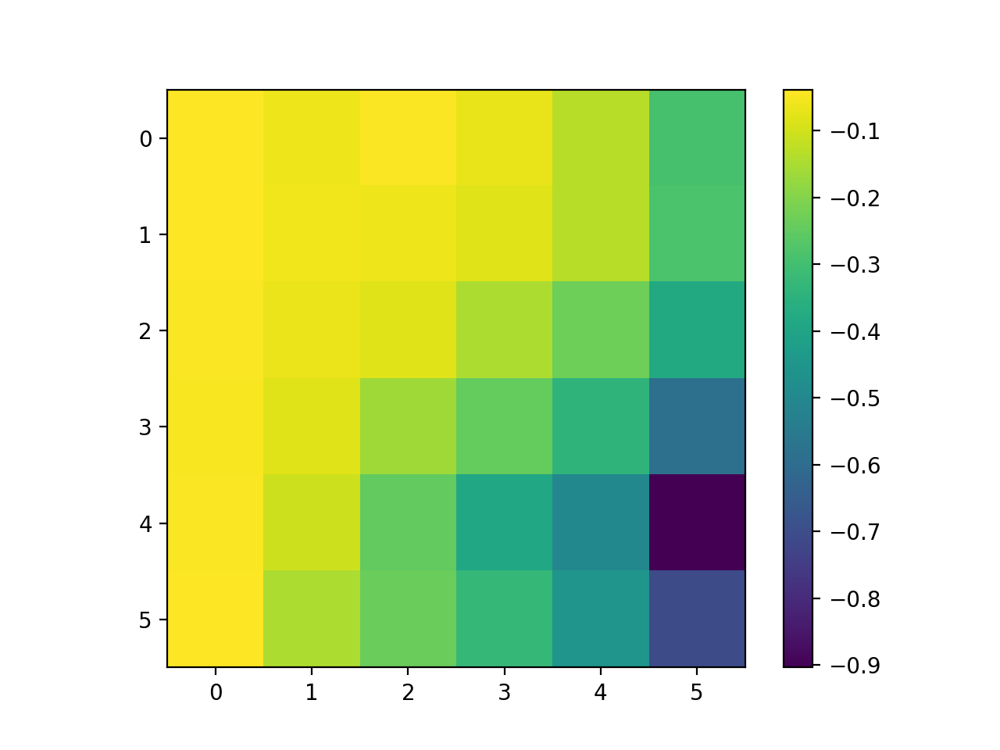

<IPython.core.display.Javascript object>


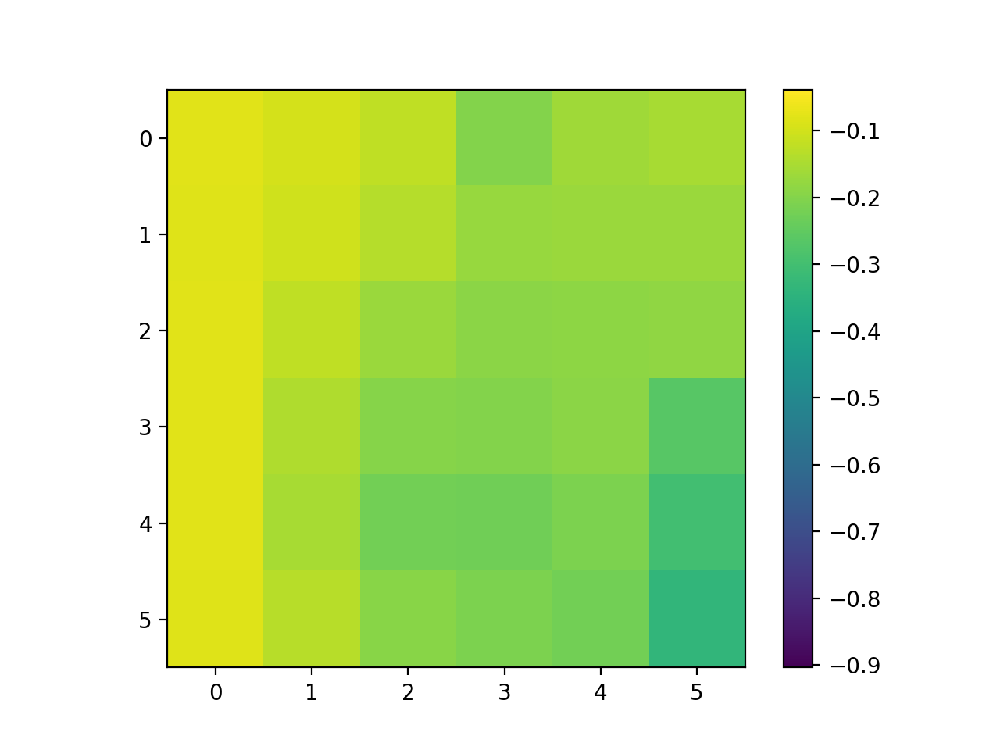

In [146]:
iwt = 1
data = np.mean(couplings[lkat,:,:,8,0],0)
plt.figure()
plt.imshow(data,vmin=data.min(),vmax=data.max())
plt.colorbar()
plt.figure()
plt.imshow(np.median(couplings_fixed[lkat,:,:,8,0,1],0),vmin=data.min(),vmax=data.max())
plt.colorbar()

In [147]:
plt.close('all')

<IPython.core.display.Javascript object>


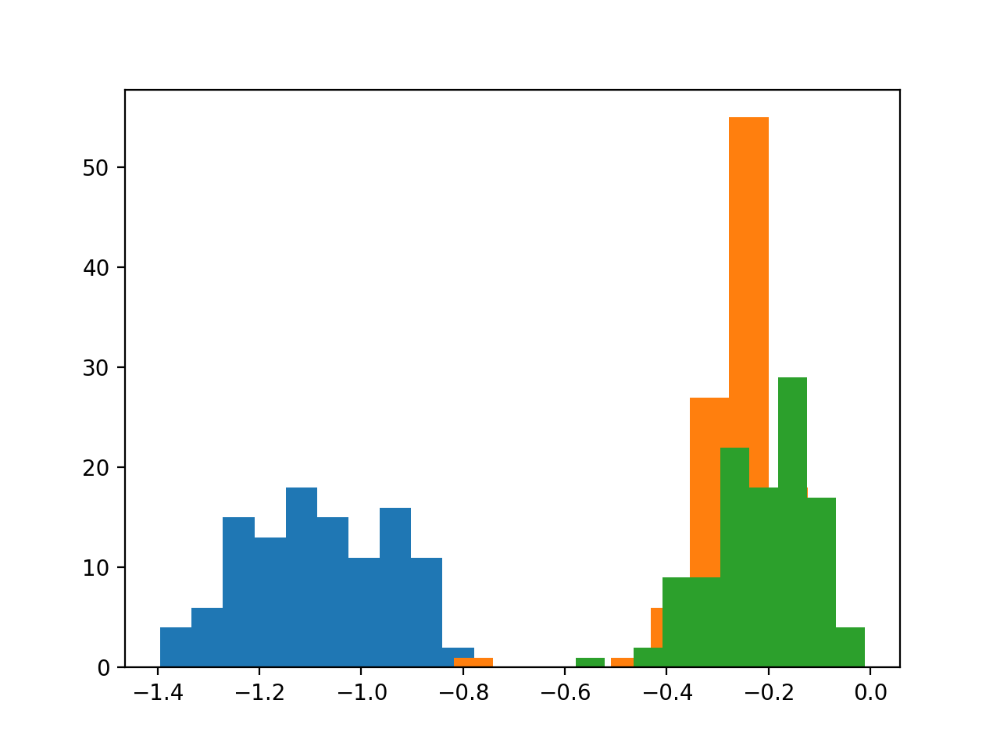

(array([ 1.,  0.,  2.,  9.,  9., 22., 18., 29., 17.,  4.]),
 array([-0.578552  , -0.52181214, -0.46507228, -0.40833242, -0.35159257,
        -0.29485271, -0.23811285, -0.181373  , -0.12463314, -0.06789328,
        -0.01115342]),
 <a list of 10 Patch objects>)

In [148]:
plt.figure()
plt.hist(Wmys[:,2,1])
plt.hist(Wmys[:,1,2])
plt.hist(Wmys[:,1,0])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


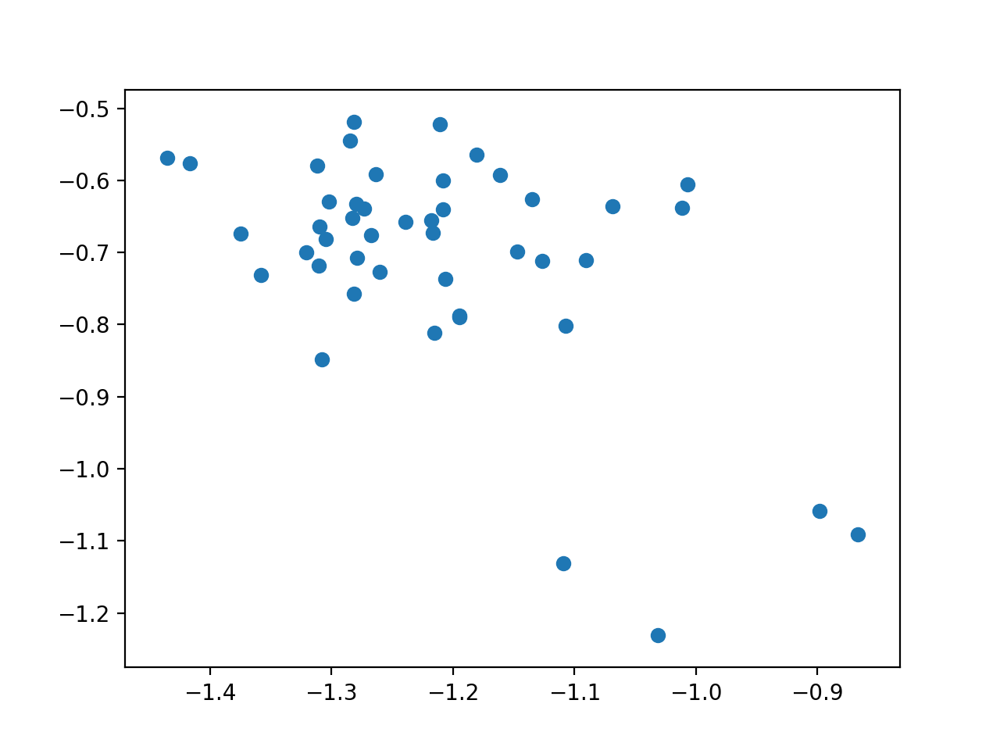

In [901]:
plt.figure()
plt.scatter(Wmys[:,2,1],Wmys[:,1,2])

In [149]:
def var_explained(x,y):
    return 1-np.mean((x-y)**2)/np.var(x)


In [150]:
lkat.sum()

60

In [151]:
c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

In [152]:
usize = np.array([5,8,13,22,36,60])
ucontrast = np.array([0,6,12,25,50,100])

In [153]:
data = YYhat.reshape(nsize,ncontrast,nQ*nS*nT)
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
    for iicontrast,icontrast in enumerate([1,3,5]):
        plt.plot(usize,data[:,icontrast,itype],c=colors[itype+1][iicontrast])#,c=colors[itype+1])
    plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    plt.tight_layout()
#     plt.savefig('figures/modeled_%s_size_tuning.eps'%lbls[itype])

NameError: name 'YYhat' is not defined

<IPython.core.display.Javascript object>


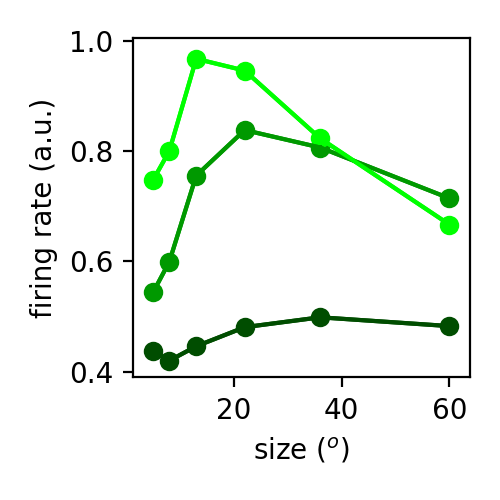

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9579628870235097


In [154]:
for itype in range(1):
    plt.figure(figsize=(2.5,2.5))
    ut.plot_bootstrapped_errorbars_hillel(usize,XXs[:,:,[1,3,5],itype].transpose((0,2,1)),colors=colors[0])
    plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    plt.tight_layout()
#     plt.savefig('figures/modeled_L4_size_tuning.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


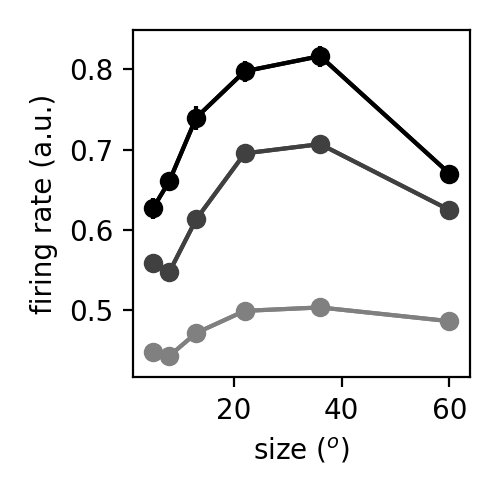

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8036821234838087


<IPython.core.display.Javascript object>


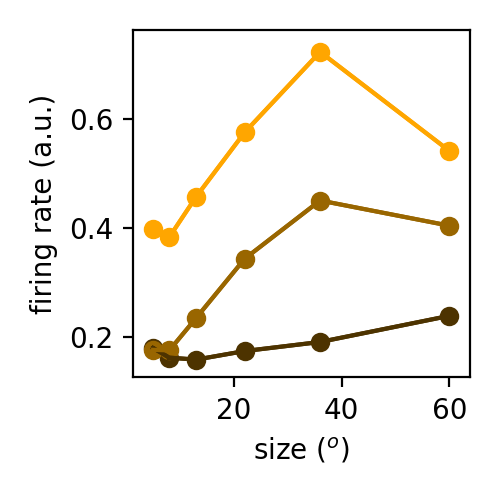

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7118884200572491


<IPython.core.display.Javascript object>


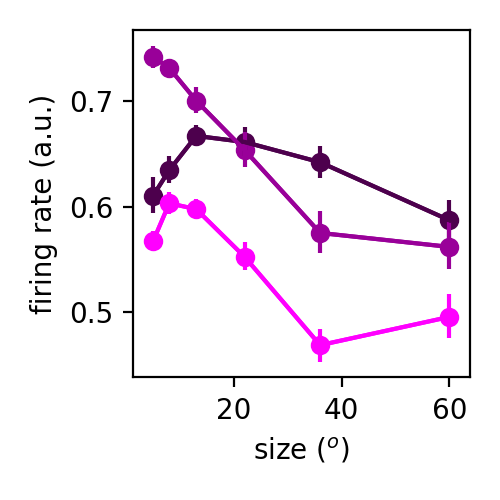

0.7320771593523092


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


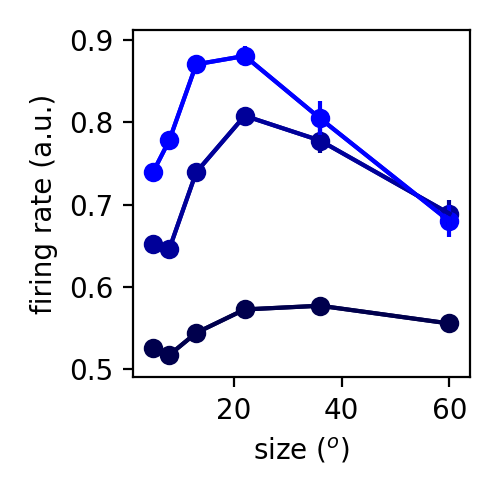

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8685429319128849


In [141]:
data = YYhat.reshape(nsize,ncontrast,nQ*nS*nT)
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
#     for iicontrast,icontrast in enumerate([1,3,5]):
#         plt.plot(usize,data[:,icontrast,itype],c=colors[itype+1][iicontrast])#,c=colors[itype+1])
    ut.plot_bootstrapped_errorbars_hillel(usize,YYs[:,:,[1,3,5],itype].transpose((0,2,1)),colors=colors[itype+1])
    plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    plt.tight_layout()
#     plt.savefig('figures/modeled_%s_size_tuning.eps'%lbls[itype])

In [155]:
(YYs.shape,lkat.shape)

((111, 6, 6, 16), (111,))

In [156]:
[these_datas[idata].shape for idata in range(2)]

NameError: name 'these_datas' is not defined

In [157]:
these_datas

NameError: name 'these_datas' is not defined

In [158]:
these_datas[0].shape

NameError: name 'these_datas' is not defined

In [159]:
data = YYhat.reshape(nsize,ncontrast,nQ*nS*nT)
lbls = ['PC','SST','VIP','PV']
for itype in range(4):
    plt.figure(figsize=(5,5))
#     for iicontrast,icontrast in enumerate([1,3,5]):
#         plt.plot(usize,data[:,icontrast,itype],c=colors[itype+1][iicontrast])#,c=colors[itype+1])
    these_datas = [data[:,:,itype],data[:,:,itype+4]]
    mn = 0#np.min([td.min() for td in these_datas])
    mx = 1#np.max([td.max() for td in these_datas])
    for idata in range(2):
        plt.subplot(2,2,idata+1)
        for iicontrast,icontrast in enumerate([1,3,5]):
            plt.plot(usize,these_datas[idata][:,icontrast],c=colors[itype+1][iicontrast])#,c=colors[itype+1])
        plt.xlabel('size ($^o$)')
        plt.ylabel('firing rate (a.u.)')
        plt.ylim((mn,mx))
        
    these_datas = [YYs[lkat][:,:,[1,3,5],itype],YYs[lkat][:,:,[1,3,5],itype+4]]
    for idata in range(2):
        plt.subplot(2,2,2+idata+1)
        ut.plot_bootstrapped_errorbars_hillel(usize,these_datas[idata].transpose((0,2,1)),colors=colors[itype+1])
        plt.xlabel('size ($^o$)')
        plt.ylabel('firing rate (a.u.)')
        plt.ylim((mn,mx))
    plt.tight_layout()
#     plt.savefig('figures/modeled_%s_size_tuning_by_ori.eps'%lbls[itype])


NameError: name 'YYhat' is not defined

In [176]:
these_datas[idata].shape


(3, 6)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


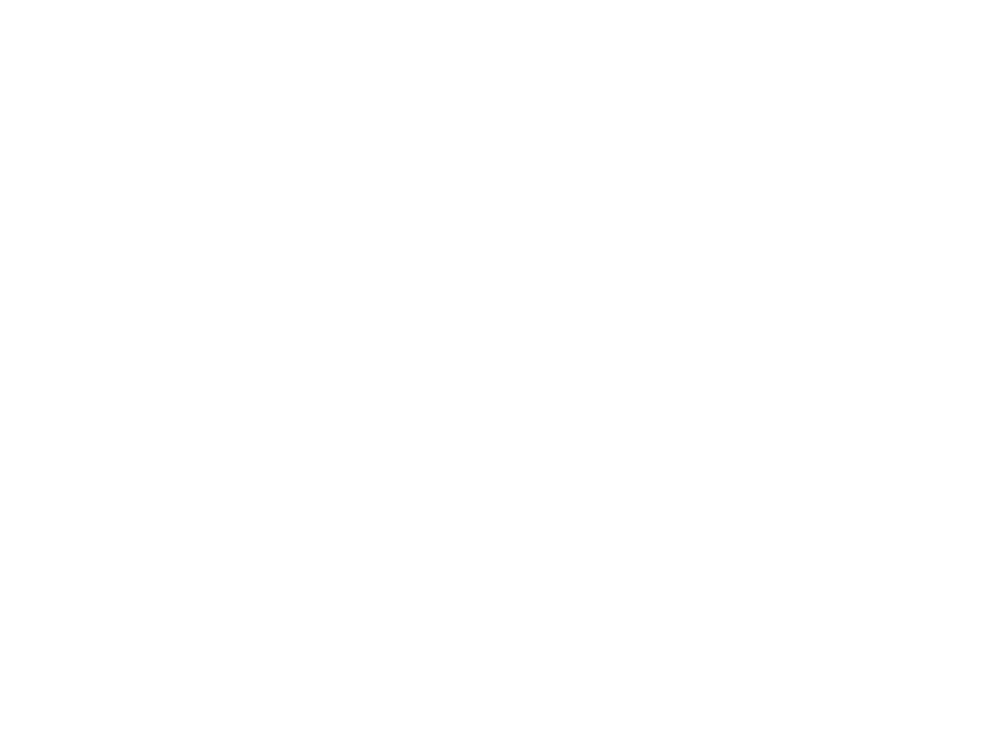

ValueError: num must be 1 <= num <= 70, not 71

In [233]:
plt.figure()#figsize=(2.5,2.5))
for iwt in range(nfiles):
    for itype in range(1):
        plt.subplot(7,10,iwt+1)
        plt.plot(usize,YYs[iwt,:,[1,3,5],itype].T)#,colors=colors[itype+1])
        plt.xlabel('size ($^o$)')
        plt.ylabel('firing rate (a.u.)')
    plt.axis('off')
    plt.tight_layout()
#     plt.savefig('figures/modeled_%s_size_tuning.eps'%lbls[itype])

In [45]:
# plt.figure(figsize=(5,2.5))
types = [0,1]
ccs = np.zeros((nfiles,nQ*nS*nT))
for iwt in range(nfiles):
    for itype,thistype in enumerate(np.arange(nQ*nS*nT)):
#         plt.subplot(1,2,itype+1)
        xdata = YYhat[:,thistype].reshape((6,6))
        ydata = YYs[iwt,:,:,thistype]
    #     sca.scatter_size_contrast(xdata,ydata)
        ccs[iwt,itype] = var_explained(xdata,ydata)

<IPython.core.display.Javascript object>


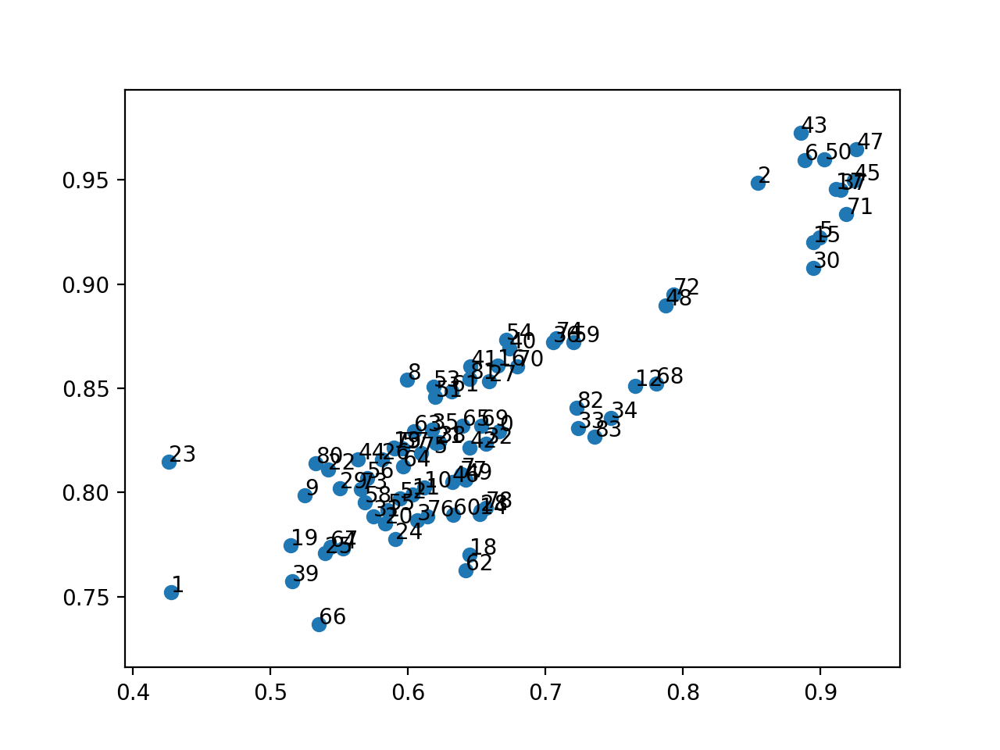

In [46]:
plt.figure()
plt.scatter(ccs[:,0],ccs[:,1])
for iwt in range(nfiles):
    plt.text(ccs[iwt,0],ccs[iwt,1],iwt)
lkat = (ccs[:,0]>0.8) & (ccs[:,1]>0.9)
nlkat = lkat.sum()

In [31]:
these_weights_files = [weights_files[i] for i in np.where(lkat)[0]] #weights_files.copy()#
np.save('weights_files_list.npy',these_weights_files,allow_pickle=True)


In [554]:
these_weights_files = [wf.replace('/Users/dan/Documents/notebooks/mossing-PC/shared_data/','/home/mossing/data/') for wf in weights_files] #weights_files.copy()#
np.save('weights_files_list_bigboi.npy',these_weights_files,allow_pickle=True)


In [32]:
these_weights_files = [wf.replace('/Users/dan/Documents/notebooks/mossing-PC/shared_data/','') for wf in weights_files] #weights_files.copy()#
np.save('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights_files_list_portable.npy',these_weights_files,allow_pickle=True)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


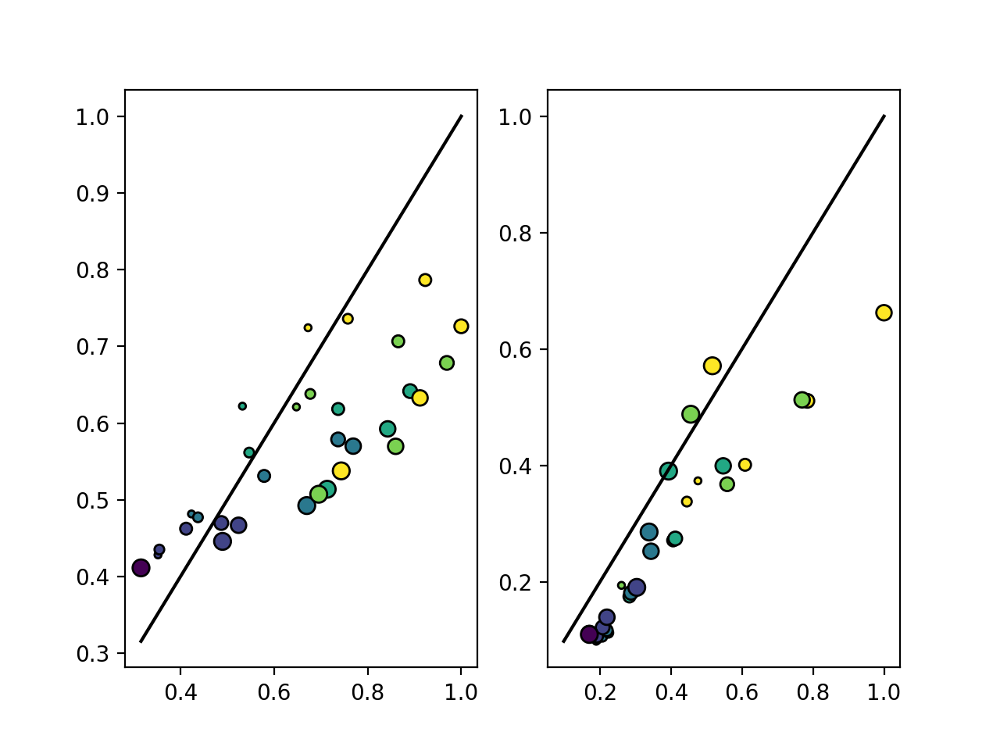

<IPython.core.display.Javascript object>


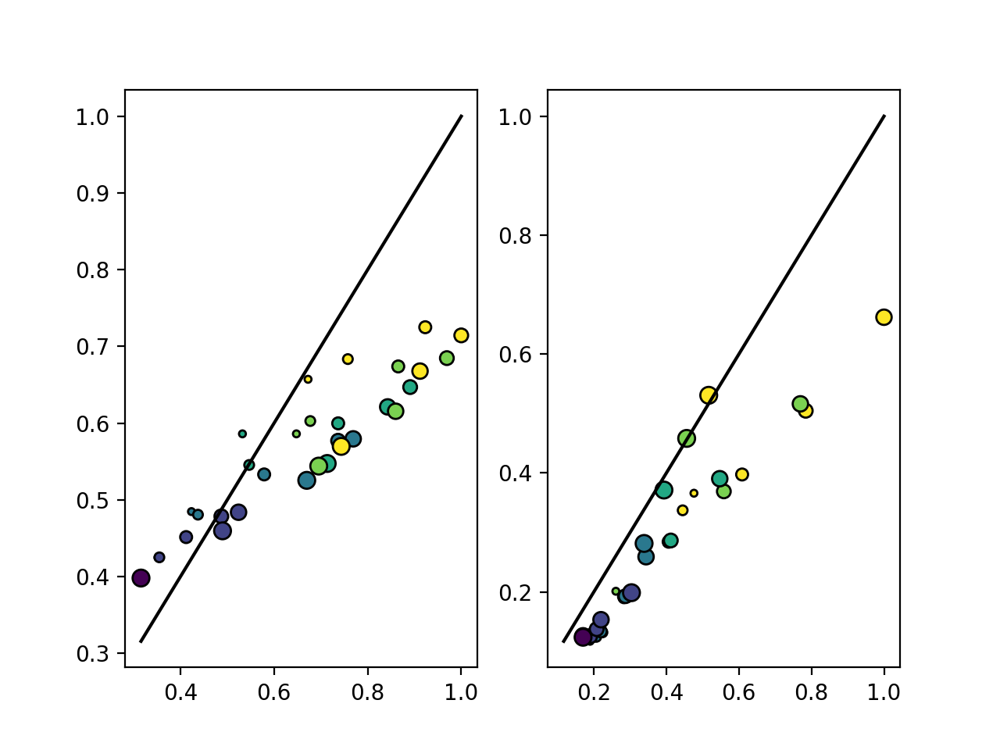

<IPython.core.display.Javascript object>


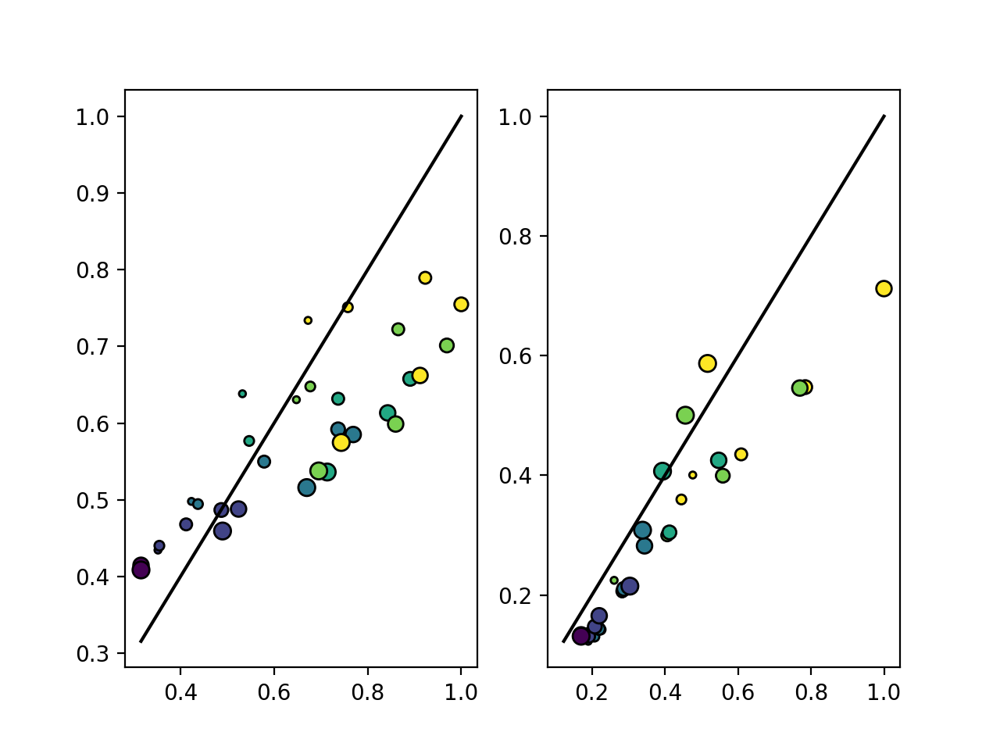

<IPython.core.display.Javascript object>


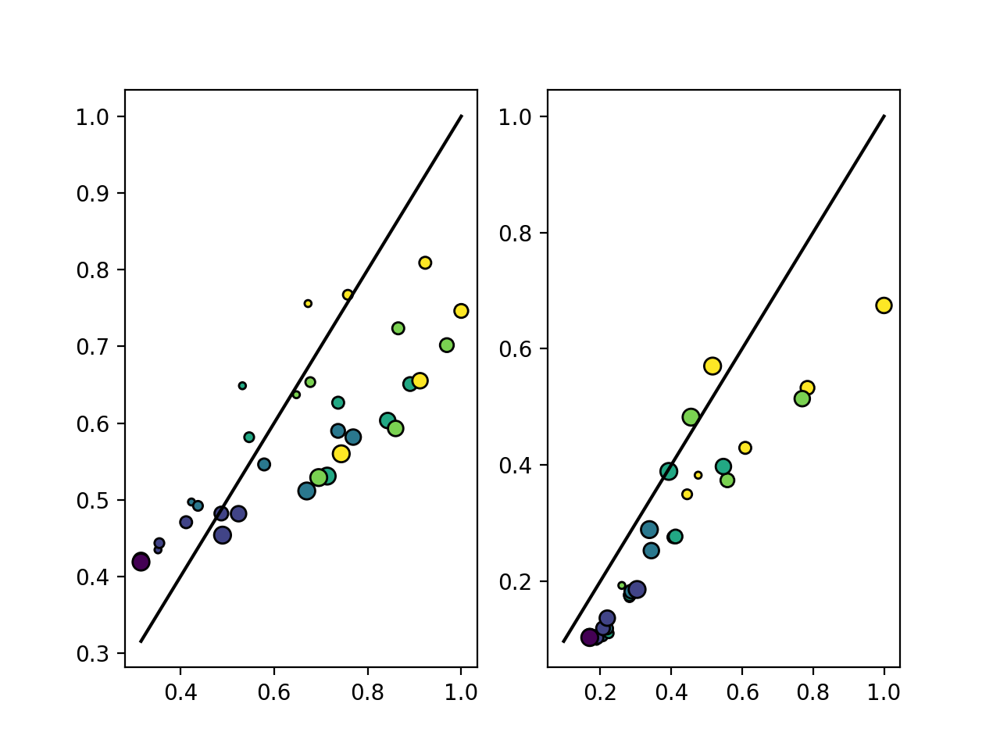

<IPython.core.display.Javascript object>


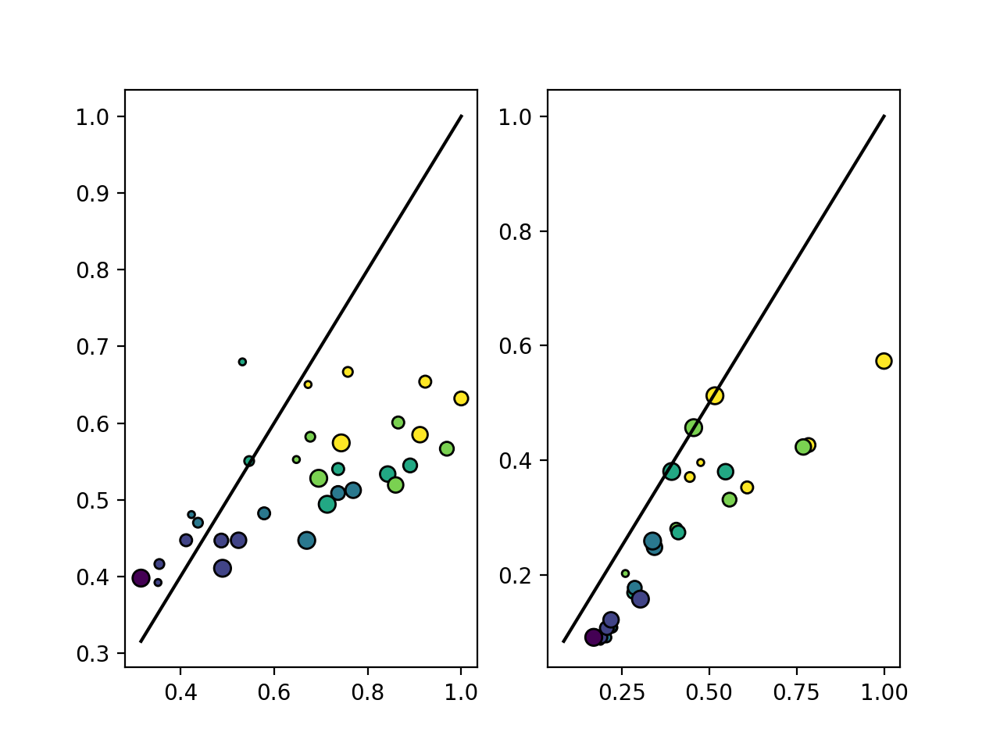

<IPython.core.display.Javascript object>


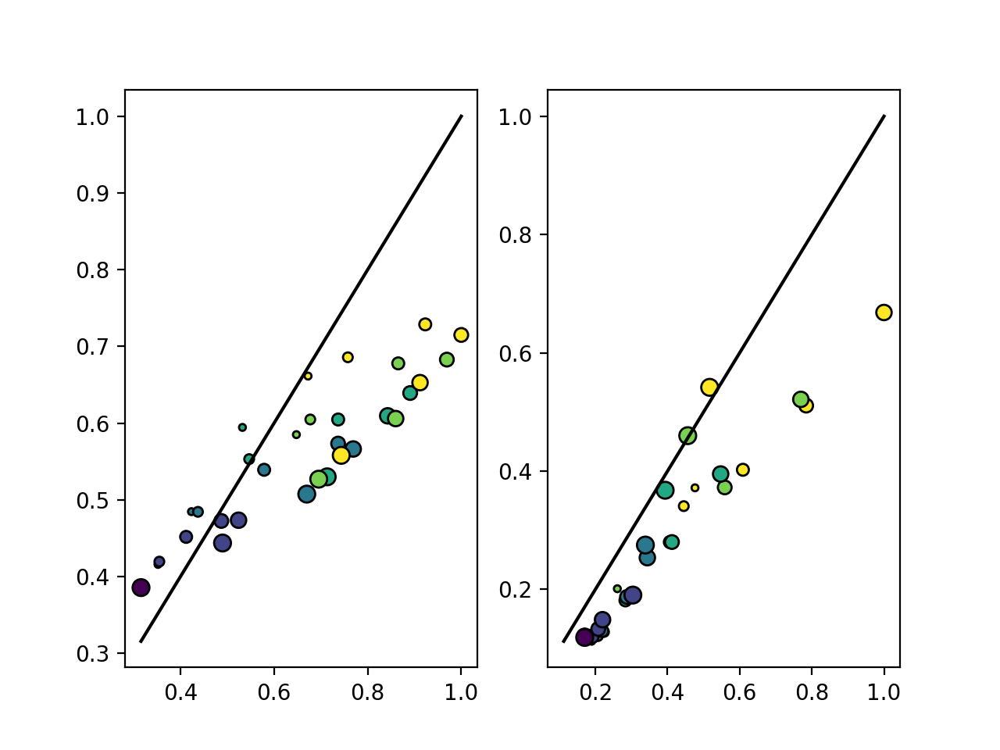

<IPython.core.display.Javascript object>


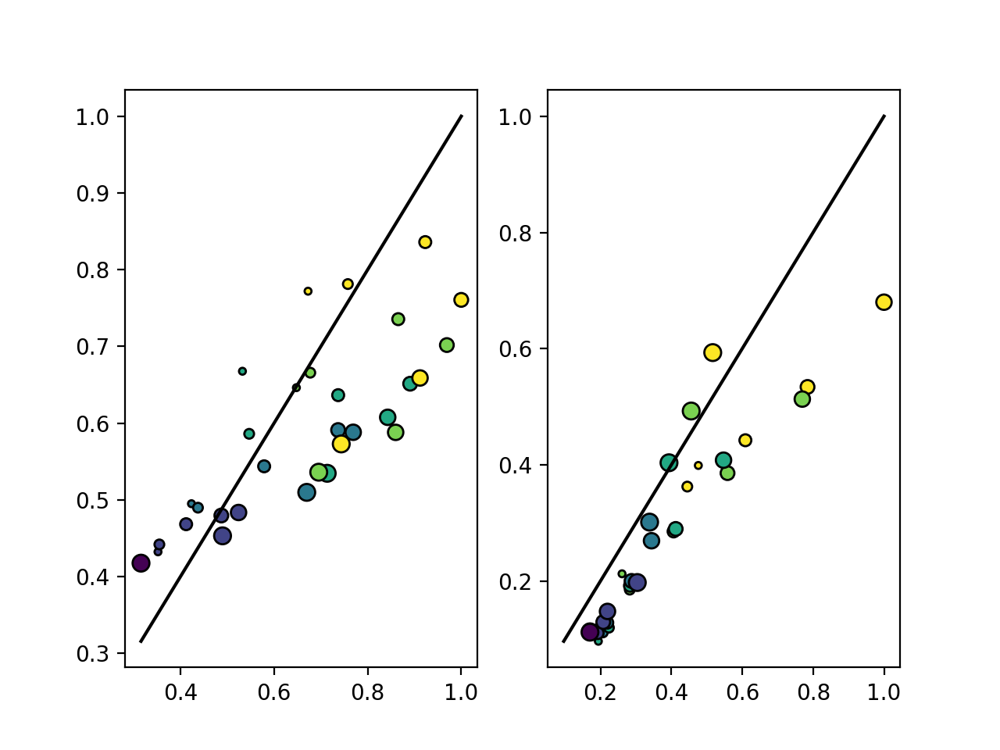

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


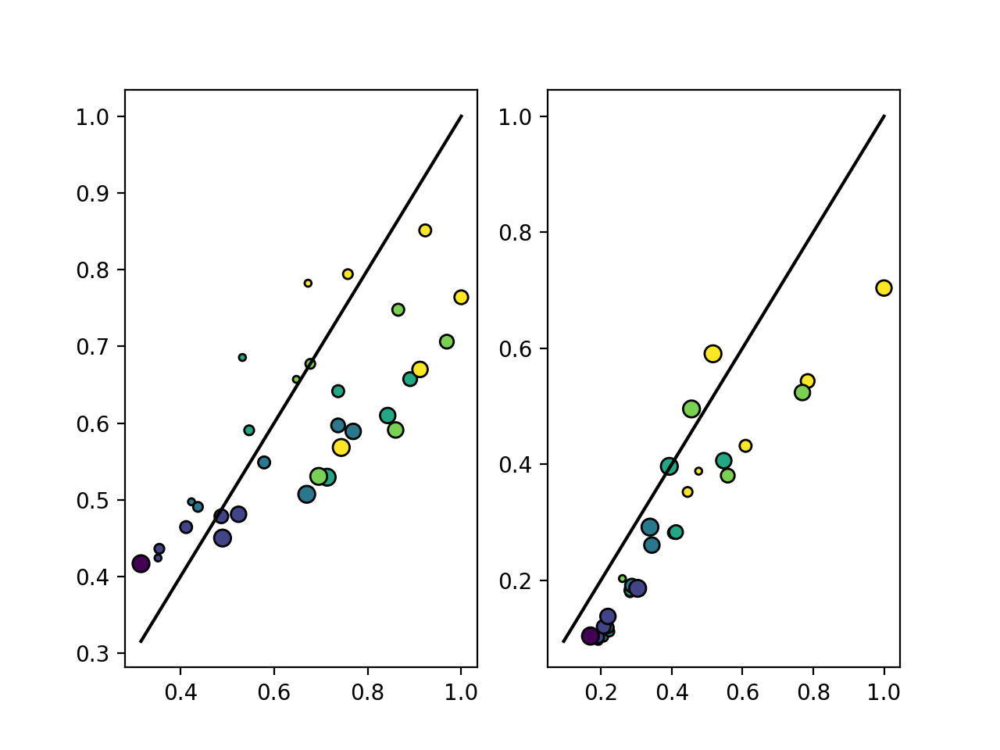

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


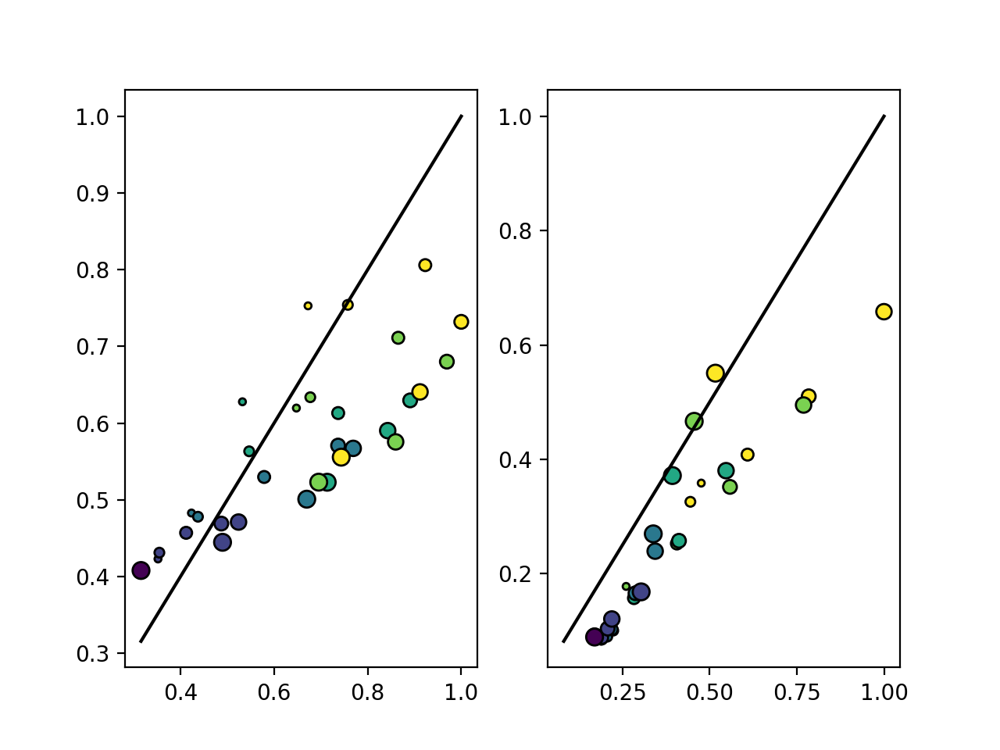

<IPython.core.display.Javascript object>


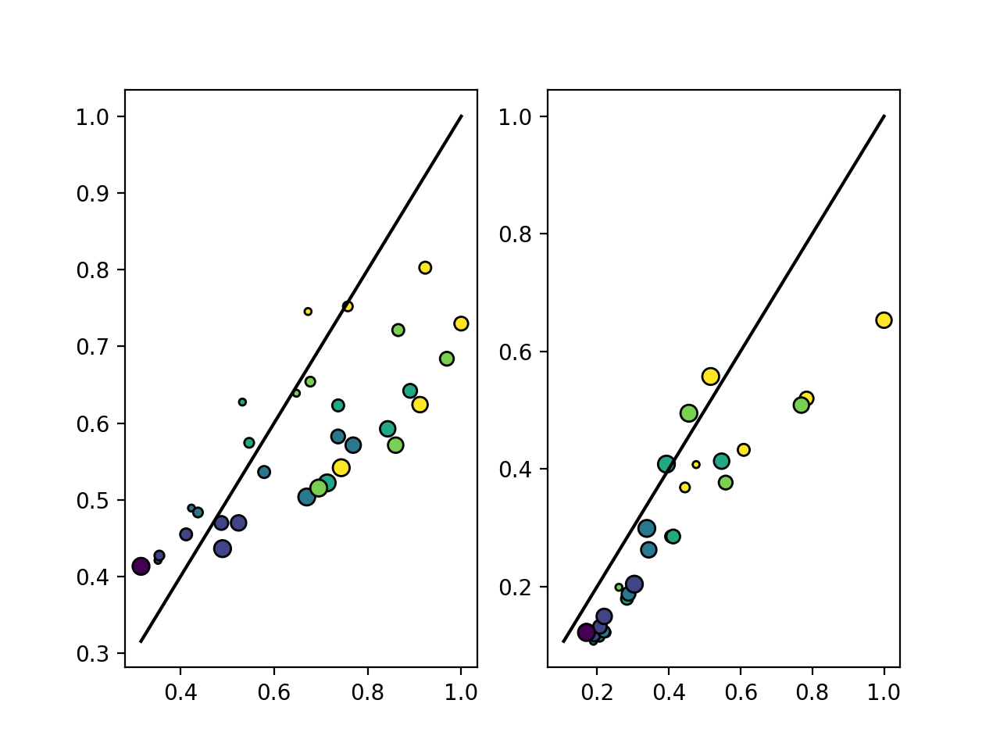

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


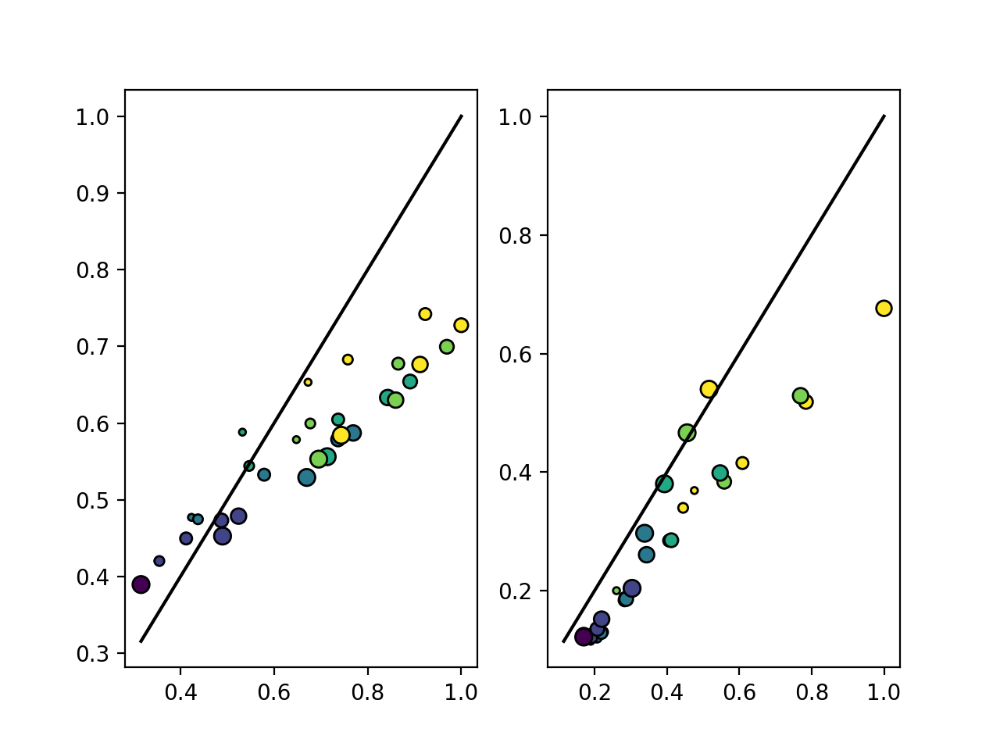

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


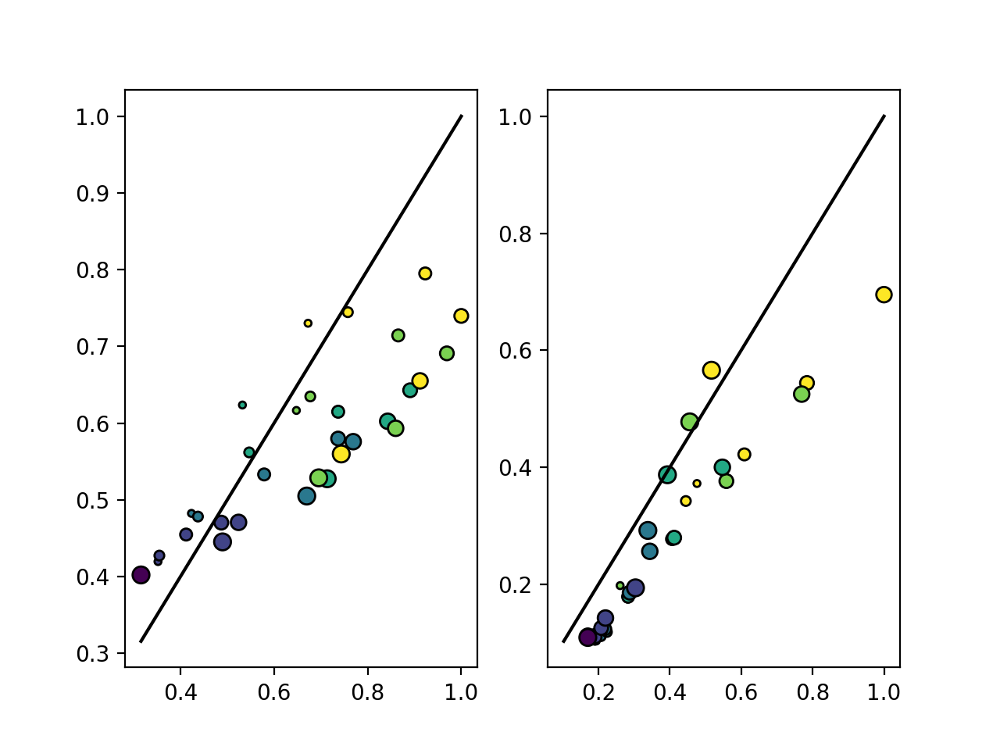

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


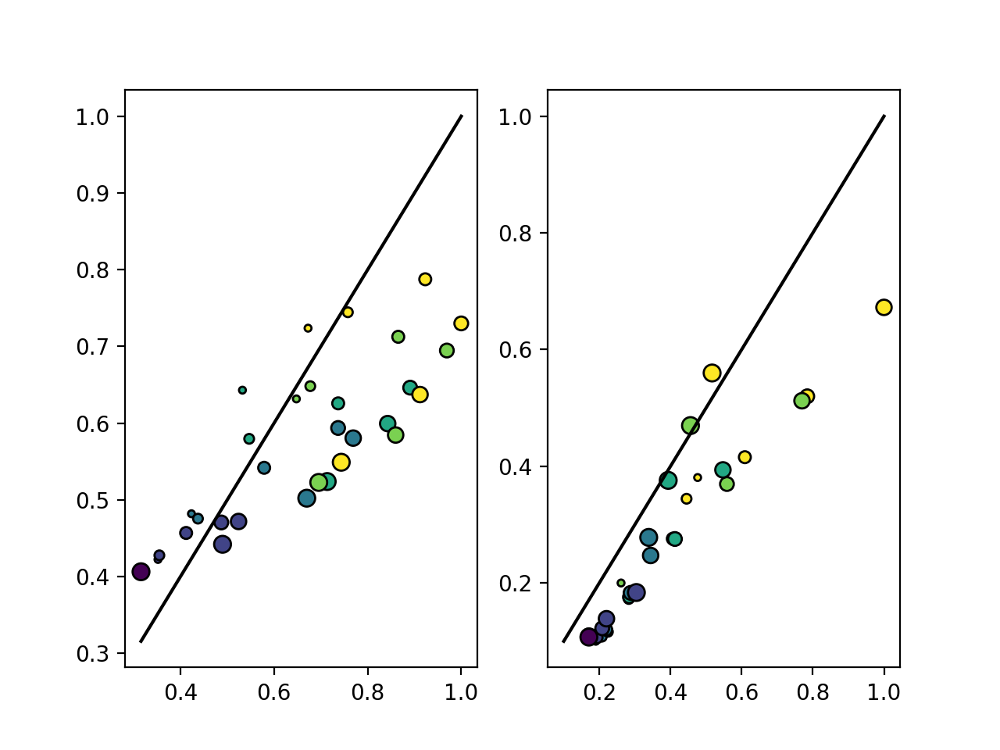

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


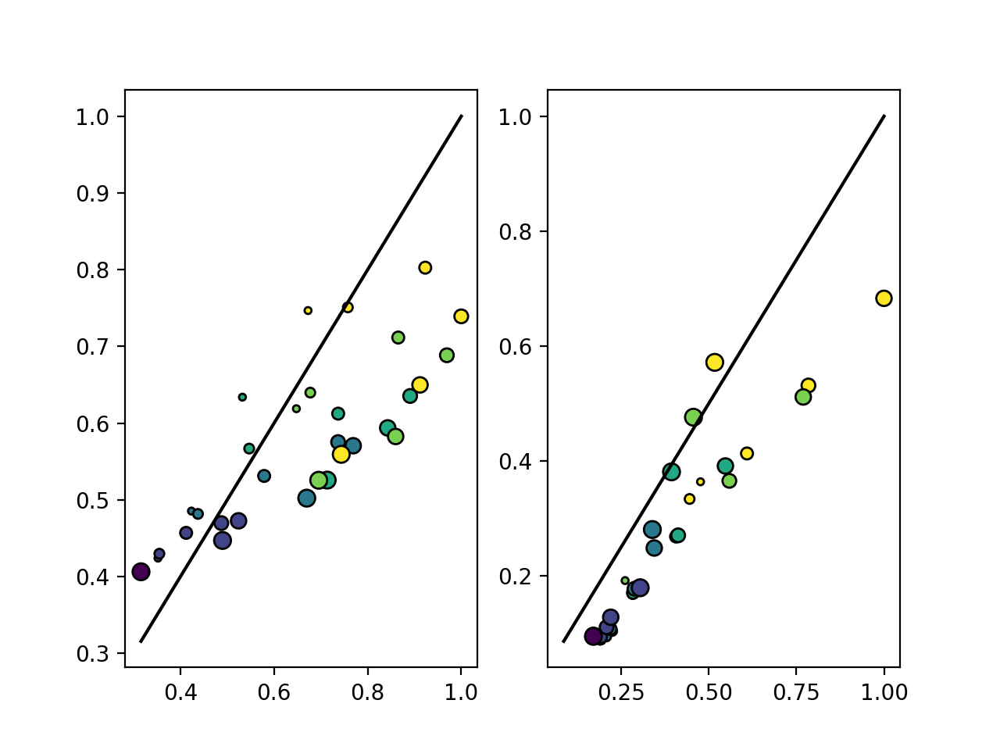

<IPython.core.display.Javascript object>


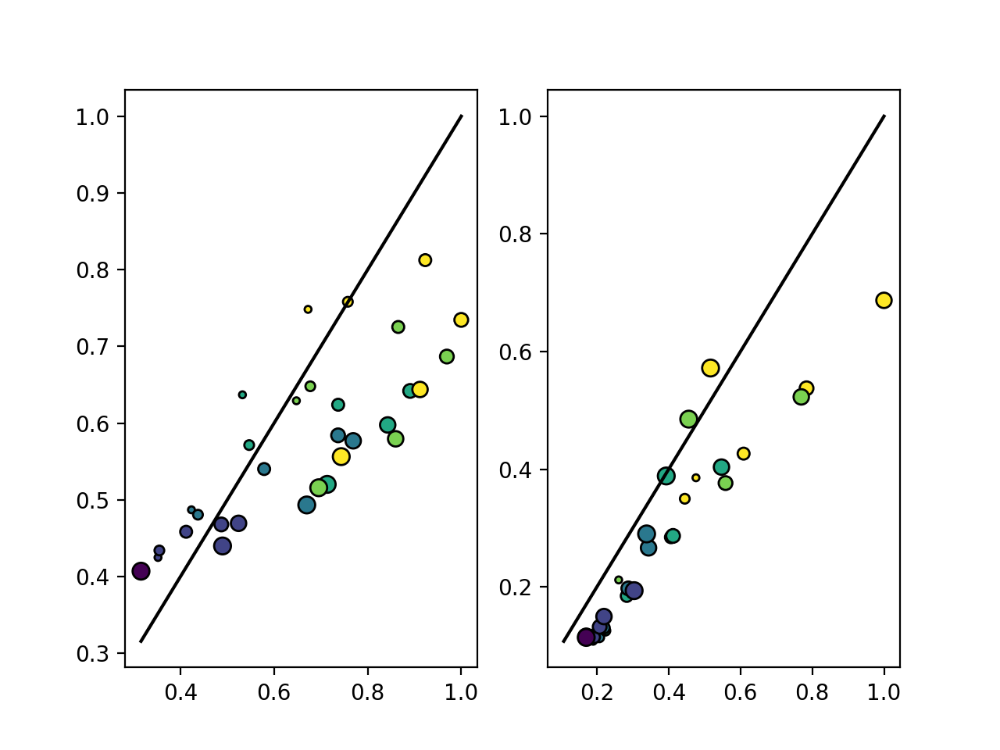

<IPython.core.display.Javascript object>


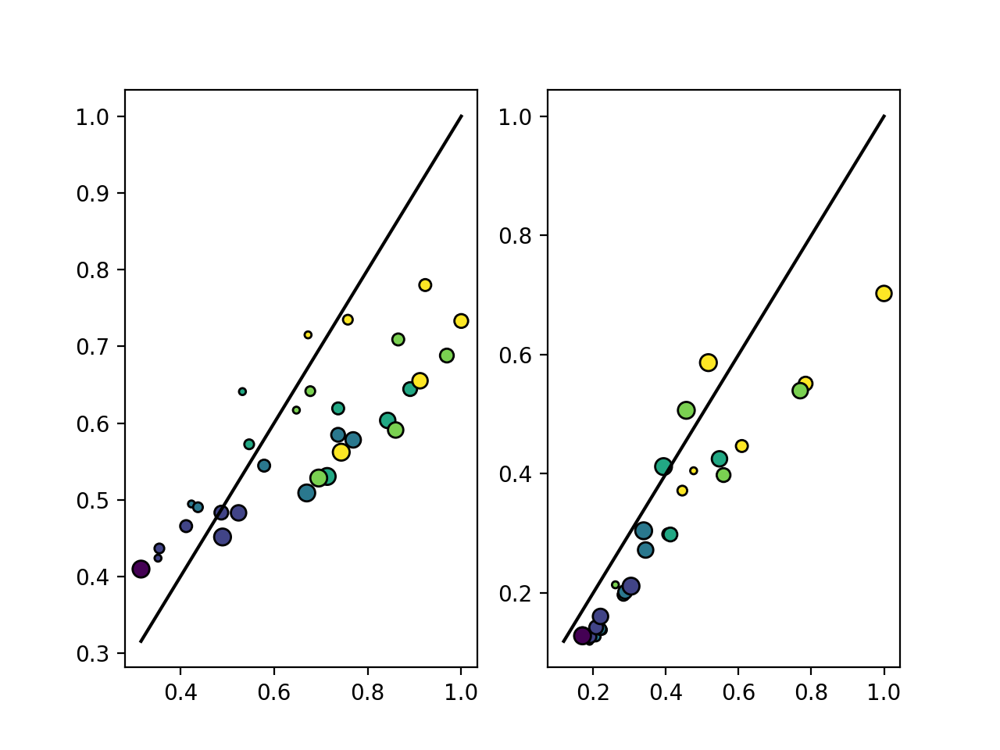

<IPython.core.display.Javascript object>


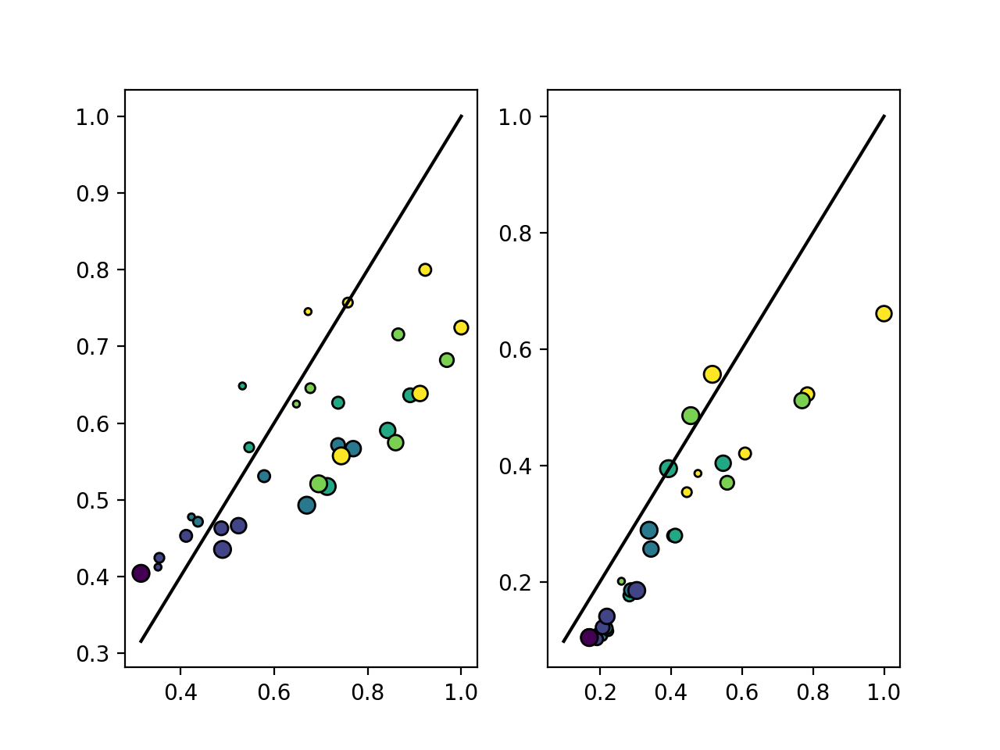

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


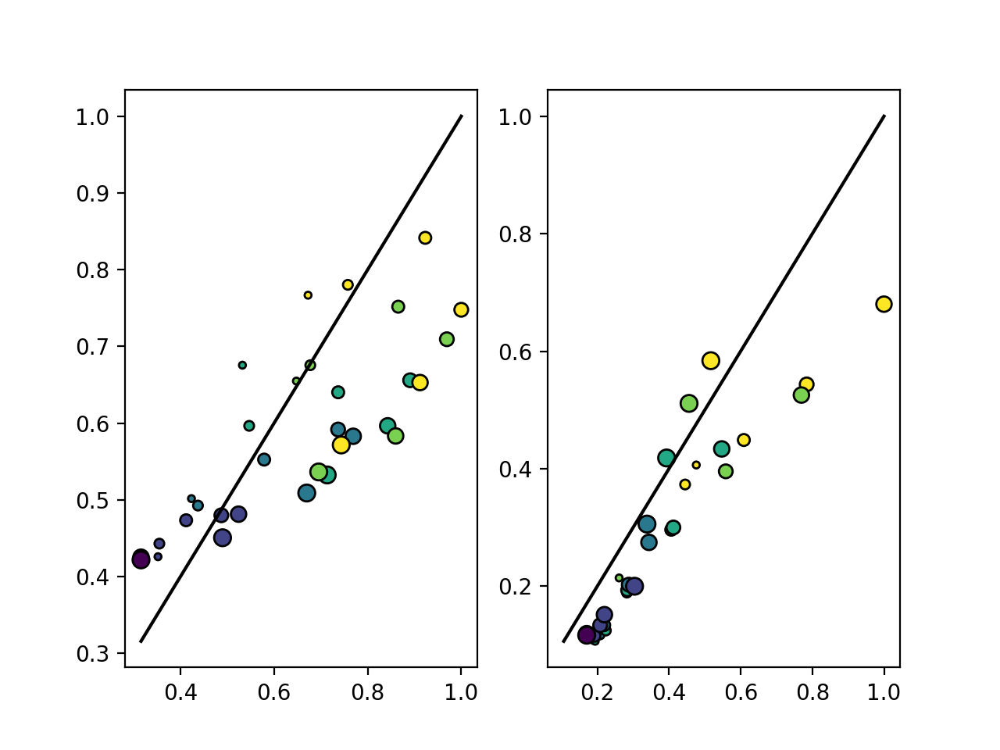

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


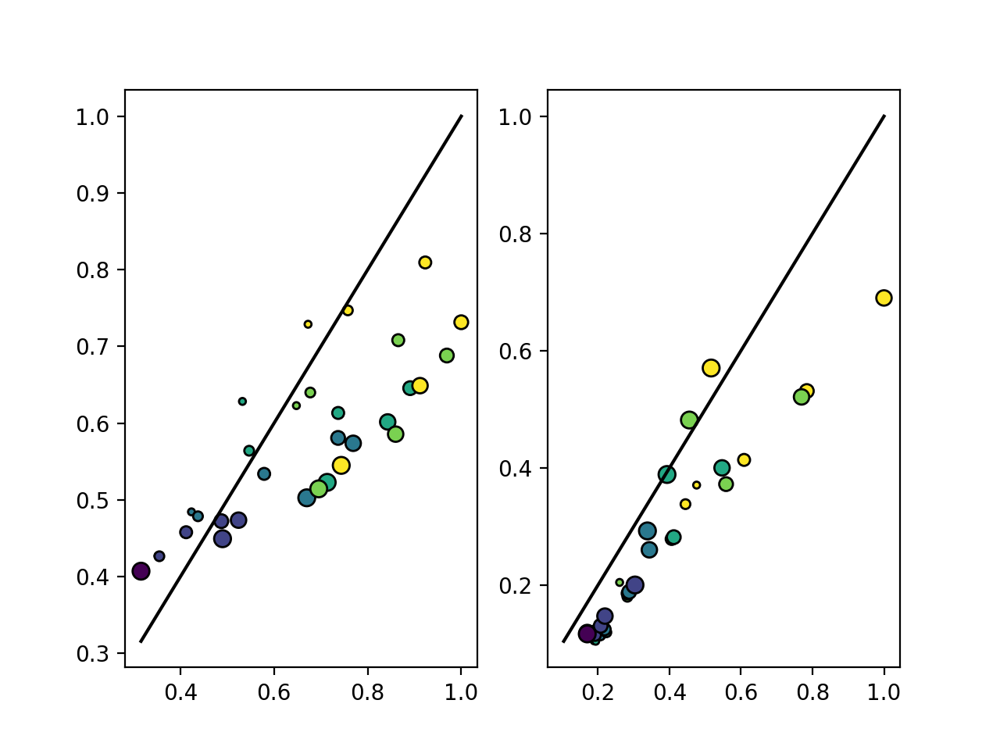

<IPython.core.display.Javascript object>


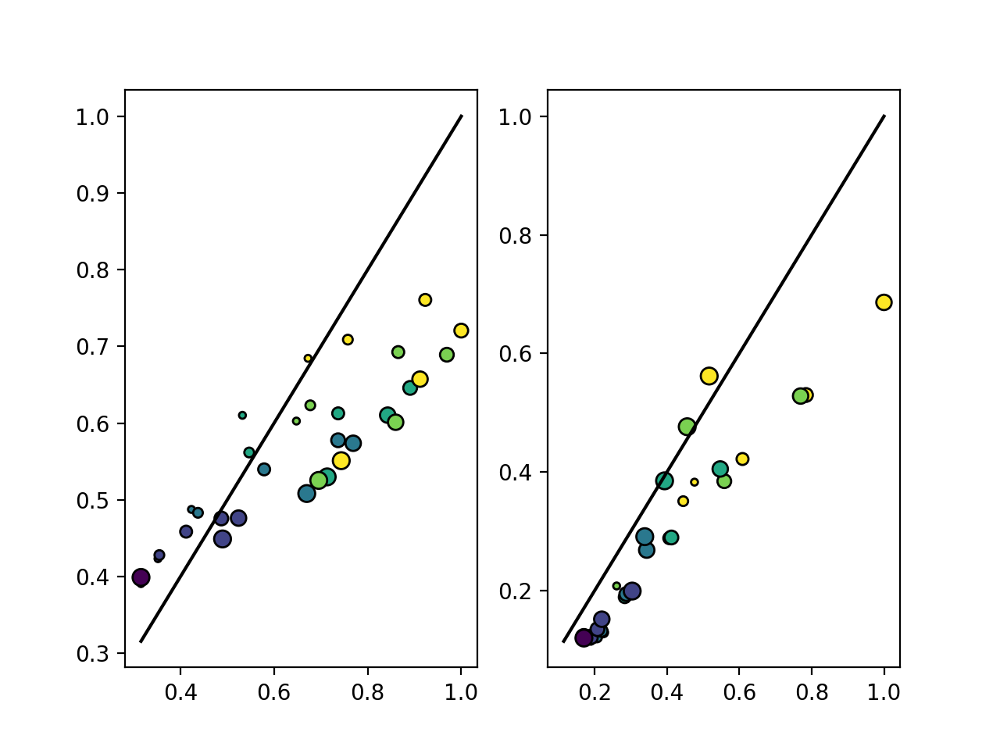

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


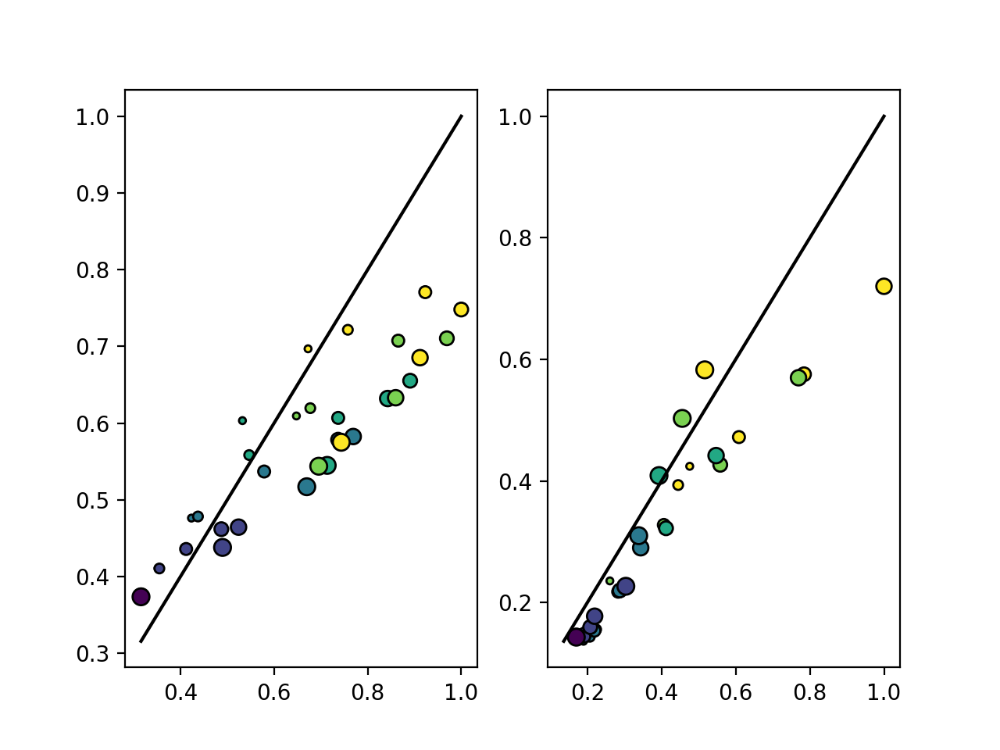

<IPython.core.display.Javascript object>


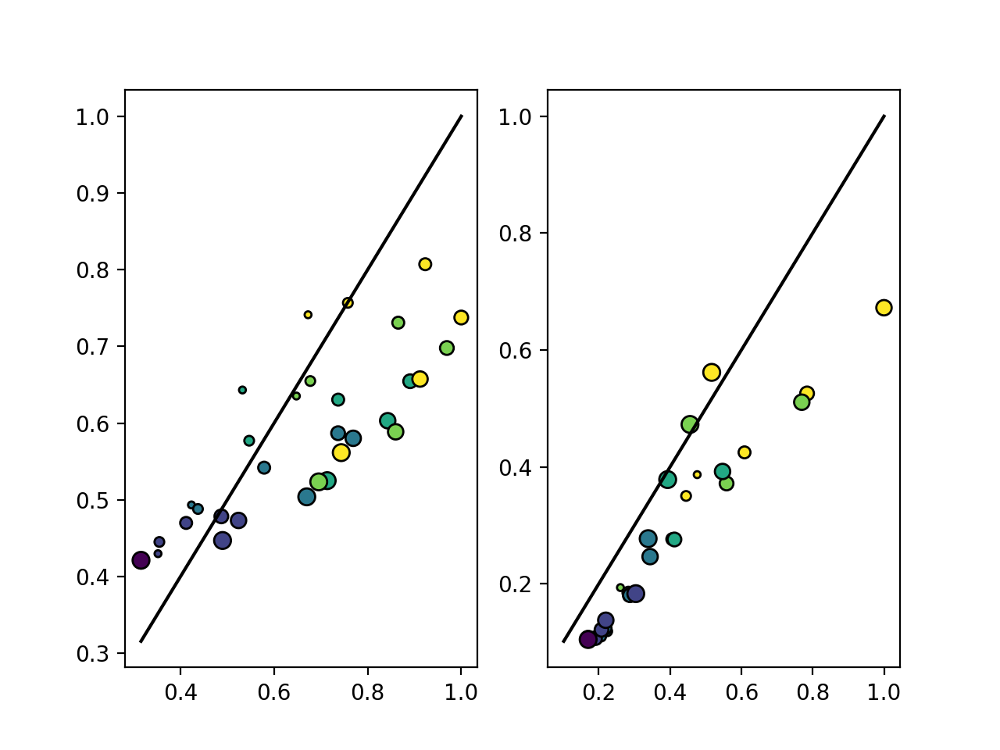

<IPython.core.display.Javascript object>


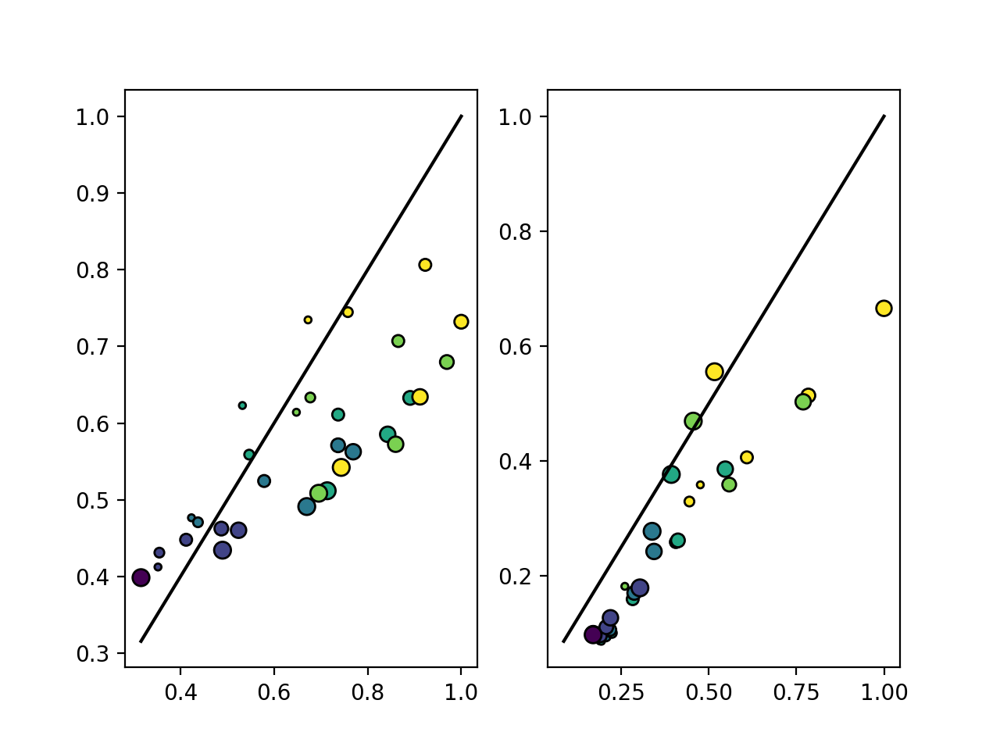

<IPython.core.display.Javascript object>


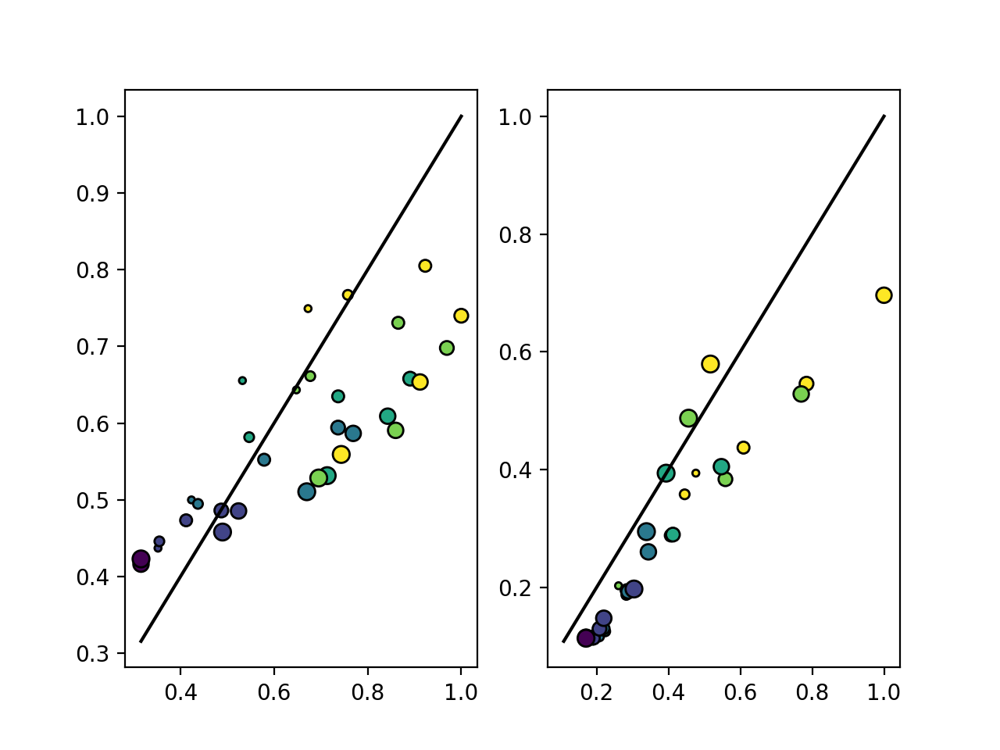

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


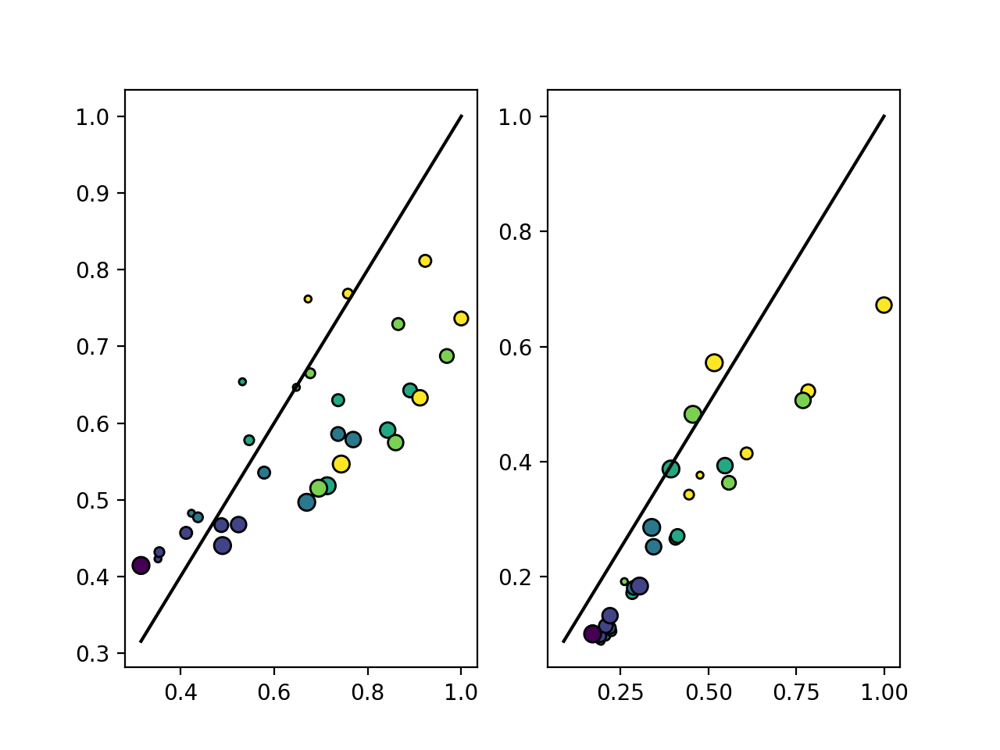

<IPython.core.display.Javascript object>


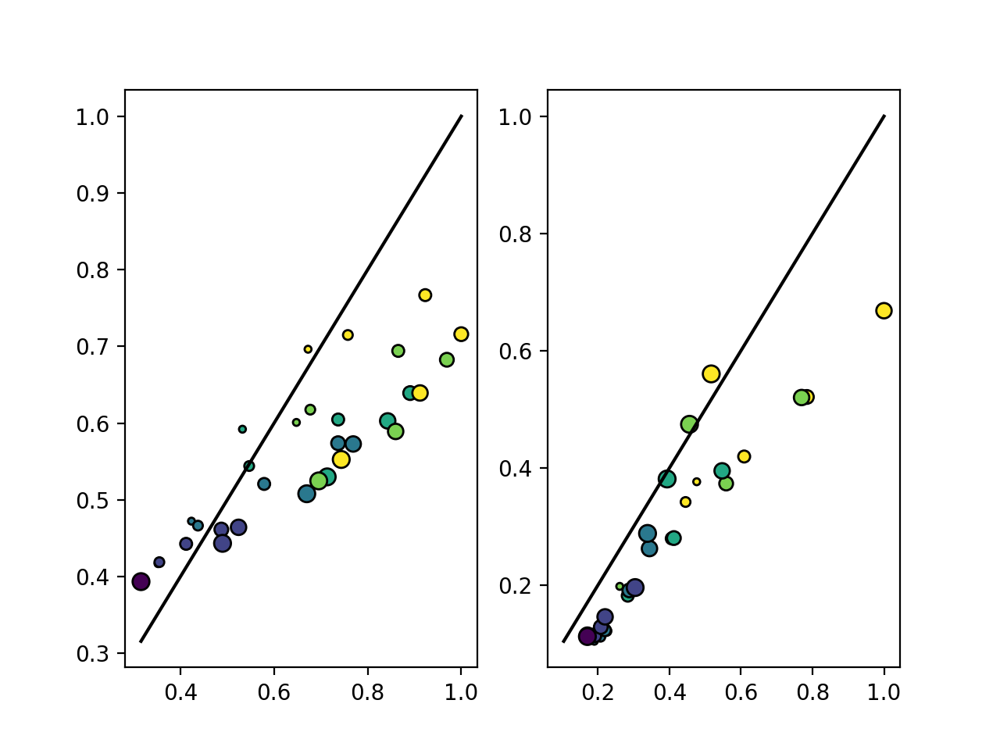

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


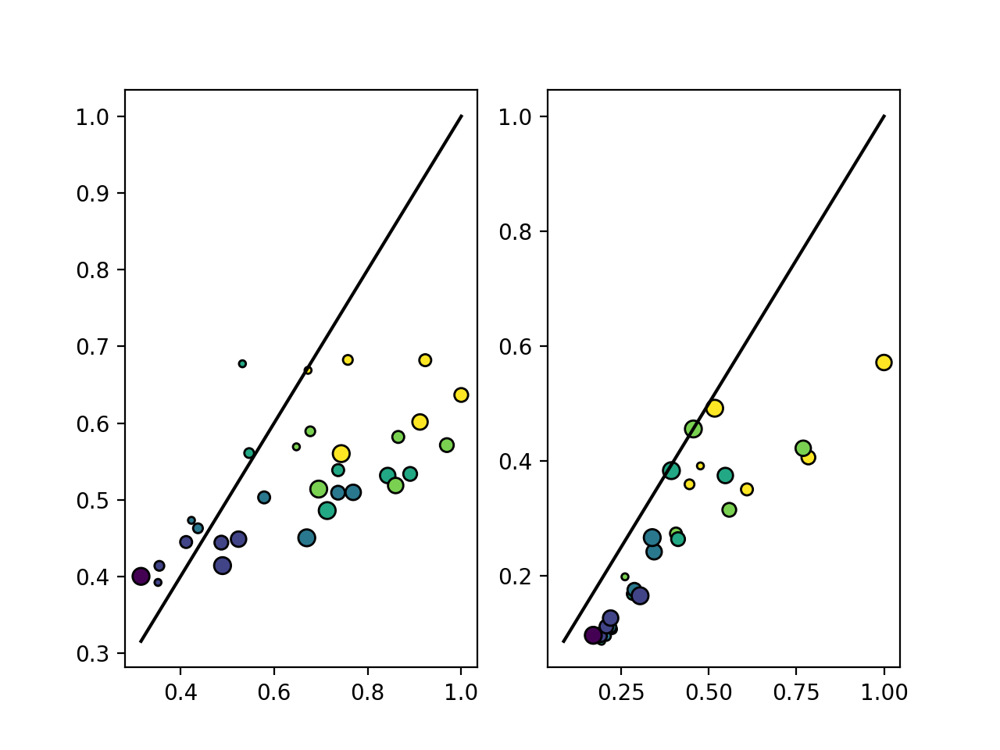

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


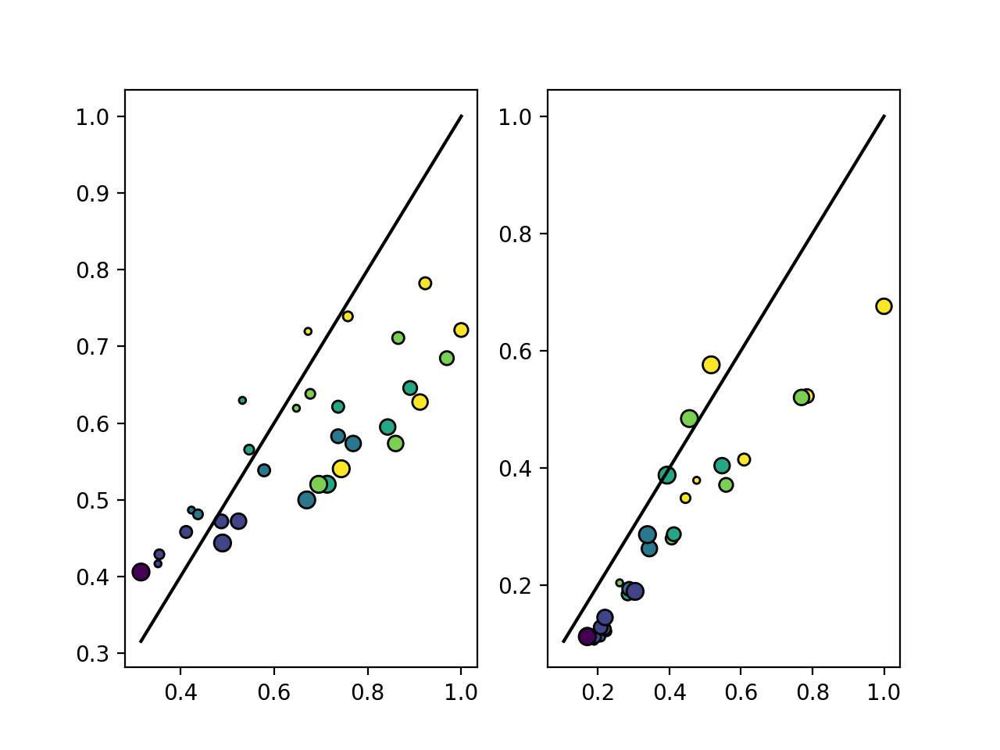

<IPython.core.display.Javascript object>


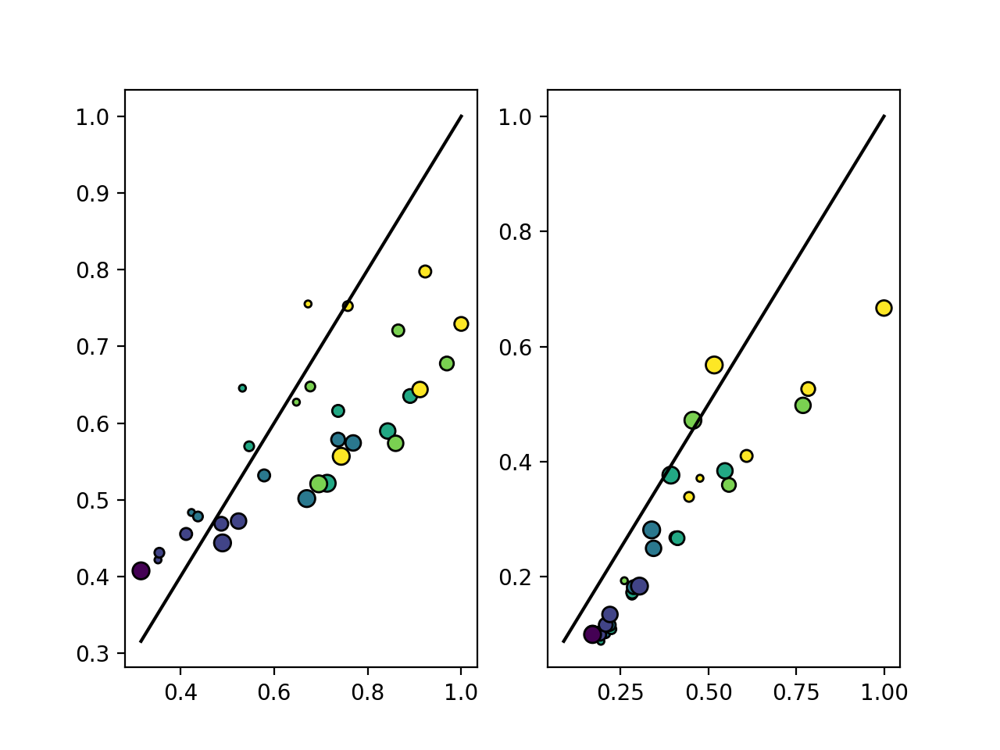

<IPython.core.display.Javascript object>


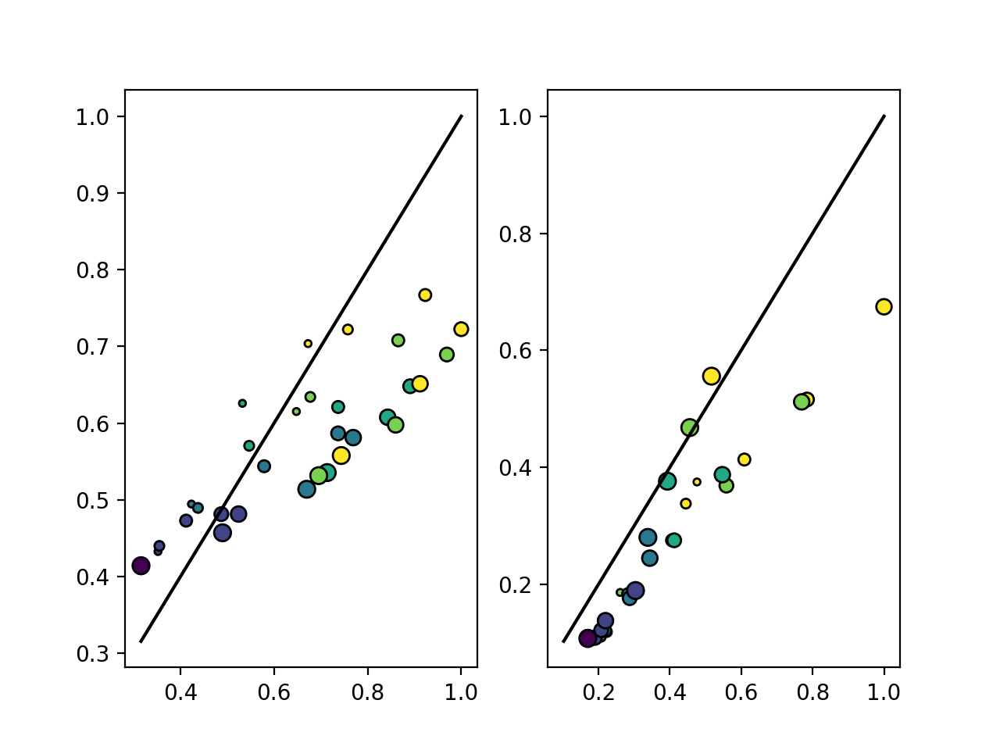

<IPython.core.display.Javascript object>


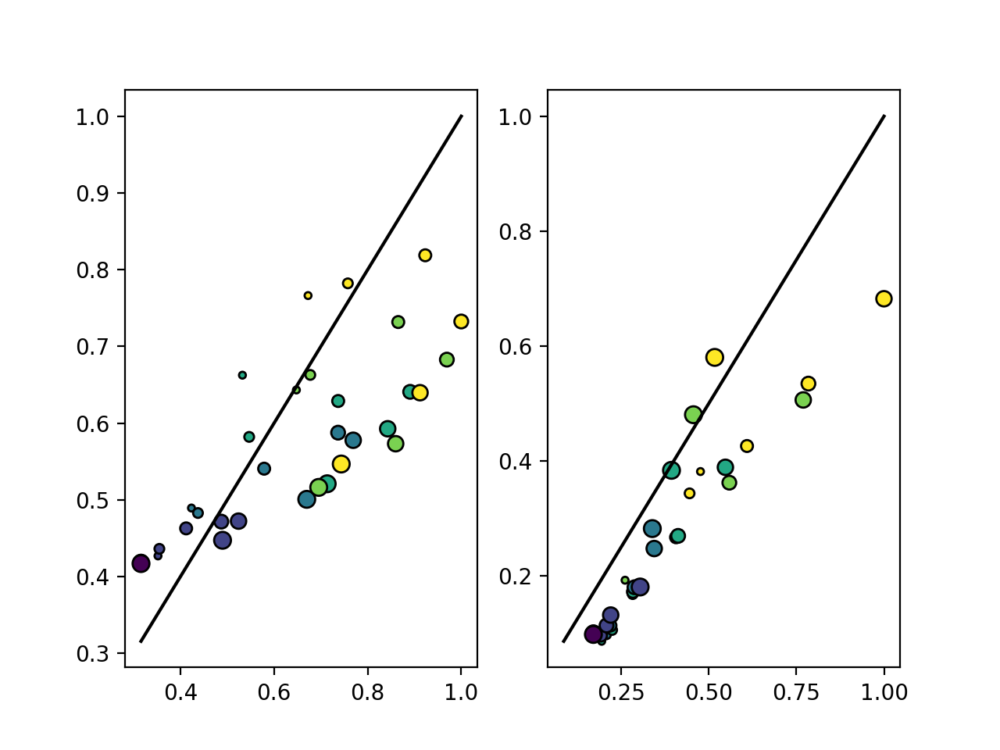

<IPython.core.display.Javascript object>


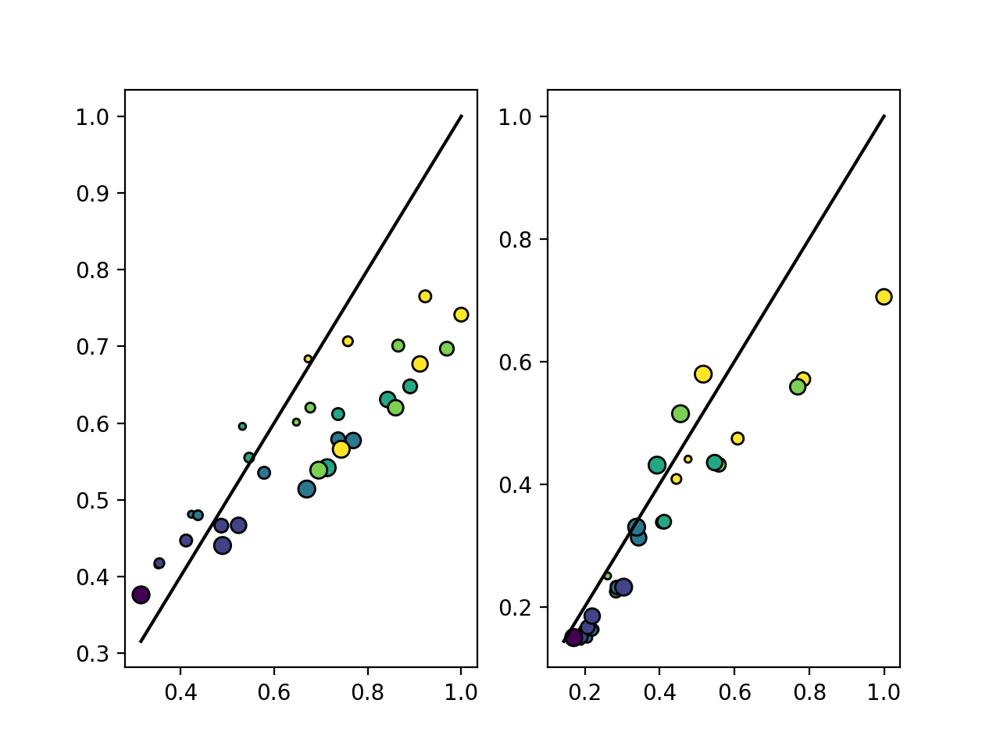

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


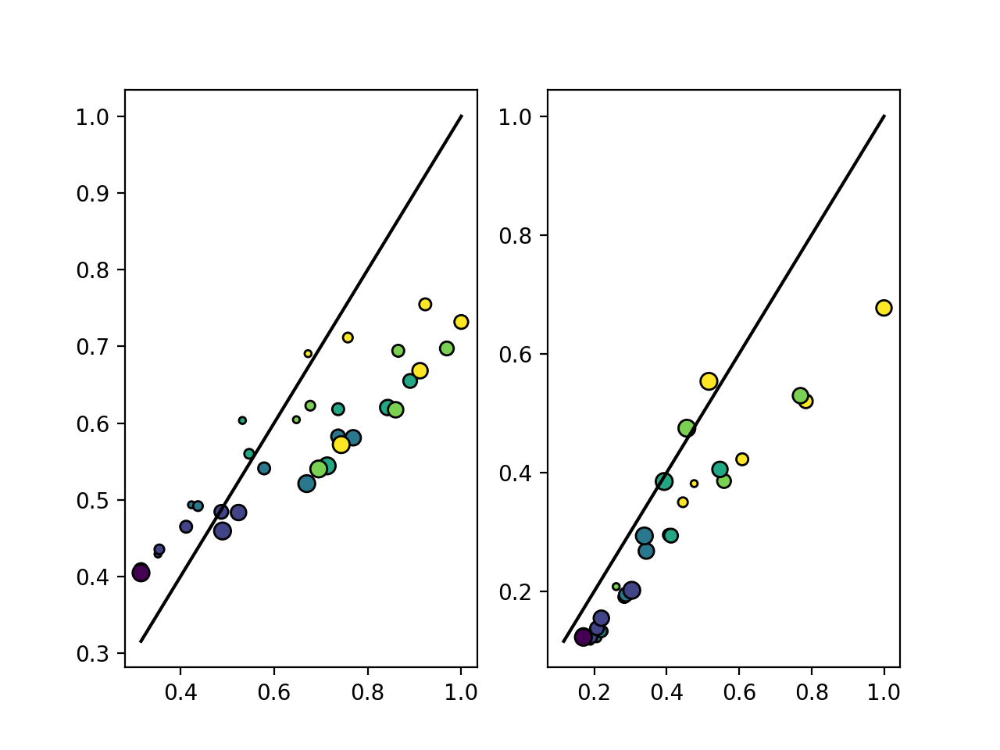

<IPython.core.display.Javascript object>


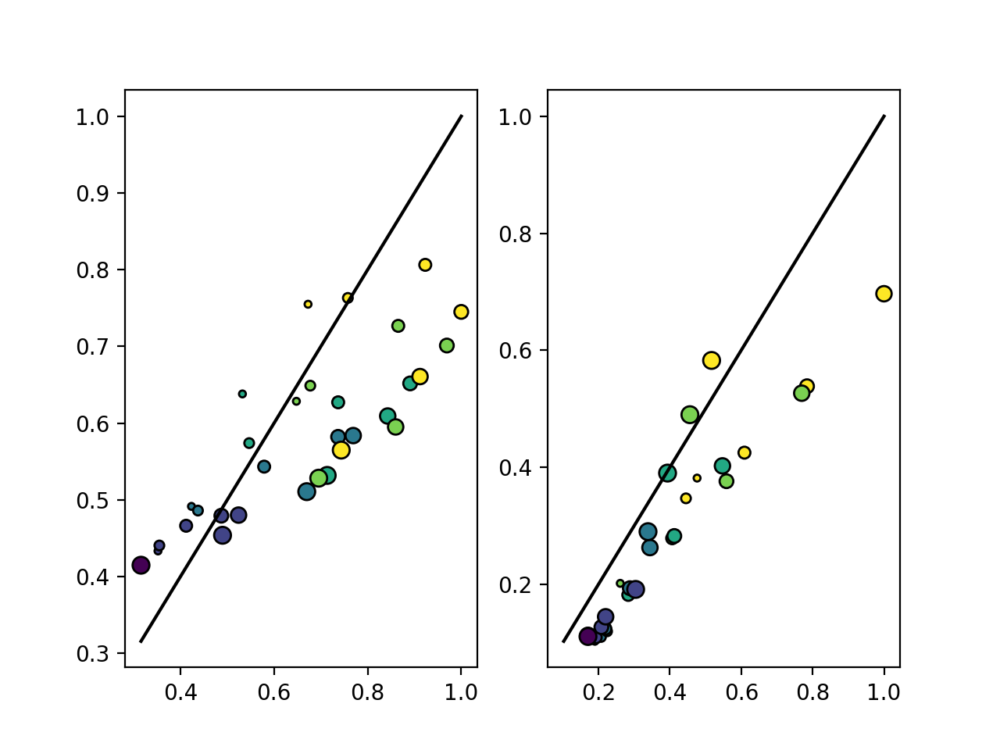

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


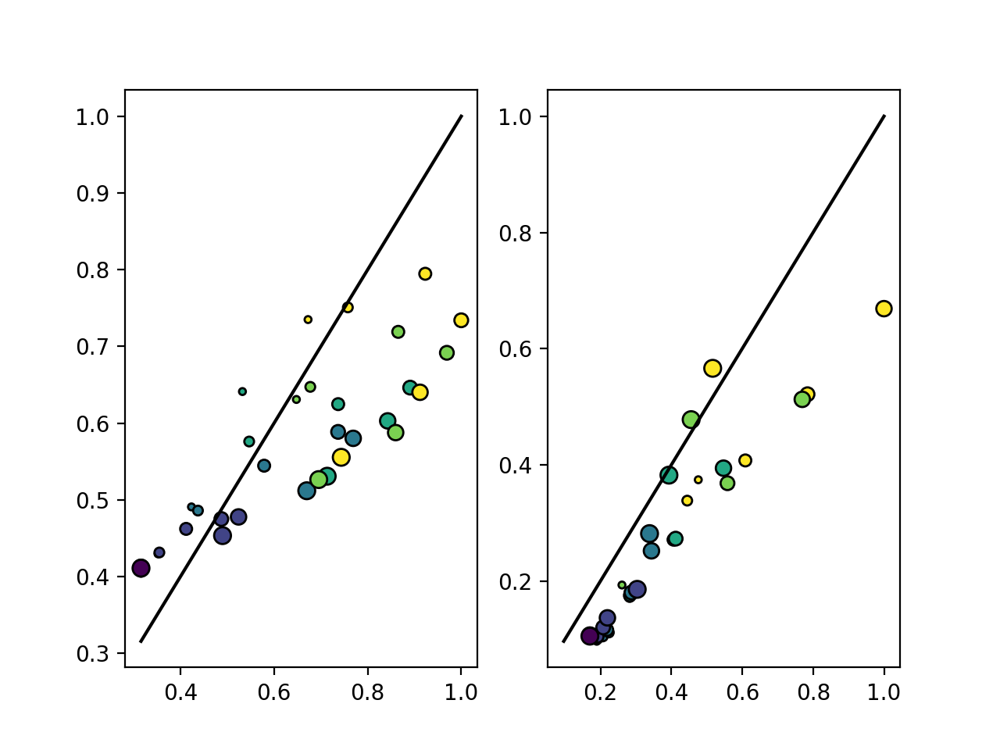

<IPython.core.display.Javascript object>


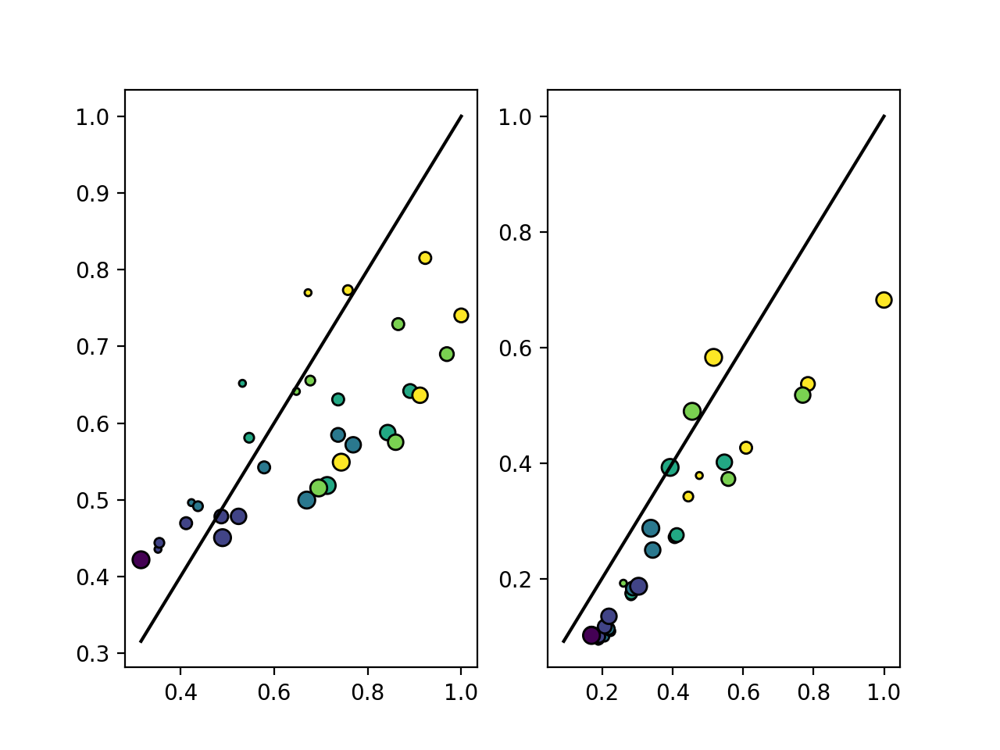

<IPython.core.display.Javascript object>


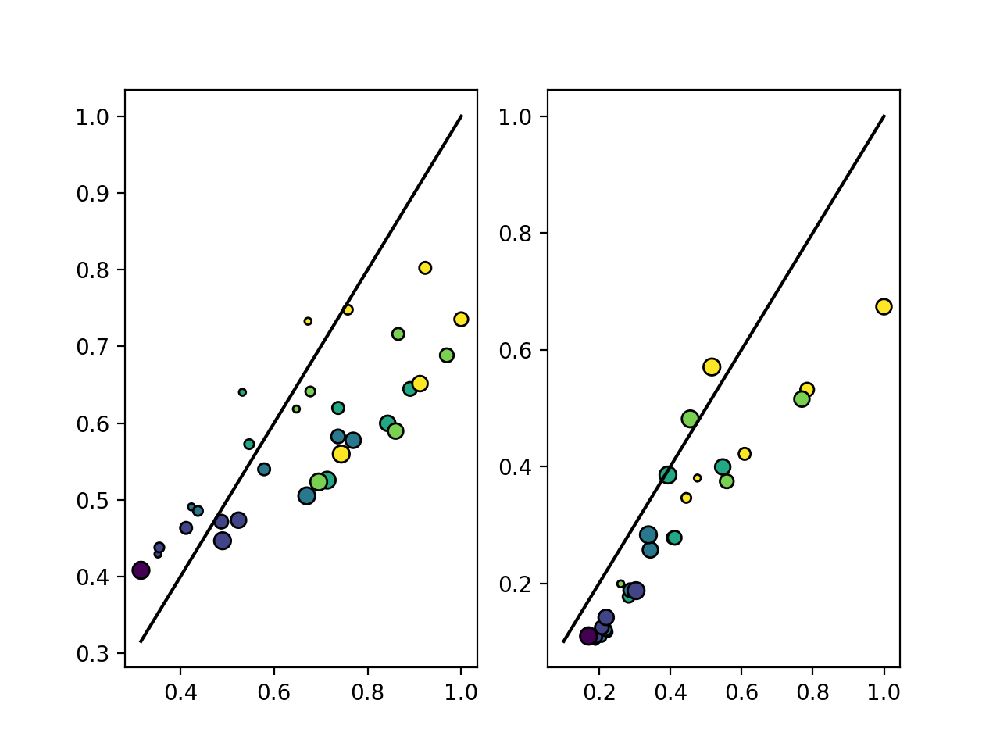

<IPython.core.display.Javascript object>


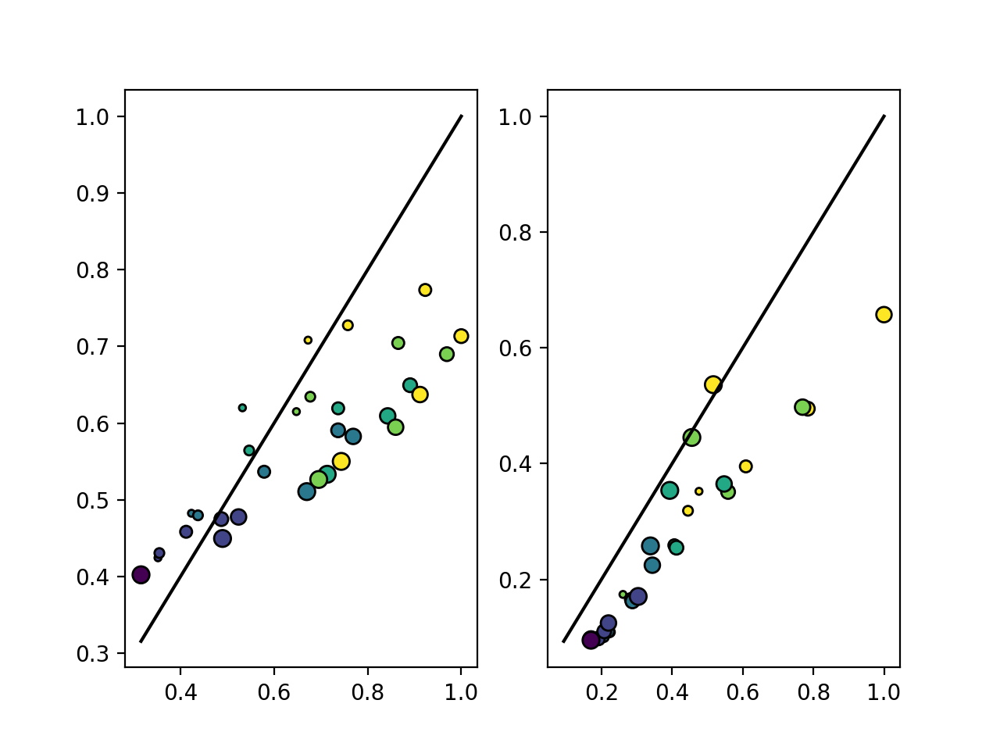

<IPython.core.display.Javascript object>


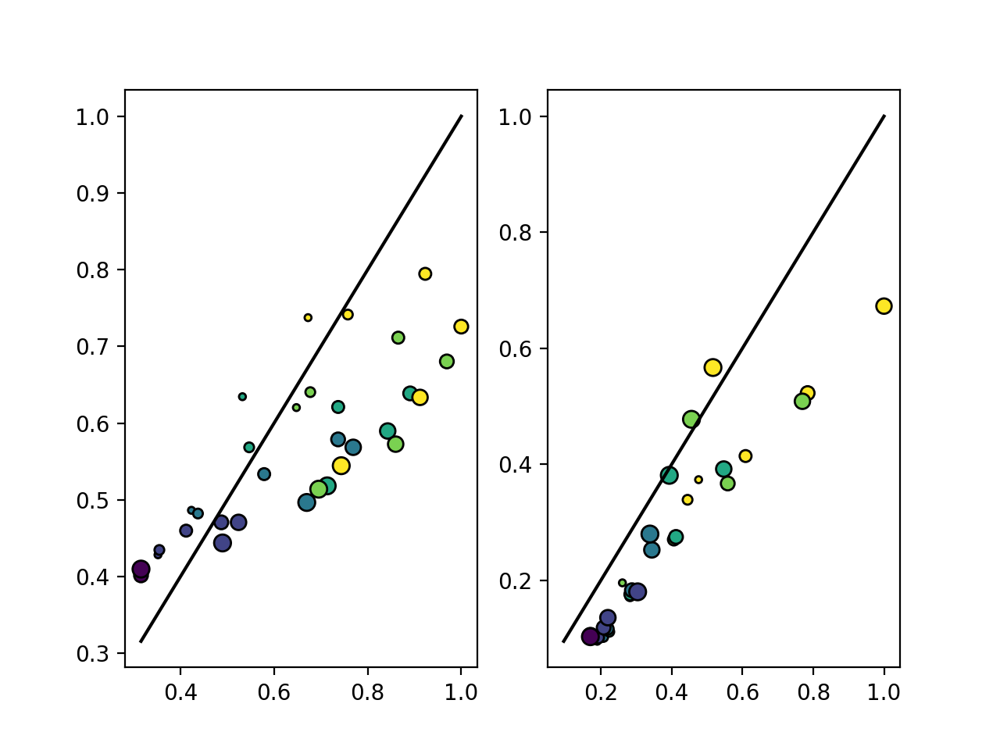

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


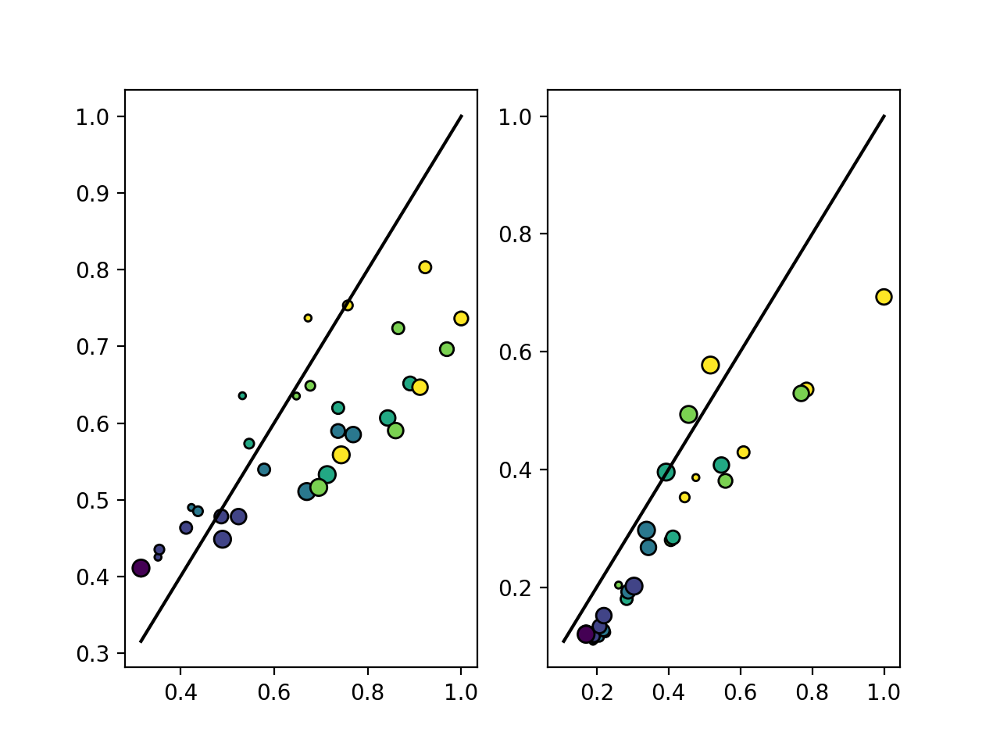

<IPython.core.display.Javascript object>


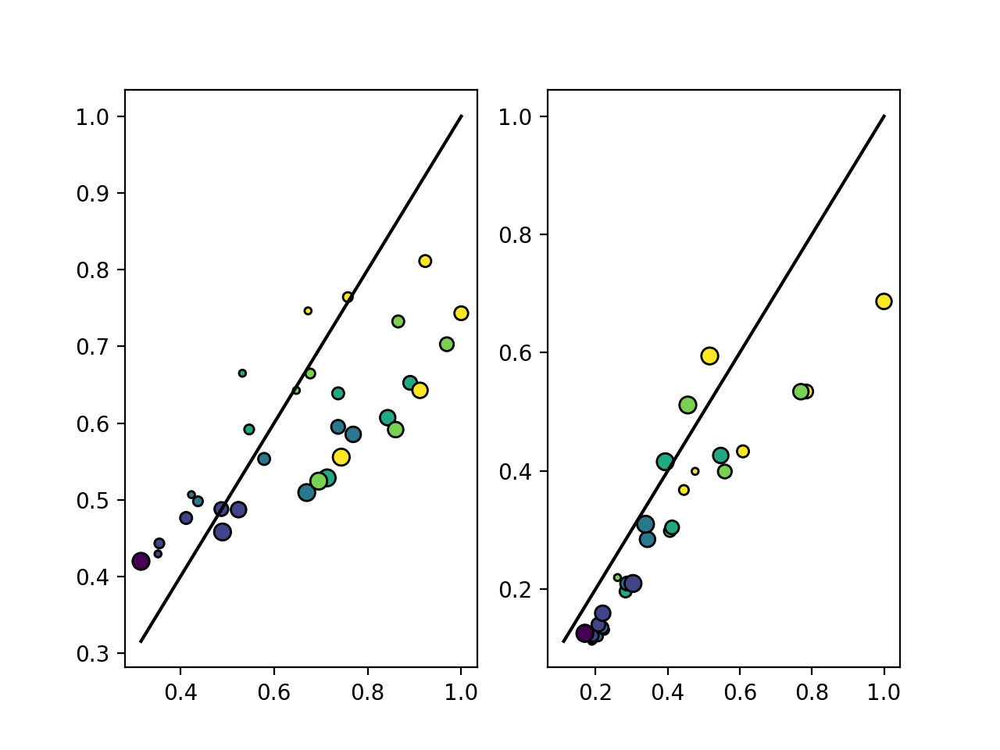

<IPython.core.display.Javascript object>


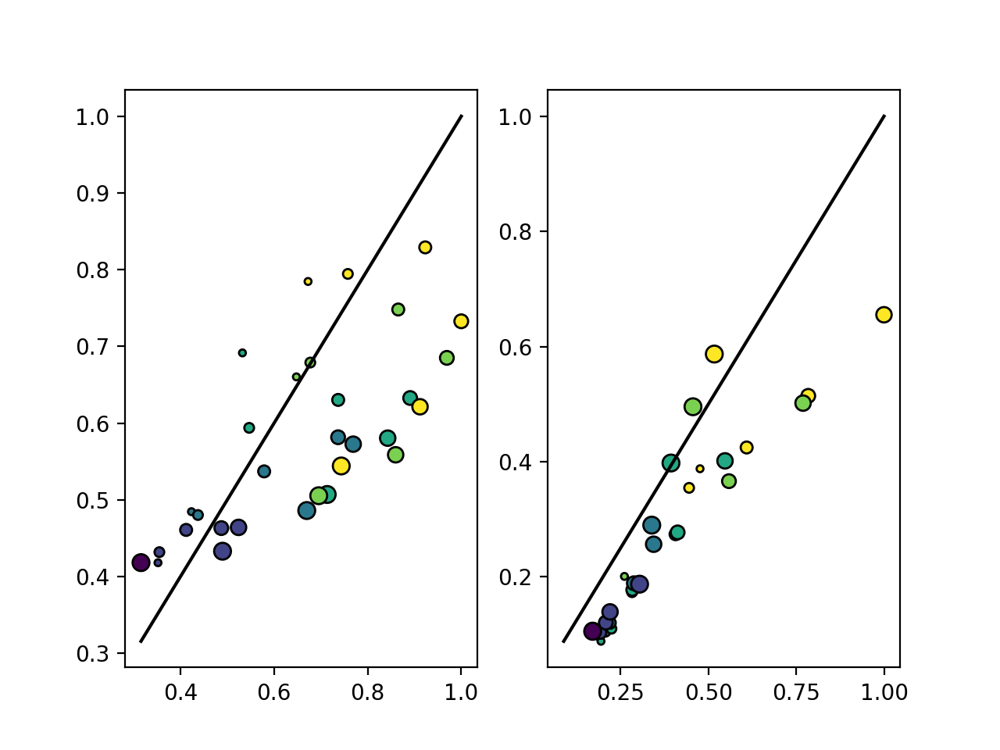

<IPython.core.display.Javascript object>


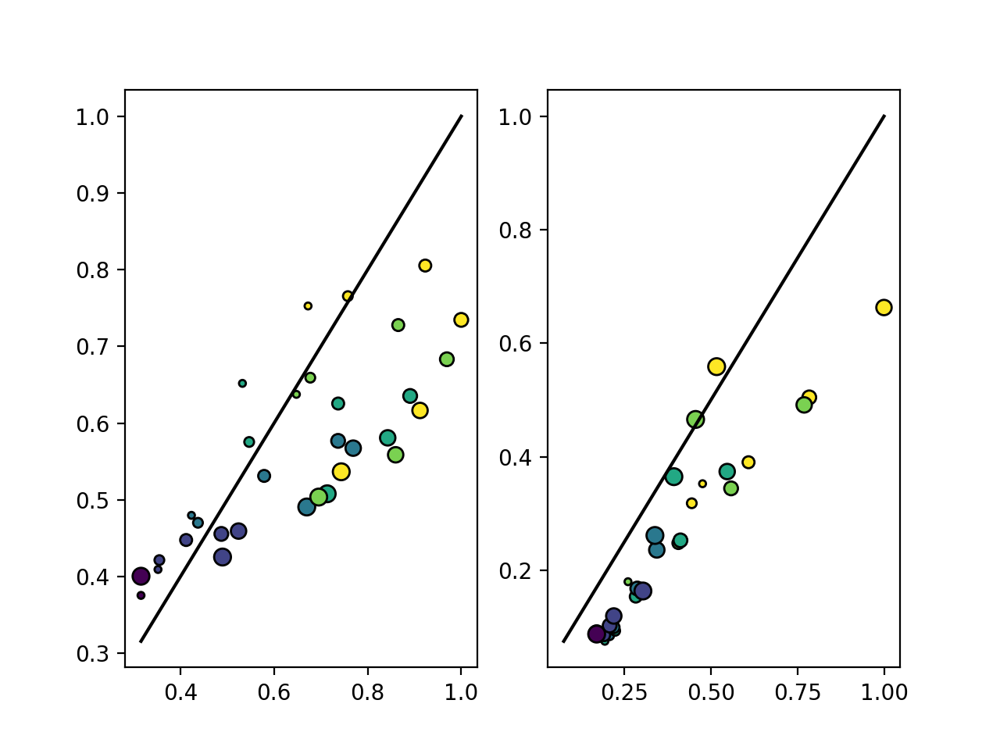

<IPython.core.display.Javascript object>


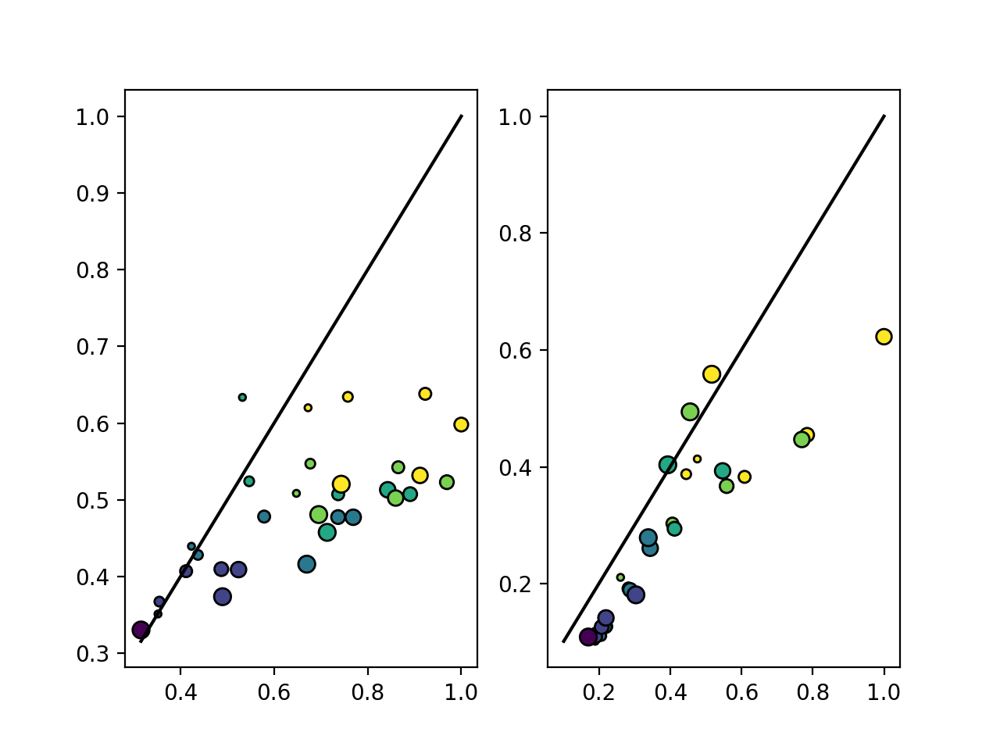

<IPython.core.display.Javascript object>


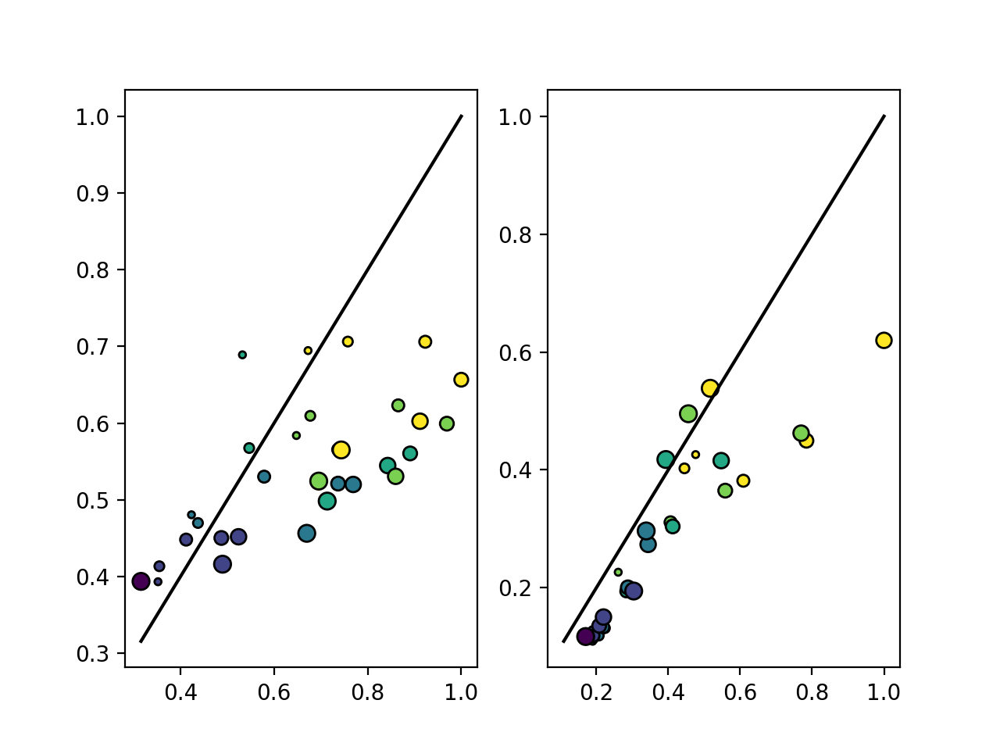

<IPython.core.display.Javascript object>


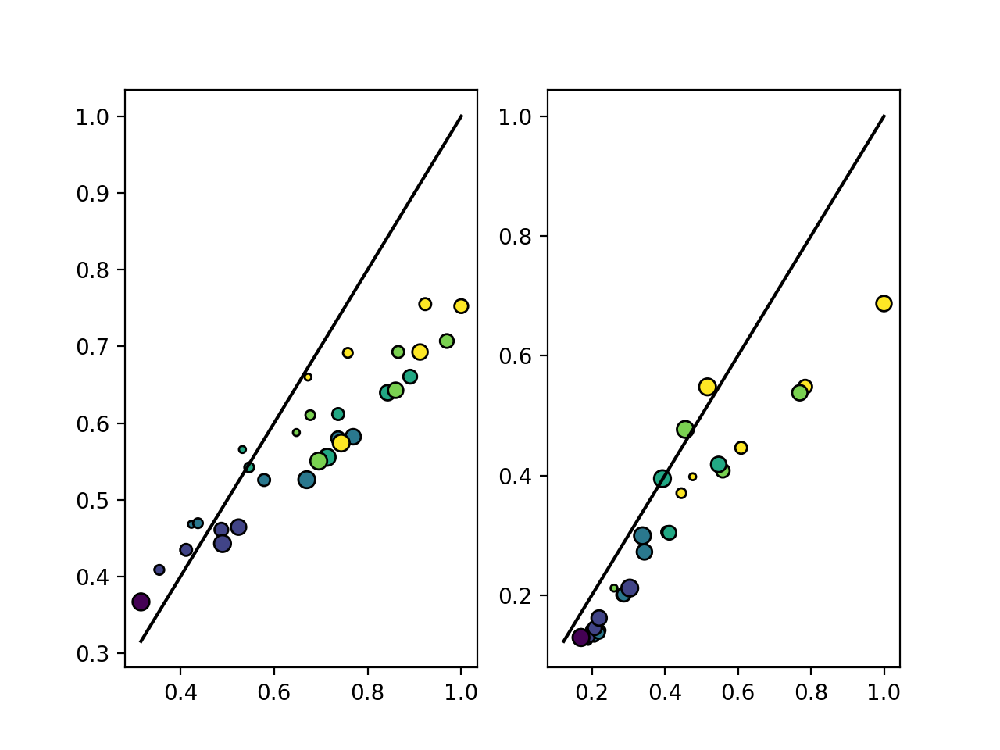

<IPython.core.display.Javascript object>


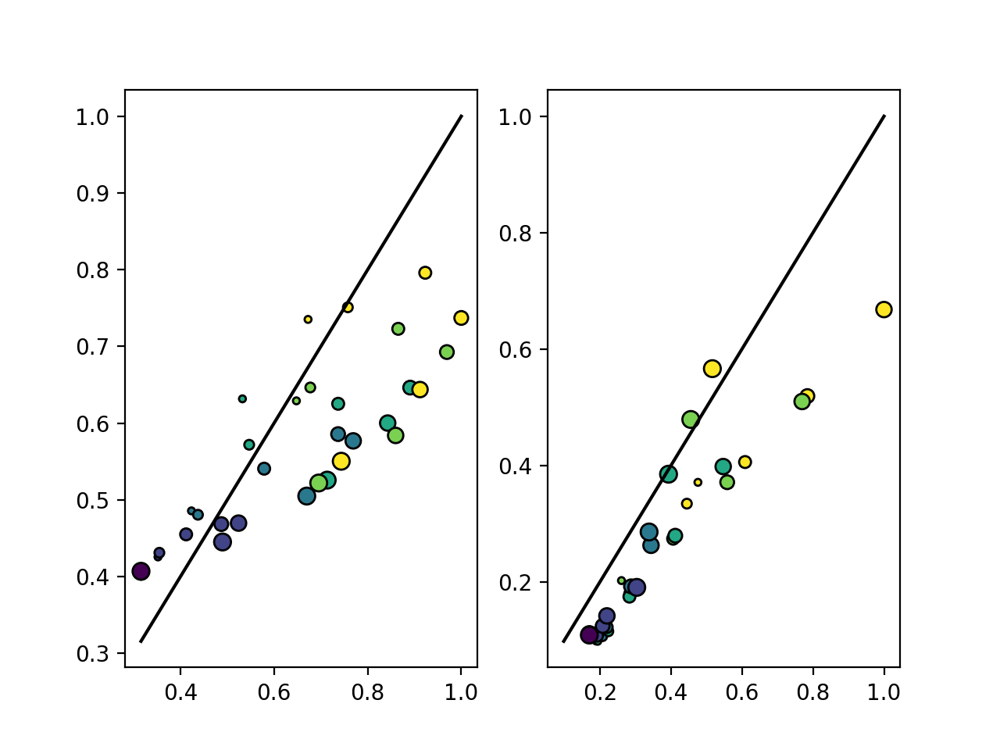

<IPython.core.display.Javascript object>


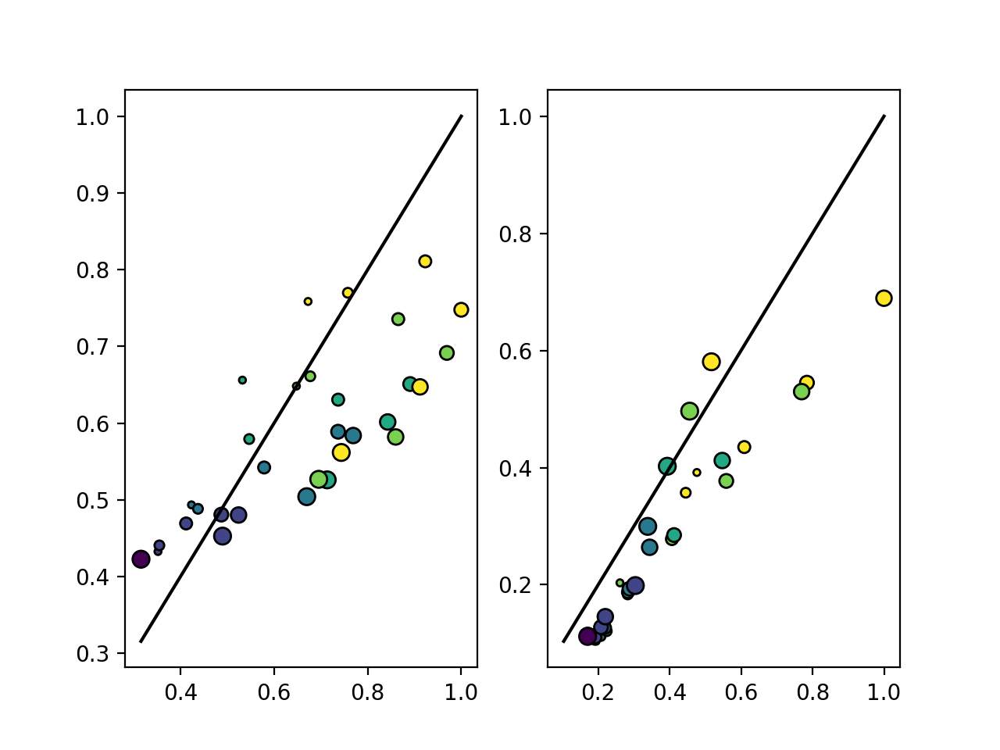

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


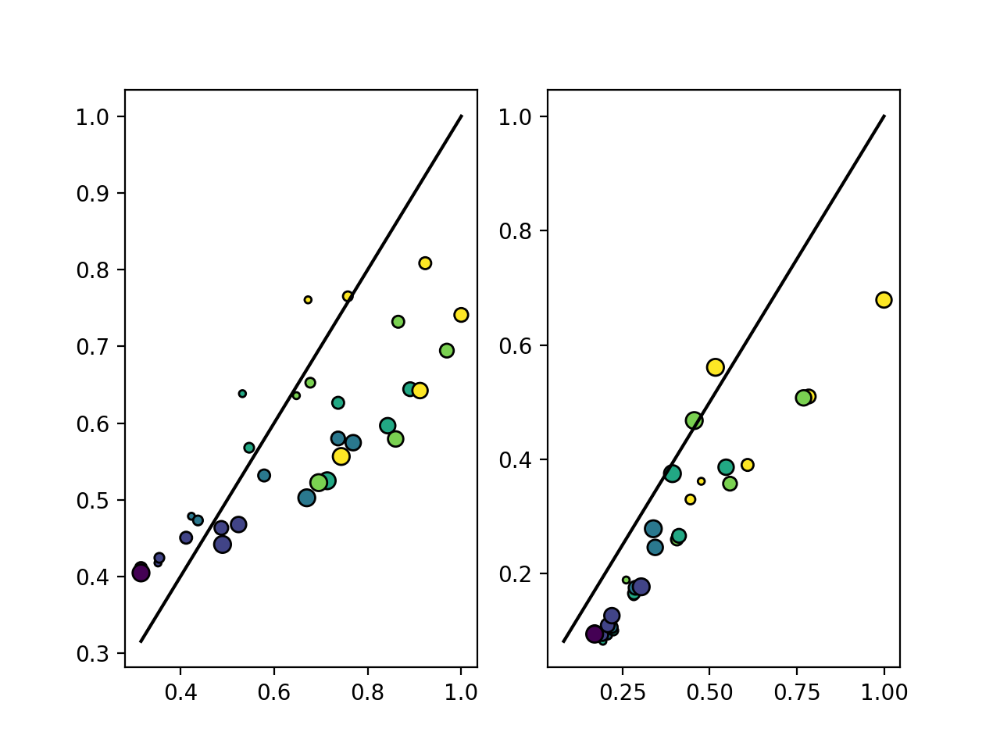

<IPython.core.display.Javascript object>


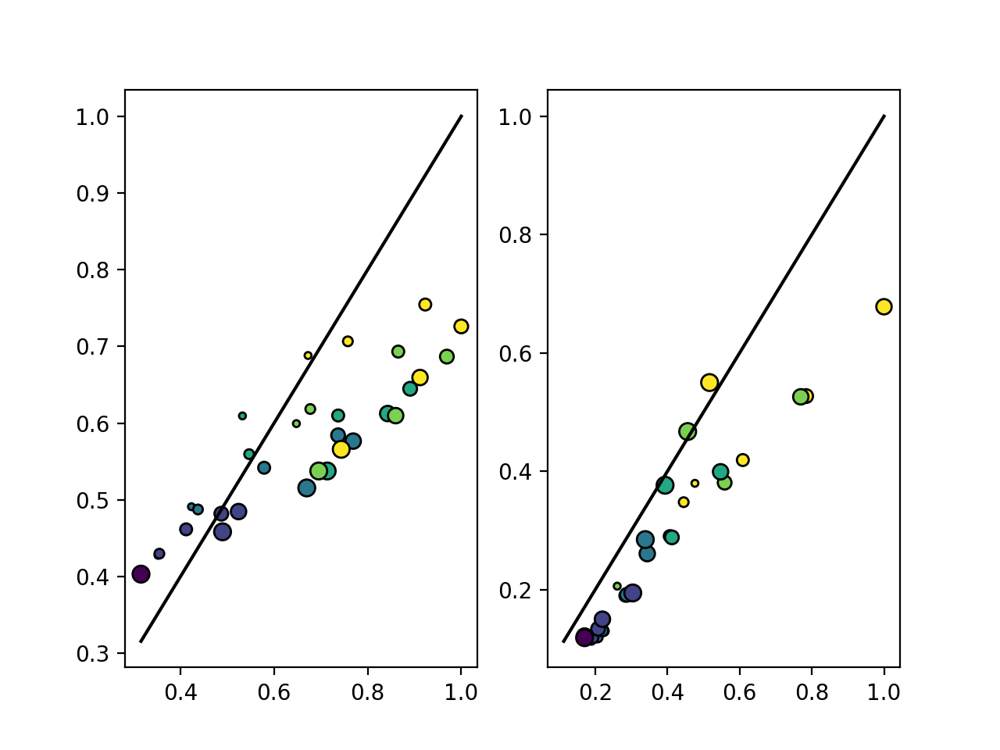

<IPython.core.display.Javascript object>


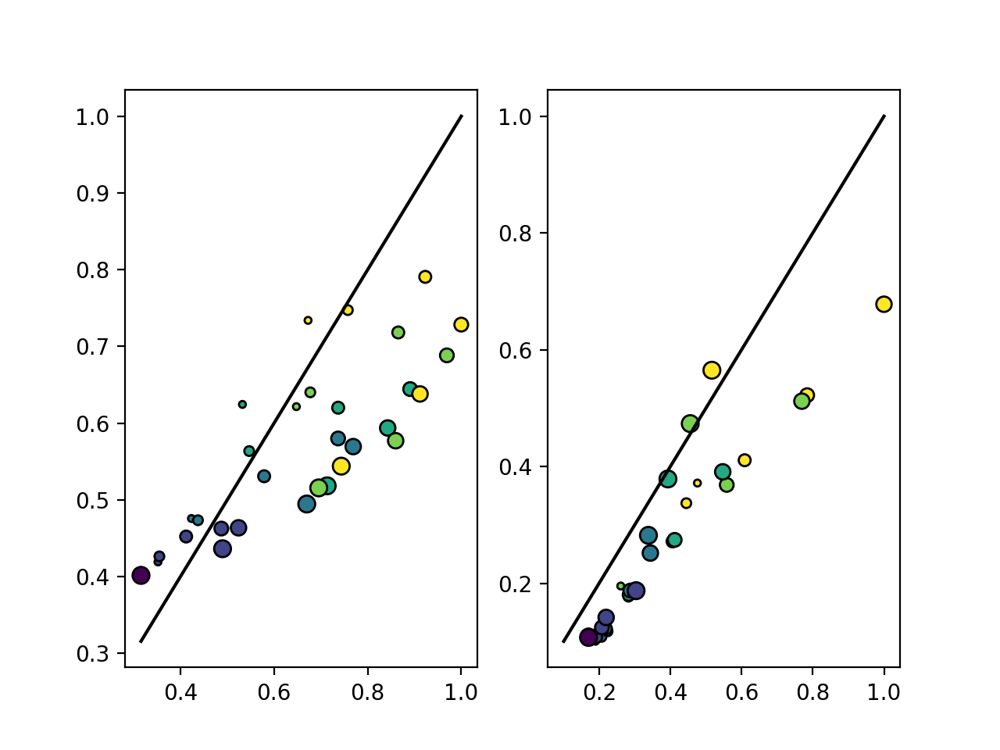

<IPython.core.display.Javascript object>


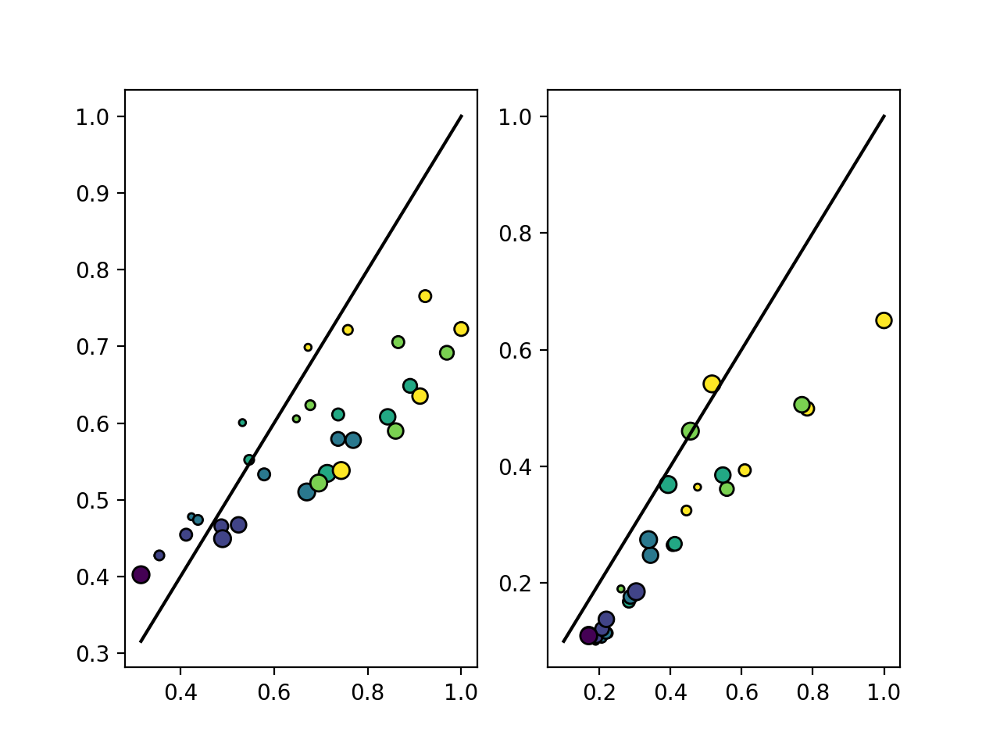

<IPython.core.display.Javascript object>


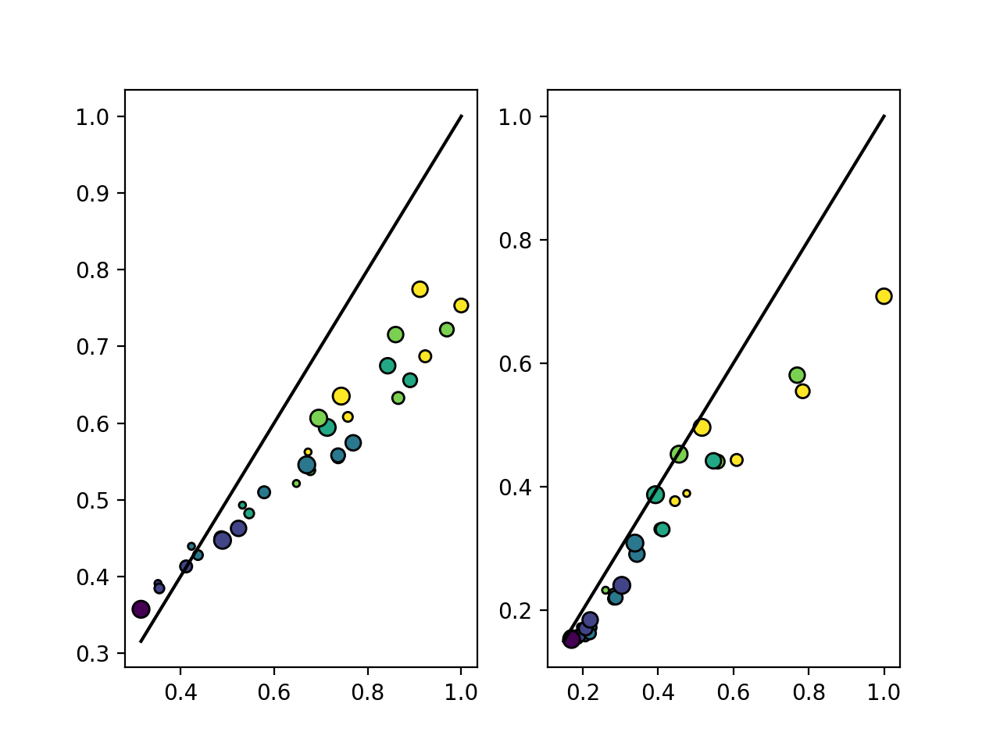

<IPython.core.display.Javascript object>


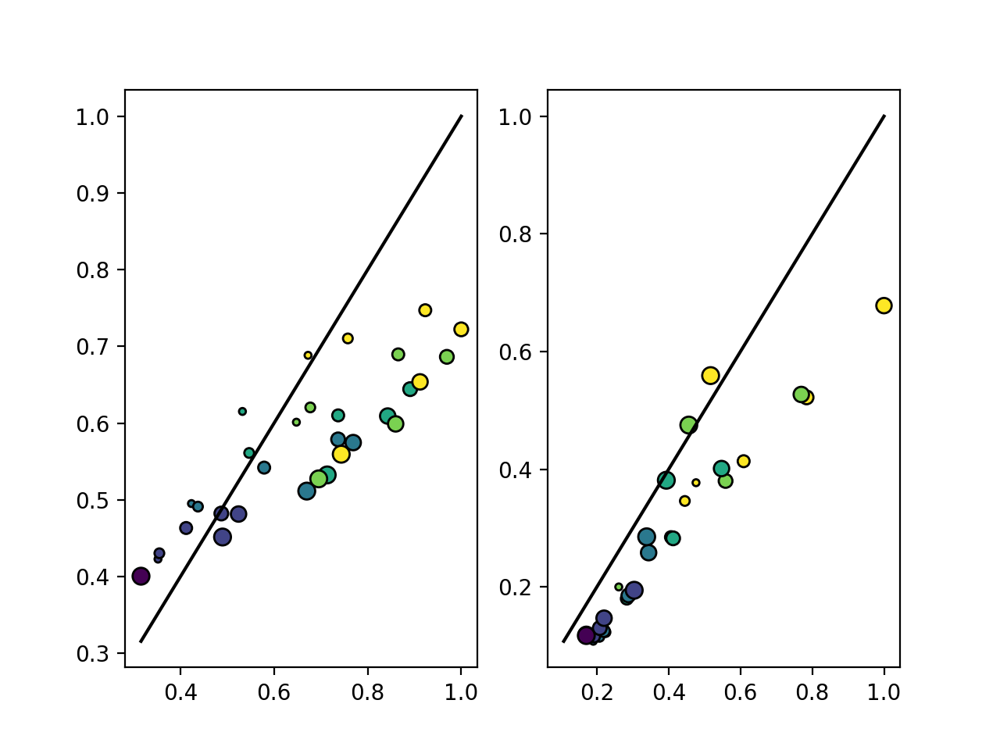

<IPython.core.display.Javascript object>


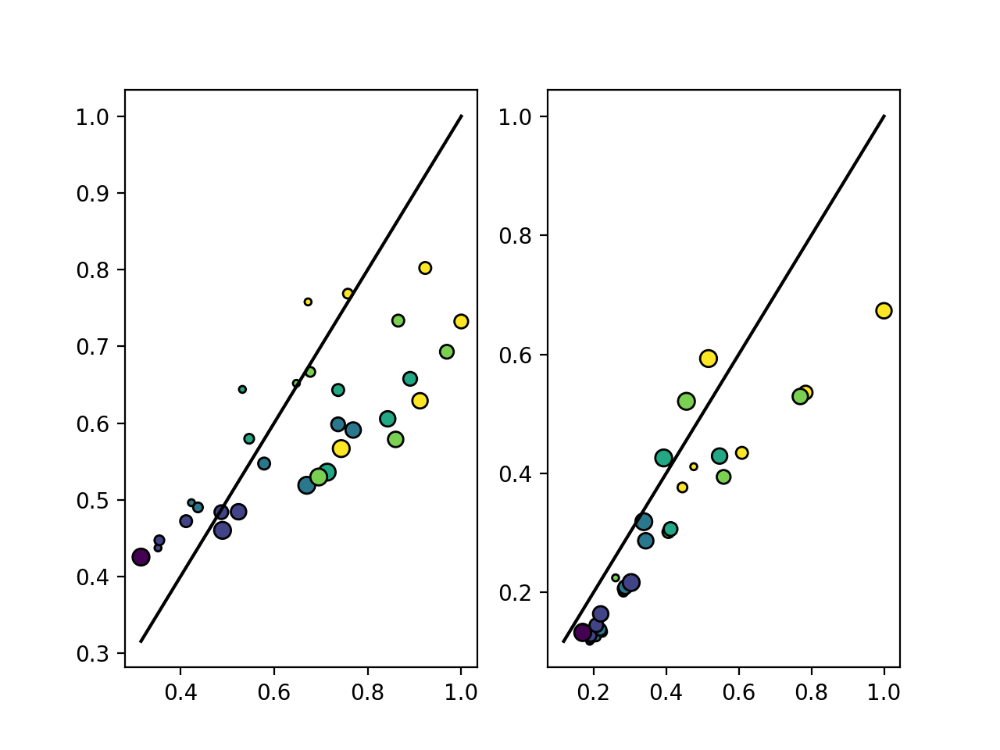

<IPython.core.display.Javascript object>


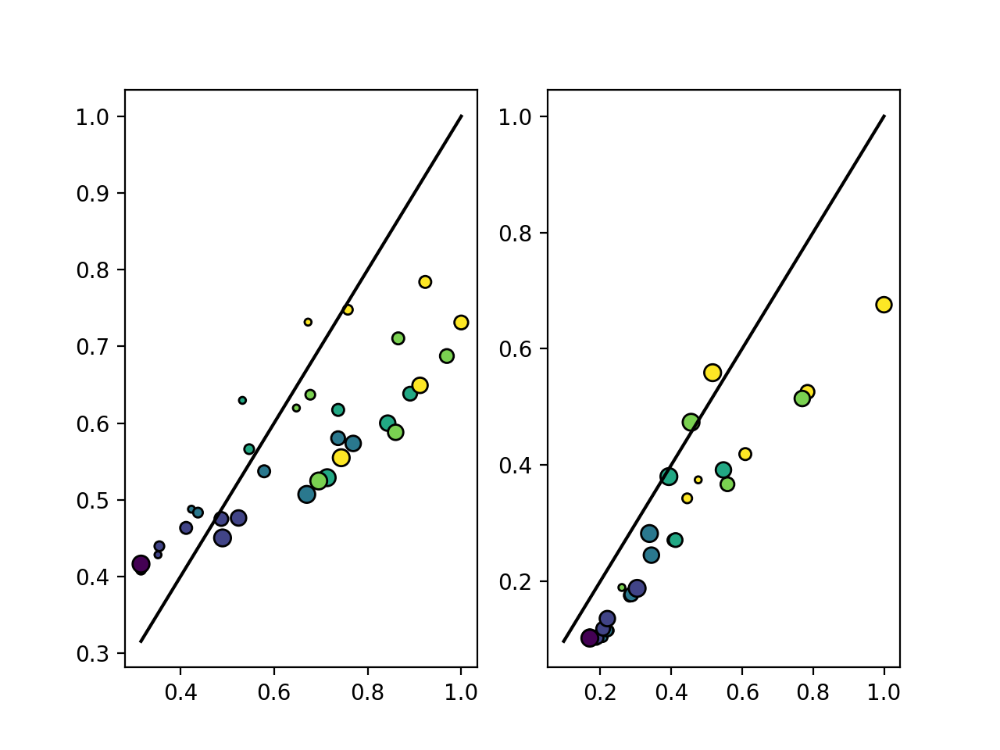

<IPython.core.display.Javascript object>


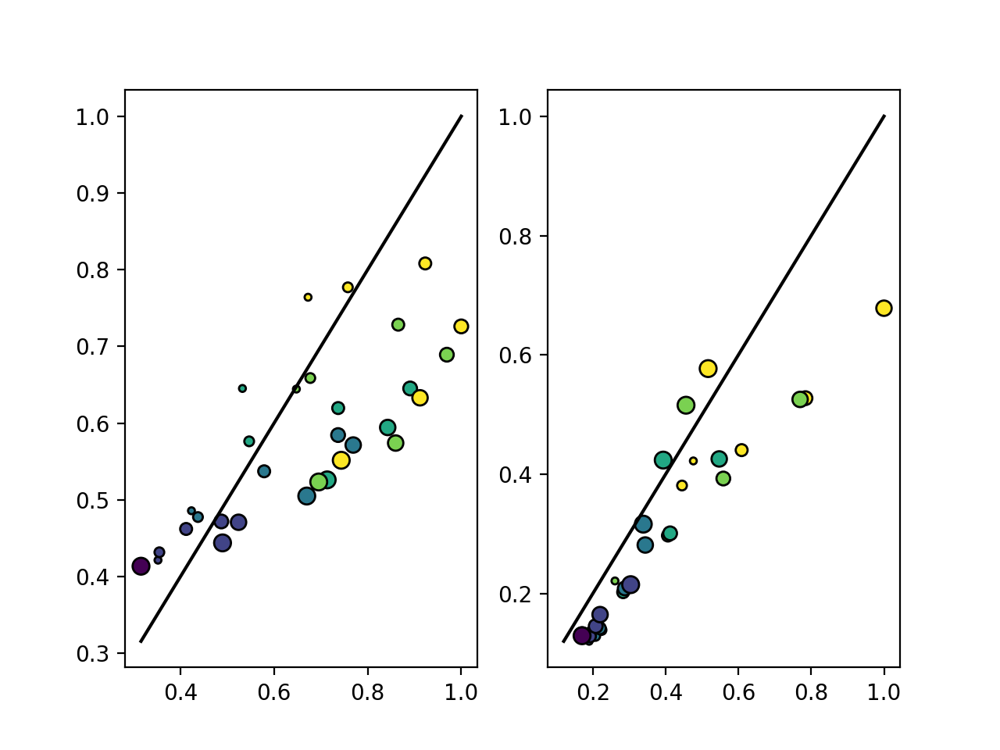

<IPython.core.display.Javascript object>


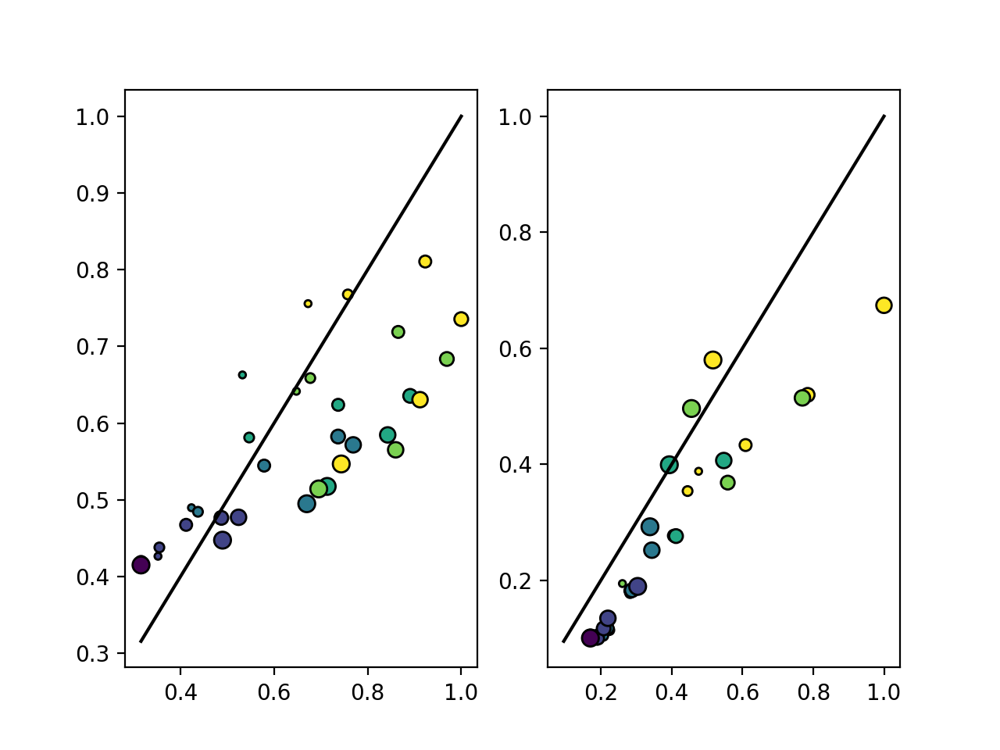

<IPython.core.display.Javascript object>


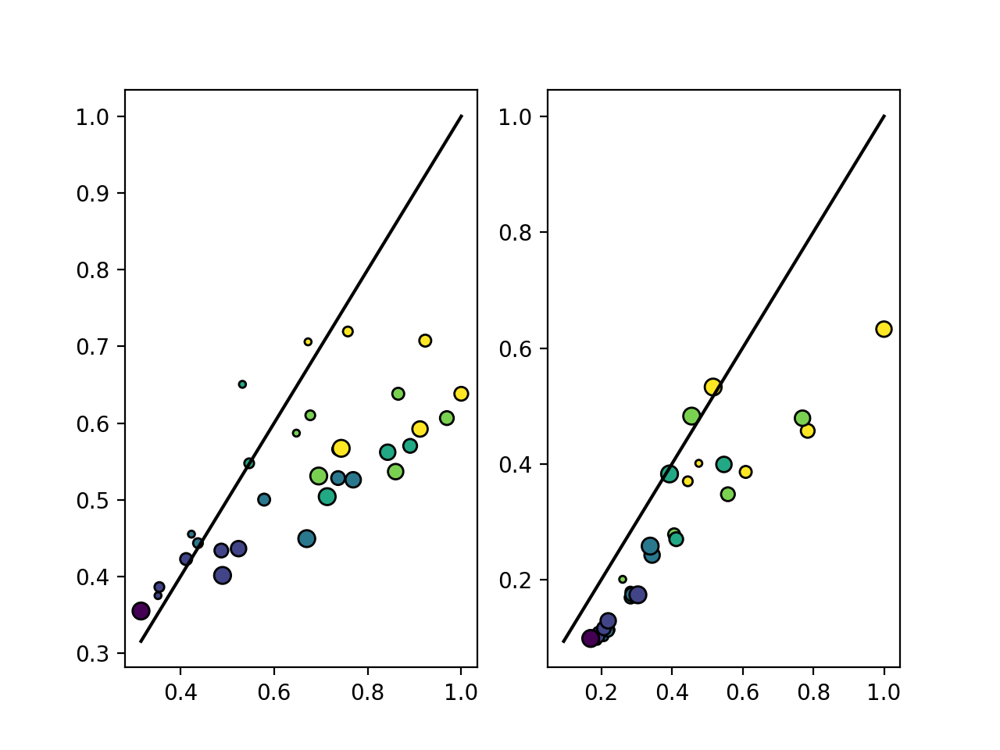

<IPython.core.display.Javascript object>


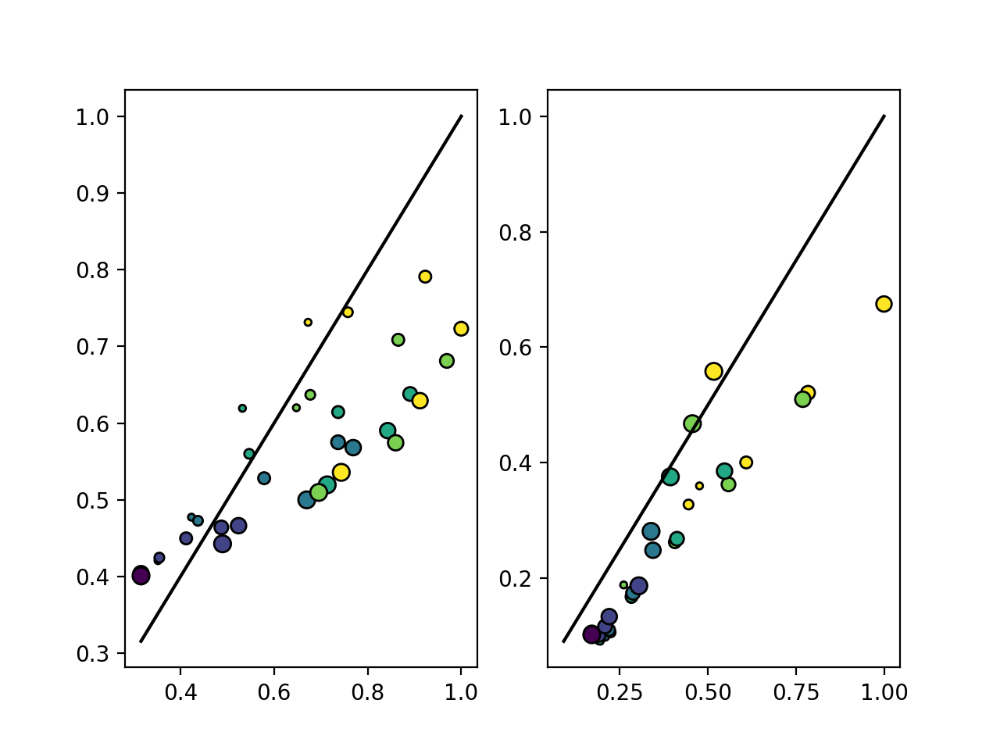

<IPython.core.display.Javascript object>


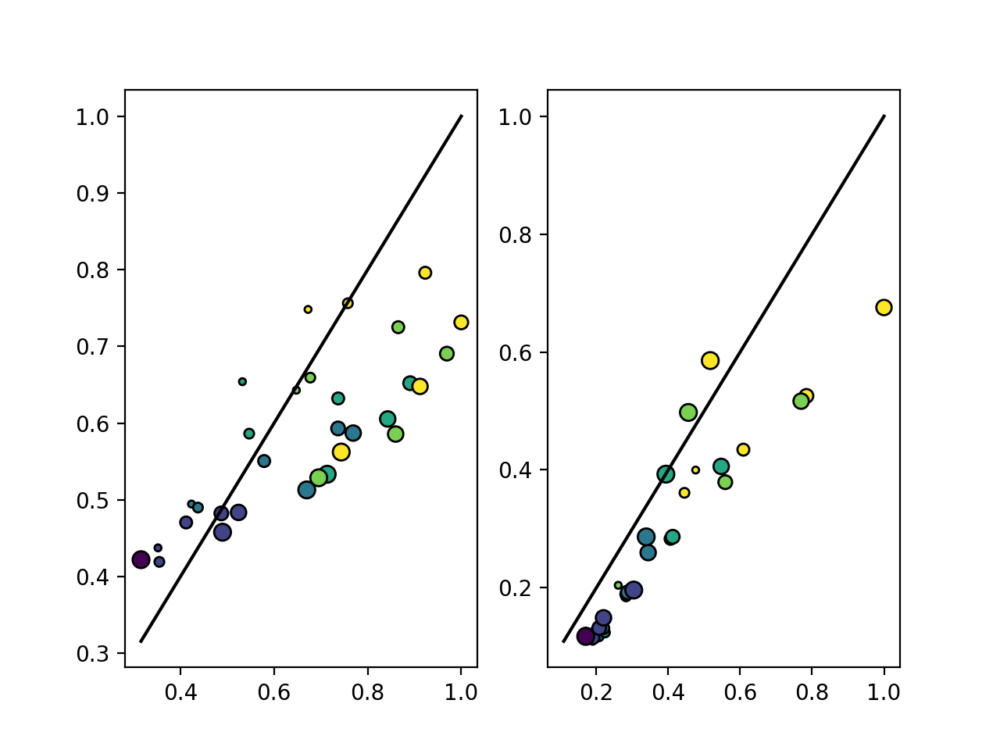

<IPython.core.display.Javascript object>


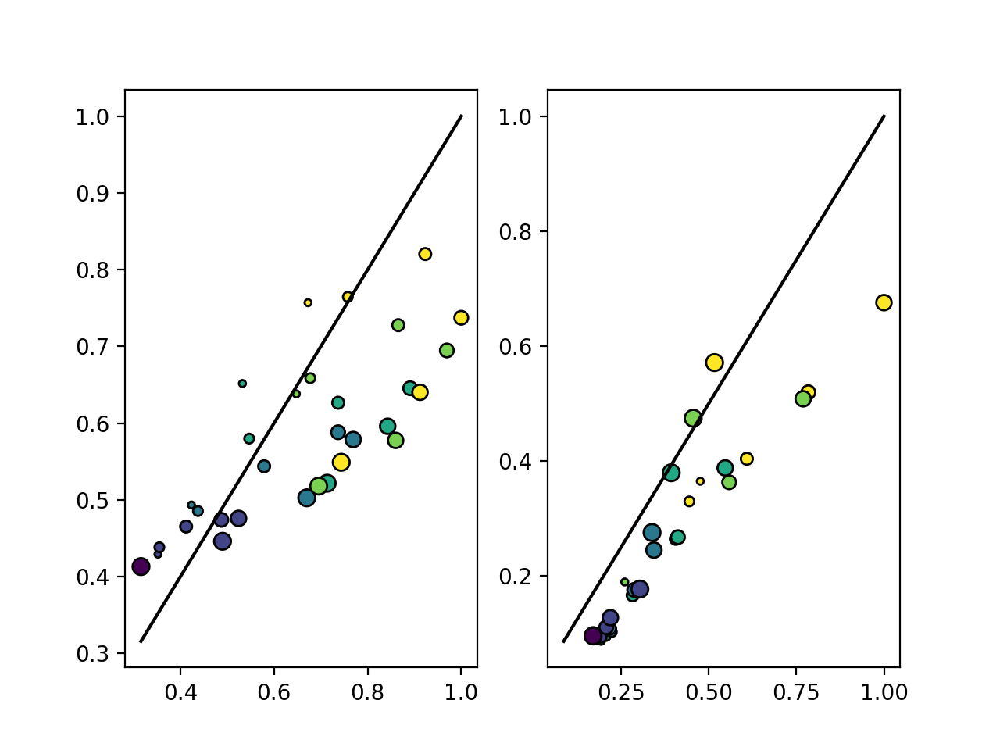

<IPython.core.display.Javascript object>


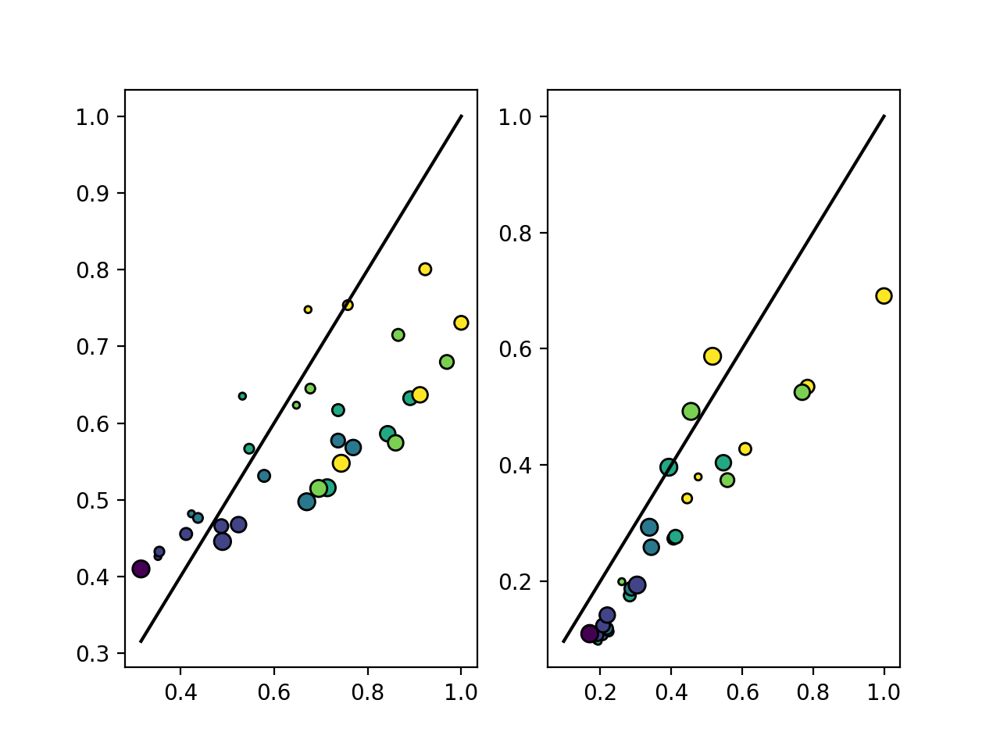

<IPython.core.display.Javascript object>


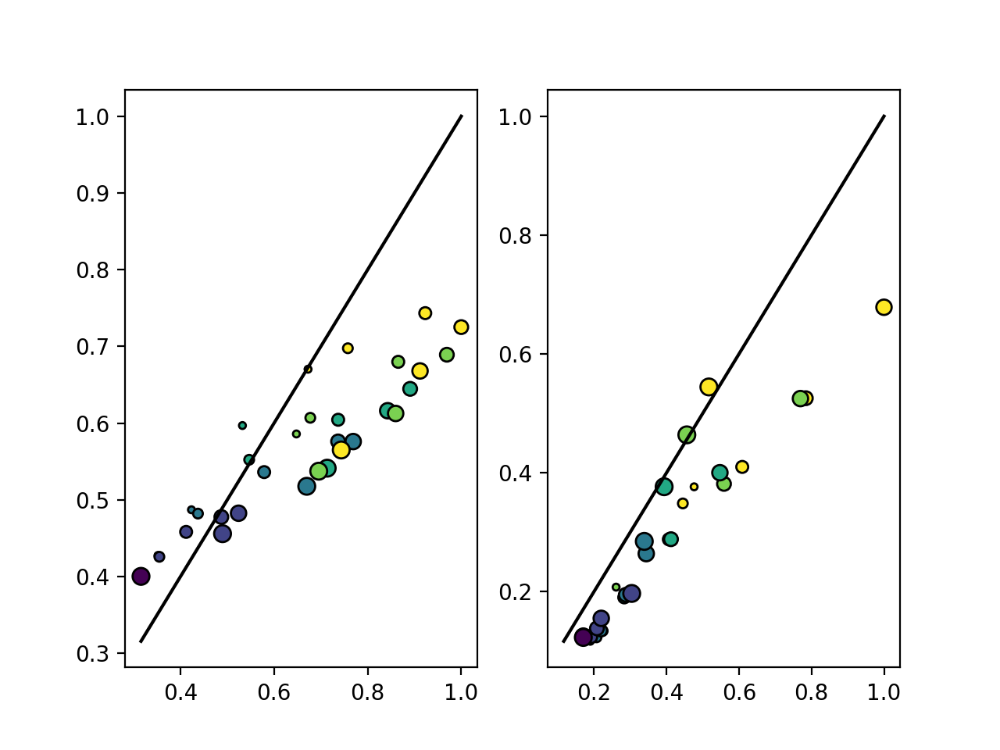

<IPython.core.display.Javascript object>


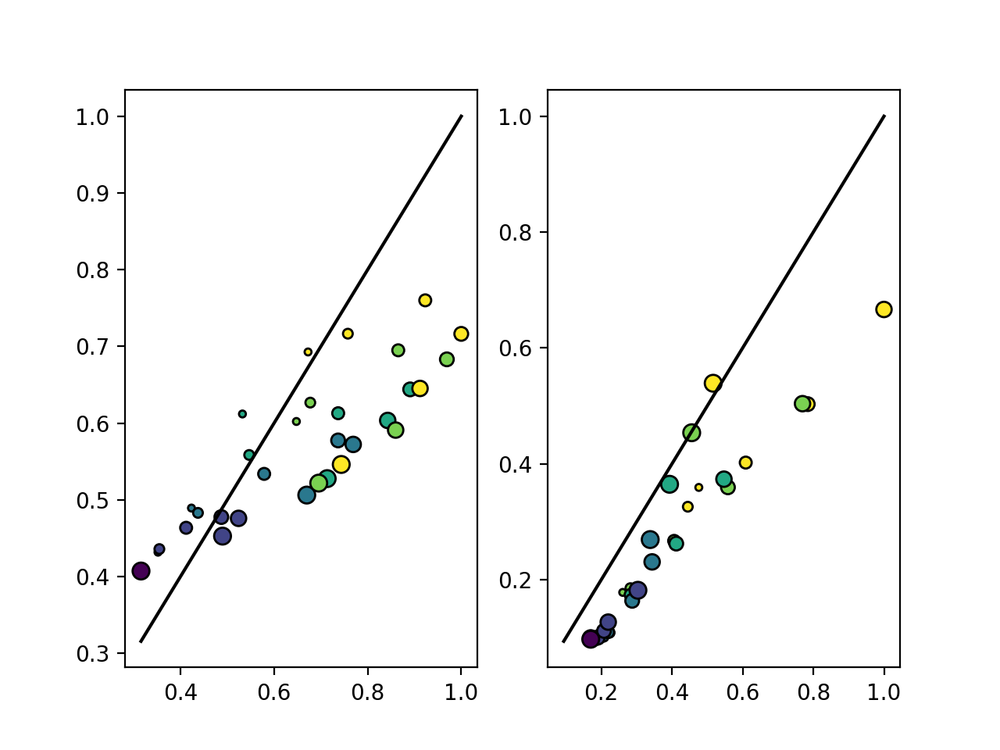

<IPython.core.display.Javascript object>


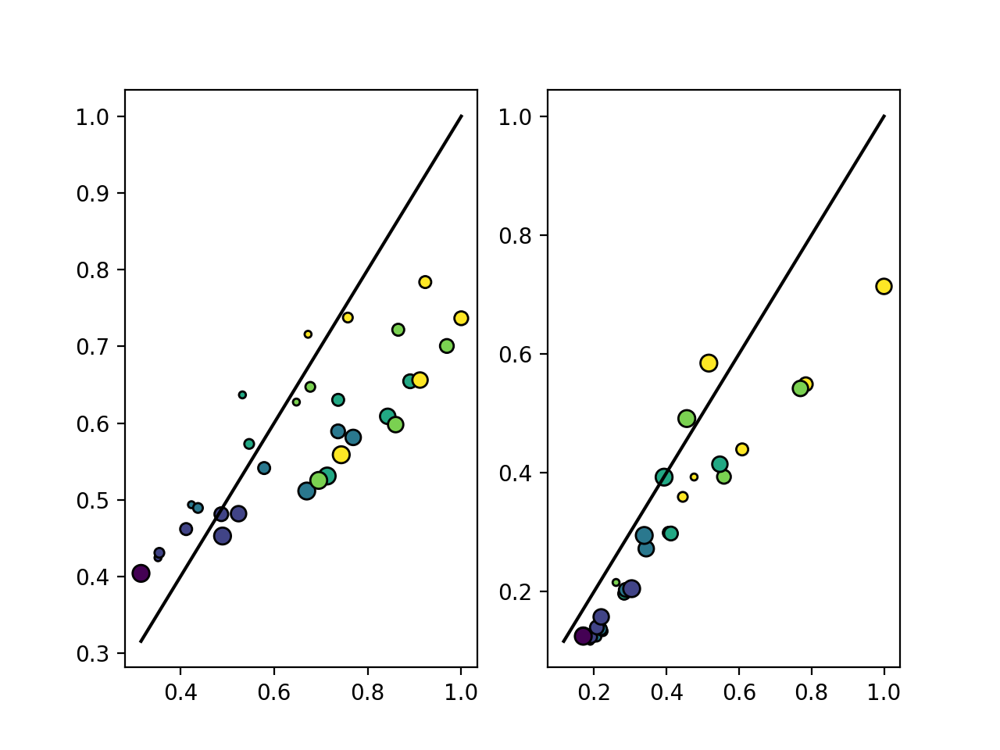

<IPython.core.display.Javascript object>


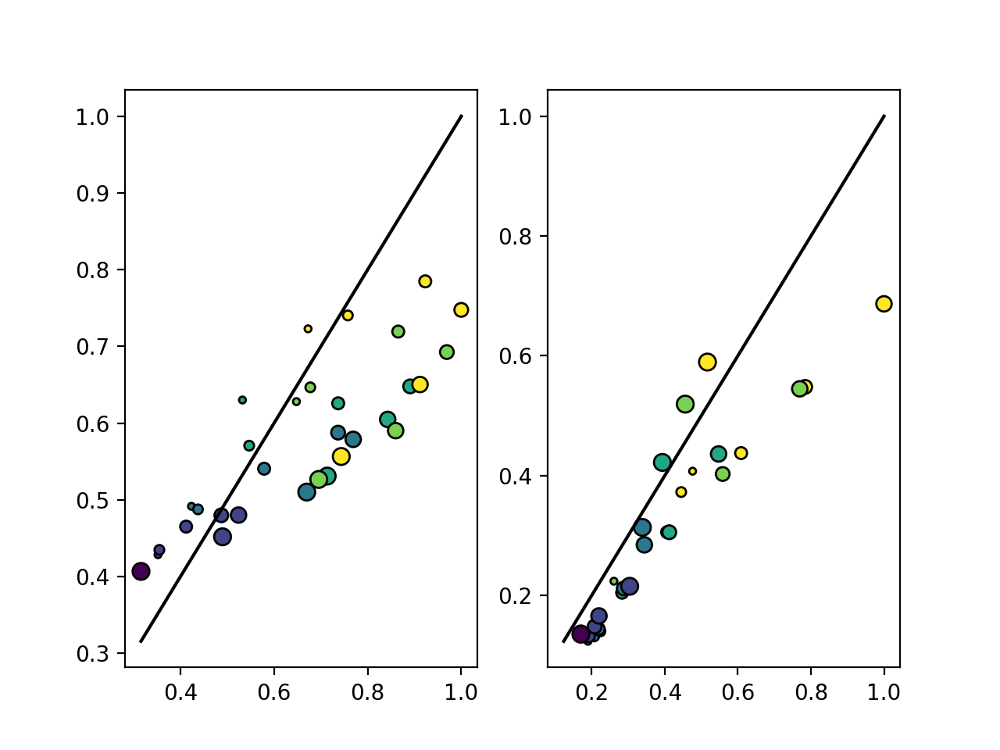

In [1245]:
types = [0,1]
ccs = np.zeros((nfiles,nQ*nS*nT))
for iwt in range(nfiles):
    if lkat[iwt]:
        plt.figure()
        for itype,thistype in enumerate(np.arange(2)):#nQ*nS*nT)):
            plt.subplot(1,2,itype+1)
            xdata = YYhat[:,thistype].reshape((6,6))
            ydata = YYs[iwt,:,:,thistype]

            sca.scatter_size_contrast(xdata,ydata)
            ccs[iwt,itype] = var_explained(xdata,ydata)

<IPython.core.display.Javascript object>


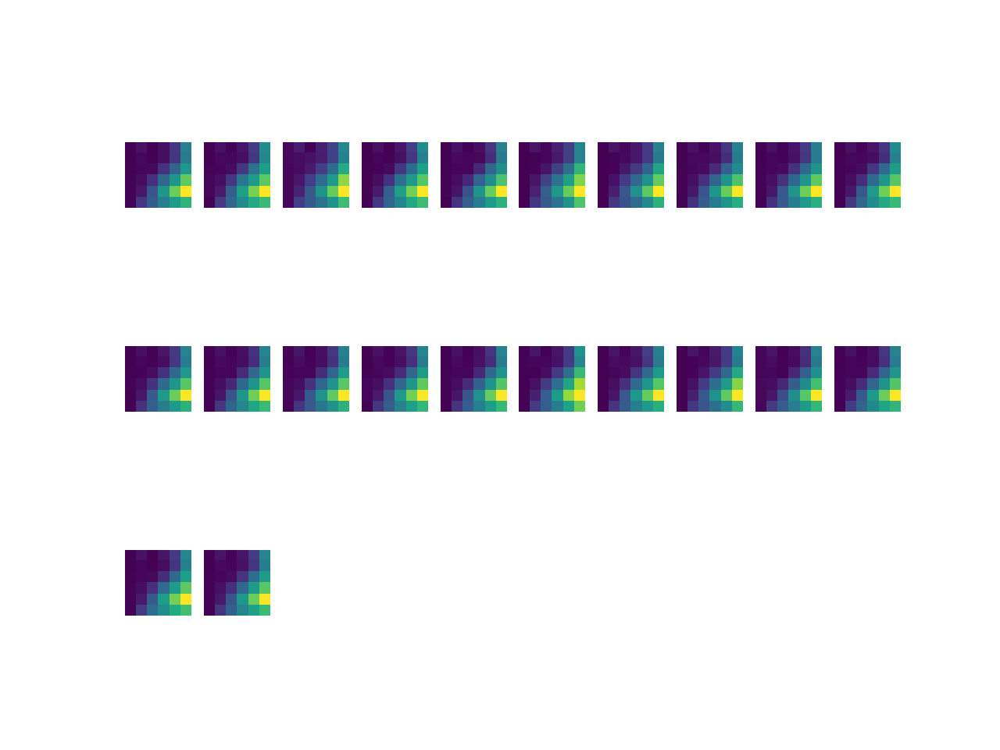

In [60]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,1])
    plt.axis('off')

<IPython.core.display.Javascript object>


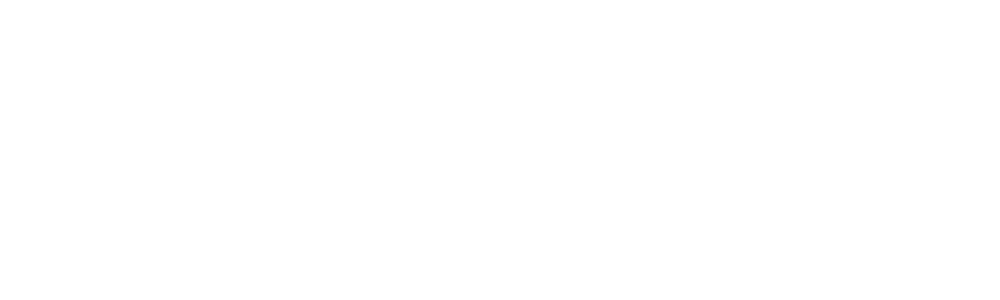

ValueError: num must be 1 <= num <= 30, not 31

In [176]:
plt.figure(figsize=(10,3))
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    sca.scatter_size_contrast(YYs[iwt,:,:,0],YYs[iwt,:,:,1])
    plt.axis('off')

<IPython.core.display.Javascript object>


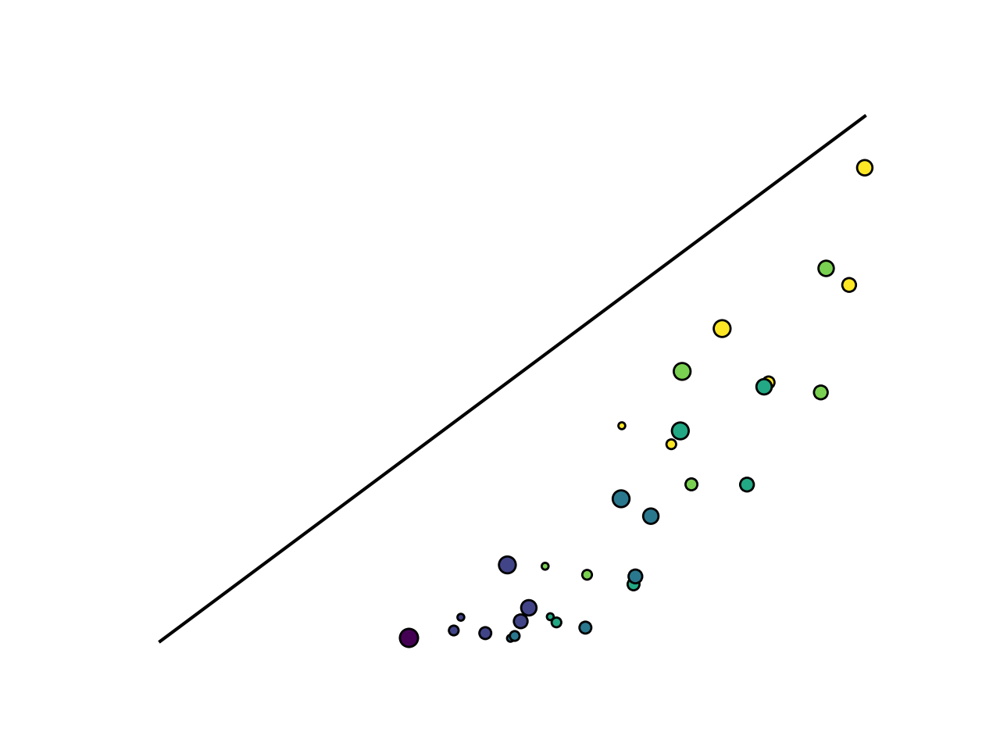

(0.14007571213636724,
 0.7795237759030426,
 0.14007571213636724,
 0.7795237759030426)

In [62]:
iwt = 13
plt.figure()#figsize=(10,3))
sca.scatter_size_contrast(YYs[iwt,:,:,0],YYs[iwt,:,:,1],equate_0=True)
plt.axis('off')

<IPython.core.display.Javascript object>


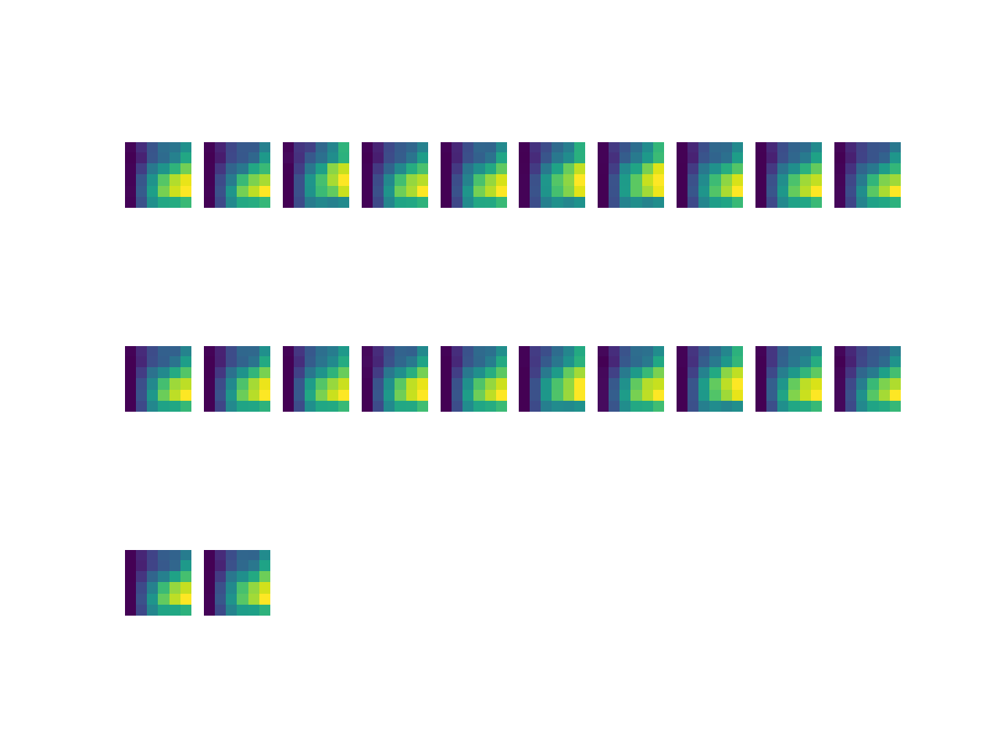

In [63]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,0])
    plt.axis('off')

<IPython.core.display.Javascript object>


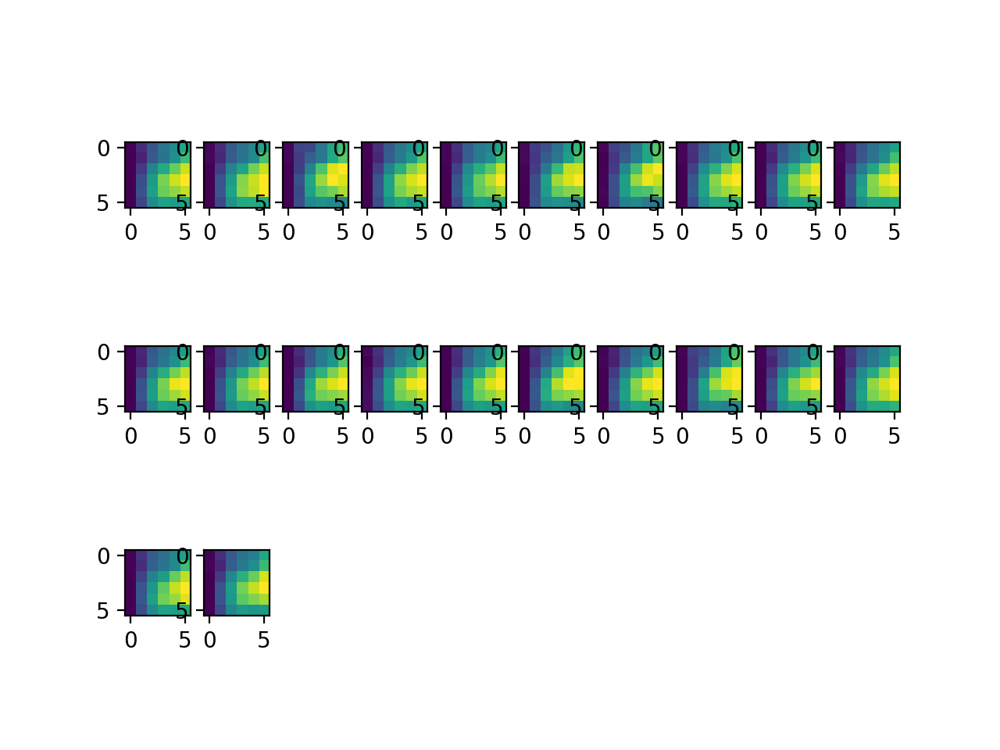

In [64]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,3])

In [65]:
nfiles = len(weights_files)
Ts = np.zeros((nfiles,nQ))
Ks = np.zeros((nfiles,nQ))
Wmys = np.zeros((nfiles,nQ,nQ))
Wmxs = np.zeros((nfiles,nP,nQ))
couplings_appr = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
Xcouplings_appr = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
    tiled_s02 = np.tile(s02,nS*nT)
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
        Weff = WWmy @ Phi
        powers = [np.linalg.matrix_power(Weff,n) for n in range(3)]
        appr = sum(powers)
        couplings_appr[iwt,iistim,jjstim] = Phi @ appr
        Xcouplings_appr[iwt,iistim,jjstim] = WWmx @ Phi @ appr
# couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))


<IPython.core.display.Javascript object>


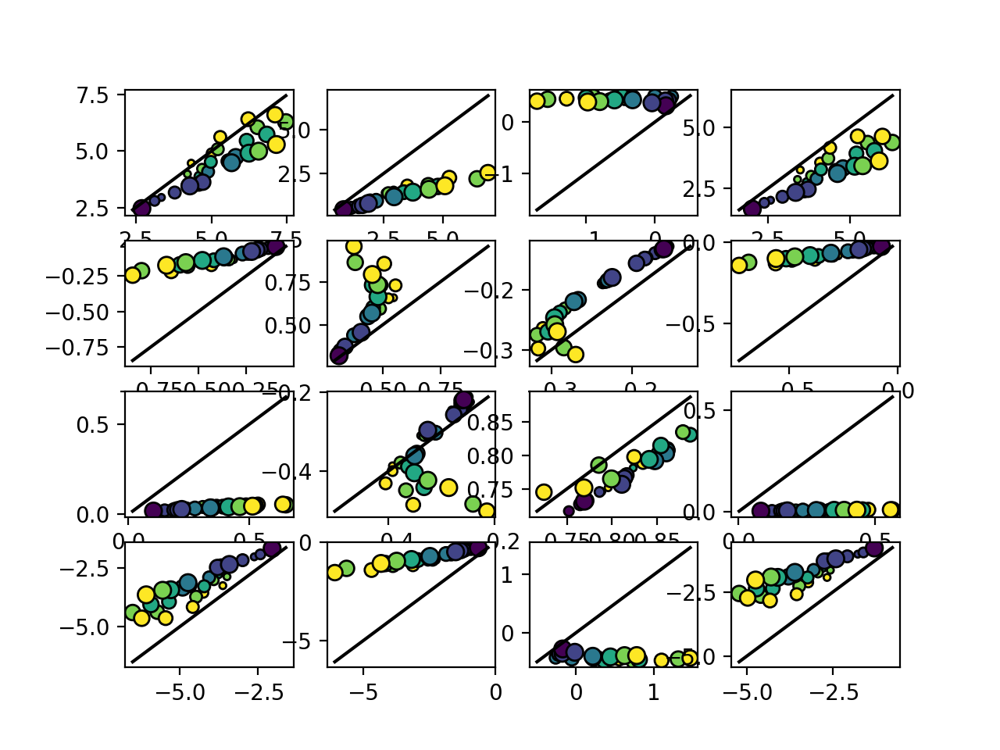

In [66]:
plt.figure()
for i1 in range(nQ):
    for i2 in range(nQ):
        plt.subplot(nQ,nQ,i1*nQ+i2+1)
        sca.scatter_size_contrast(couplings[0,:,:,i1,i2],couplings_appr[0,:,:,i1,i2])

<IPython.core.display.Javascript object>


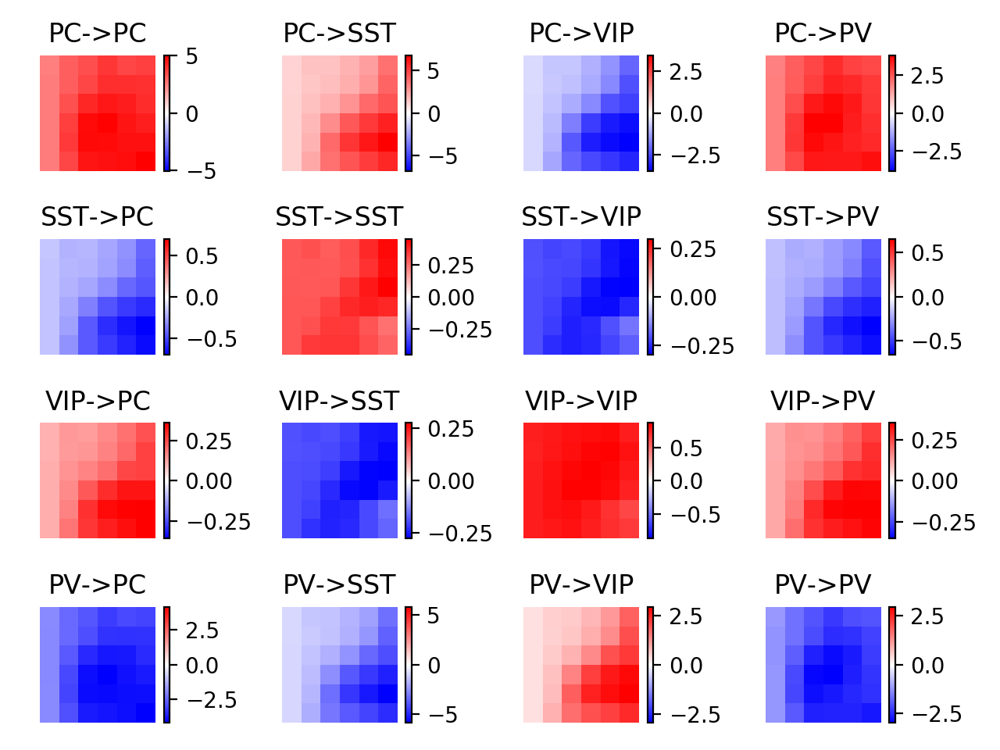

<IPython.core.display.Javascript object>


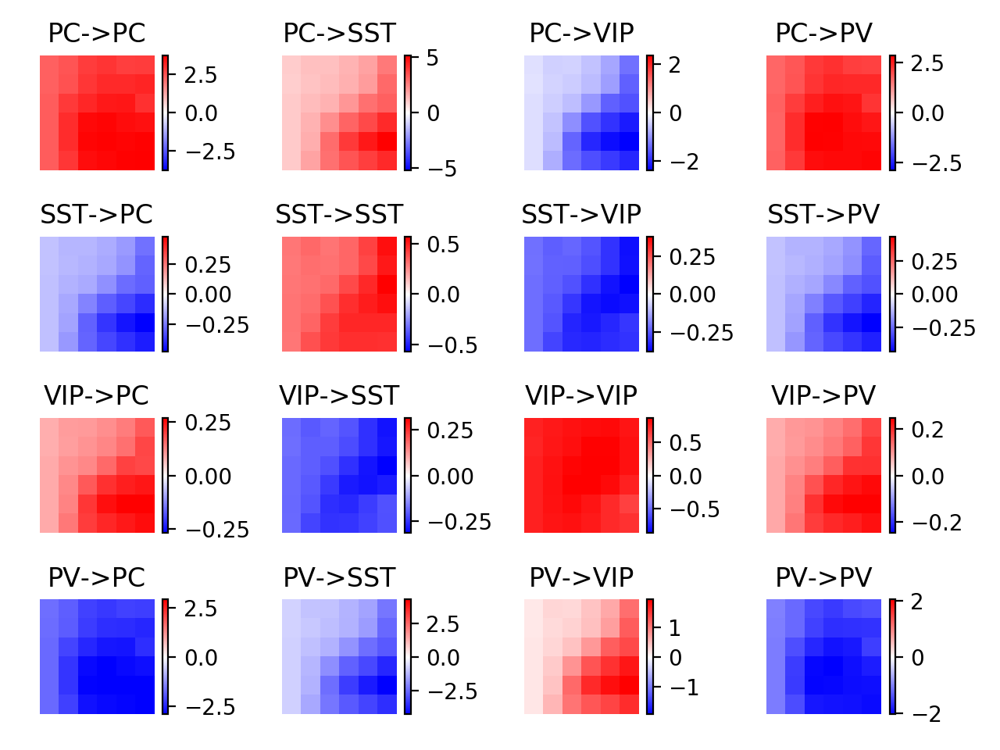

<IPython.core.display.Javascript object>


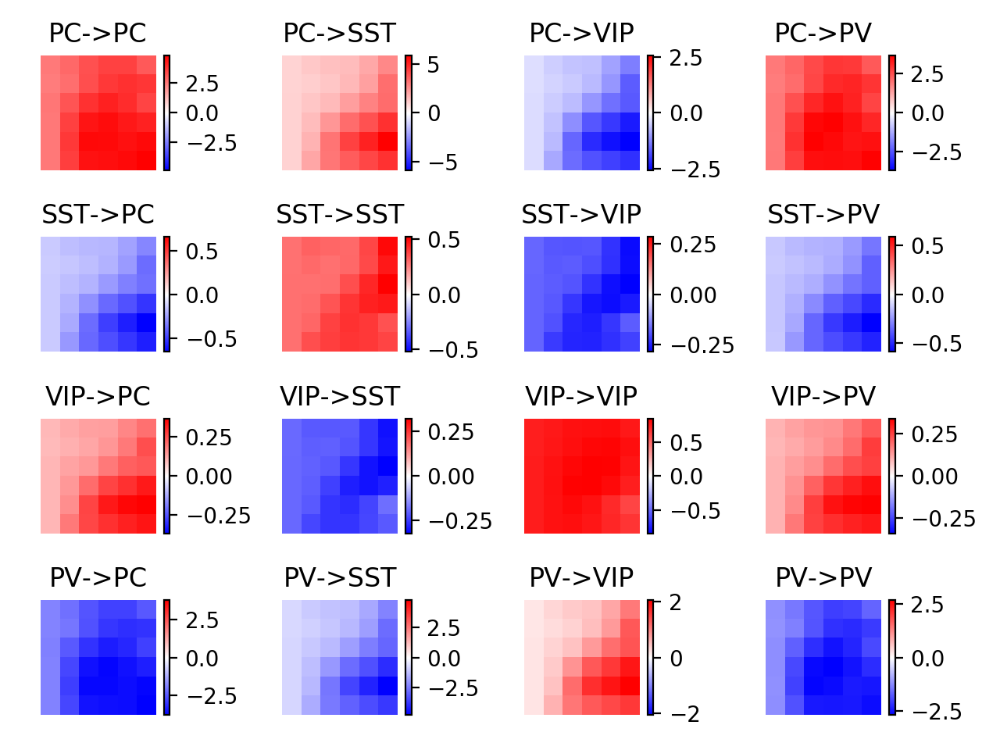

<IPython.core.display.Javascript object>


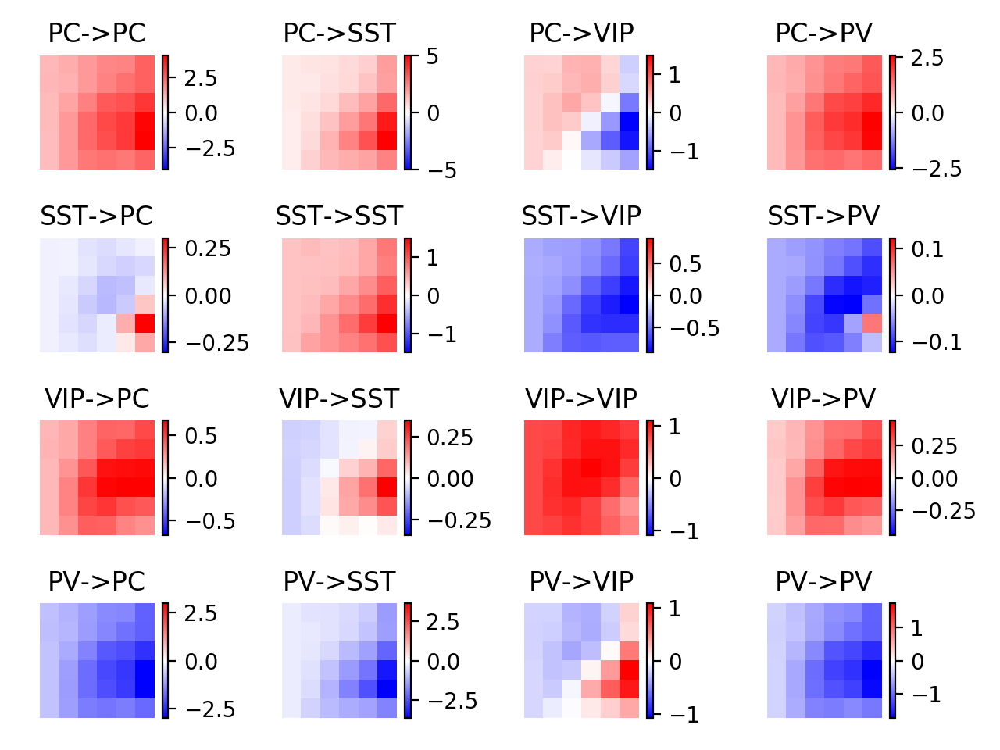

<IPython.core.display.Javascript object>


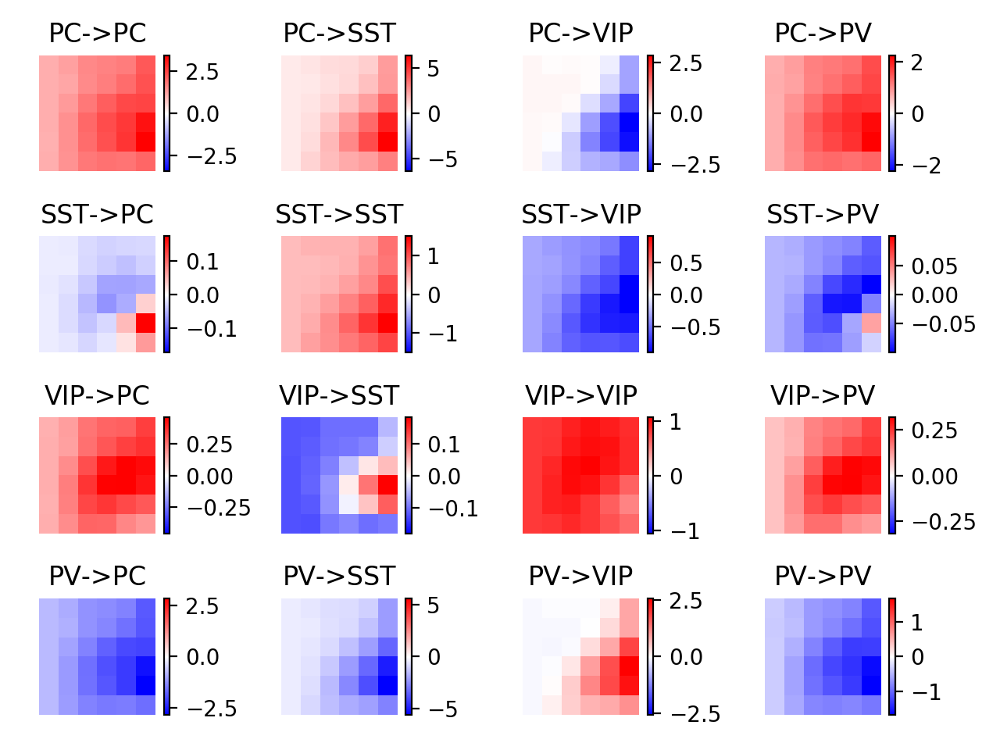

<IPython.core.display.Javascript object>


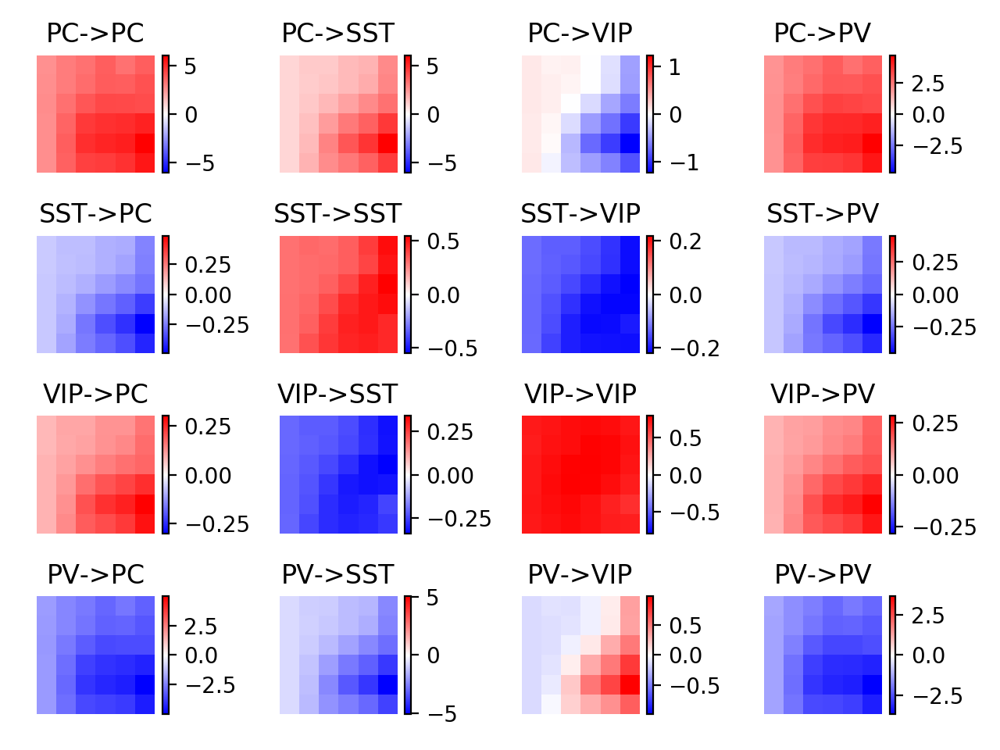

<IPython.core.display.Javascript object>


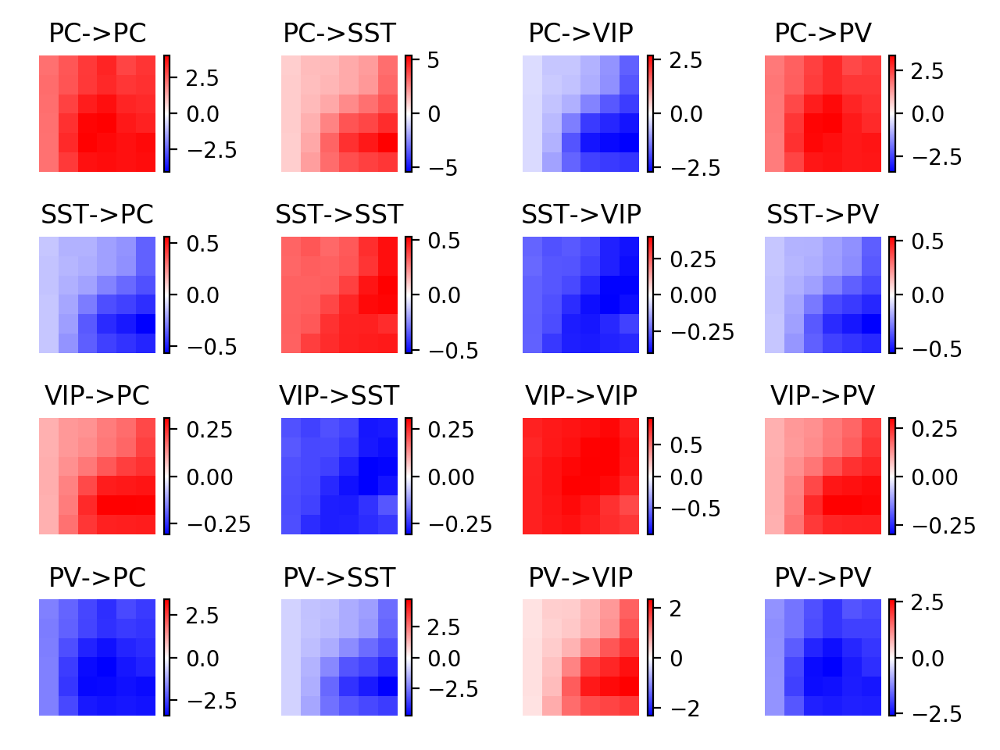

<IPython.core.display.Javascript object>


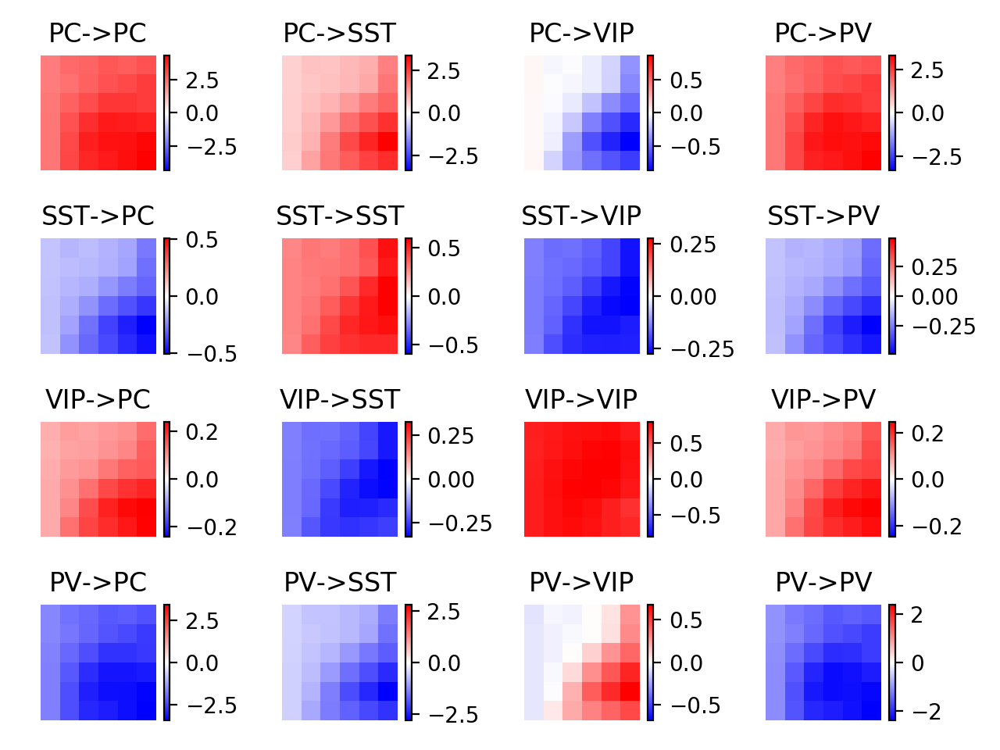

<IPython.core.display.Javascript object>


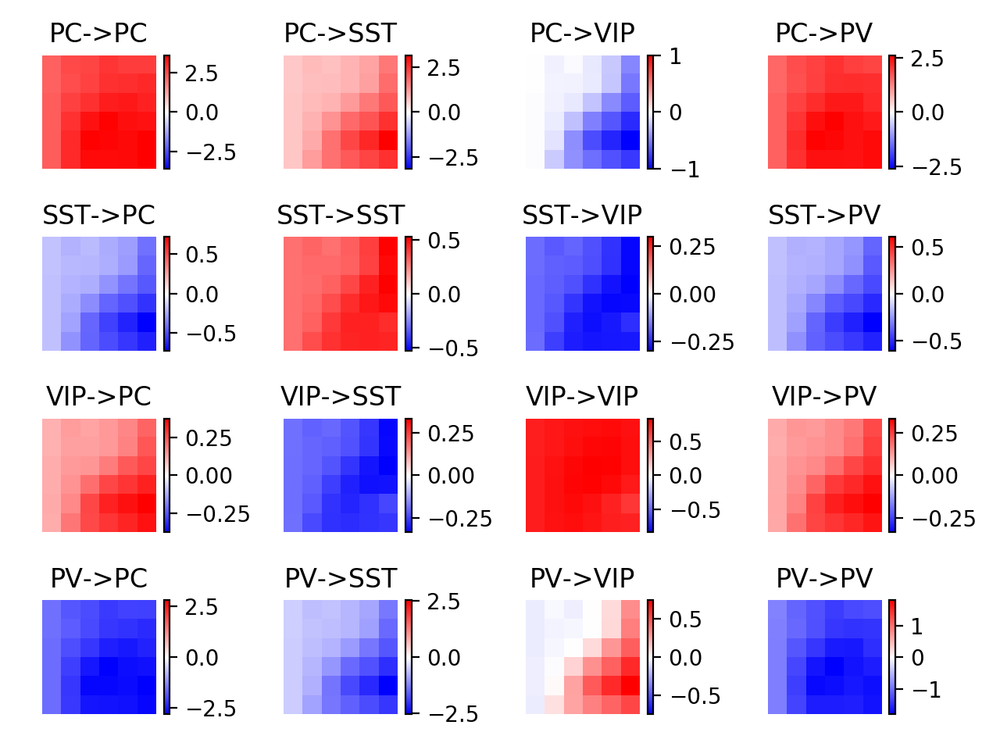

In [686]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

In [712]:
lkat

array([False, False,  True, False, False, False, False, False, False,
       False, False, False, False,  True, False, False, False,  True,
       False, False,  True, False, False,  True, False, False, False])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


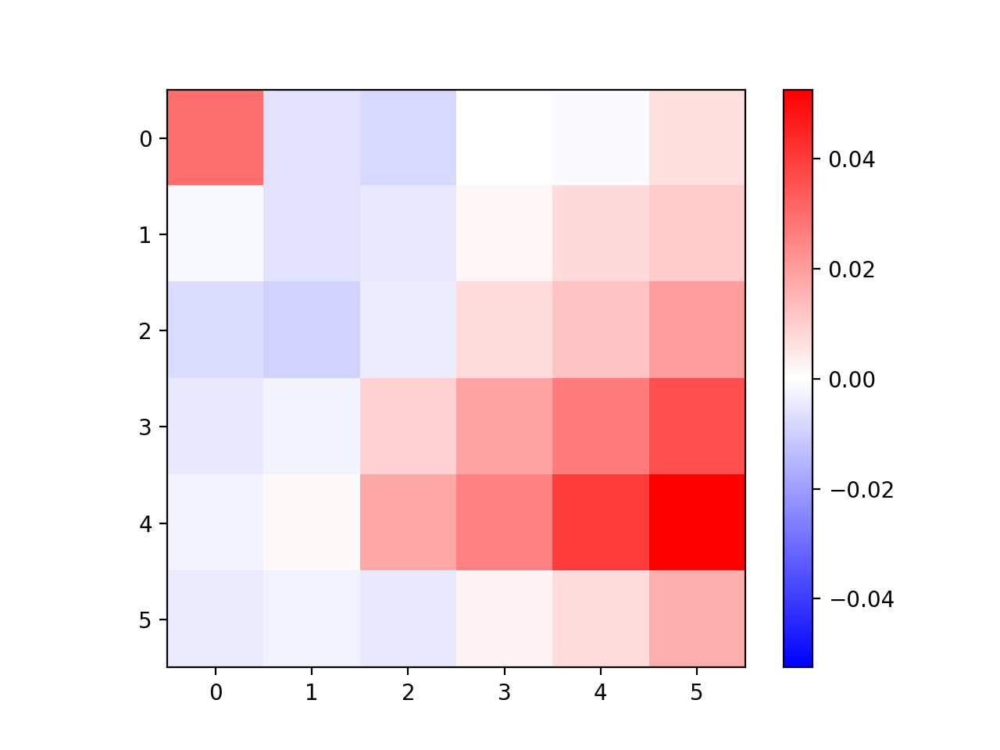

In [511]:
plt.figure()
data = np.nanmean(couplings[:,:,:,2,1],0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.colorbar()

In [955]:
datas

[array([], shape=(0, 6), dtype=float64)]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


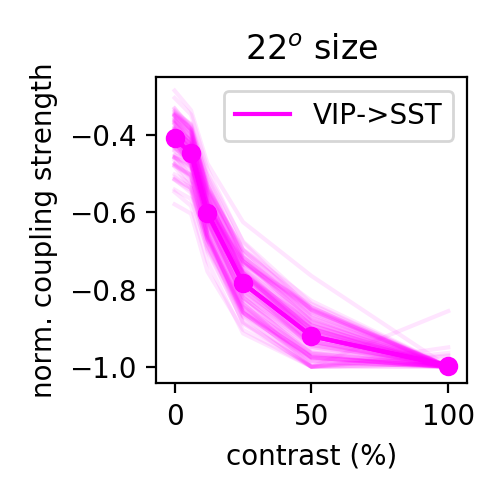

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.41969455446147647


In [1191]:
plt.figure(figsize=(2.5,2.5))
isize = 3
# datas = [couplings[:,isize,:,2,1]]
datas = [couplings[lkat,isize,:,2,1]]
colors = [np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['VIP->SST'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.1,c=color) #
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_traces.jpg',dpi=300)

In [920]:
lkat.sum()

4

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


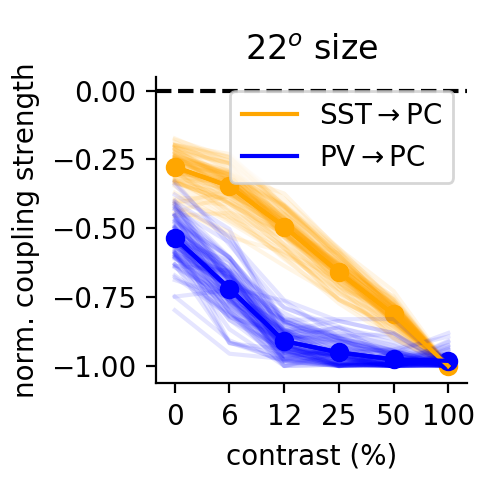

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.28998238004867355
-0.5519561220789144


In [1192]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
# datas = [couplings[:,isize,:,1,0],couplings[:,isize,:,3,0]]
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,3,0]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'PV$\rightarrow$PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


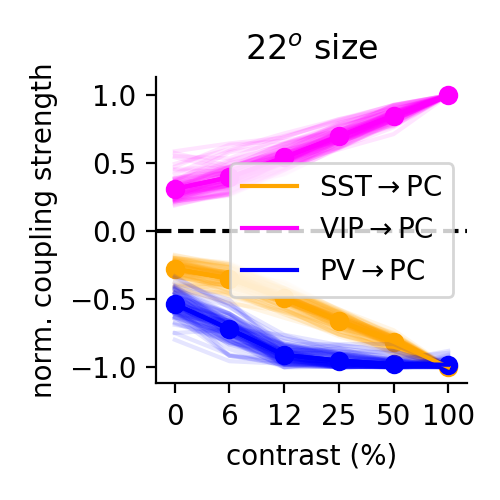

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.28998238004867355
1.0
-0.5519561220789144


In [1193]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
# datas = [couplings[:,isize,:,1,0],couplings[:,isize,:,2,0],couplings[:,isize,:,3,0]]#,phis[:,isize,:,0]]
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,2,0],couplings[lkat,isize,:,3,0]]#,phis[:,isize,:,0]]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1))]#,np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'VIP$\rightarrow$PC',r'PV$\rightarrow$PC'])#,'$\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

In [690]:
Wmys[:,i,j]

IndexError: index 8 is out of bounds for axis 1 with size 4

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


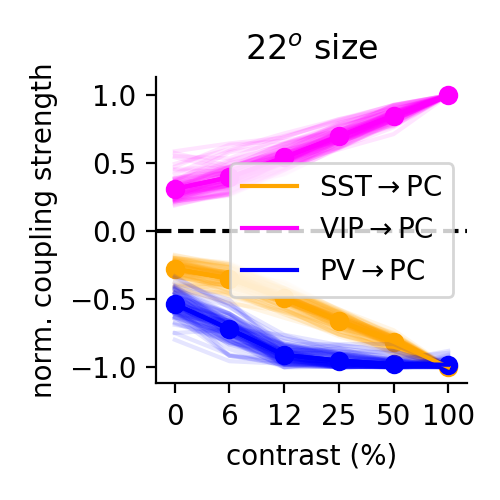

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.28998238004867355
1.0
-0.5519561220789144


In [1194]:
plt.figure(figsize=(2.5,2.5))
isize = 3
# i,j = 1,0
# polysyn = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]
i,j,k = 2,1,0
x = np.arange(6)
polysyn = phis[lkat,isize,:,i]*Wmys[lkat,np.newaxis,i,j]*phis[lkat,isize,:,j]*Wmys[lkat,np.newaxis,j,k]*phis[lkat,isize,:,k]
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,2,0],couplings[lkat,isize,:,3,0]]#,phis[:,isize,:,0],polysyn]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1)),np.array((0,0,0)),np.array((0,1,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'VIP$\rightarrow$PC',r'PV$\rightarrow$PC'])#,'$\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
erase_top_right()
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


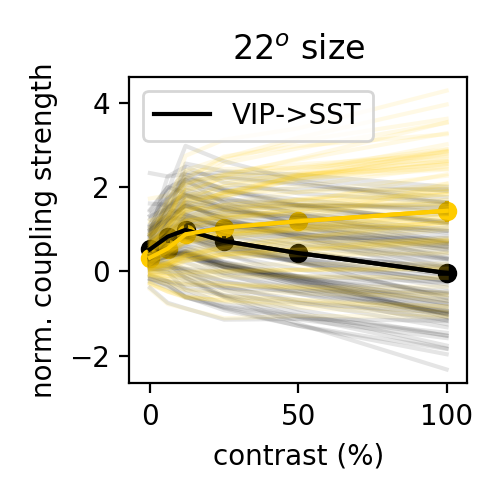

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8106073218051308
1.2011470980200536


In [1327]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[lkat,isize,:,8,0],couplings_fixed[lkat,isize,:,8,0,1]]
colors = [np.array((0,0,0)),np.array((1,0.8,0))]
for data,color in zip(datas,colors):
#     mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['VIP->SST'])
for data,color in zip(datas,colors):
#     mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,data.T,alpha=0.1,c=color) #
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


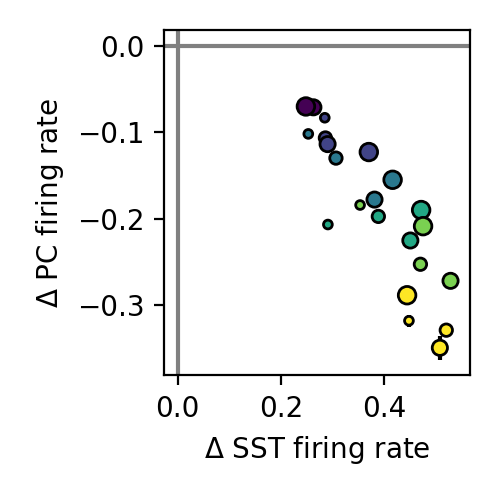

<IPython.core.display.Javascript object>


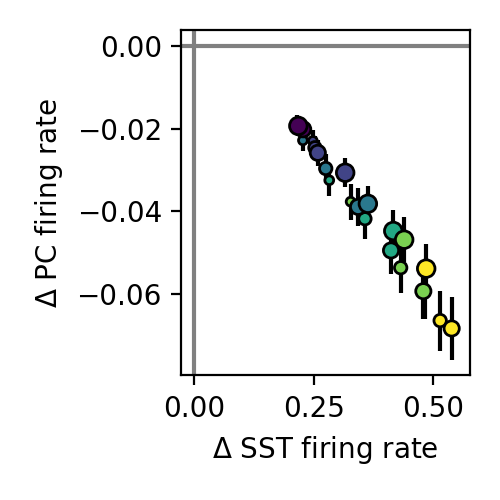

IndexError: boolean index did not match indexed array along dimension 0; dimension is 45 but corresponding boolean dimension is 5

In [387]:
h = -1
sizes = [0,2,3,5]
rg = lkat

plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings[rg,:,:,2,1]
ydata = h*couplings[rg,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

polysyn_vip_sst = h*phis[rg,:,:,2]*phis[rg,:,:,1]*Wmys[rg,np.newaxis,np.newaxis,2,1]
polysyn_vip_pc = h*phis[rg,:,:,2]*phis[rg,:,:,1]*phis[rg,:,:,0]*Wmys[rg,np.newaxis,np.newaxis,2,1]*Wmys[rg,np.newaxis,np.newaxis,1,0]
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
sca.scatter_size_contrast_errorbar(polysyn_vip_sst[:,sizes],polysyn_vip_pc[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_feedforward.eps')

polysyn_vip_sst = h*phis[rg,:,:,2]*phis[rg,:,:,1]*Wmys[rg,np.newaxis,np.newaxis,2,1]
polysyn_vip_pc = h*phis[rg,:,:,2]*phis[rg,:,:,1]*phis[rg,:,:,0]*1/(1-max_eig[rg])*Wmys[rg,np.newaxis,np.newaxis,2,1]*Wmys[rg,np.newaxis,np.newaxis,1,0]
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
# xdata = h*couplings_no_wpcsst[rg,:,:,2,1]
# ydata = h*couplings_no_wpcsst[rg,:,:,2,0]
sca.scatter_size_contrast_errorbar(polysyn_vip_sst[:,sizes],polysyn_vip_pc[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.ylim(-3,1)
plt.xlim(-1,3)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


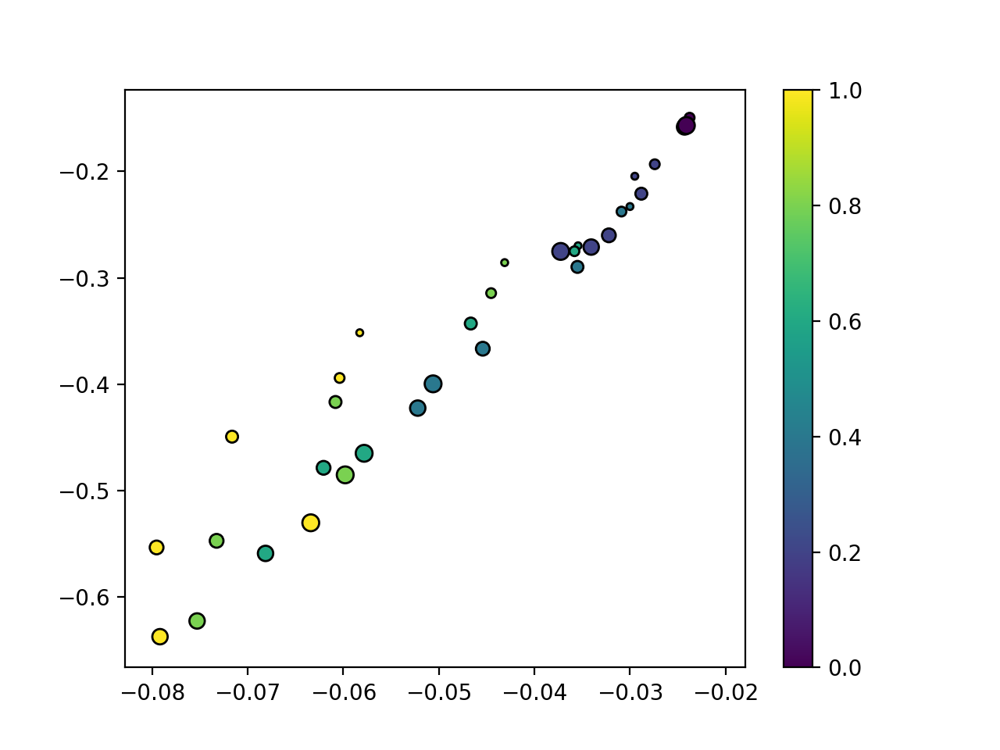

In [455]:
plt.figure()
sca.scatter_size_contrast(np.nanmean(polysyn_vip_pc,0),np.nanmean(h*couplings[:,:,:,2,0],0),square=False,equality_line=False)
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


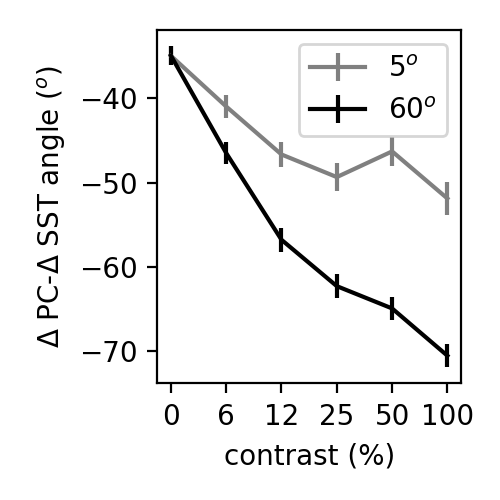

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


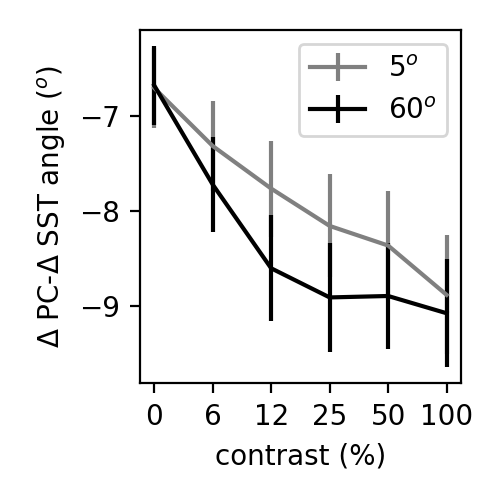

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


In [434]:
h = -1
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
data = np.arctan2(h*couplings[:,:,:,2,0],h*couplings[:,:,:,2,1])#,equality_line=False,square=False)

plt.figure(figsize=(2.5,2.5))
thisx = np.arange(6)
# colors_blk = [0.5**(i+1)*np.array((1,1,1)) for i in range(4)]
colors_blk = [np.array((0.5,0.5,0.5)),np.array((0.,0.,0.))]
for iisize,isize in enumerate([0,5]):
    this_data = data[:,isize]
    plt.errorbar(thisx,-360+180/np.pi*sst.circmean(this_data,axis=0),180/np.pi*sst.circstd(this_data,axis=0)/np.sqrt(data.shape[0]),c=colors_blk[iisize])
    plt.xlabel('contrast (%)')
plt.xticks(thisx,ucontrast)
# plt.ylim(-80,0)
#     plt.ylim(-90,45)
# plt.subplot(1,4,1)
plt.legend(['5$^o$','60$^o$'])
plt.ylabel('$\Delta$ PC-$\Delta$ SST angle ($^o$)')
plt.tight_layout()
plt.savefig('figures/sim_drpc_drsst_angle_recurrent.eps')


h = -1

polysyn_vip_sst = h*phis[:,:,:,2]*phis[:,:,:,1]*Wmys[:,np.newaxis,np.newaxis,2,1]
polysyn_vip_pc = h*phis[:,:,:,2]*phis[:,:,:,1]*phis[:,:,:,0]*Wmys[:,np.newaxis,np.newaxis,2,1]*Wmys[:,np.newaxis,np.newaxis,1,0]
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
data = np.arctan2(polysyn_vip_pc,polysyn_vip_sst)

plt.figure(figsize=(2.5,2.5))
thisx = np.arange(6)
# colors_blk = [0.5**(i+1)*np.array((1,1,1)) for i in range(4)]
colors_blk = [np.array((0.5,0.5,0.5)),np.array((0.,0.,0.))]
for iisize,isize in enumerate([0,5]):
    this_data = data[:,isize]
    plt.errorbar(thisx,-360+180/np.pi*sst.circmean(this_data,axis=0),180/np.pi*sst.circstd(this_data,axis=0)/np.sqrt(data.shape[0]),c=colors_blk[iisize])
    plt.xlabel('contrast (%)')
plt.xticks(thisx,ucontrast)
# plt.ylim(-80,0)
# plt.subplot(1,4,1)
plt.legend(['5$^o$','60$^o$'])
plt.ylabel('$\Delta$ PC-$\Delta$ SST angle ($^o$)')
plt.tight_layout()
plt.savefig('figures/sim_drpc_drsst_angle_feedforward.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


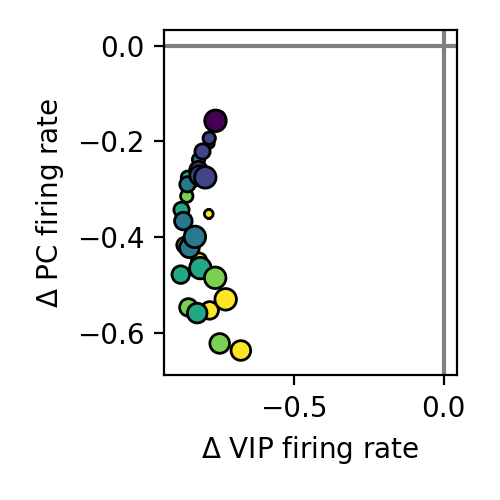

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


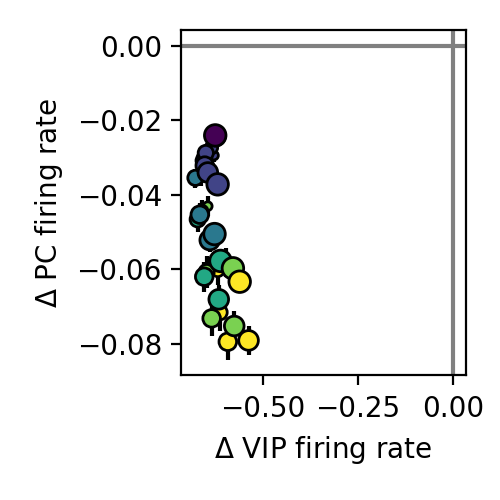

In [416]:
iwt = 0
h = -1
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
sca.scatter_size_contrast_errorbar(h*couplings[:,:,:,2,2],h*couplings[:,:,:,2,0],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ VIP firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

polysyn_vip = h*phis[:,:,:,2]
polysyn_vip_pc = h*phis[:,:,:,2]*phis[:,:,:,1]*phis[:,:,:,0]*Wmys[:,np.newaxis,np.newaxis,2,1]*Wmys[:,np.newaxis,np.newaxis,1,0]
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
sca.scatter_size_contrast_errorbar(polysyn_vip,polysyn_vip_pc,equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ VIP firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_feedforward.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


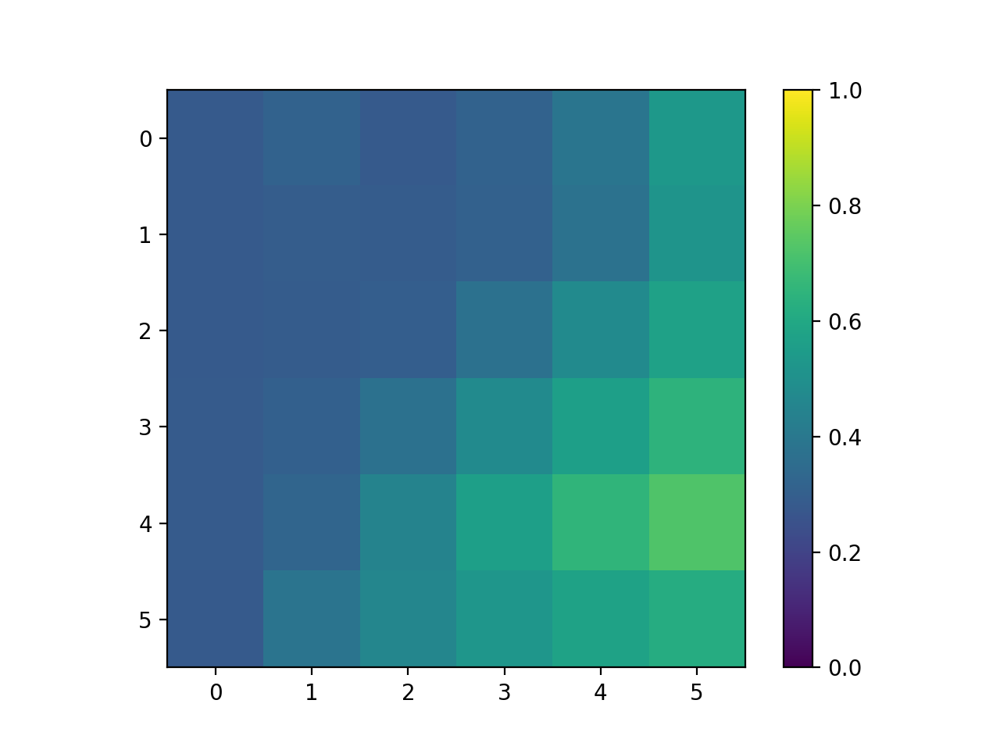

In [412]:
plt.figure()
plt.imshow(np.nanmean(phis[:,:,:,1],0),vmin=0,vmax=1)
plt.colorbar()

<IPython.core.display.Javascript object>


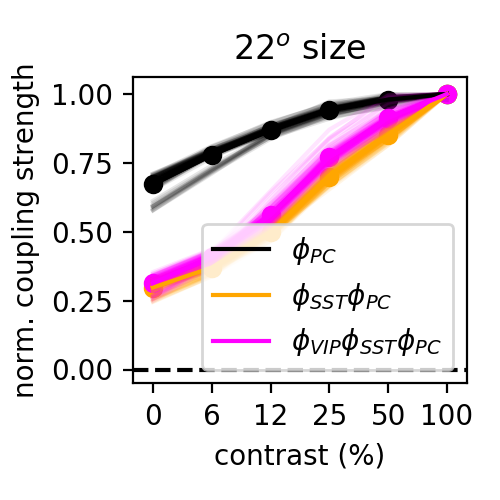

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9991928670358557
1.0
1.0


In [275]:
plt.figure(figsize=(2.5,2.5))
x = np.arange(6)
isize = 3
i,j = 1,0
polysyn_sst = phis[:,isize,:,i]*phis[:,isize,:,j]
i,j,k = 2,1,0
polysyn_vip = phis[:,isize,:,i]*phis[:,isize,:,j]*phis[:,isize,:,k]
datas = [phis[:,isize,:,0],polysyn_sst,polysyn_vip] #couplings[:,isize,:,1,0]/ #couplings[:,isize,:,2,0]/
colors = [np.array((0,0,0)),np.array((1,0.65,0)),np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['$\phi_{PC}$','$\phi_{SST}\phi_{PC}$','$\phi_{VIP}\phi_{SST}\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


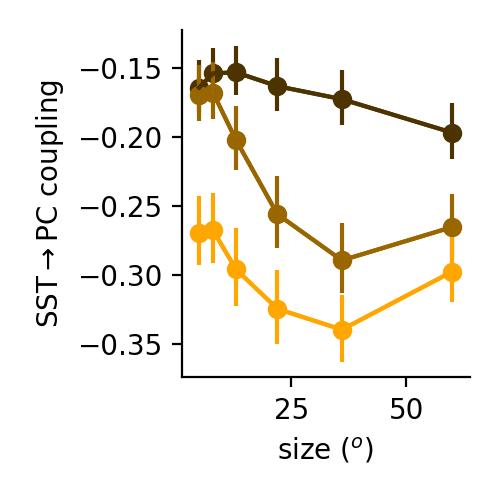

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.17212794786037652


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


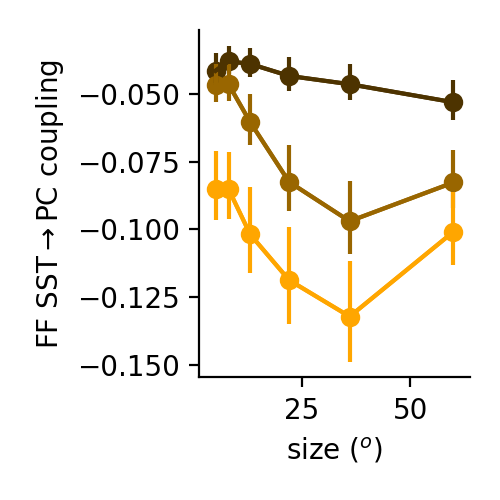

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.043697522088084695


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


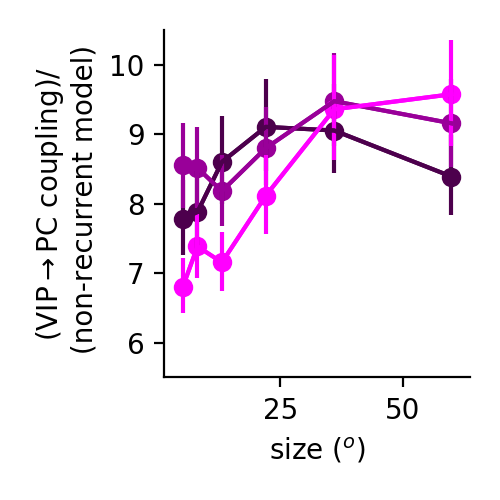

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


8.79894690999327


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [464]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_pc_coupling.eps')

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,polysyn_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'FF SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_phi_W_phi.eps')
i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


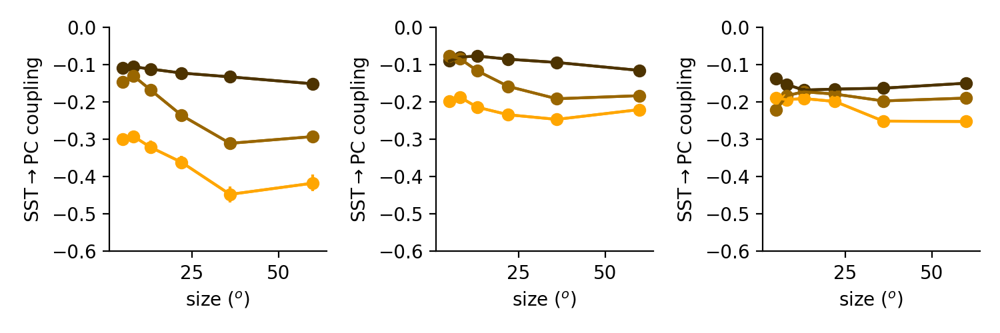

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-0.10910854058147418
-0.07966704906302487
-0.1426113137642293


In [1204]:
rg = slice(None)
i,j = 1,0
ylim = (-0.6,0)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_pcpv_sst_phi_constant.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


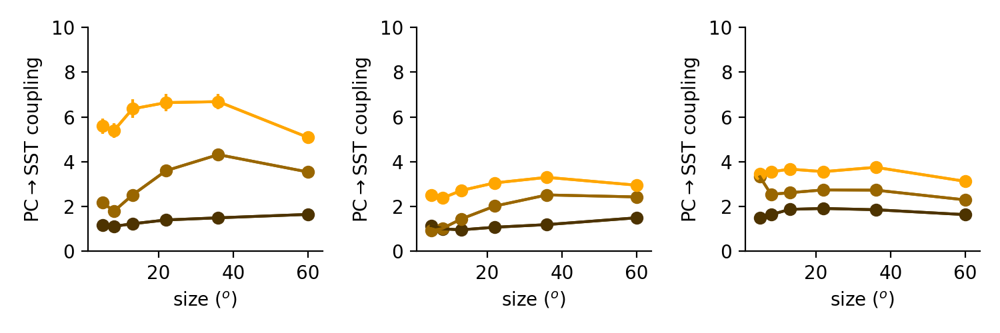

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

6.351544128539787
3.143254188801276


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.548931949049513


(0, 10)

In [1313]:
rg = slice(None)
i,j = 0,1
ylim = (0,10)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.ylim(ylim)

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.ylim(ylim)

# plt.savefig('figures/pc_sst_coupling_pcpv_sst_phi_constant.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


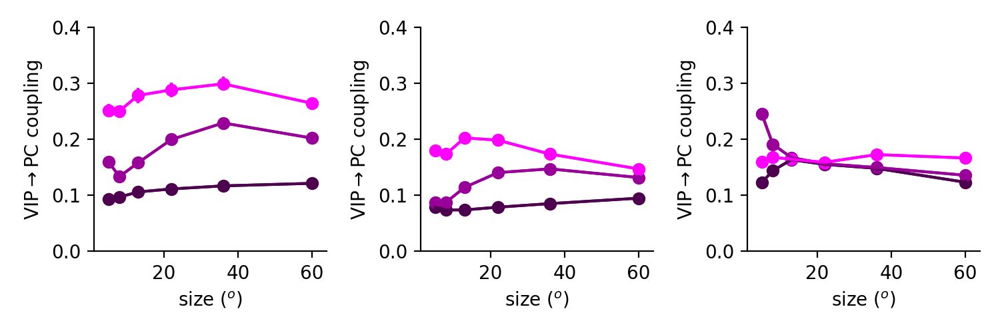

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.28668067320186946
0.1950237763761231
0.2358641448111255


In [1207]:
rg = slice(None)
i,j = 2,0
ylim = (0,0.4)
xlabel = 'size ($^o$)'
ylabel = r'VIP$\rightarrow$PC coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_pcpv_sst_phi_constant.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


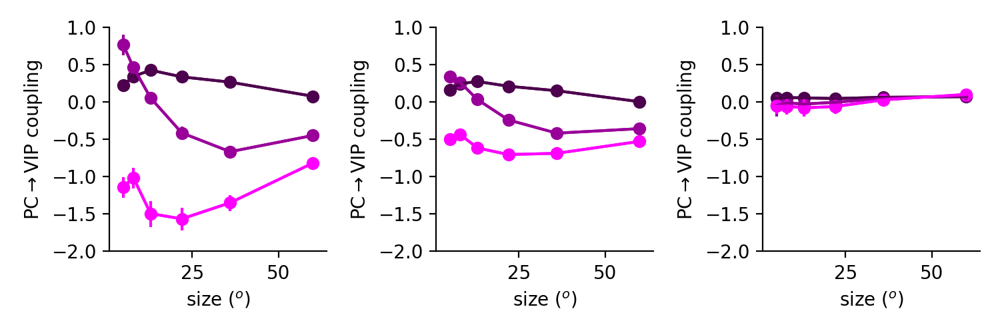

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.635444828285856
0.2925627060125123
0.040970694591162184


In [1208]:
rg = slice(None)
i,j = 0,2
ylim = (-2,1)
xlabel = 'size ($^o$)'
ylabel = r'PC$\rightarrow$VIP coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/pc_vip_coupling_pcpv_sst_phi_constant.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


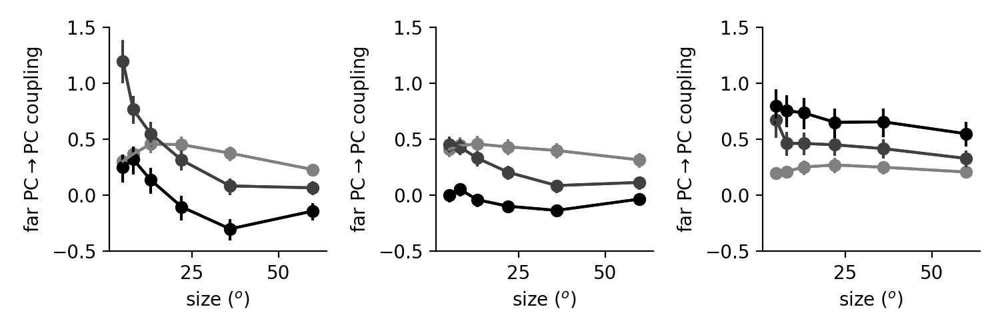

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.0125041722967583
0.38716304762220094
0.6532341079985204


In [1238]:
rg = slice(None)
i,j = 8,0
ylim = (-0.5,1.5)
xlabel = 'size ($^o$)'
ylabel = r'far PC$\rightarrow$PC coupling'
# lkat = couplings_fixed[:,:,:,8,0,1].max(1).max(1) < np.percentile(couplings_fixed[:,:,:,8,0,1],99.95)
rg = lkat
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

from_array = np.zeros((16,))
from_array[[8,12]] = 0.5
to_array = np.zeros((16,))
to_array[[0,4]] = 0.5
coupling_sst = from_array @ couplings[rg,:,:,:,:] @ to_array
coupling_sst_pcpv_fixed = from_array @ couplings_pcpv_fixed[rg,:,:,:,:] @ to_array
coupling_sst_sst_fixed = from_array @ couplings_fixed[rg,:,:,:,:,1] @ to_array

colors = c_l23

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/far_pc_pc_coupling_pcpv_sst_phi_constant.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


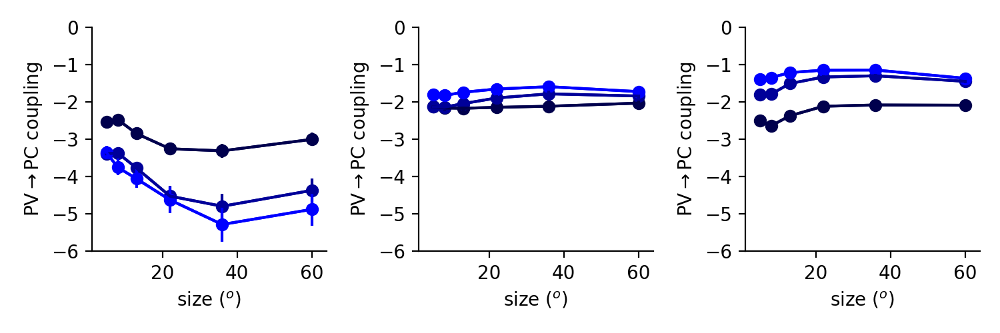

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-2.588526881144152
-1.6745654464894382
-1.1873169602718838


In [496]:
rg = slice(None)
i,j = 3,0
ylim = (-6,0)
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,0]
colors = c_pv.copy()
ylabel = r'PV$\rightarrow$PC coupling'

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.ylim(ylim)

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


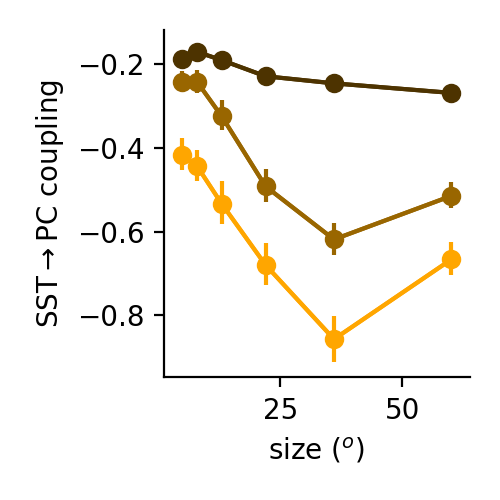

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.18437305227692494


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


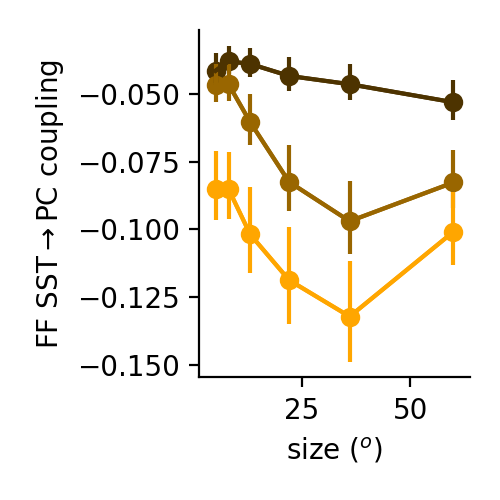

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.043697522088084695


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


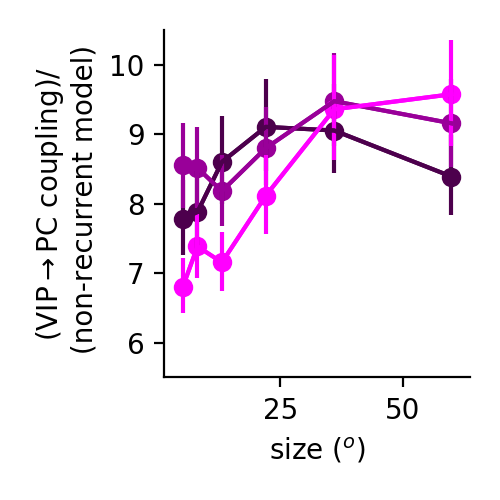

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


8.79894690999327


In [483]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_pc_coupling.eps')

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,polysyn_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'FF SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_phi_W_phi.eps')
i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


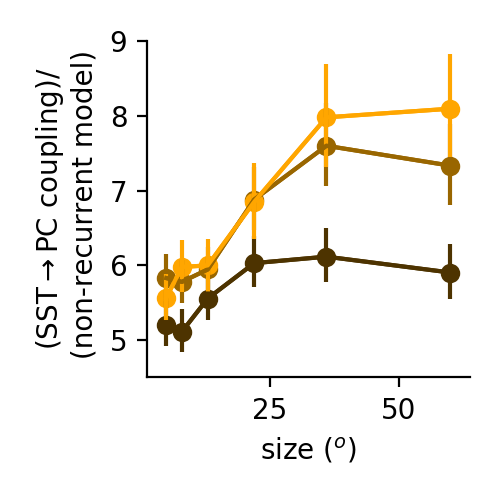

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


7.3623783736266475


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


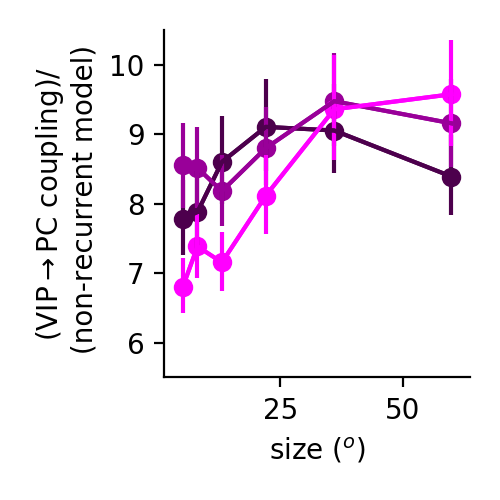

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


8.79894690999327


In [306]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_sst/polysyn_sst)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(SST$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
ylim_sst = (4.5,9)
plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_pc_coupling_over_phi_W_phi.eps')

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
plt.ylim(ylim_vip)
plt.tight_layout()
plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


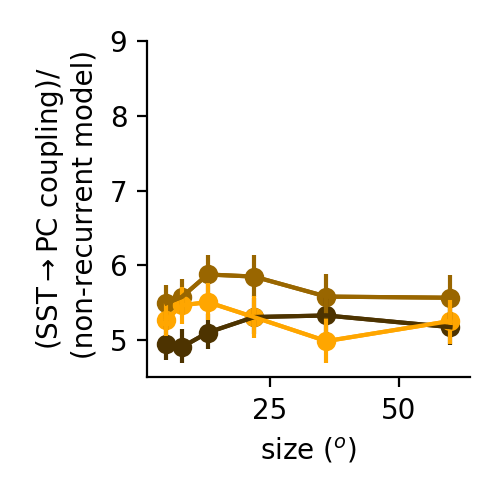

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


5.62141763819922


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


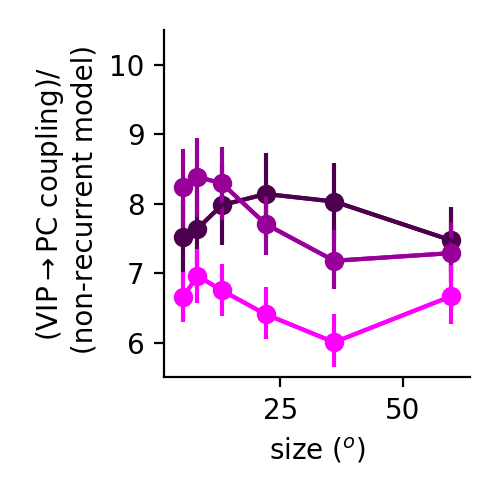

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


7.822492733118399


In [308]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = couplings_pcpv[rg,:,:,i,j]

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_sst_pcpv/polysyn_sst)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(SST$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim_sst)
plt.tight_layout()
plt.savefig('figures/sst_pc_coupling_over_phi_W_phi_pcpv.eps')

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = couplings[rg,:,:,i,k]
coupling_vip_pcpv = couplings_pcpv[rg,:,:,i,k]

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip_pcpv/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim_vip)
plt.tight_layout()
plt.savefig('figures/vip_pc_coupling_over_phi_W_phi_pcpv.eps')

<IPython.core.display.Javascript object>


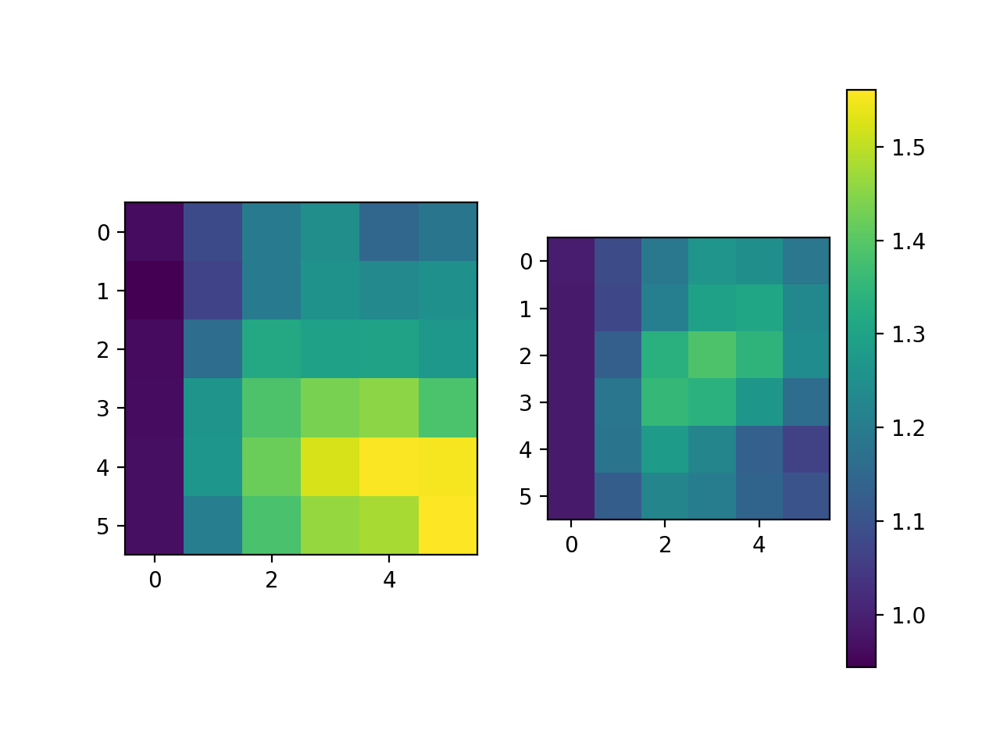

<IPython.core.display.Javascript object>


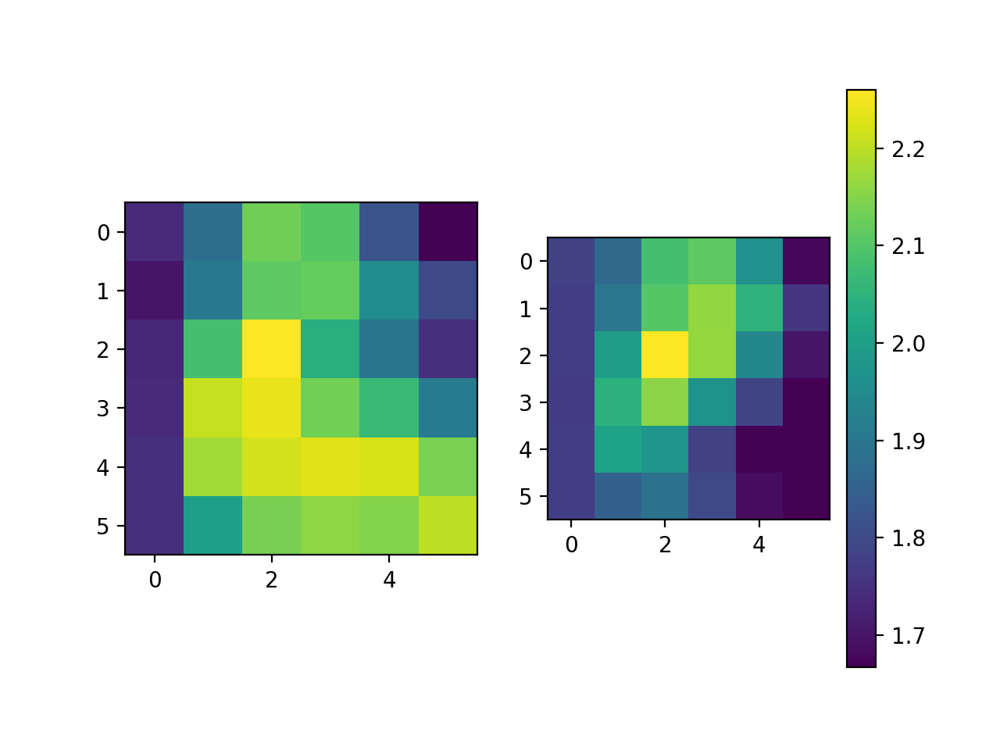

In [276]:
i,j = 1,0
iwt = 3
rg = slice(None)
polysyn_sst = phis[rg,:,:,i]*phis[rg,:,:,j]
coupling_sst = np.abs(couplings[rg,:,:,i,j])
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure()
plt.subplot(1,2,1)
data = np.nanmean(coupling_sst/polysyn_sst,axis=0)
mn = np.nanmin(data)
mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.subplot(1,2,2)
data = np.nanmean(coupling_sst_pcpv/polysyn_sst,axis=0)
# mn = np.nanmin(data)
# mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.colorbar()

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*phis[rg,:,:,j]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])
ei = phis[rg,:,:,0]/phis[rg,:,:,3]

plt.figure()
plt.subplot(1,2,1)
data = np.nanmean(coupling_vip/polysyn_vip,axis=0)
mn = np.nanmin(data)
mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.subplot(1,2,2)
data = np.nanmean(coupling_vip_pcpv/polysyn_vip,axis=0)
# mn = np.nanmin(data)
# mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.colorbar()



/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


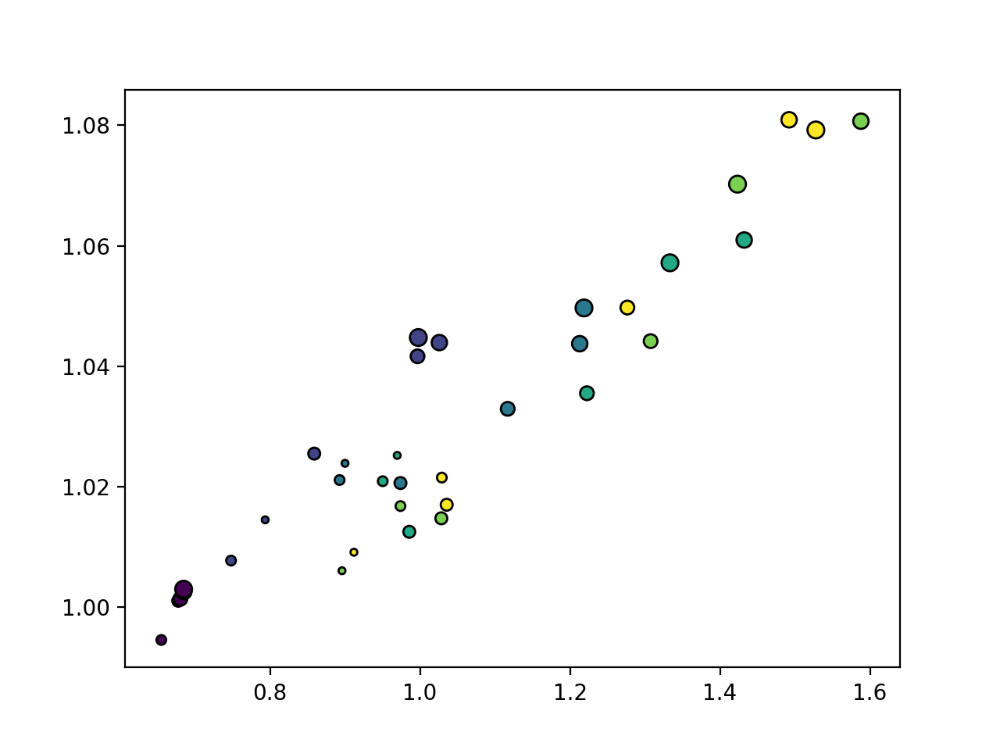

<IPython.core.display.Javascript object>


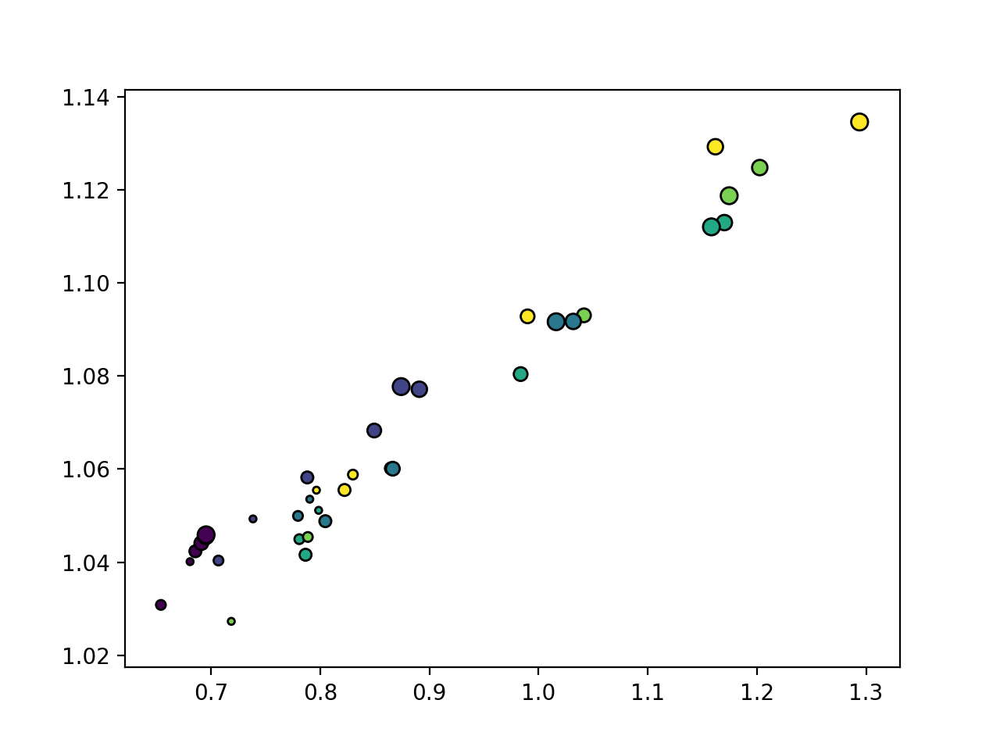

<IPython.core.display.Javascript object>


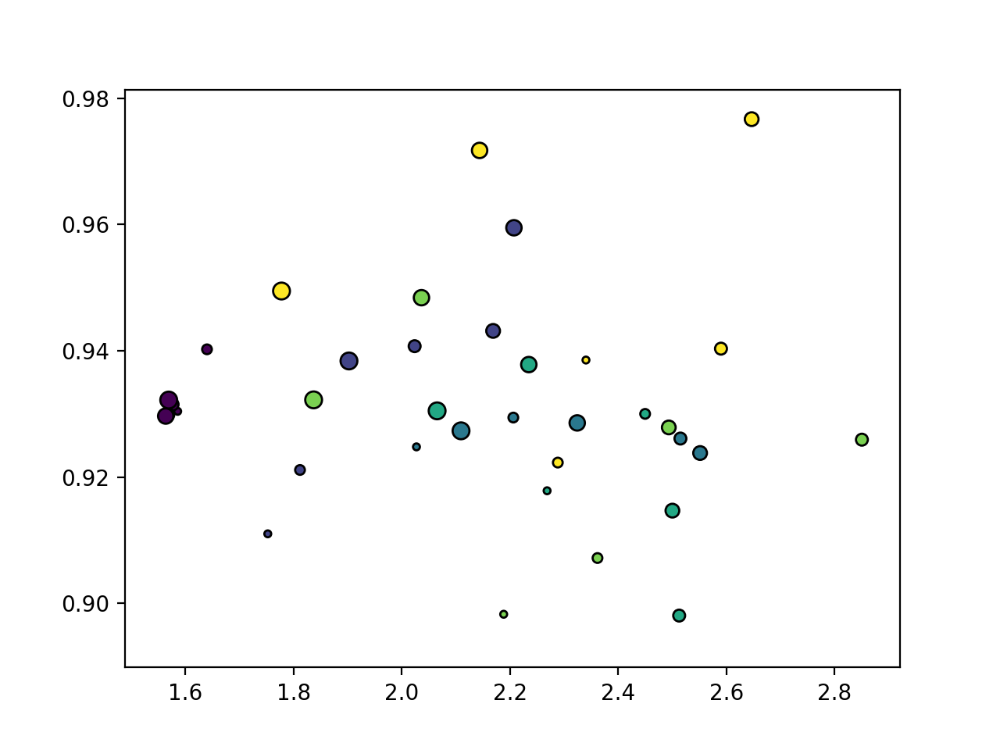

<IPython.core.display.Javascript object>


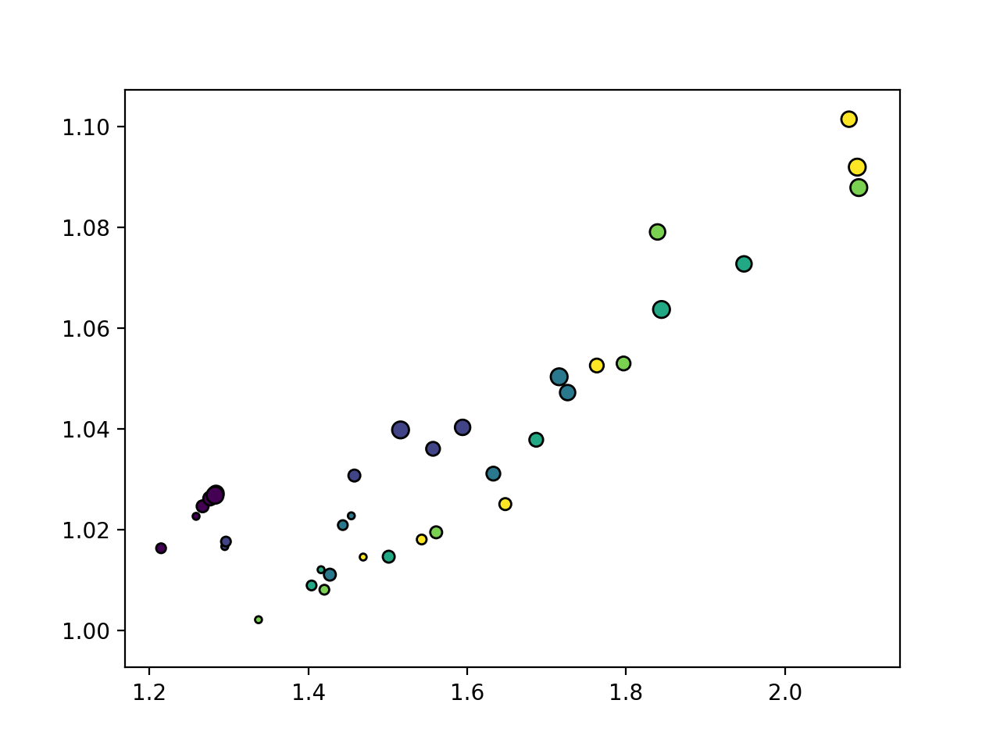

<IPython.core.display.Javascript object>


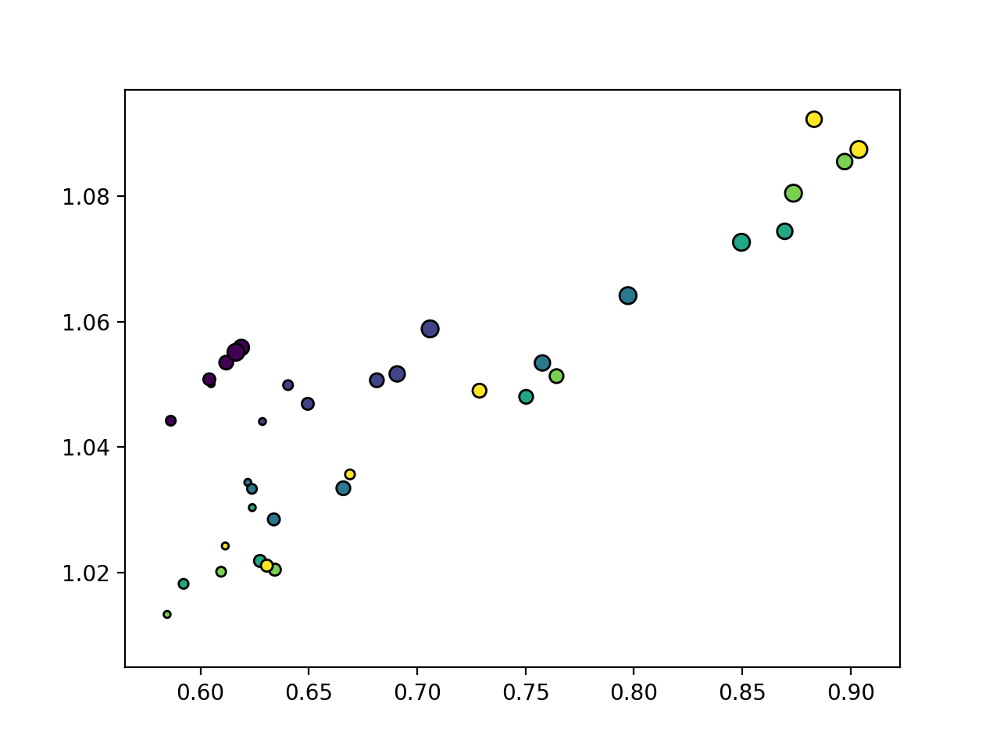

In [71]:
for iwt in range(5):
    plt.figure()
    sca.scatter_size_contrast(coupling_sst[iwt]/polysyn_sst[iwt],ei[iwt],equality_line=False,square=False)

<IPython.core.display.Javascript object>


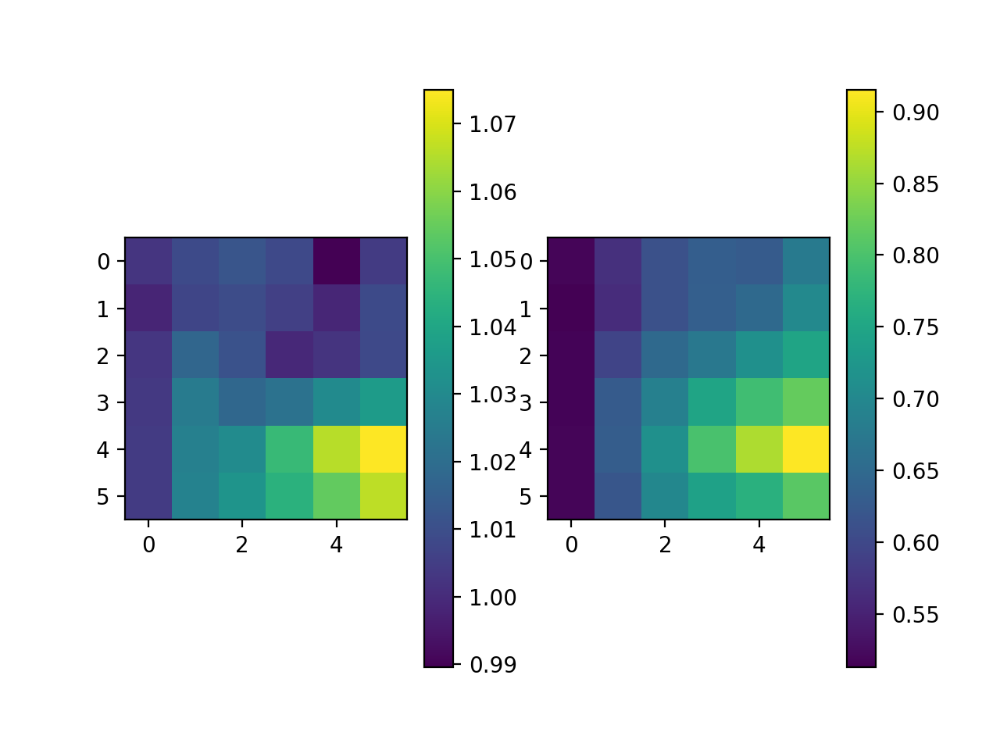

In [194]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(np.mean(phis[:,:,:,0]/phis[:,:,:,3],0))
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(np.mean(max_eig,0))
plt.colorbar()

In [417]:
max_eig.shape

(64, 6, 6)

In [402]:
couplings.shape

(84, 6, 6, 16, 16)

In [390]:
iwt,isize,icontrast = 0,0,0
w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


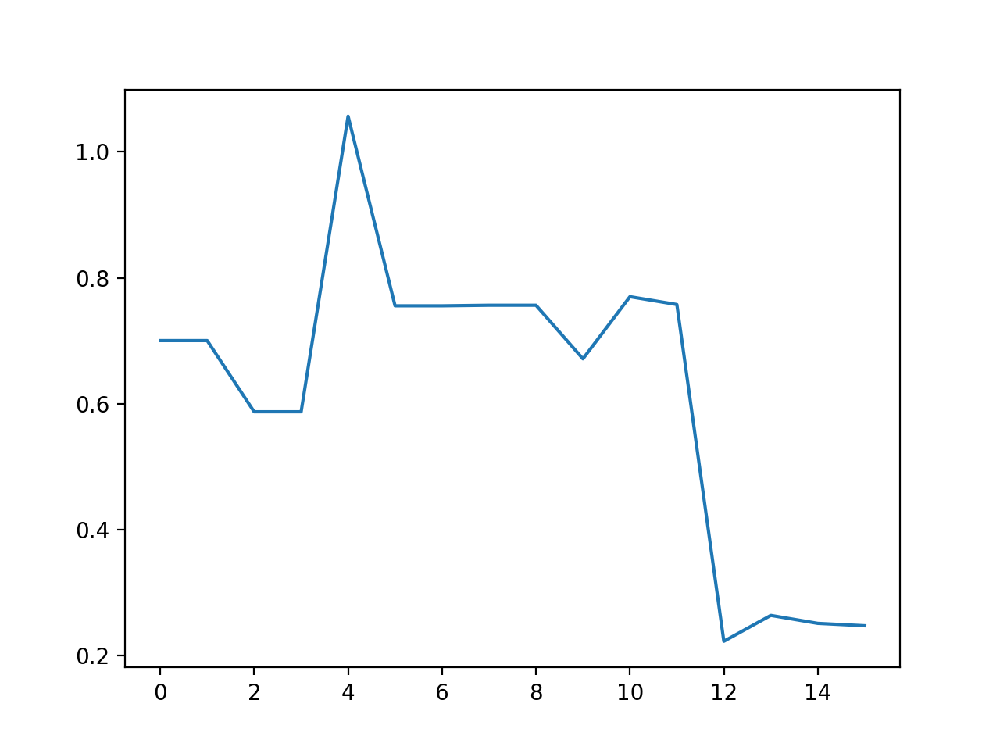

In [391]:
plt.figure()
plt.plot(np.abs(w))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


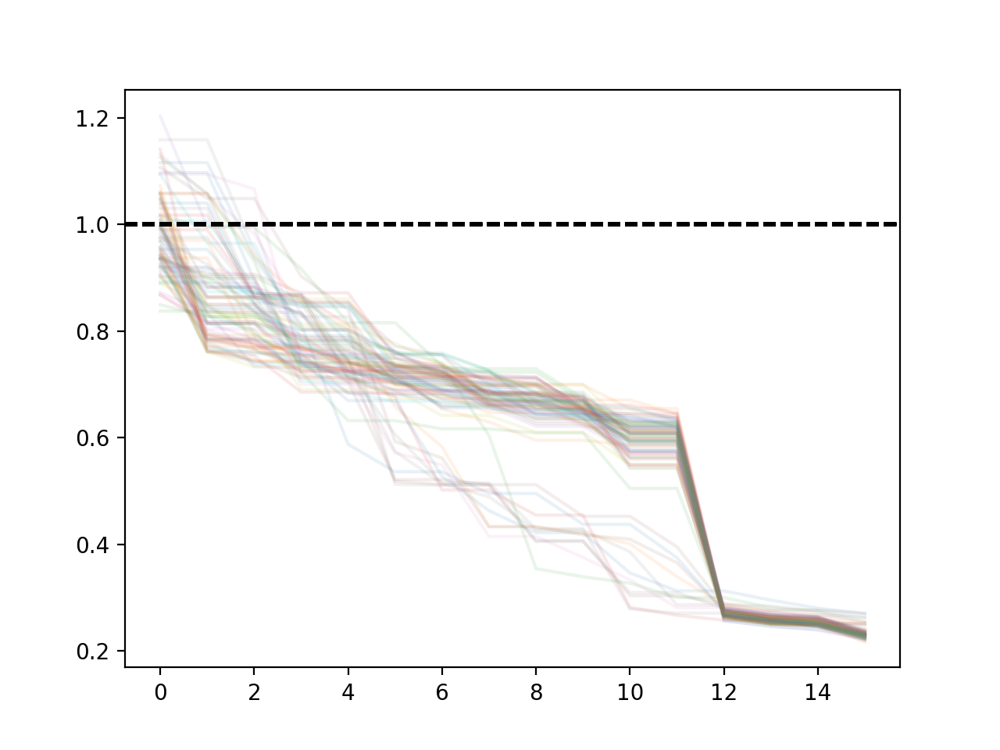

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


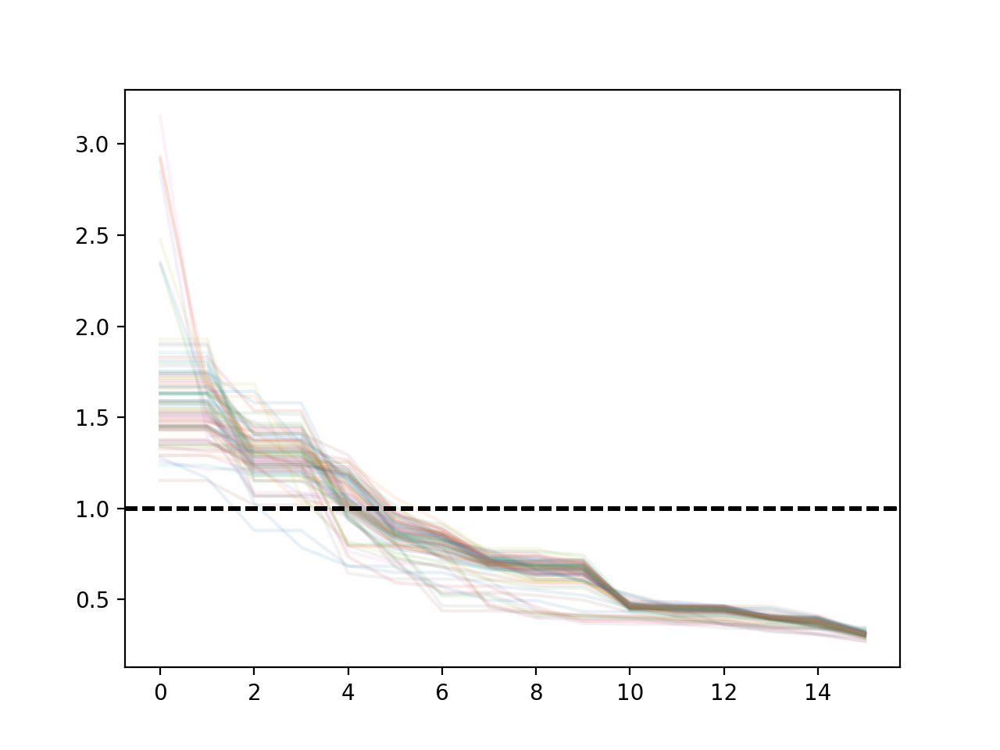

In [400]:
nwt = couplings.shape[0]
plt.figure()
for iwt in range(nwt):
    isize,icontrast = 0,0
    w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)
#     w,v = np.linalg.eig(Wmys[iwt].T)
    data = v[:,np.argmax(np.abs(w))]
#     plt.plot(data*np.sign(data[0]),alpha=0.1)
    plt.plot(-np.sort(-np.abs(w)),alpha=0.1)
    plt.axhline(1,c='k',linestyle='dashed')
plt.figure()
for iwt in range(nwt):
    isize,icontrast = -1,-1
    w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)
#     w,v = np.linalg.eig(Wmys[iwt].T)
    data = v[:,np.argmax(np.abs(w))]
#     plt.plot(data*np.sign(data[0]),alpha=0.1)
    plt.plot(-np.sort(-np.abs(w)),alpha=0.1)
    plt.axhline(1,c='k',linestyle='dashed')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


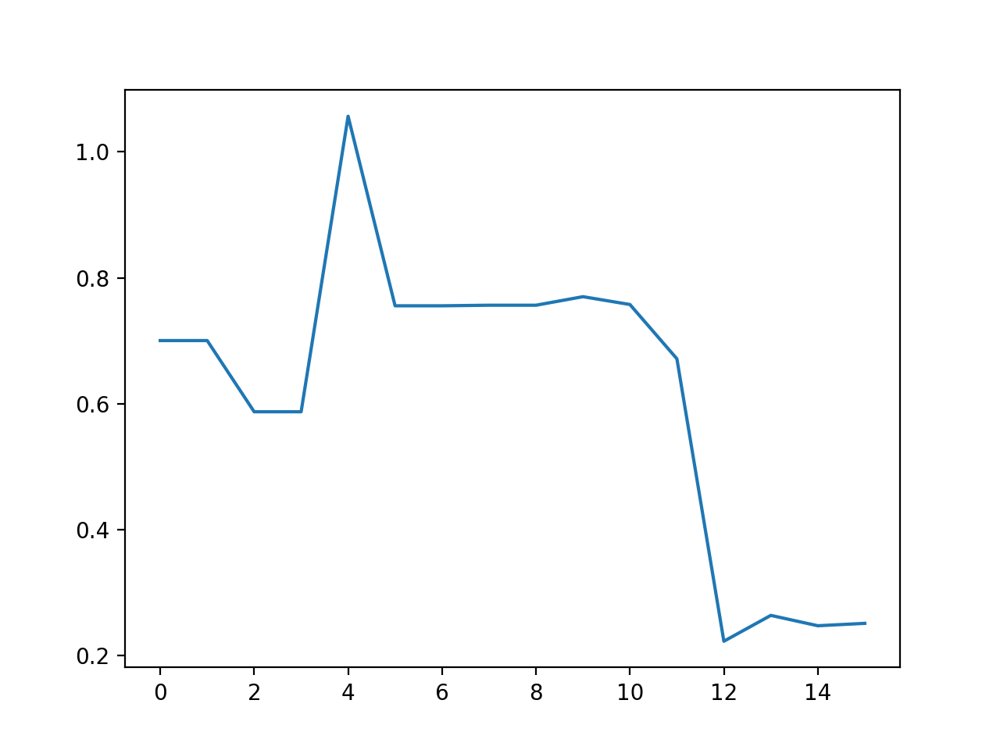

In [369]:
plt.figure()
plt.plot(np.abs(w))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


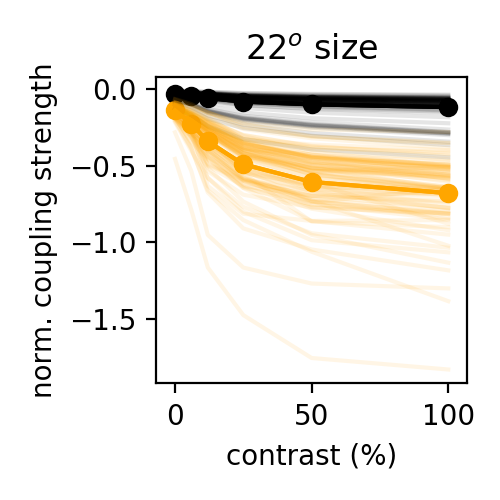

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.03917280614686907
-0.150050953198579


In [379]:
plt.figure(figsize=(2.5,2.5))
isize = 3
i,j = 1,0
polysyn_sst = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]
datas = [polysyn_sst,couplings[:,isize,:,i,j]]
colors = [np.array((0,0,0)),np.array((1,0.65,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend(['$\phi_{PC}$','$\phi_{SST}\phi_{PC}$','$\phi_{VIP}\phi_{SST}\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data).T,alpha=0.1,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
# plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


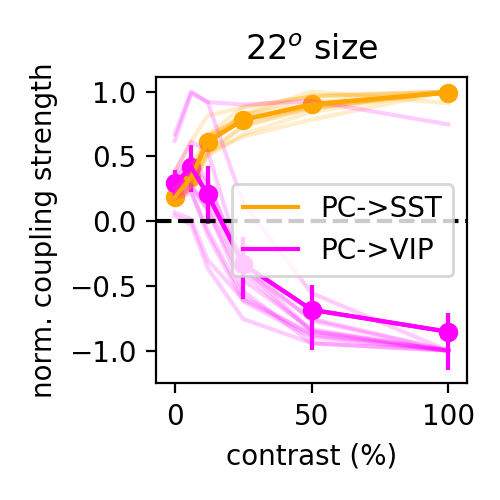

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9775239571935156
0.2438549595342812


In [262]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[:,isize,:,0,1][lkat],couplings[:,isize,:,0,2][lkat]]
colors = [np.array((1,0.65,0)),np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['PC->SST','PC->VIP'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/pc_sst_vip_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


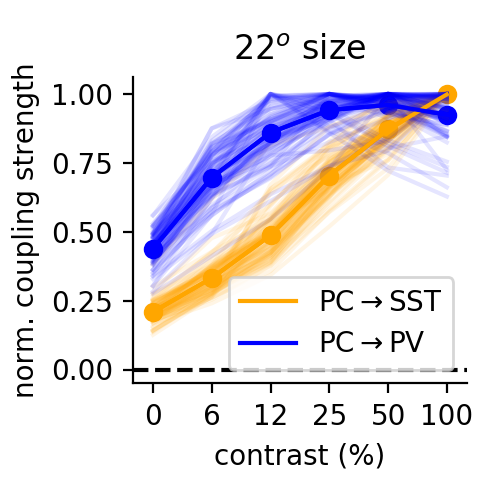

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9954072593906618
0.9445815973788986


In [460]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,0,1],couplings[:,isize,:,0,3]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'PC$\rightarrow$SST',r'PC$\rightarrow$PV'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
erase_top_right()
plt.tight_layout()
plt.savefig('figures/pc_sst_pv_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


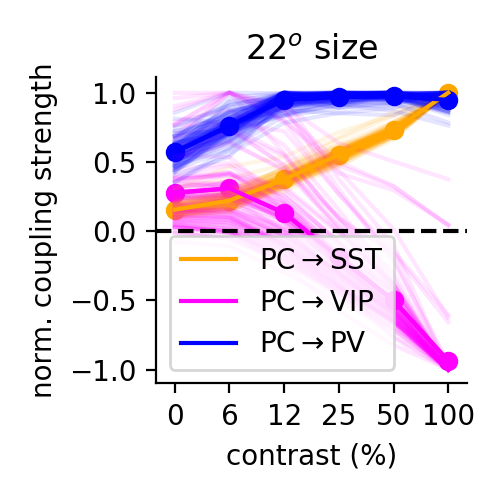

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0
0.24690689215189543
0.9696676497719269


In [1248]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[lkat,isize,:,0,1],couplings[lkat,isize,:,0,2],couplings[lkat,isize,:,0,3]]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'PC$\rightarrow$SST',r'PC$\rightarrow$VIP',r'PC$\rightarrow$PV'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
erase_top_right()
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/pc_sst_vip_pv_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


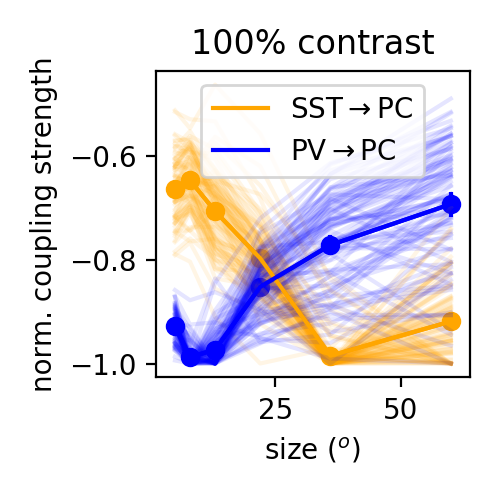

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.6591735014048276
-0.7173375379287378


In [1251]:
plt.figure(figsize=(2.5,2.5))
icontrast = 5
datas = [couplings[:,:,icontrast,1,0][lkat],couplings[:,:,icontrast,3,0][lkat]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(usize,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'PV$\rightarrow$PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(usize,(data/mx).T,alpha=0.1,c=color)
plt.xlabel('size ($^o$)')
plt.ylabel('norm. coupling strength')
plt.title('%d%% contrast'%ucontrast[icontrast])
# plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

In [257]:
nlkat

12

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


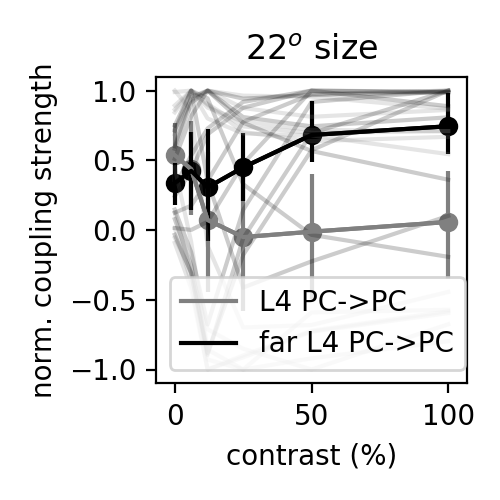

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.3030547878623264
0.5045479222596704


In [318]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [Xcouplings[:,isize,:,0,0][lkat],Xcouplings[:,isize,:,4,0][lkat]]
colors = [np.array((0.5,0.5,0.5)),np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['L4 PC->PC','far L4 PC->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/far_pc_near_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


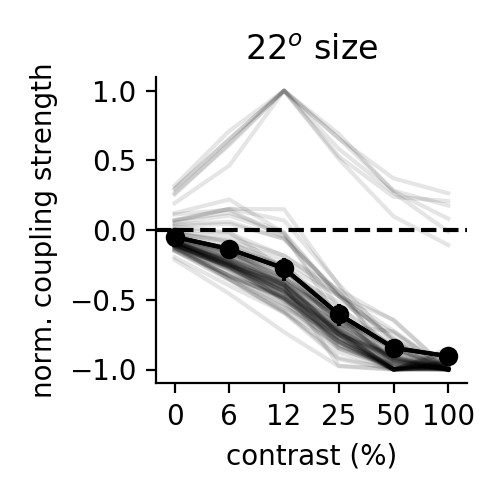

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.07160307643207439


In [374]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,8,0]] #couplings[:,isize,:,0,0],
colors = [np.array((0,0,0))] #np.array((0.5,0.5,0.5)),
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend([r'PC$\rightarrow$PC',r'far PC$\rightarrow$PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
erase_top_right()
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/far_pc_coupling_traces.jpg',dpi=300)

In [ ]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[:,isize,:,0,0],couplings[:,isize,:,8,0]]
colors = [np.array((0.5,0.5,0.5)),np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['PC->PC','far PC->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.1,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/far_pc_near_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


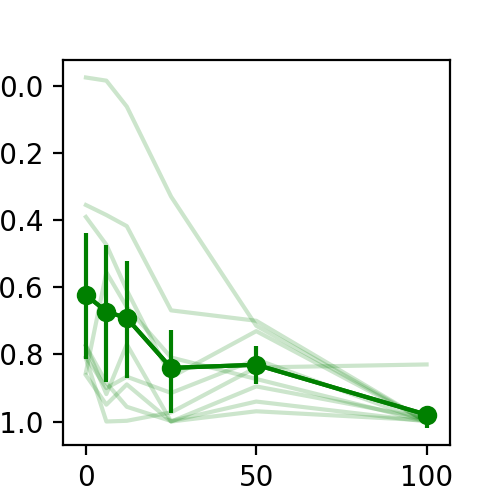

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.808474426536969


In [978]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [Xcouplings[:,isize,:,4,0]]
colors = [np.array((0,0.5,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend(['far PC->near])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
# plt.xlabel('contrast (%)')
# plt.ylabel('norm. coupling strength')
# plt.tight_layout()
# # plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


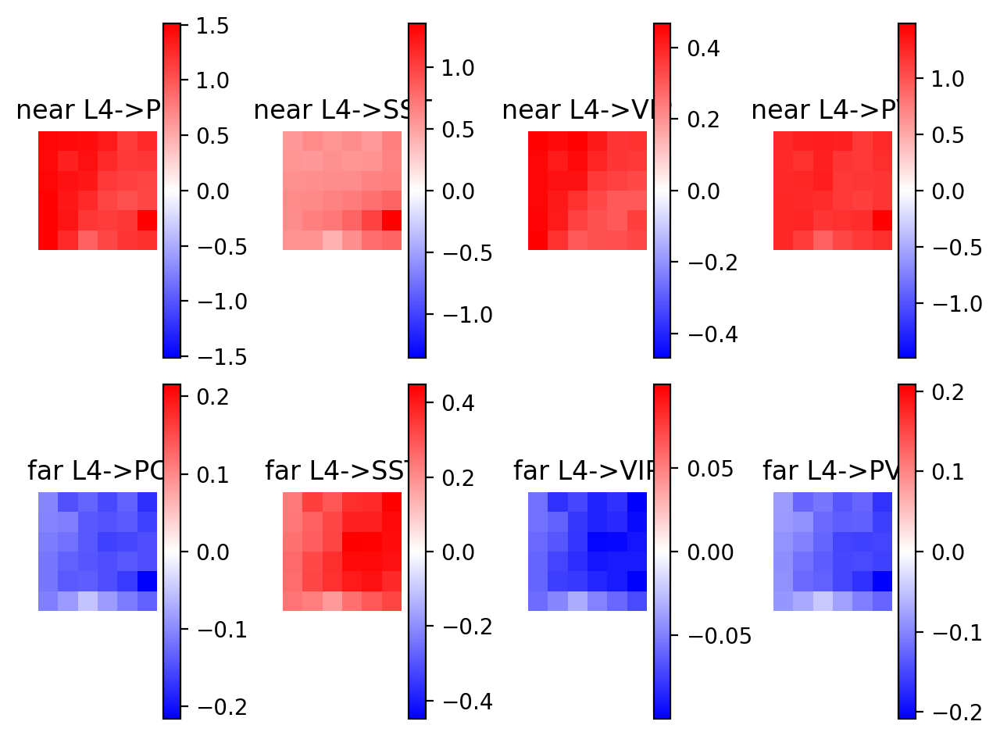

<IPython.core.display.Javascript object>


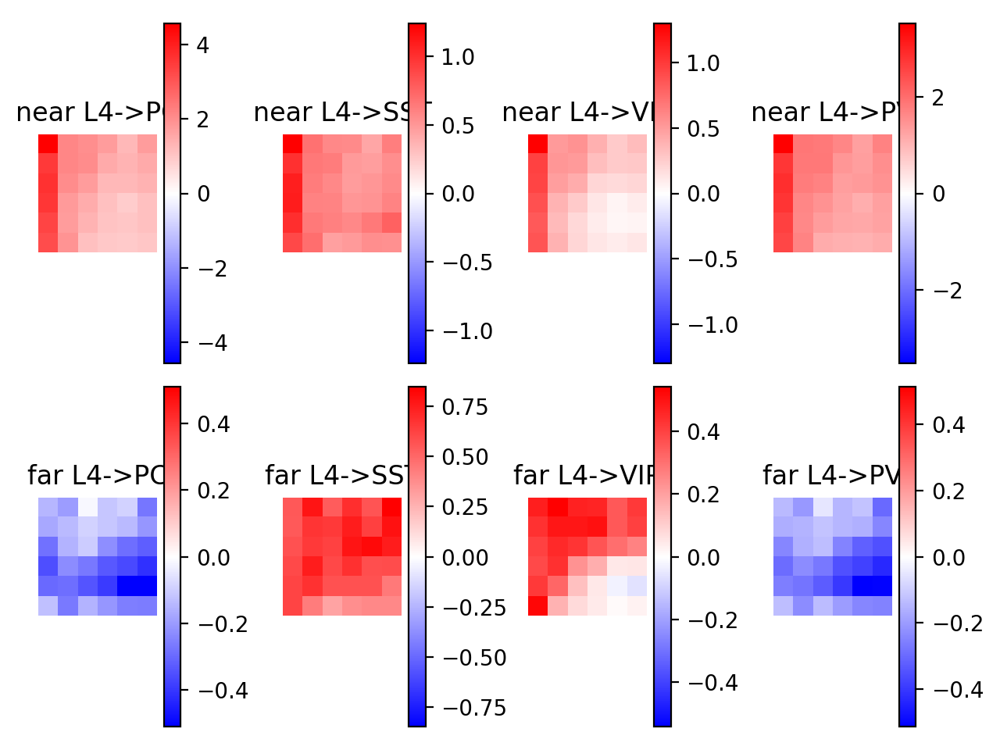

<IPython.core.display.Javascript object>


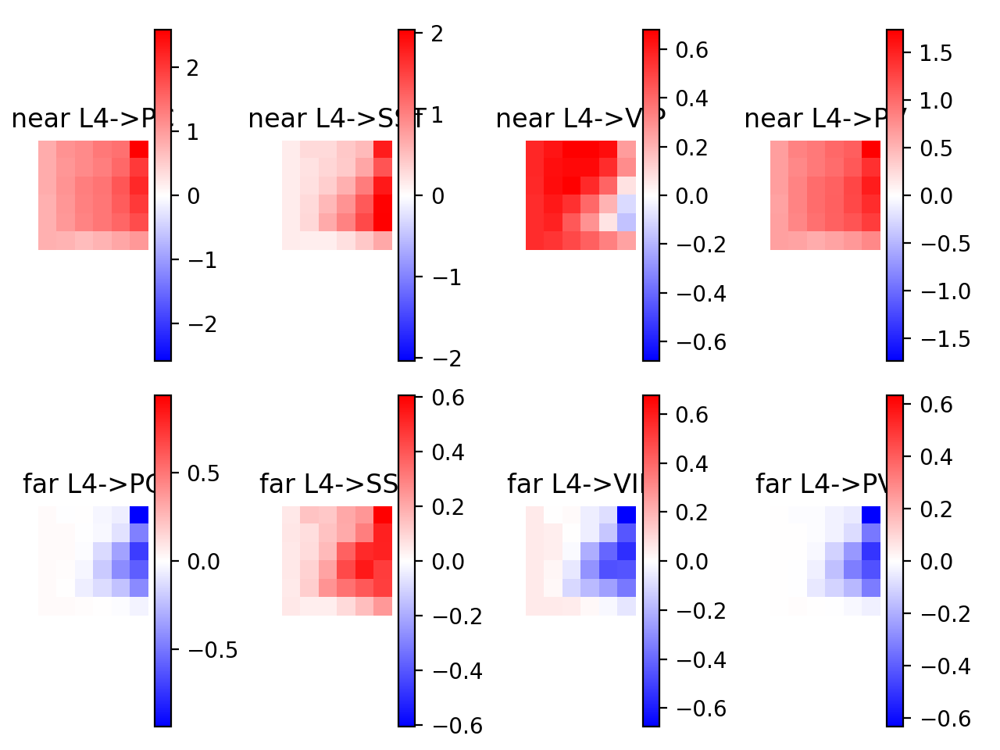

<IPython.core.display.Javascript object>


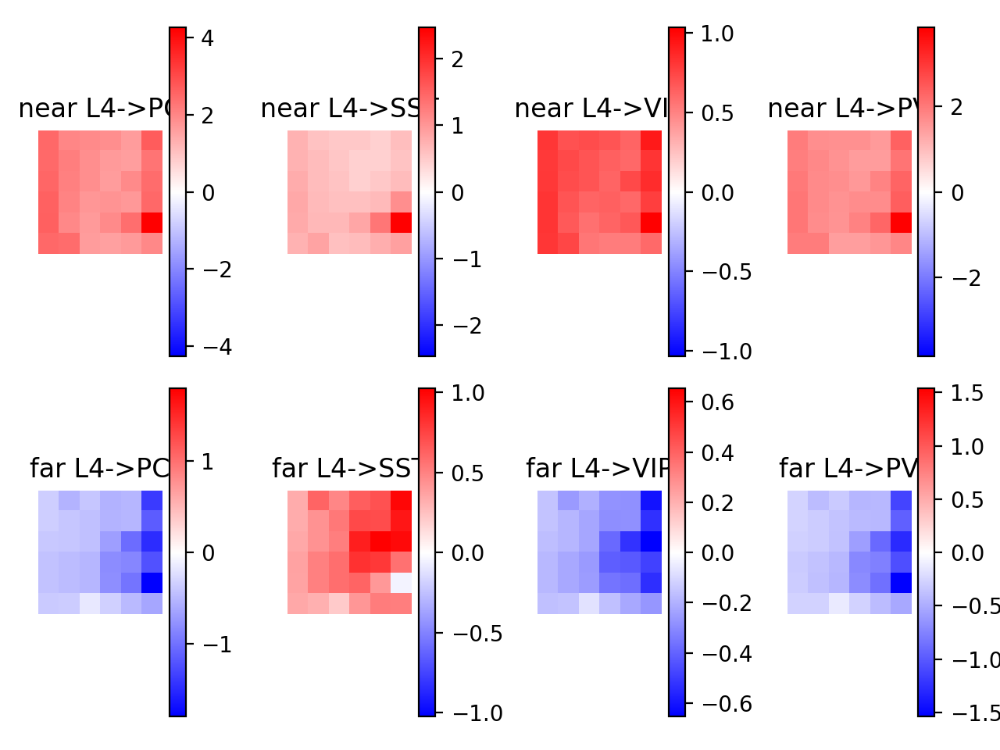

<IPython.core.display.Javascript object>


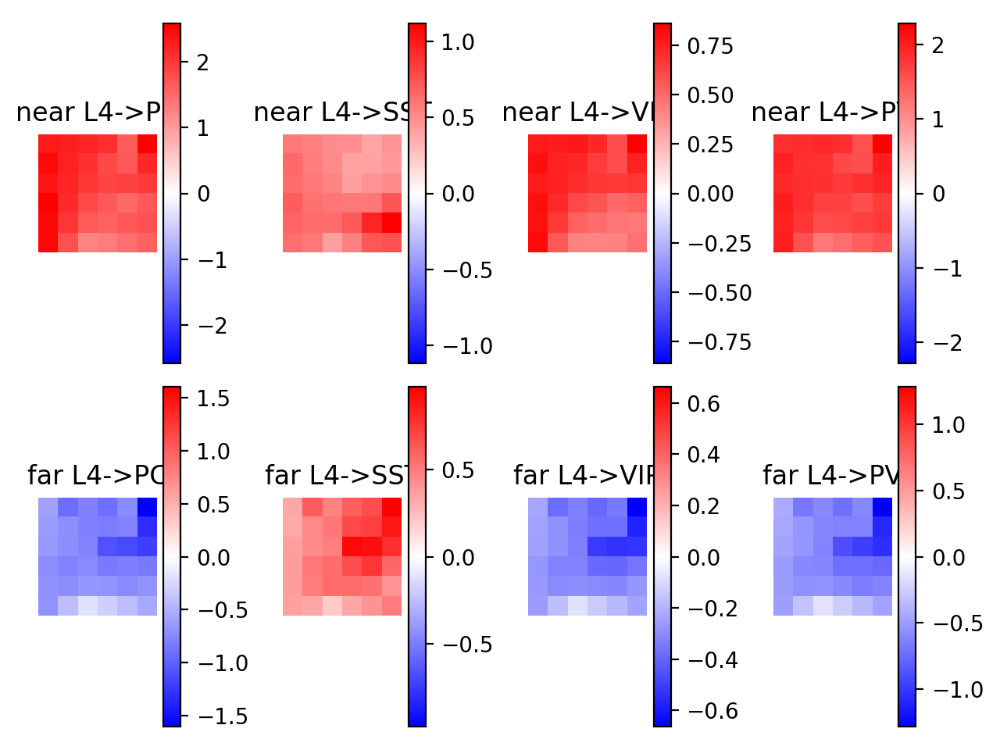

<IPython.core.display.Javascript object>


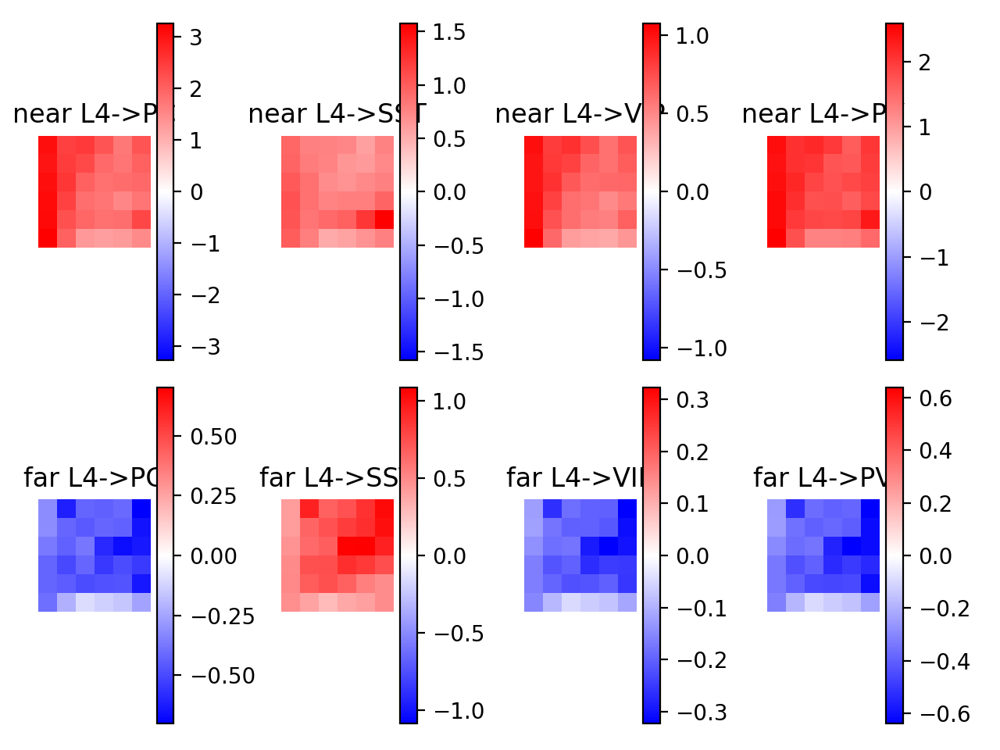

<IPython.core.display.Javascript object>


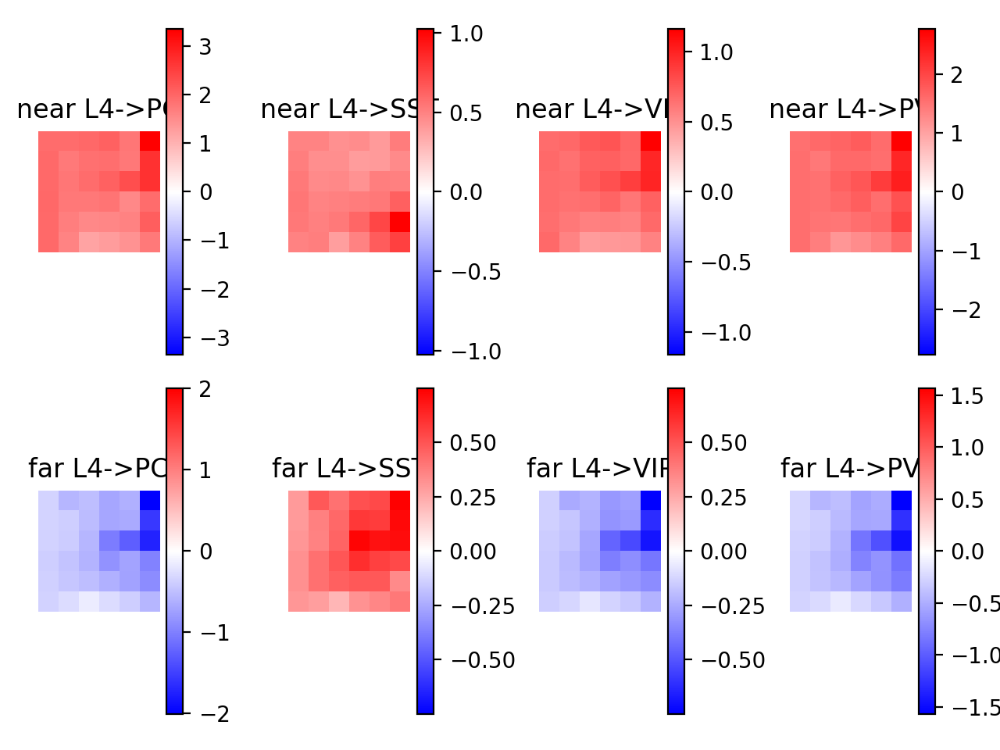

<IPython.core.display.Javascript object>


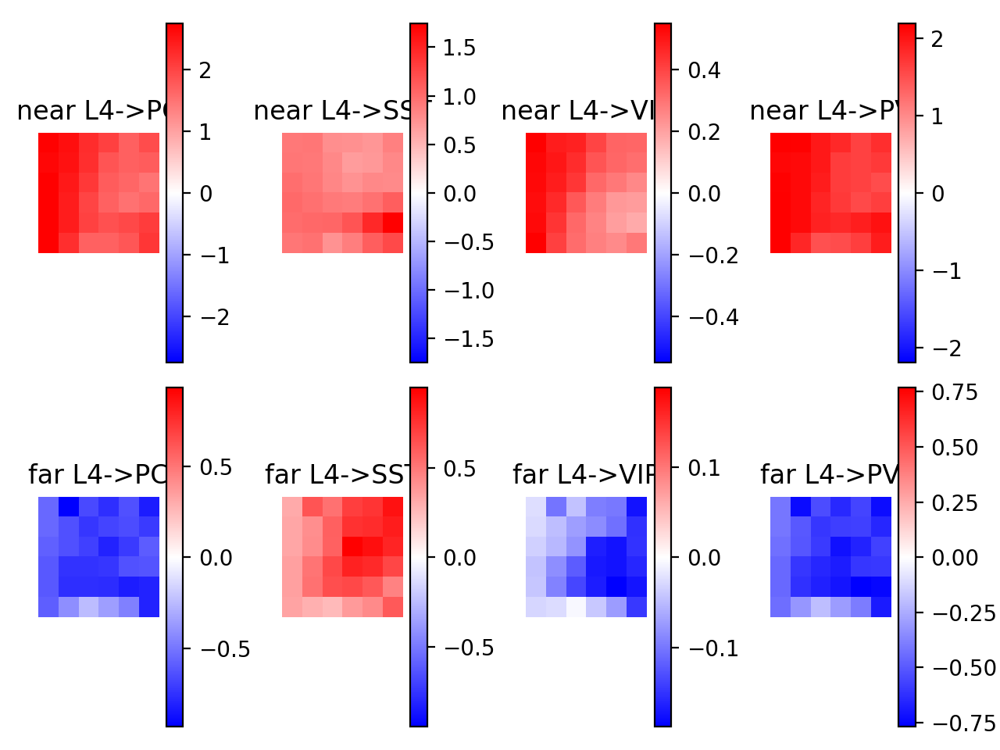

<IPython.core.display.Javascript object>


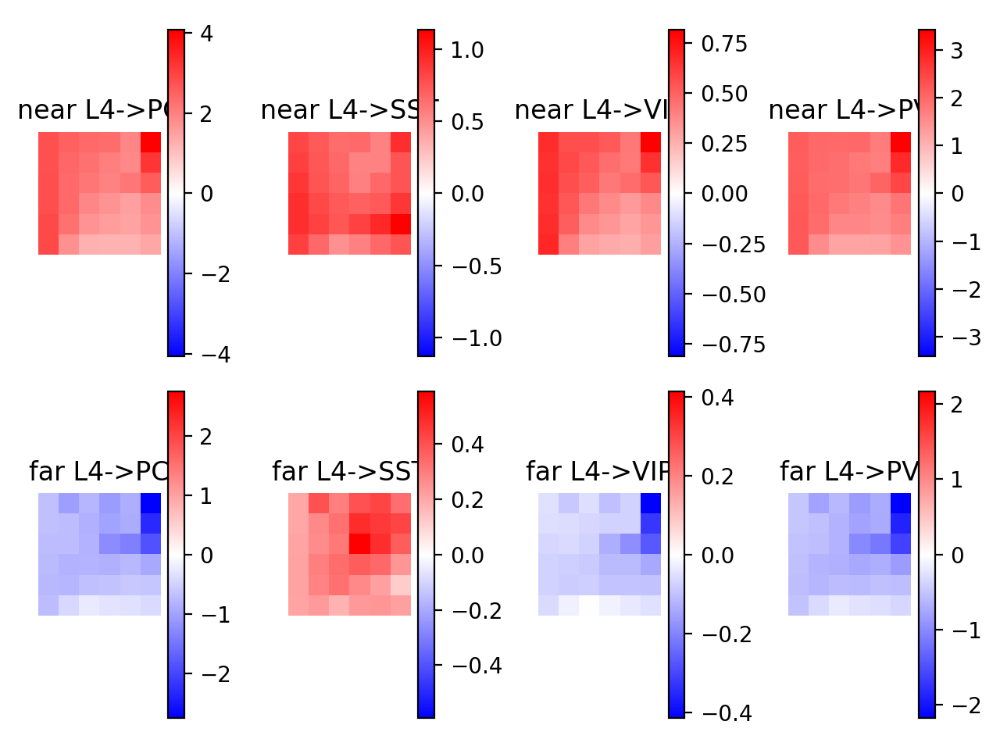

In [979]:
l4_lbls = ['near L4','far L4']
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i2 in range(4):
        plt.subplot(2,4,i2+1)
        data = Xcouplings[iwt][:,:,0,i2]
        plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
        plt.colorbar()
        plt.axis('off')
        plt.title('%s->%s'%(l4_lbls[0],lbls[i2]))
        
        plt.subplot(2,4,4+i2+1)
        data = Xcouplings[iwt][:,:,4,i2]
        plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
        plt.colorbar()
        plt.axis('off')
        plt.title('%s->%s'%(l4_lbls[1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


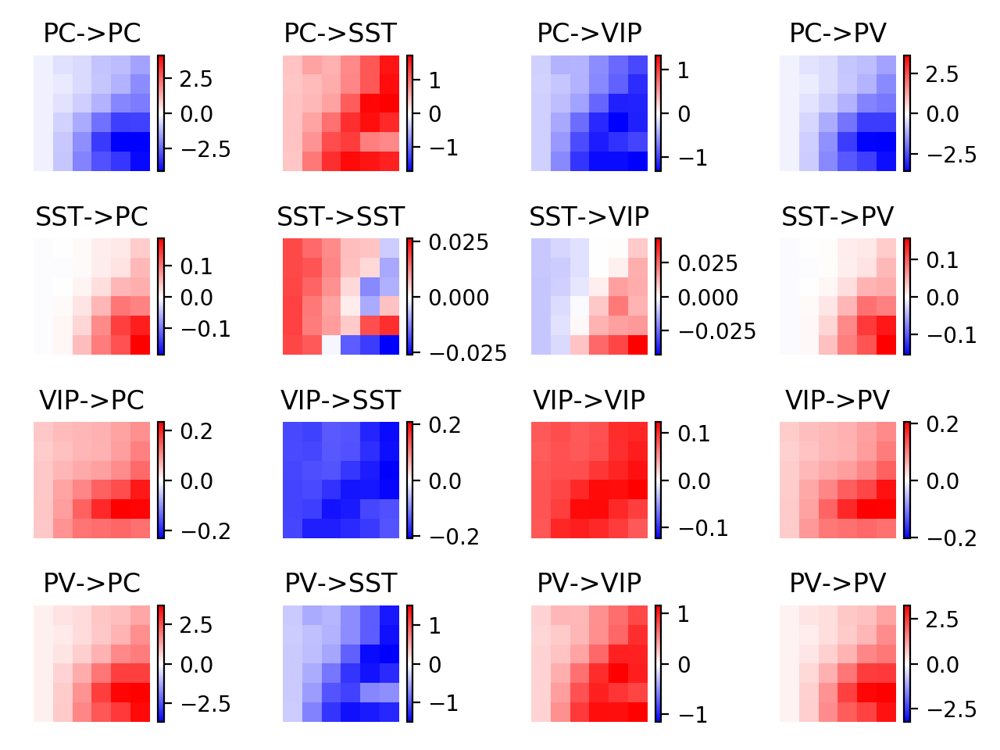

<IPython.core.display.Javascript object>


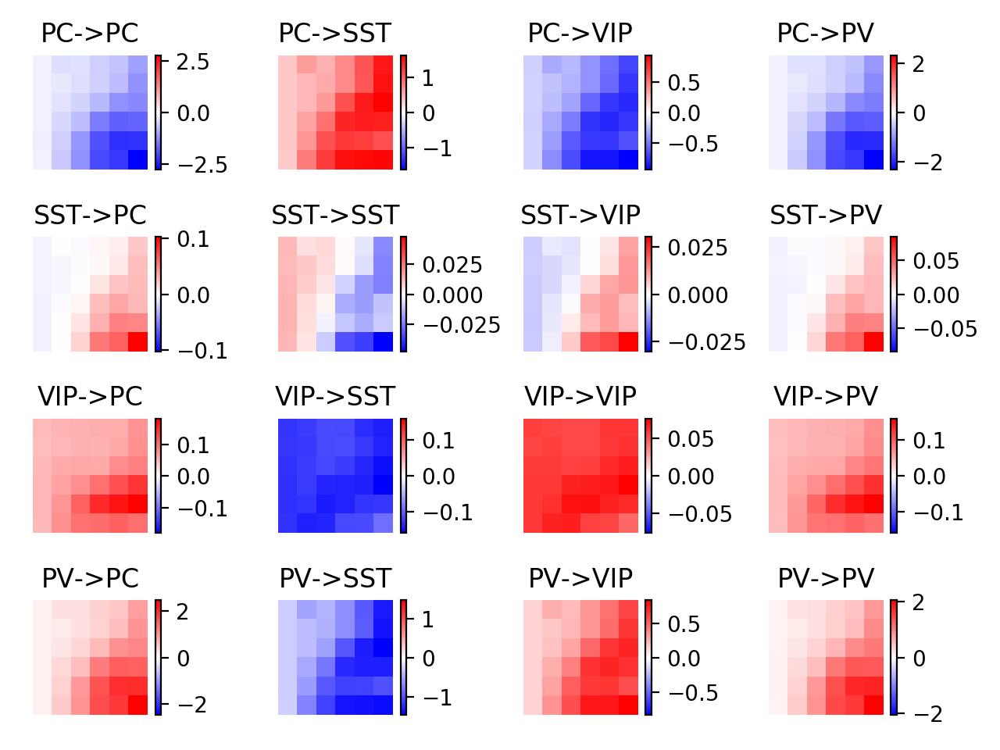

<IPython.core.display.Javascript object>


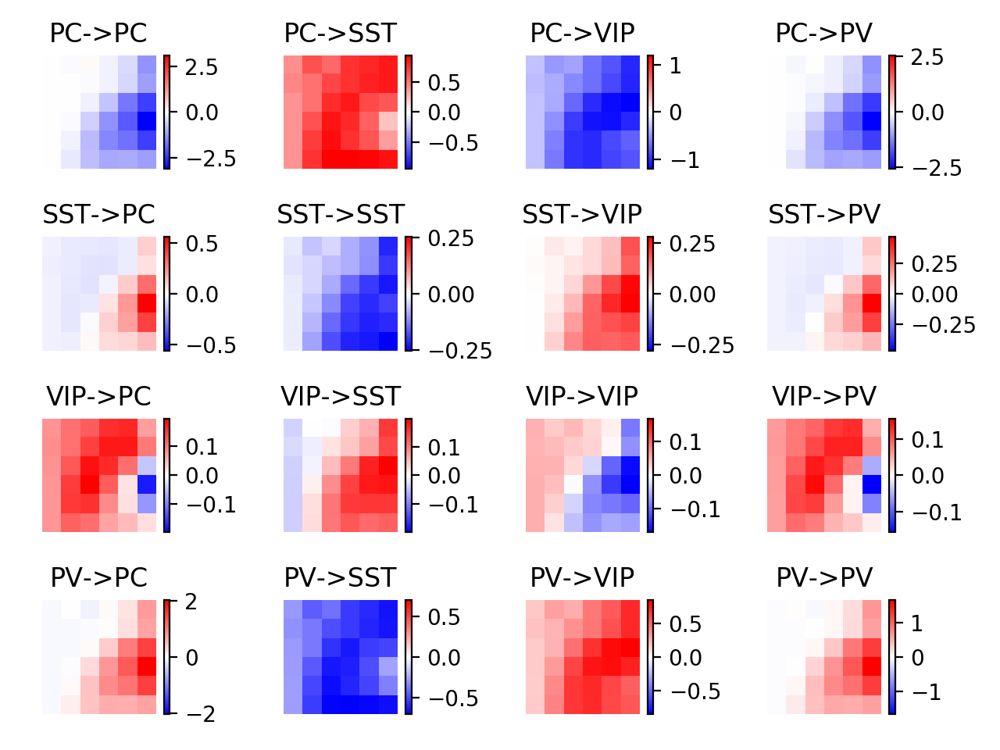

<IPython.core.display.Javascript object>


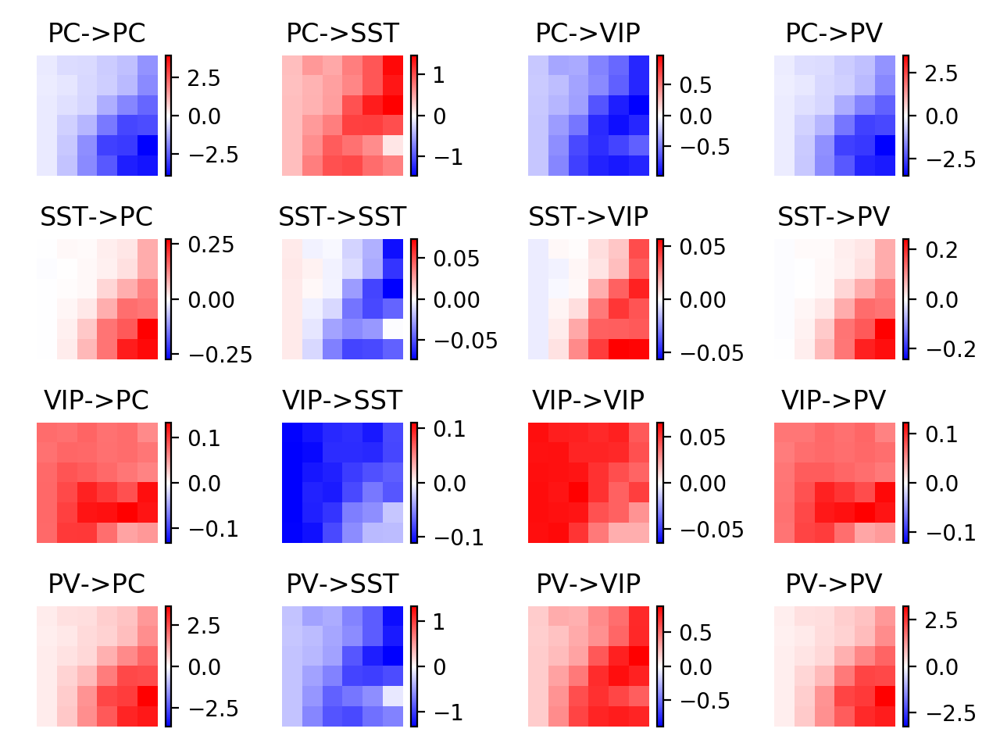

<IPython.core.display.Javascript object>


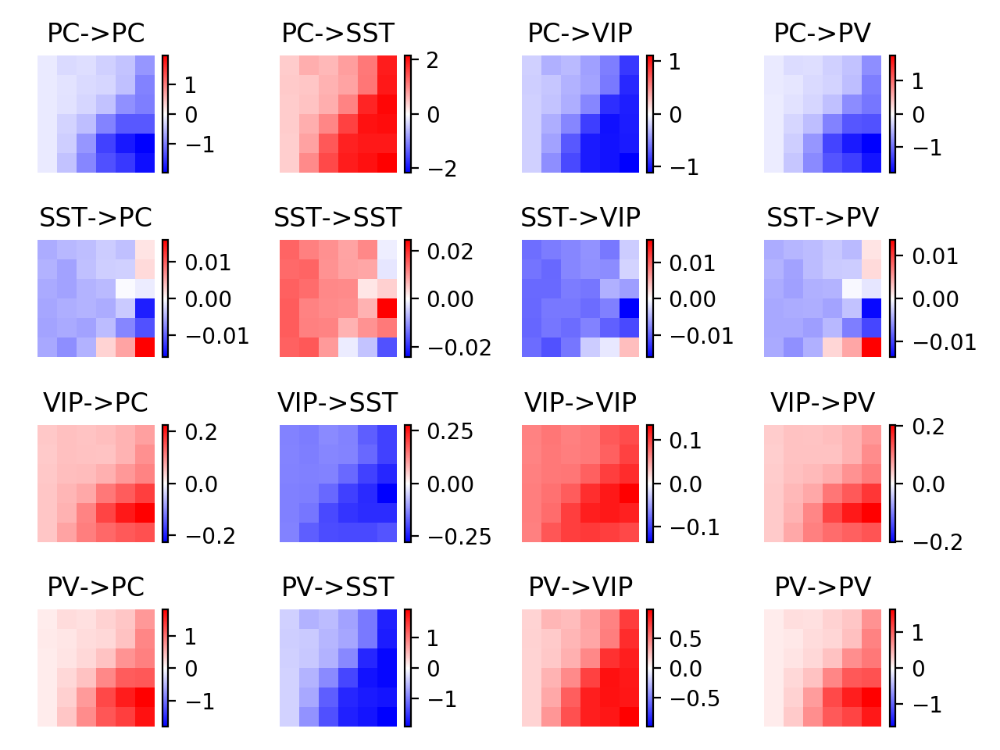

<IPython.core.display.Javascript object>


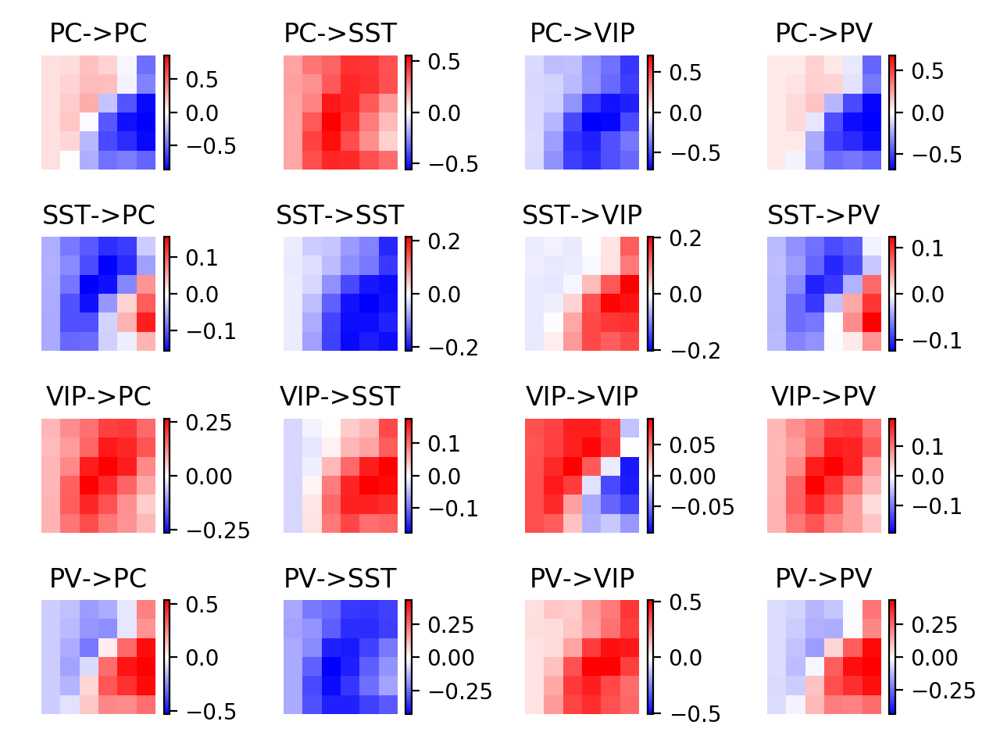

<IPython.core.display.Javascript object>


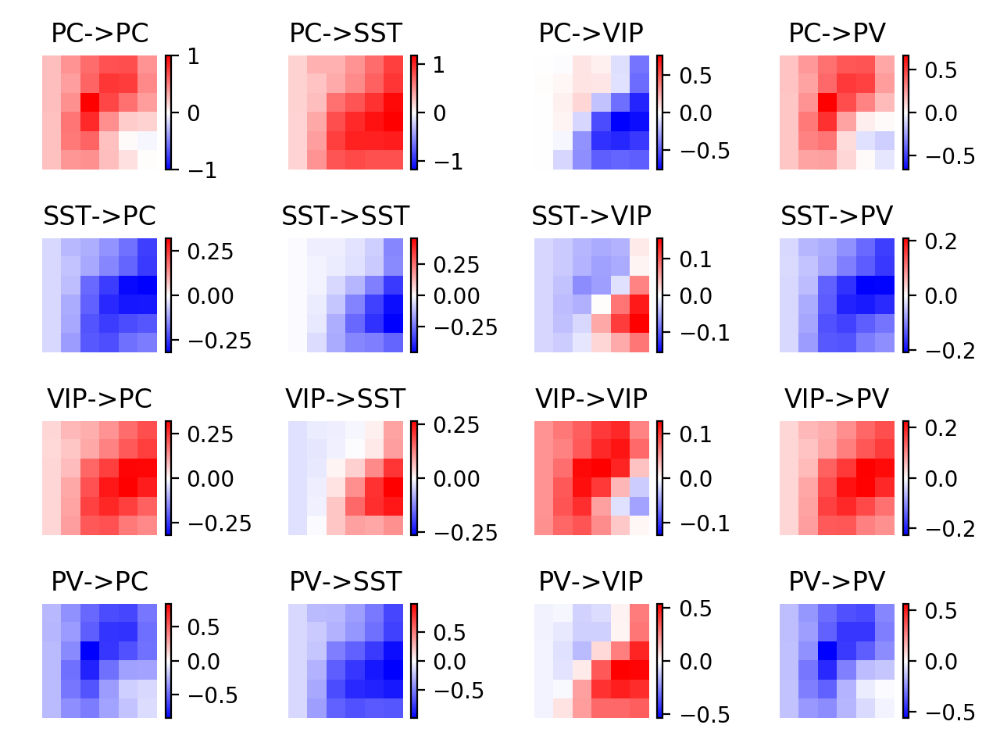

<IPython.core.display.Javascript object>


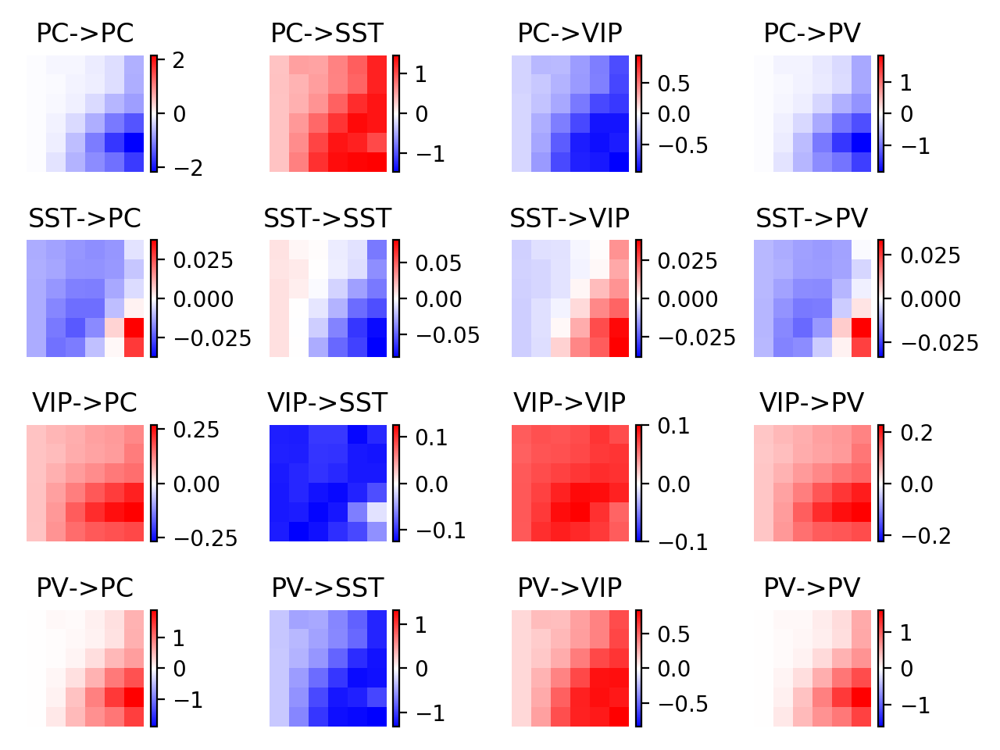

<IPython.core.display.Javascript object>


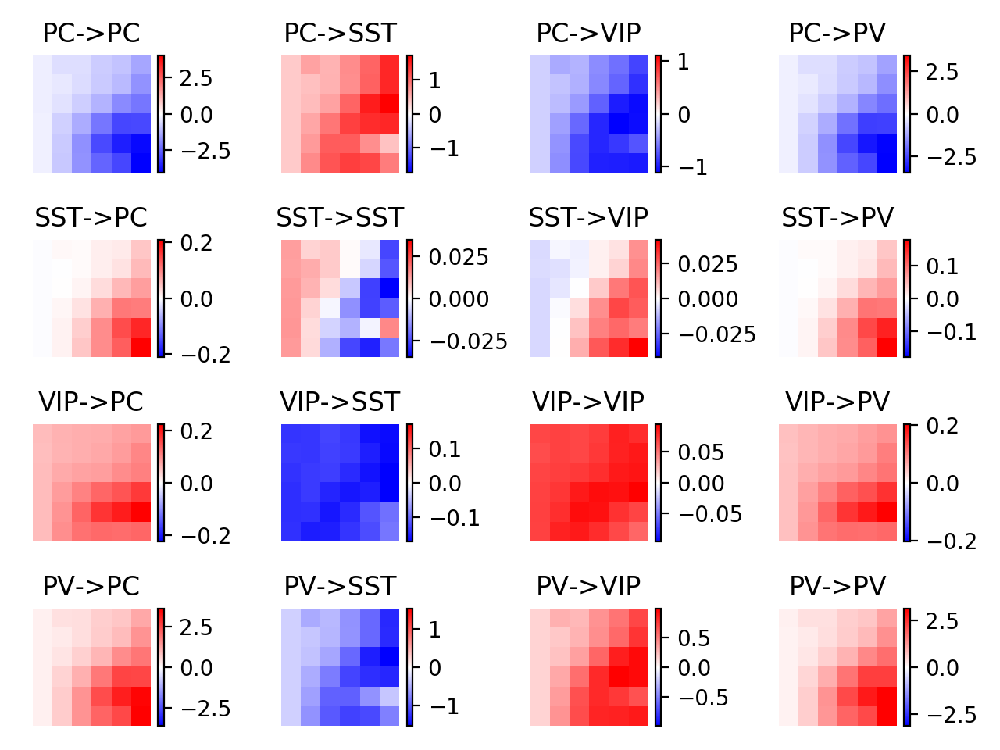

<IPython.core.display.Javascript object>


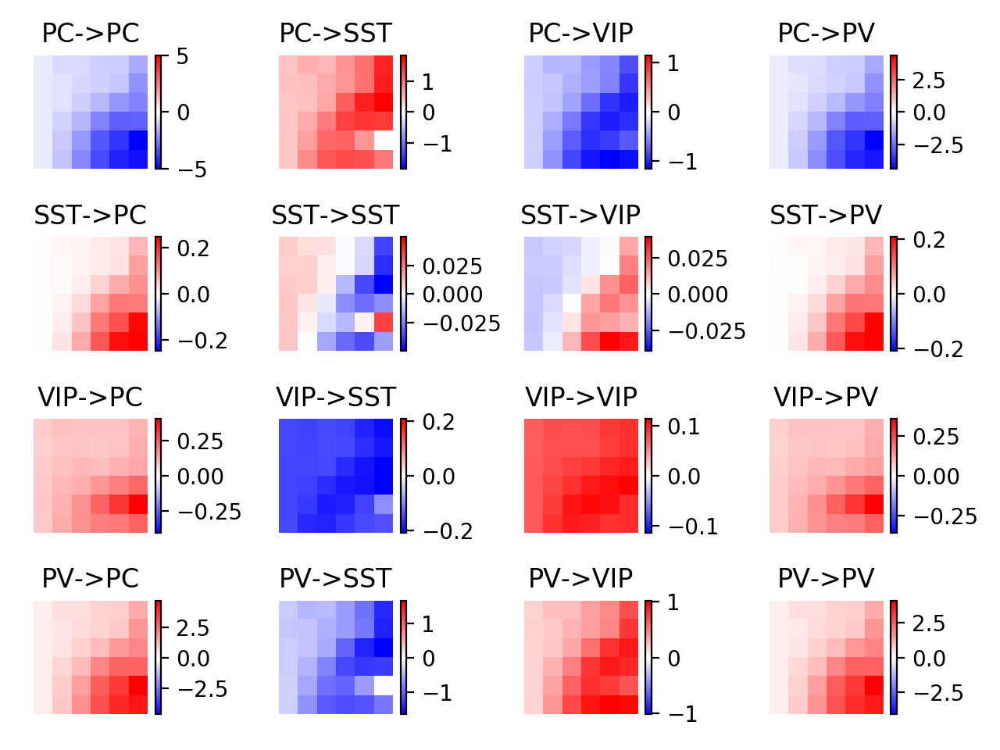

<IPython.core.display.Javascript object>


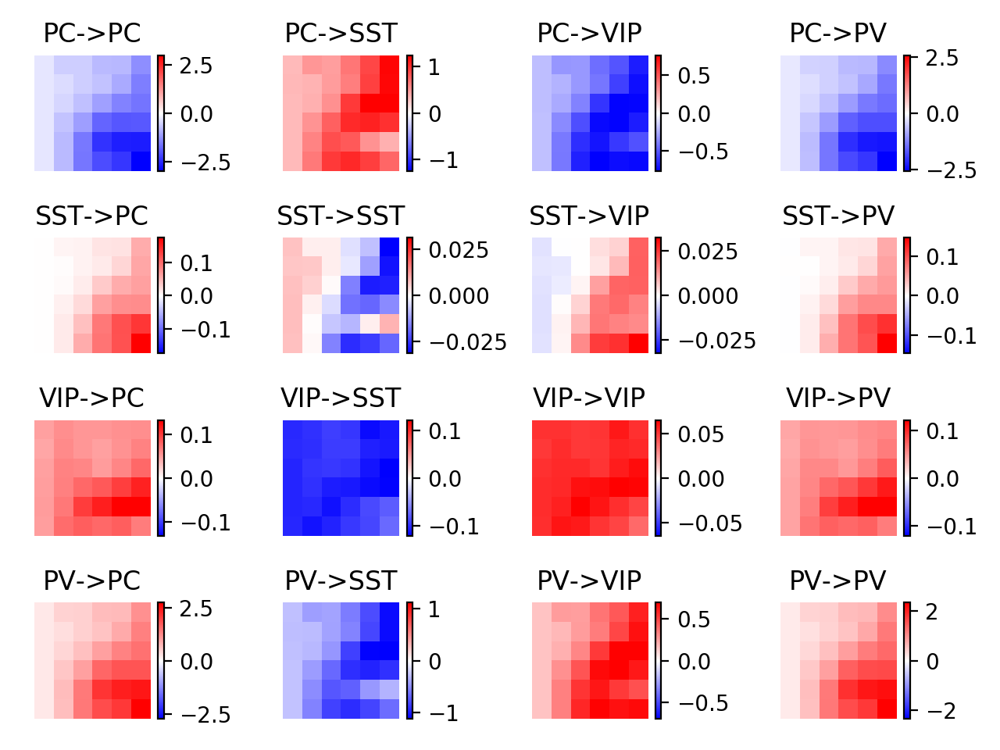

<IPython.core.display.Javascript object>


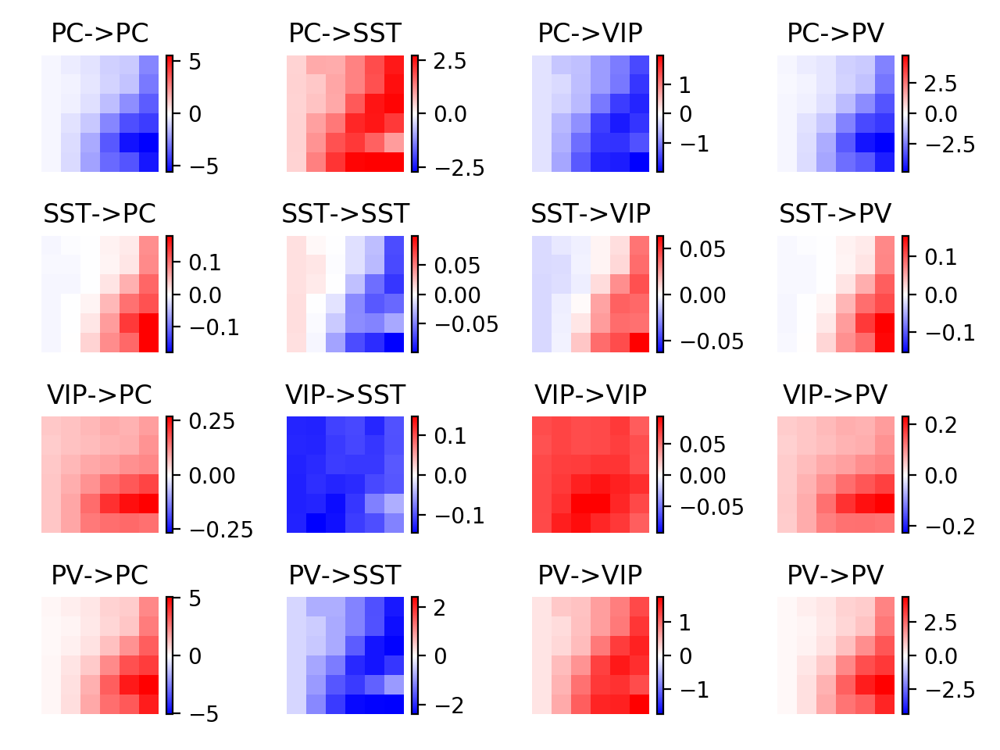

<IPython.core.display.Javascript object>


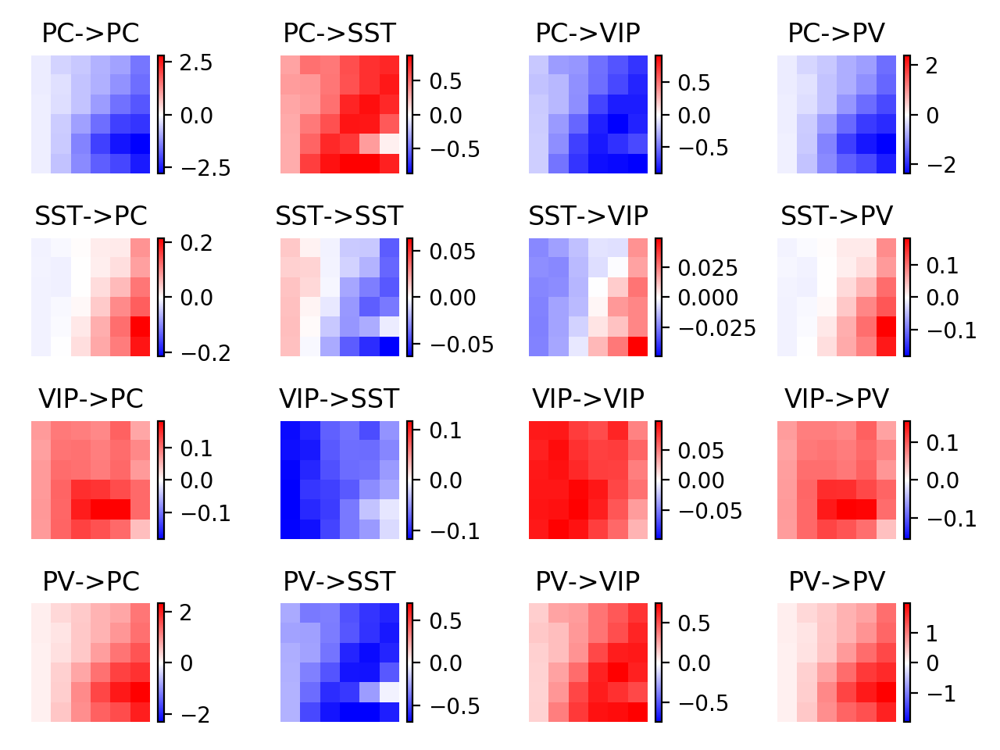

<IPython.core.display.Javascript object>


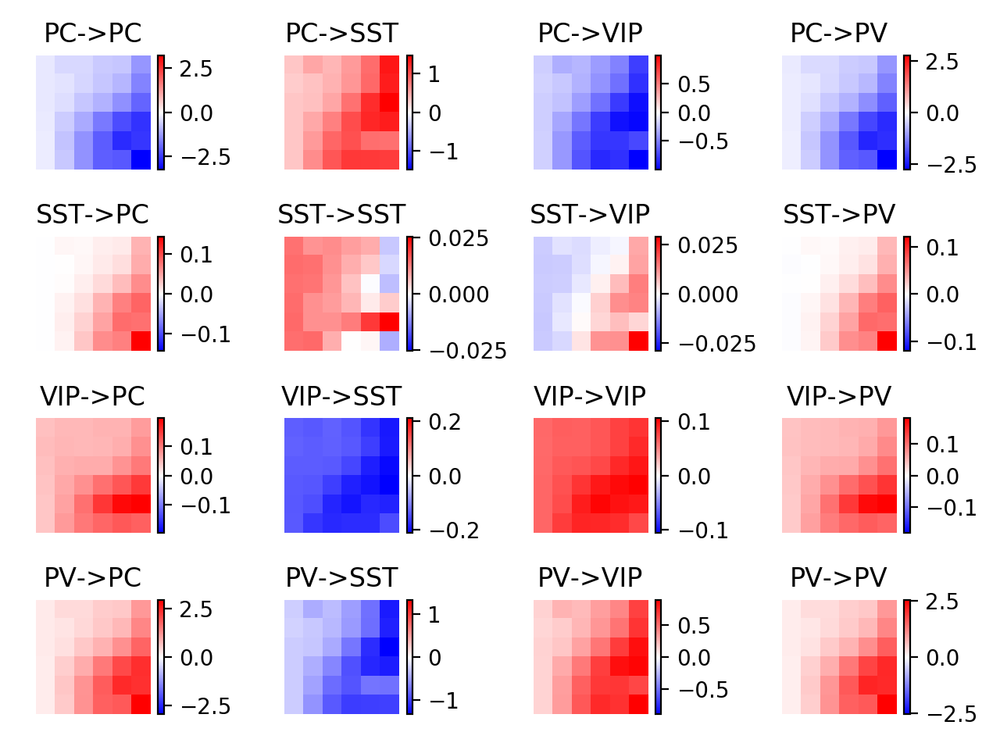

<IPython.core.display.Javascript object>


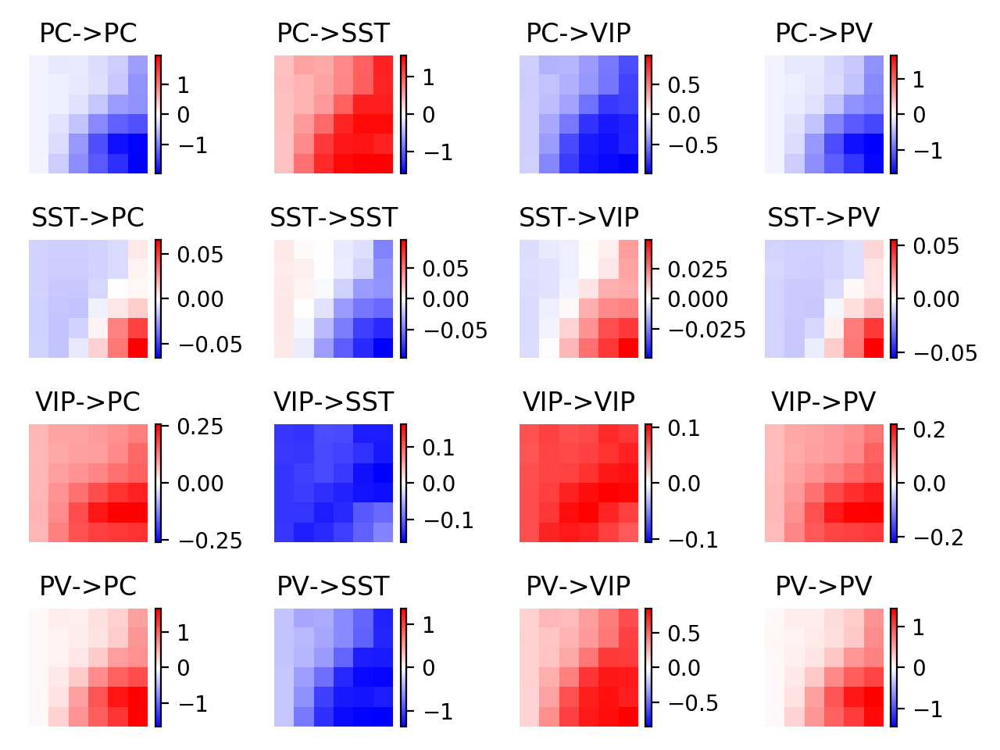

<IPython.core.display.Javascript object>


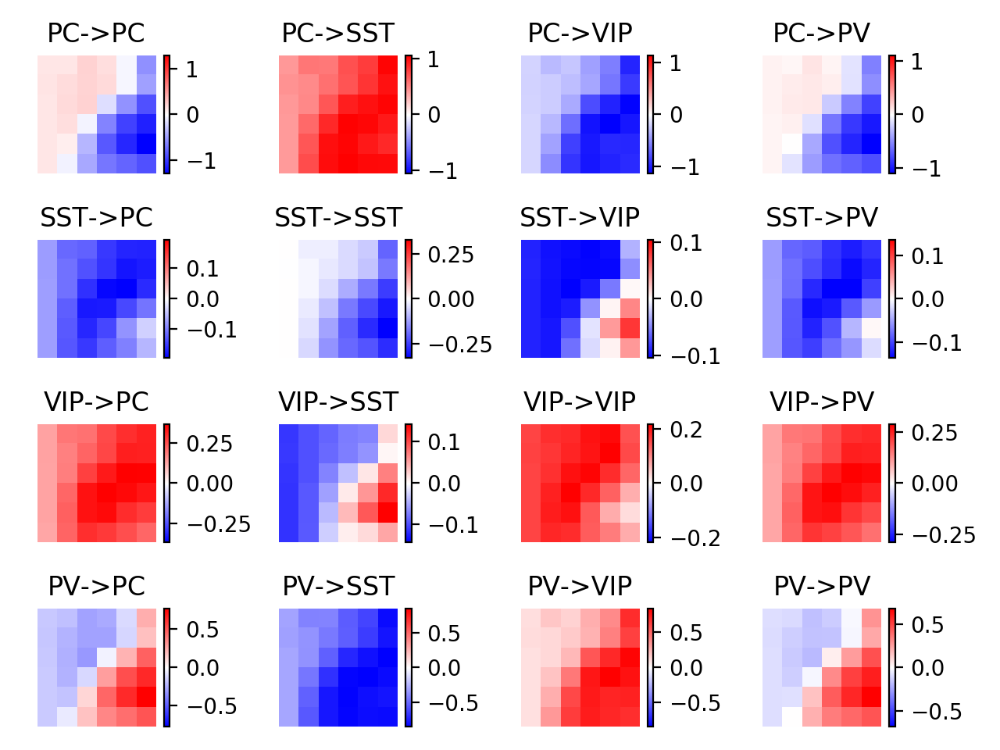

<IPython.core.display.Javascript object>


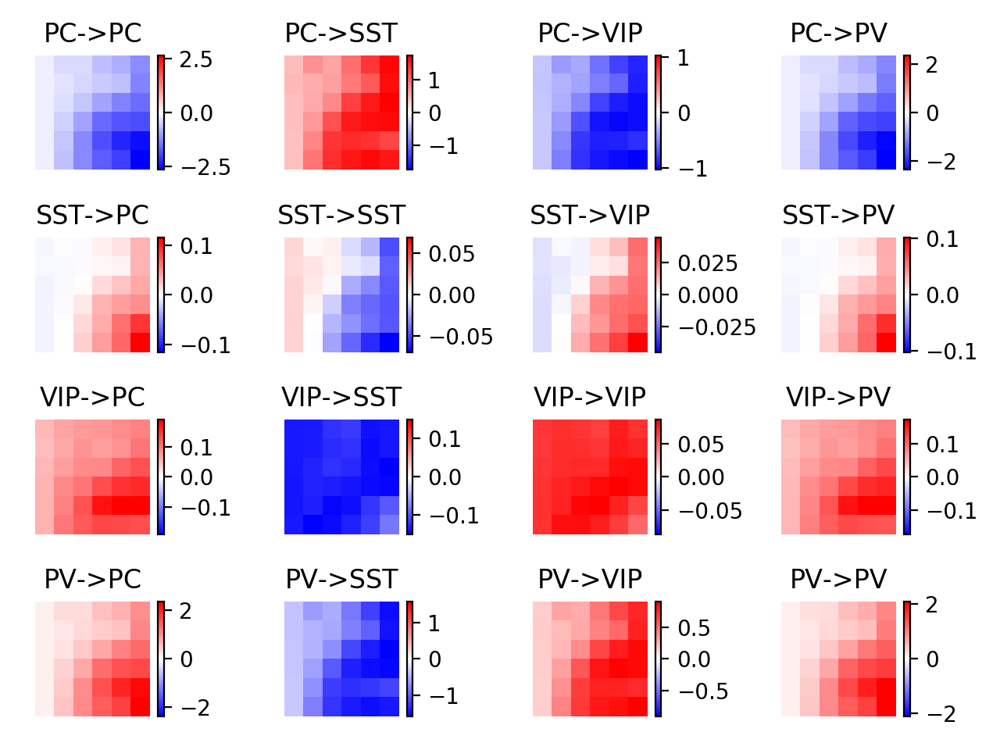

<IPython.core.display.Javascript object>


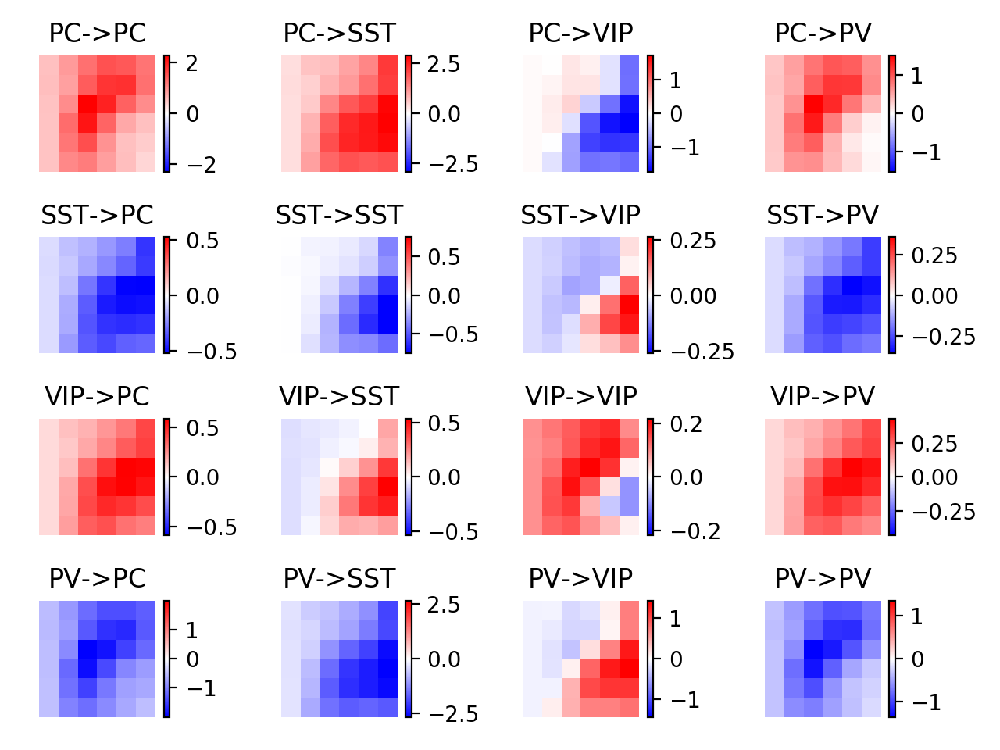

<IPython.core.display.Javascript object>


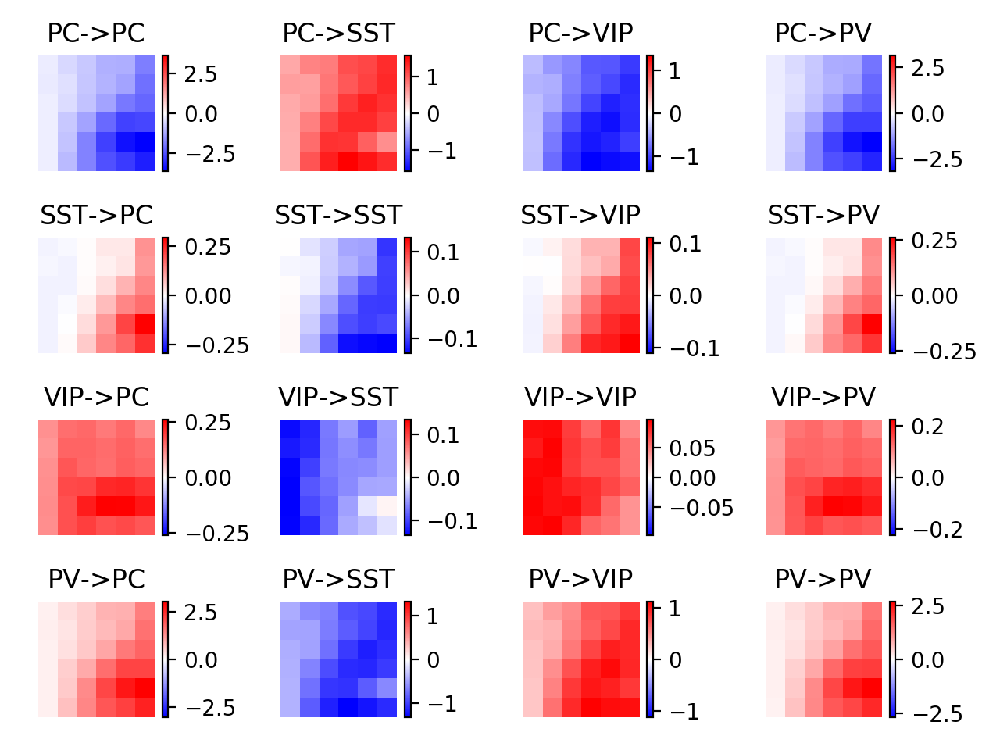

<IPython.core.display.Javascript object>


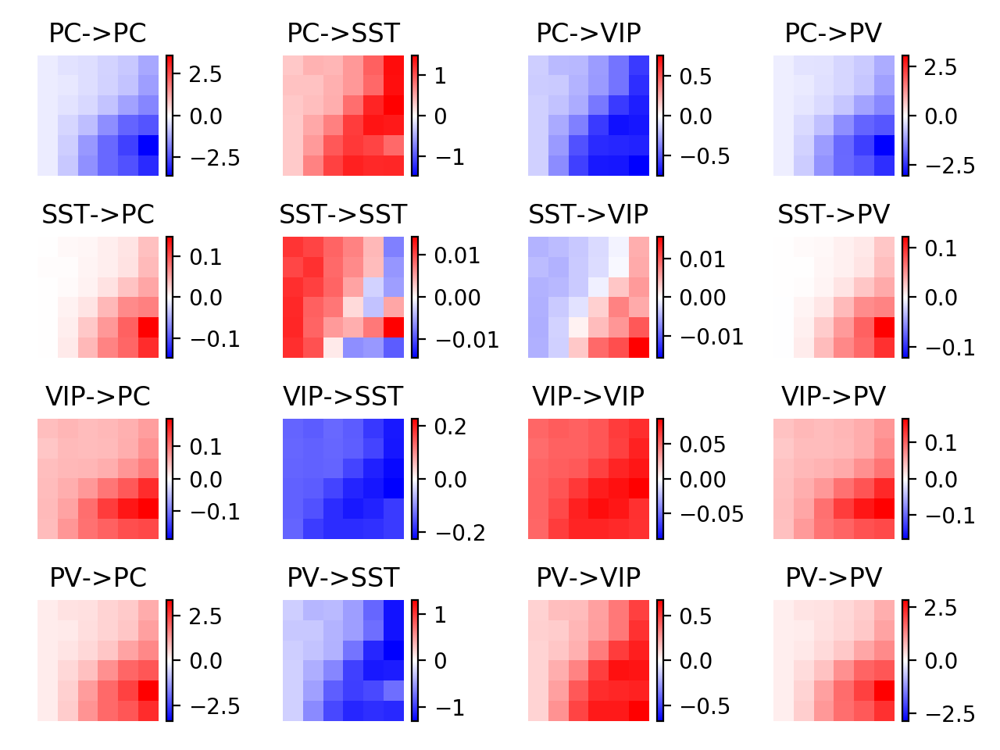

<IPython.core.display.Javascript object>


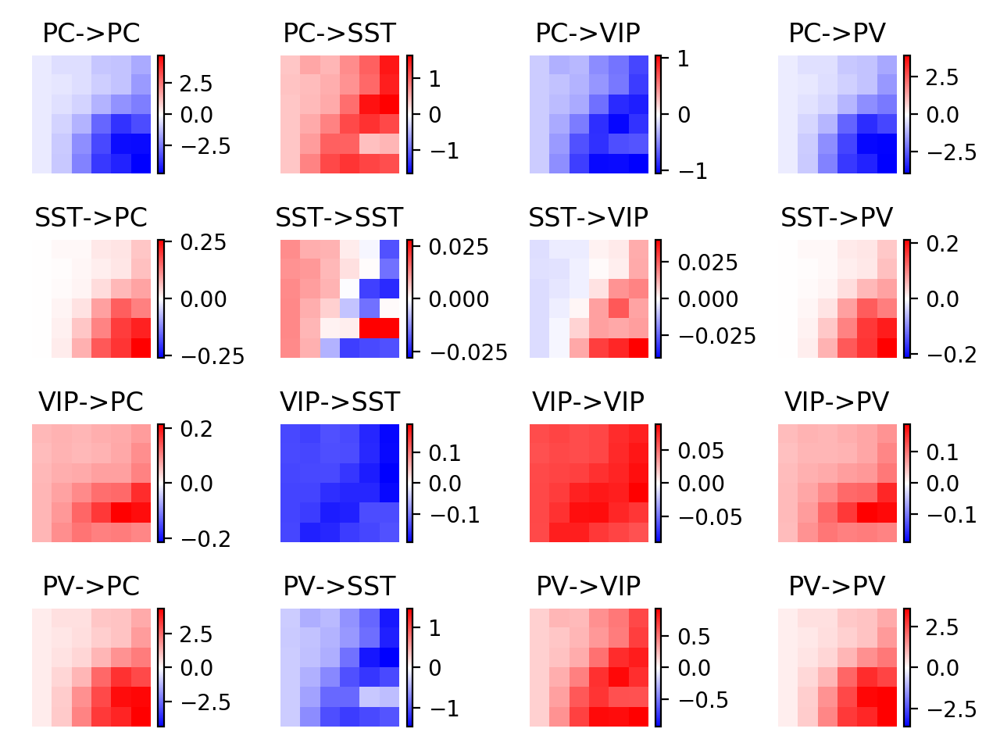

<IPython.core.display.Javascript object>


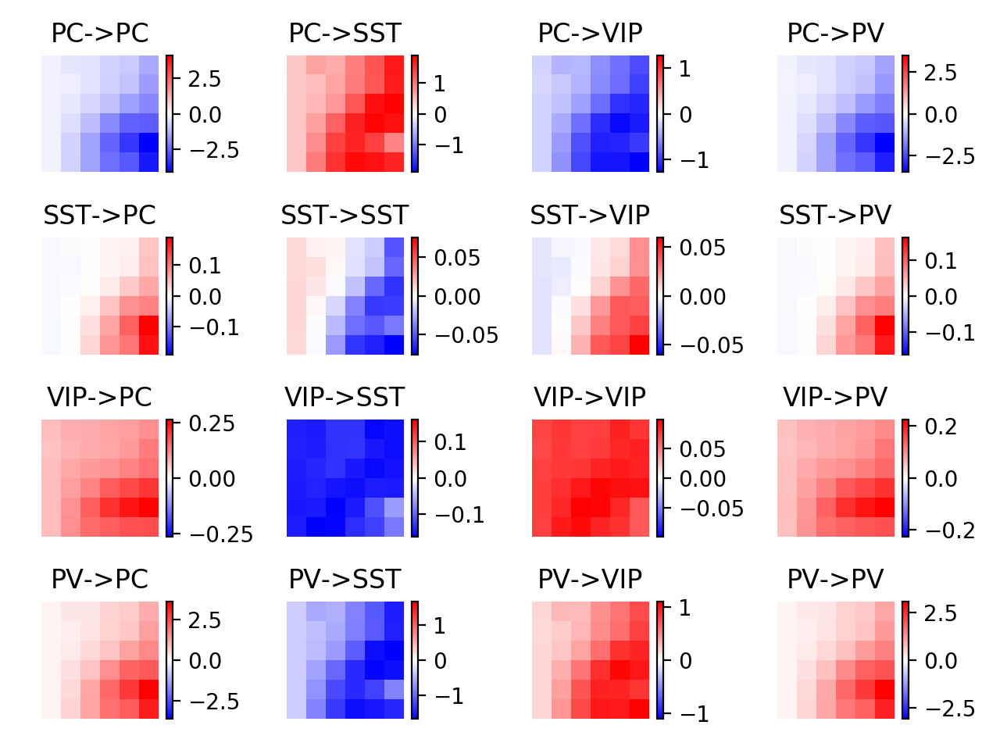

In [74]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,8+i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


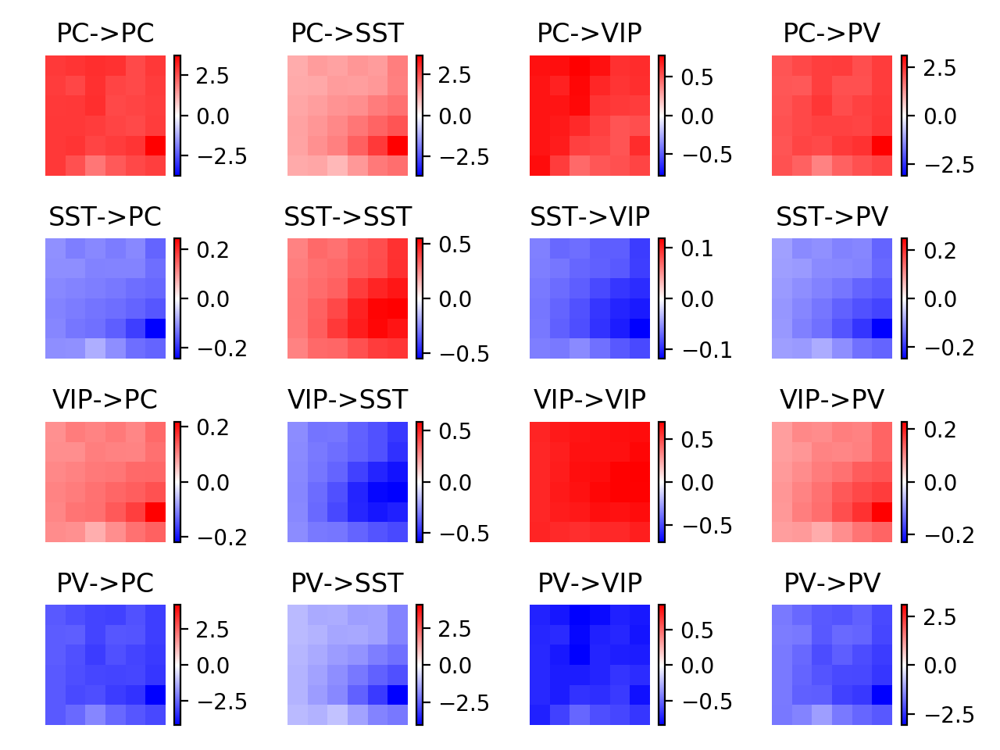

<IPython.core.display.Javascript object>


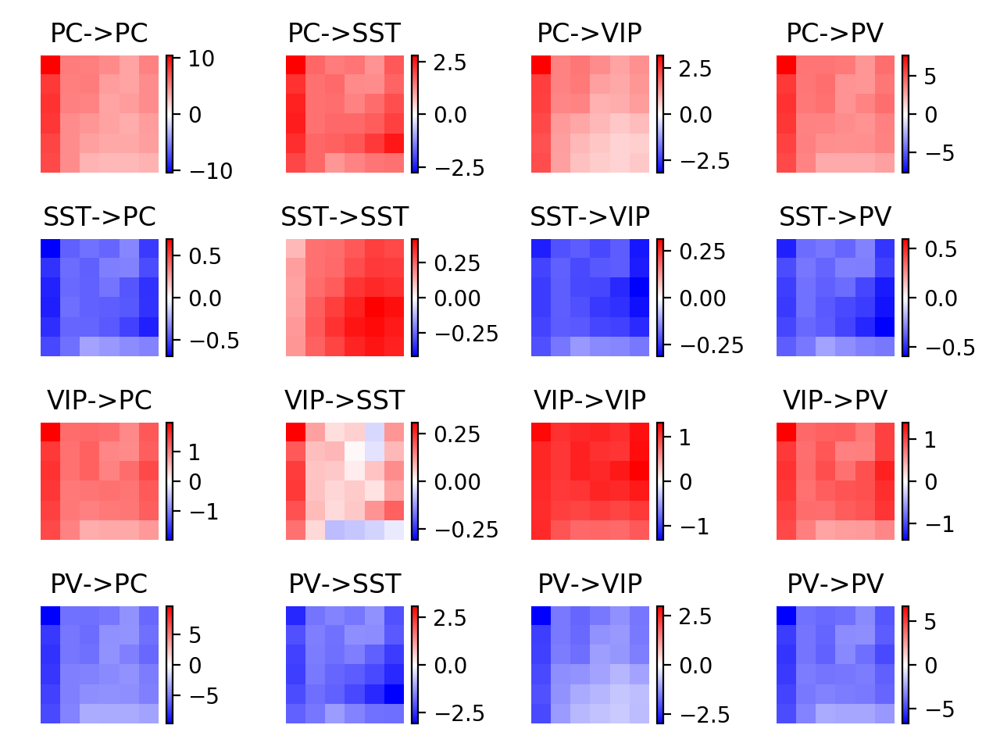

<IPython.core.display.Javascript object>


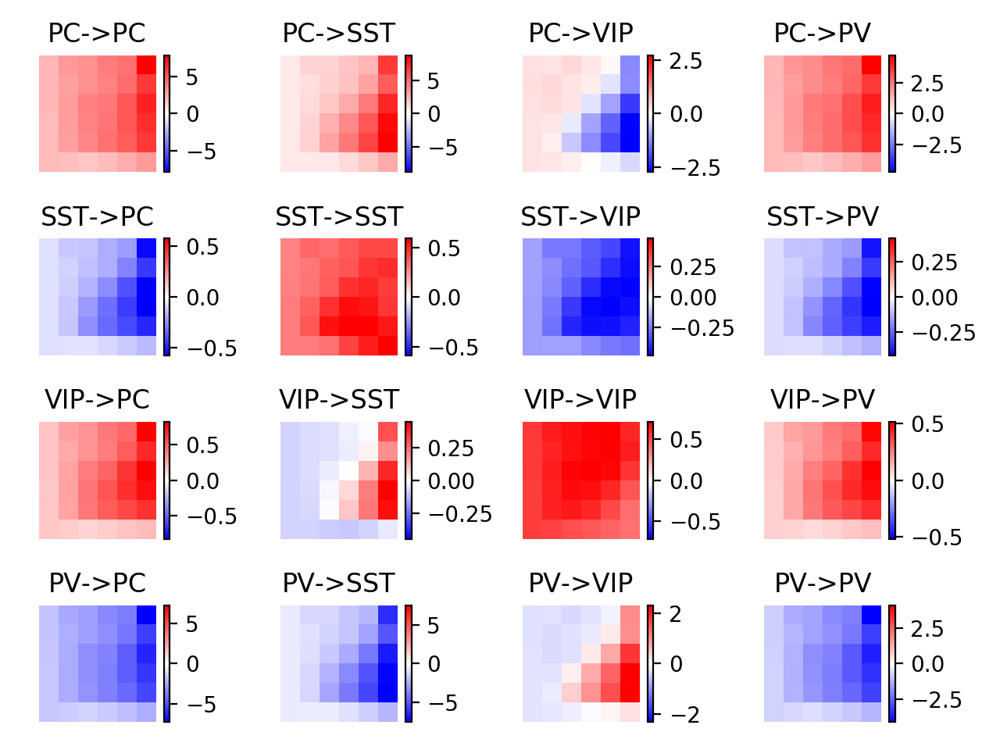

<IPython.core.display.Javascript object>


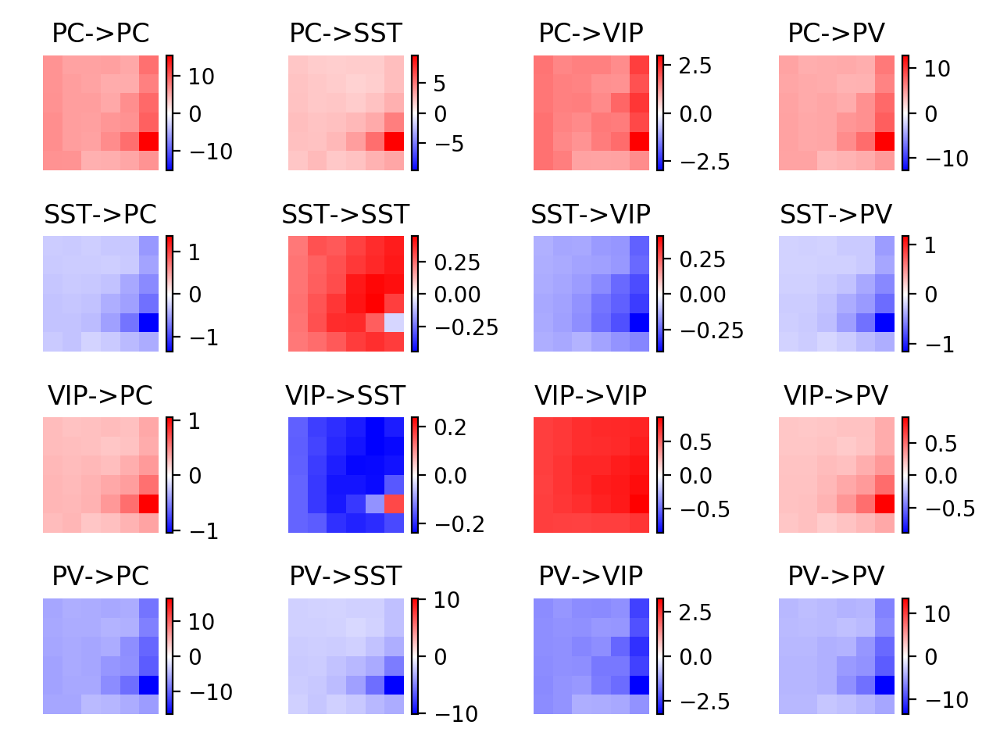

<IPython.core.display.Javascript object>


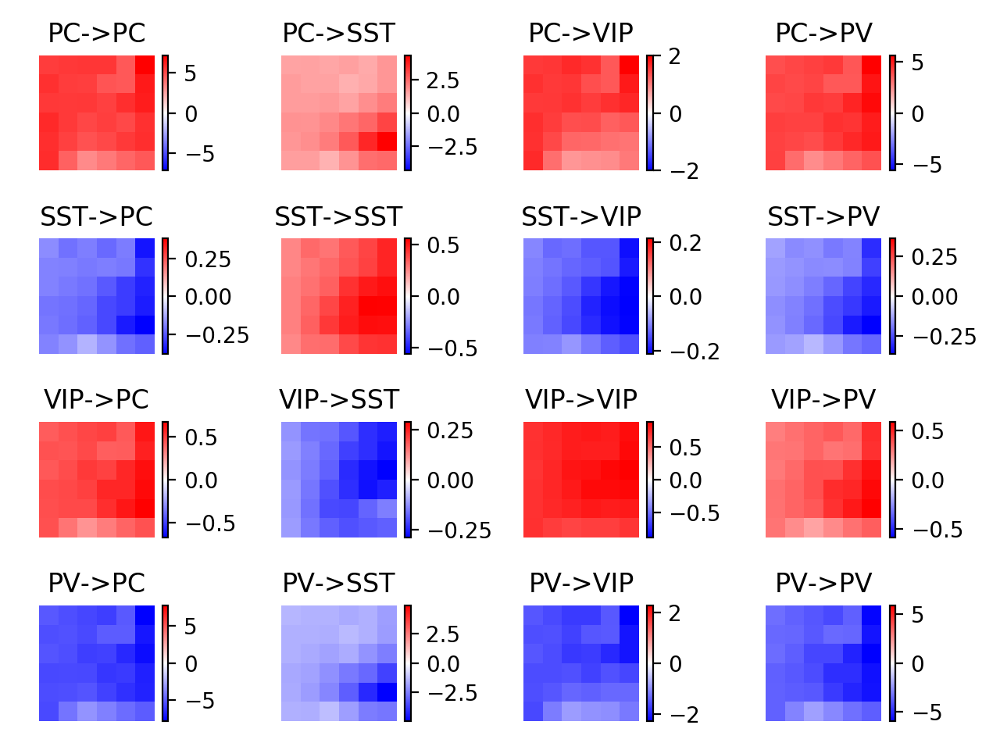

<IPython.core.display.Javascript object>


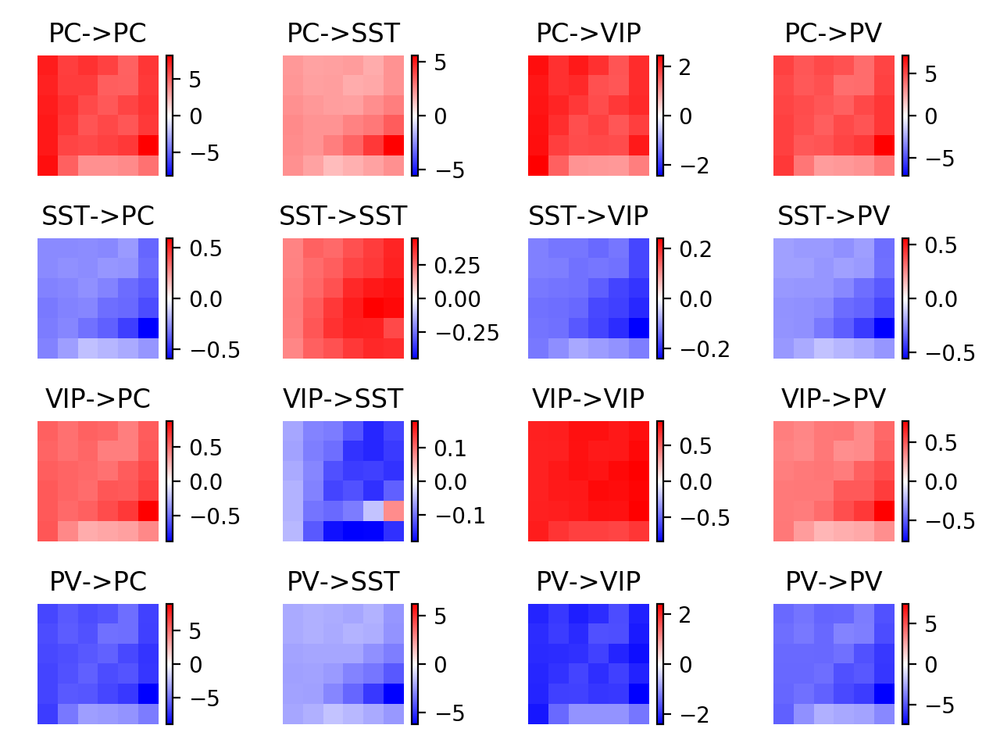

<IPython.core.display.Javascript object>


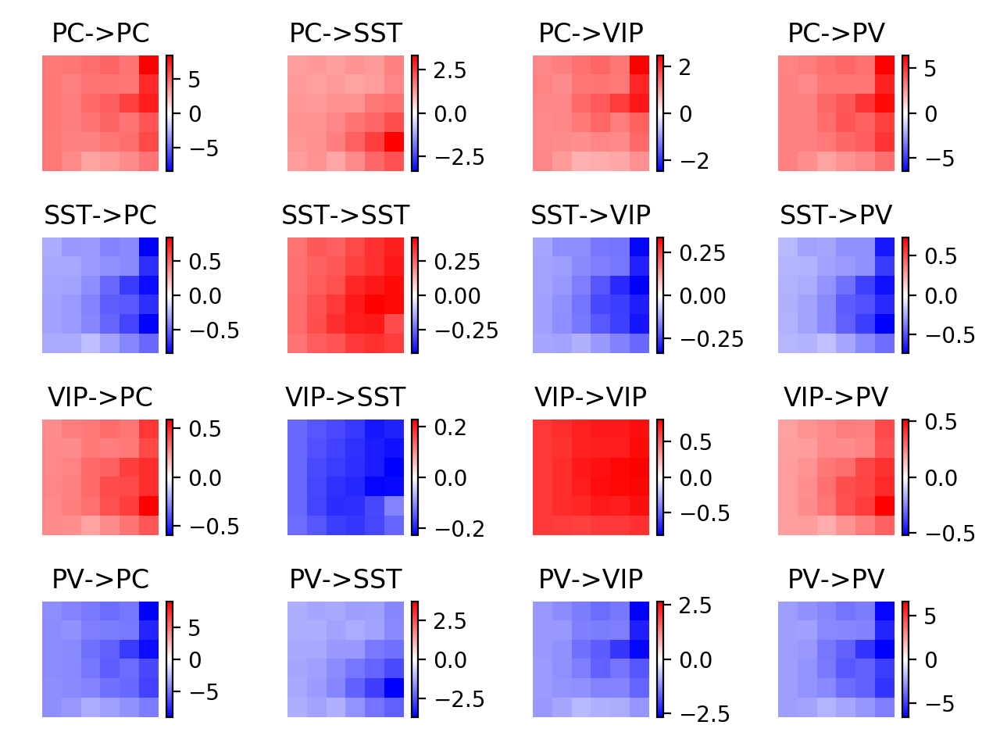

<IPython.core.display.Javascript object>


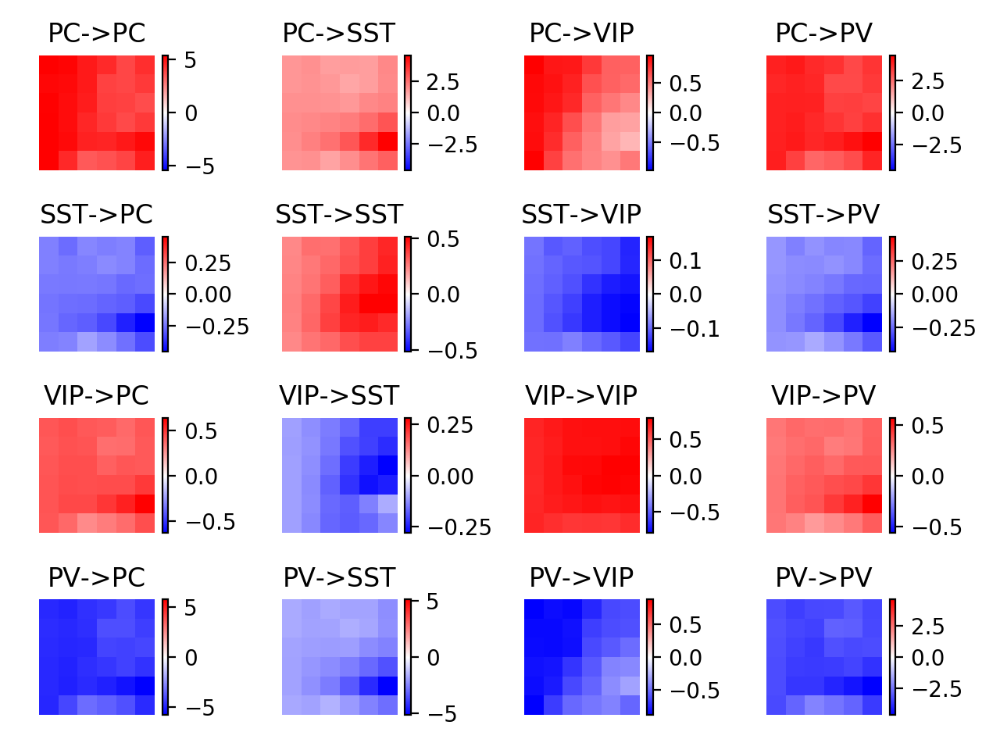

<IPython.core.display.Javascript object>


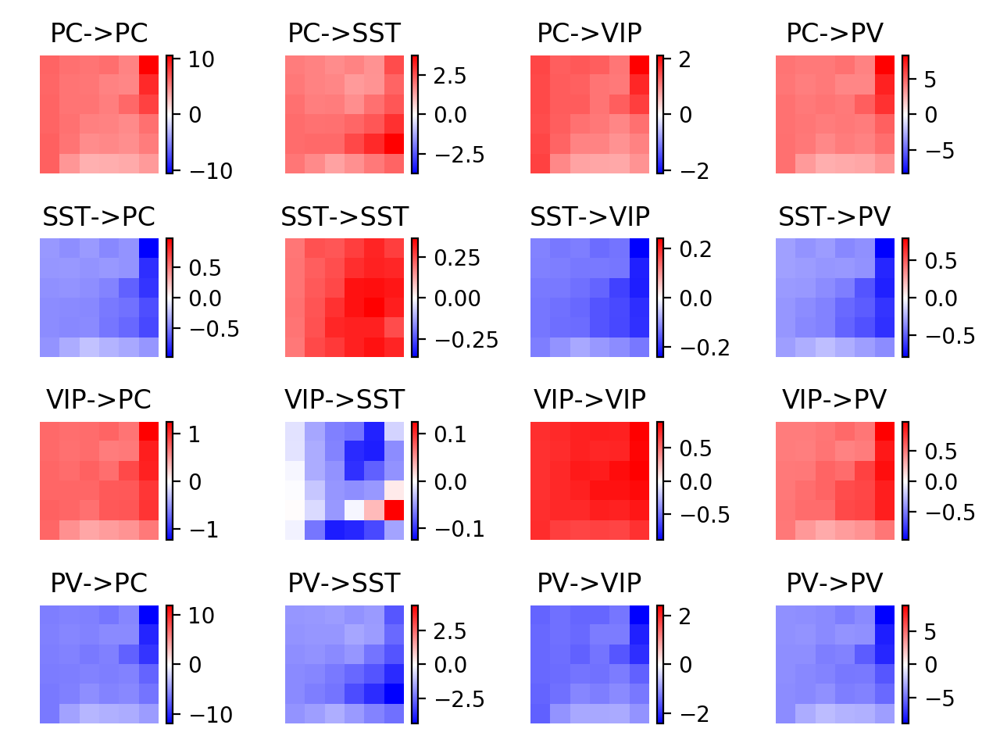

In [988]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


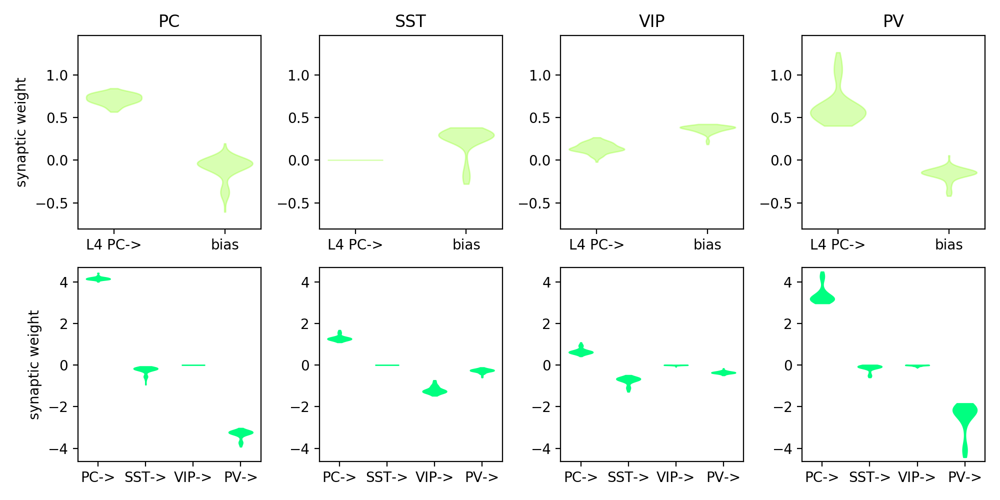

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:33: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


In [311]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(10,5))
for datas in [[Wmxs,Wmys]]:#,[Wsx,Wsy]]:
    titles = ['PC','SST','VIP','PV']
    data = datas[0]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L4 PC->','bias']
    for icelltype in range(nQ):
        plt.subplot(2,nQ,icelltype+1)
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.5,1,0.0])
            pc.set_edgecolor([0.5,1,0.0])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
        plt.title(titles[icelltype])
#     plt.figure(figsize=(7.5,2))
    data = datas[1]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['PC->','SST->','VIP->','PV->']
    for icelltype in range(nQ):
        plt.subplot(2,nQ,nQ+icelltype+1)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.0,1,0.5])
            pc.set_edgecolor([0.0,1,0.5])
            pc.set_alpha(1)
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
#         plt.title(titles[icelltype])
    plt.subplot(2,4,1)
    plt.ylabel('synaptic weight')
    plt.subplot(2,4,5)
    plt.ylabel('synaptic weight')
    plt.tight_layout()
plt.savefig('figures/violinplots_fit_weights.jpg',dpi=300)

<IPython.core.display.Javascript object>


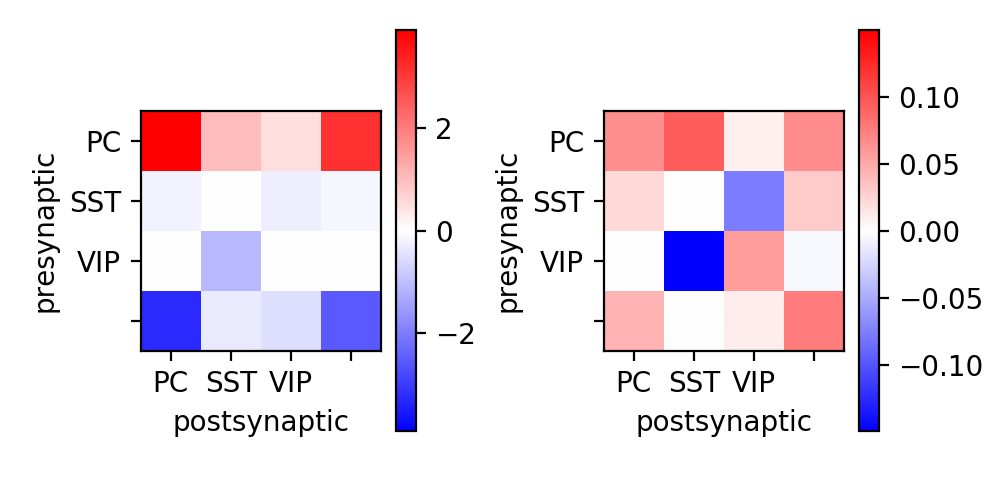

In [108]:
plt.figure(figsize=(5,2.5))
for iw,w in enumerate([Wmys,Wsys]):
    plt.subplot(1,2,iw+1)
    data = np.mean(w[lkat],0)
    mx = np.max(np.abs(data))
    plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
    plt.xticks(np.arange(4),lbls)
    plt.yticks(np.arange(4),lbls)
    plt.ylim(3.5,-0.5)
    plt.colorbar()
    plt.xlabel('postsynaptic')
    plt.ylabel('presynaptic')
    plt.tight_layout()
# plt.savefig('figures/Wmy_heatmap.eps')

<IPython.core.display.Javascript object>


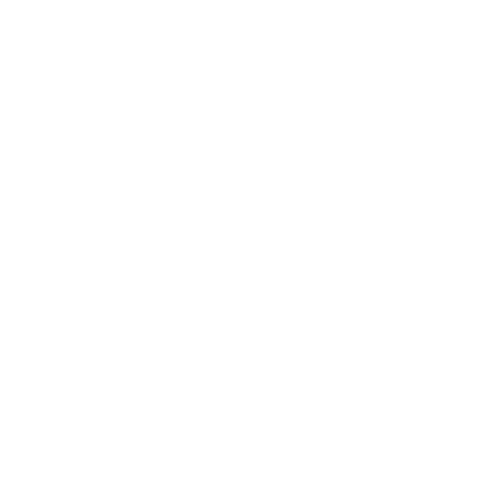

NameError: name 'Wsys' is not defined

In [74]:
plt.figure(figsize=(2.5,2.5))
data = np.mean(Wsys[lkat],0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),lbls)
plt.yticks(np.arange(4),lbls)
plt.ylim(3.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
# plt.savefig('figures/Wmy_heatmap.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


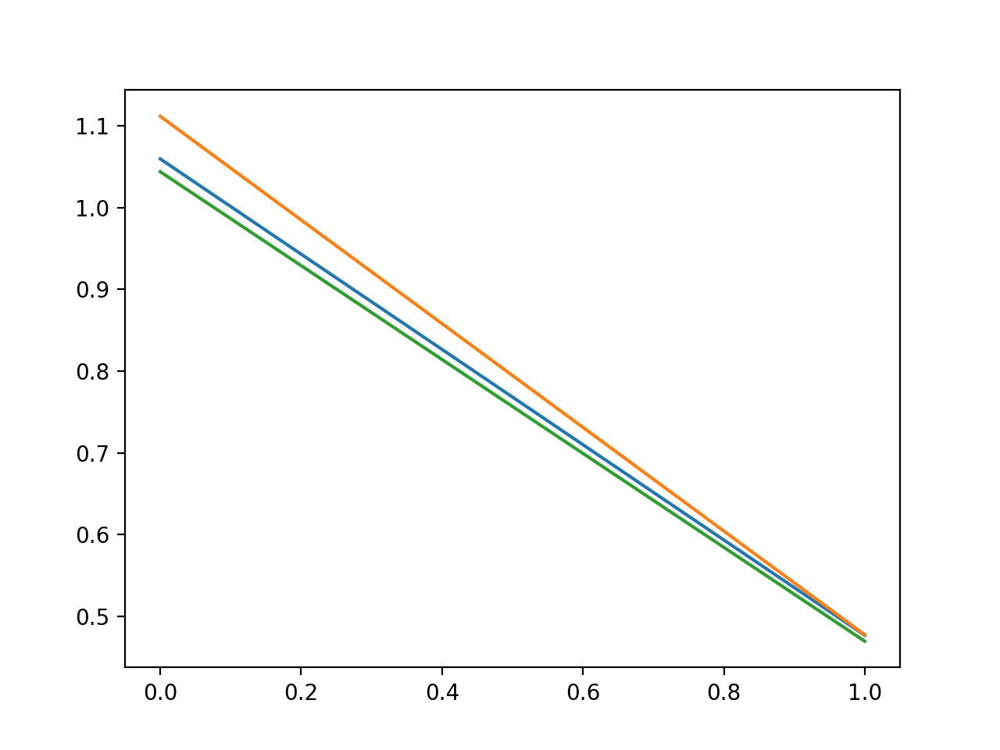

In [206]:
plt.figure()
plt.plot(Wmys[lkat,0,1:3].T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


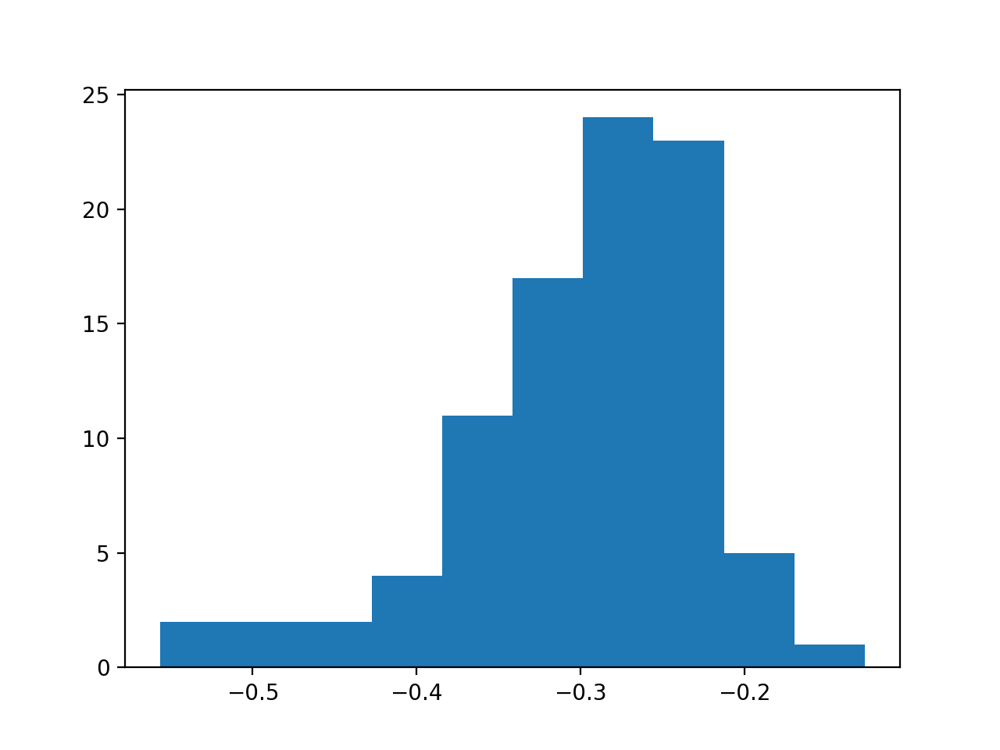

(array([ 2.,  2.,  2.,  4., 11., 17., 24., 23.,  5.,  1.]),
 array([-0.55635752, -0.51338179, -0.47040606, -0.42743033, -0.38445459,
        -0.34147886, -0.29850313, -0.2555274 , -0.21255167, -0.16957594,
        -0.12660021]),
 <a list of 10 Patch objects>)

In [1324]:
plt.figure()
plt.hist(Wmys[lkat,1,0])

<IPython.core.display.Javascript object>


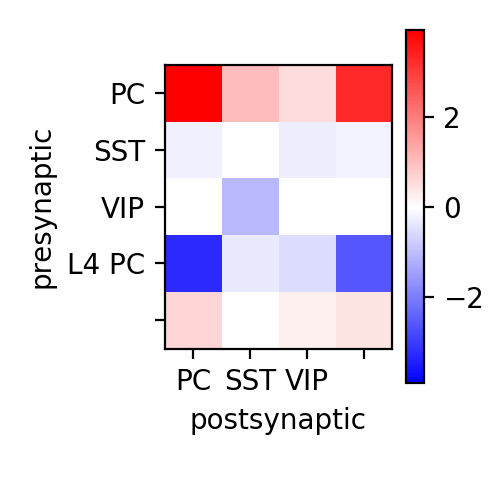

In [109]:
plt.figure(figsize=(2.5,2.5))
data = np.concatenate((np.mean(Wmys,0),np.mean(Wmxs,0)[0:1]),axis=0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),lbls)
plt.yticks(np.arange(5),lbls+['L4 PC'])
plt.ylim(4.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
# plt.savefig('figures/Wmy_extended_heatmap.eps')

<IPython.core.display.Javascript object>


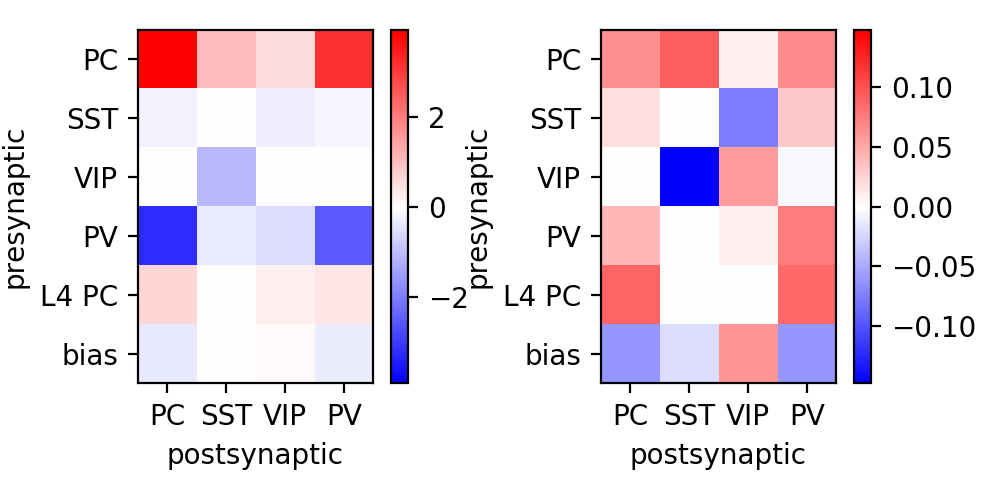

In [161]:
lbls = ['PC','SST','VIP','PV']
plt.figure(figsize=(5,2.5))
for iws,ws in enumerate([[Wmys,Wmxs],[Wsys,Wsxs]]):
    plt.subplot(1,2,iws+1)
    data = np.concatenate((np.mean(ws[0][lkat],0),np.mean(ws[1][lkat],0)),axis=0)
    mx = np.max(np.abs(data))
    plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
    plt.xticks(np.arange(4),lbls)
    plt.yticks(np.arange(6),lbls+['L4 PC','bias'])
    plt.ylim(5.5,-0.5)
    plt.colorbar()
    plt.xlabel('postsynaptic')
    plt.ylabel('presynaptic')
    plt.tight_layout()
    # plt.savefig('figures/Wmy_very_extended_heatmap.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


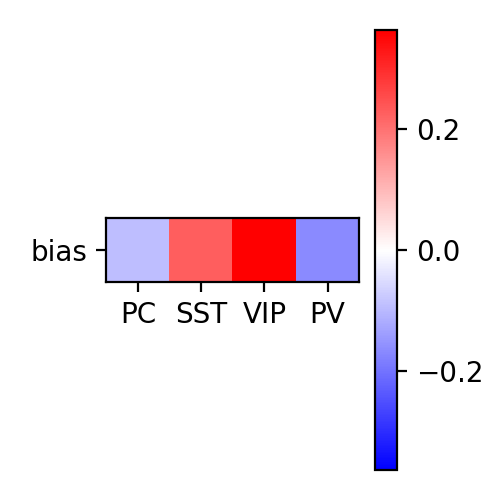

In [302]:
plt.figure(figsize=(2.5,2.5))
data = np.mean(Wmxs,0)[1:2]
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),lbls)
plt.yticks([0],['bias'])
plt.ylim(0.5,-0.5)
plt.colorbar()
# plt.xlabel('postsynaptic')
# plt.ylabel('presynaptic')
plt.tight_layout()
plt.savefig('figures/bias_heatmap.eps')

<IPython.core.display.Javascript object>


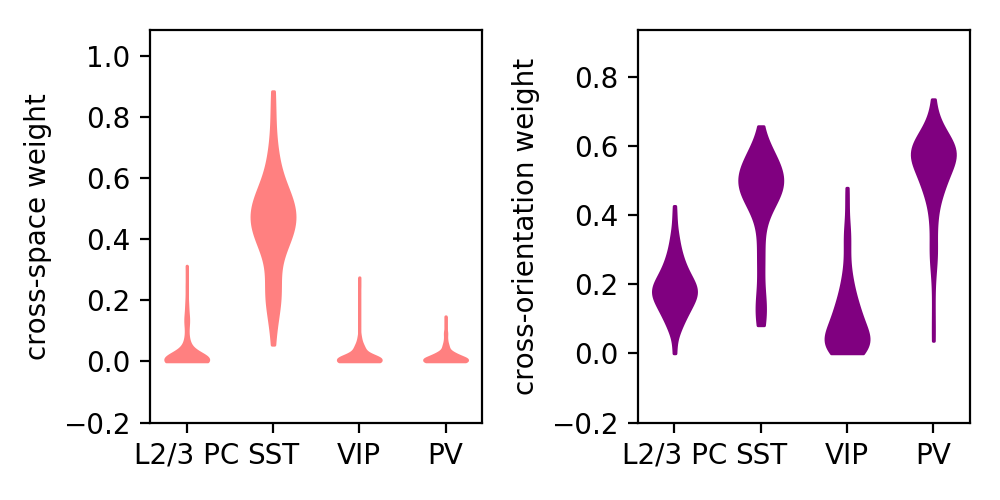

In [111]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(5,2.5))
ylbls = ['cross-space weight','cross-orientation weight']
colors = [[1,0.5,0.5],[0.5,0,0.5]]
for idata,data in enumerate([Ks,Ts]):#,[Wsx,Wsy]]:
#     titles = ['PC','SST','VIP','PV']
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC','SST','VIP','PV']
    plt.subplot(1,2,idata+1)
#     for icelltype in range(nQ)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
    violin_parts = plt.violinplot([data[:,icelltype] for icelltype in range(data.shape[1])],showextrema=False)
    for pc in violin_parts['bodies']:
        pc.set_facecolor(colors[idata])
        pc.set_edgecolor(colors[idata])
        pc.set_alpha(1)
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.ylabel(ylbls[idata])
plt.tight_layout()
#         plt.title(titles[icelltype])
# plt.savefig('figures/violinplots_fit_k_t.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


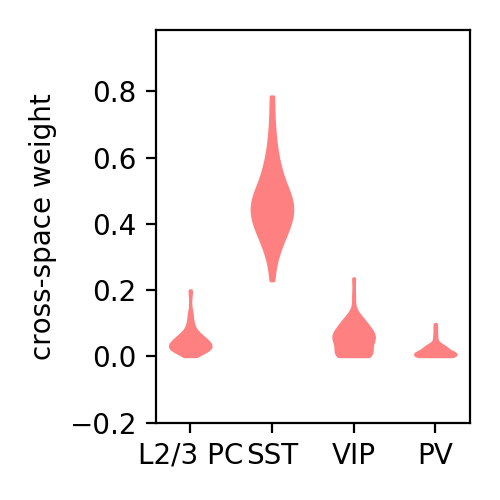

<IPython.core.display.Javascript object>


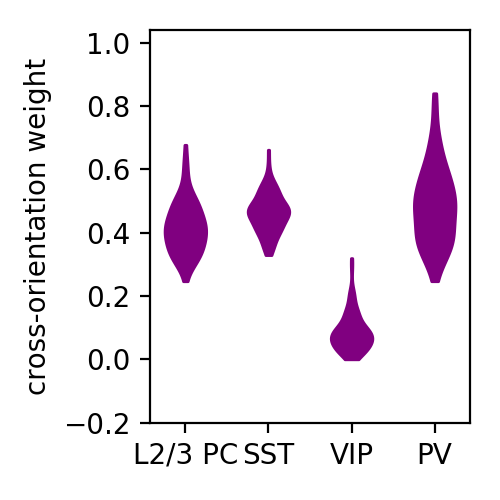

<IPython.core.display.Javascript object>


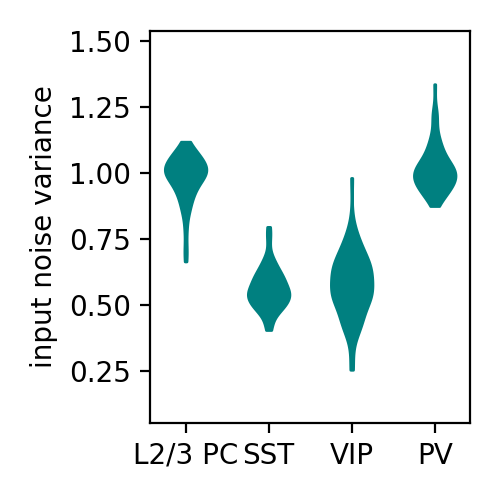

In [1326]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
ylbls = ['cross-space weight','cross-orientation weight','input noise variance']
titles = ['figures/violinplots_fit_k.jpg','figures/violinplots_fit_t.jpg','figures/violinplots_fit_s02.jpg']
colors = [[1,0.5,0.5],[0.5,0,0.5],[0,0.5,0.5]]
for idata,data in enumerate([x[lkat] for x in [Ks,Ts,s02s]]):#,[Wsx,Wsy]]:
    plt.figure(figsize=(2.5,2.5))
#     titles = ['PC','SST','VIP','PV']
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC','SST','VIP','PV']
#     plt.subplot(1,2,idata+1)
#     for icelltype in range(nQ)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
    violin_parts = plt.violinplot([data[:,icelltype] for icelltype in range(data.shape[1])],showextrema=False)
    for pc in violin_parts['bodies']:
        pc.set_facecolor(colors[idata])
        pc.set_edgecolor(colors[idata])
        pc.set_alpha(1)
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.ylabel(ylbls[idata])
    plt.tight_layout()
    #         plt.title(titles[icelltype])
#     plt.savefig(titles[idata],dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


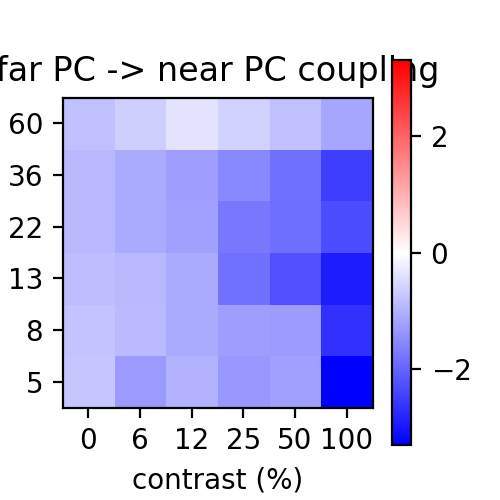

In [984]:
iwt = 5
i1,i2 = 0,0
# data = couplings[iwt][:,8+i1,i2].reshape((6,6))
data = np.nanmean(couplings[:,:,:,8+i1,i2],0)
mx = np.max(np.abs(data))
plt.figure(figsize=(2.5,2.5))
sca.show_size_contrast(data,cmap='bwr',vmin=-mx,vmax=mx,flipud=True)
plt.title('far PC -> near PC coupling')
plt.colorbar()
# plt.savefig('figures/far_pc_near_pc_coupling_tuning.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


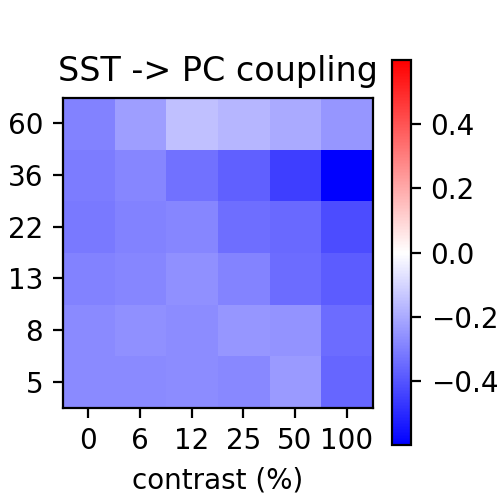

In [987]:
iwt = 5
i1,i2 = 1,0
data = couplings[iwt][:,:,i1,i2]
mx = np.max(np.abs(data))
plt.figure(figsize=(2.5,2.5))
sca.show_size_contrast(data,cmap='bwr',vmin=-mx,vmax=mx,flipud=True)
plt.title('SST -> PC coupling')
plt.colorbar()
# plt.savefig('figures/sst_pc_coupling_tuning.eps')

<IPython.core.display.Javascript object>


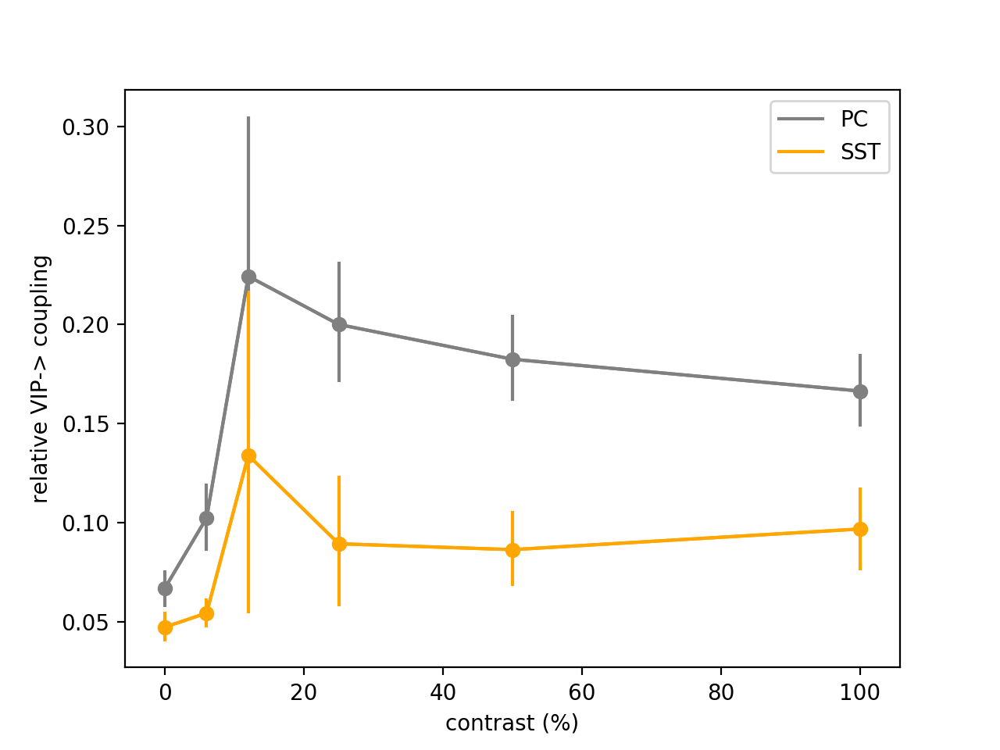

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.16854231968760172
0.07577690981064035


In [239]:
plt.figure()
isize = 0
ucontrast = np.array((0,6,12,25,50,100))
colors = [np.array((0.5,0.5,0.5)),np.array((1,0.65,0)),np.array((0,0,1))]
for target,color in zip([0,1],colors[:2]):
    vip_target = couplings[:,:,2,target].reshape((-1,5,6))
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,np.abs(vip_target[:,isize])[:,np.newaxis]/np.abs(vip_target[:,isize]).max(),colors=color[np.newaxis],pct=(16,84))
plt.xlabel('contrast (%)')
plt.ylabel('relative VIP-> coupling')
plt.legend(['PC','SST'])
# plt.savefig('figures/contrast_dependent_vip_pc_coupling.eps')

<IPython.core.display.Javascript object>


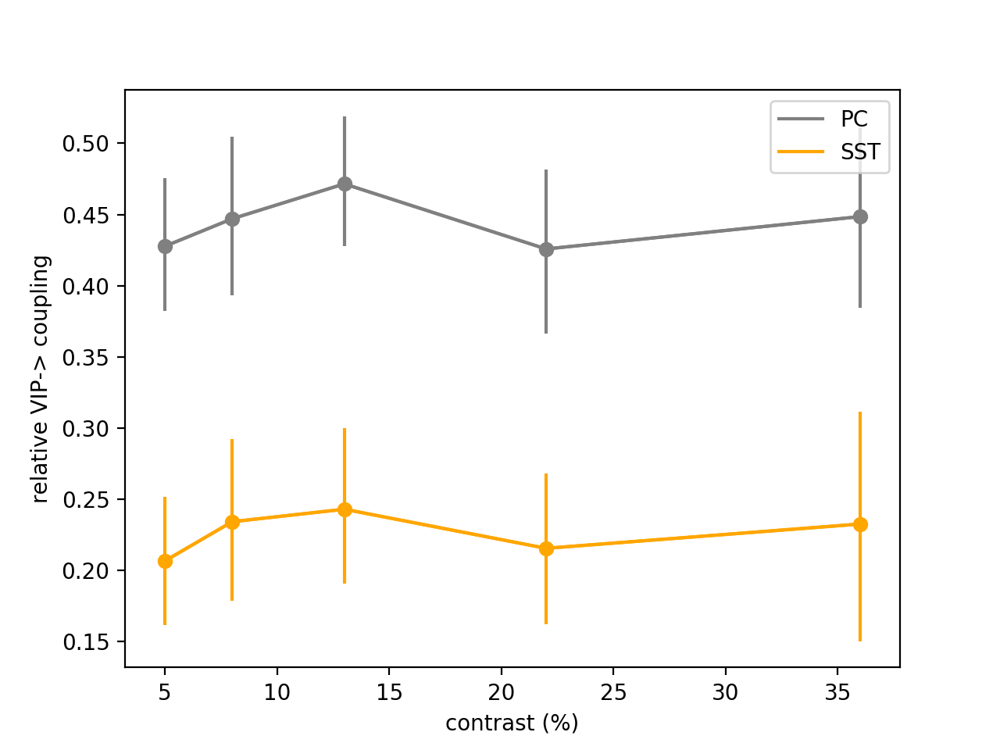

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.424030369834502
0.185940052551597


In [240]:
plt.figure()
isize = 0
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36))
colors = [np.array((0.5,0.5,0.5)),np.array((1,0.65,0)),np.array((0,0,1))]
for target,color in zip([0,1],colors[:2]):
    vip_target = couplings[:,:,2,target].reshape((-1,5,6))
    ut.plot_bootstrapped_errorbars_hillel(usize,np.abs(vip_target[:,:,-1])[:,np.newaxis]/np.abs(vip_target[:,:,-1]).max(),colors=color[np.newaxis],pct=(16,84))
plt.xlabel('contrast (%)')
plt.ylabel('relative VIP-> coupling')
plt.legend(['PC','SST'])
# plt.savefig('figures/contrast_dependent_vip_pc_coupling.eps')

<IPython.core.display.Javascript object>


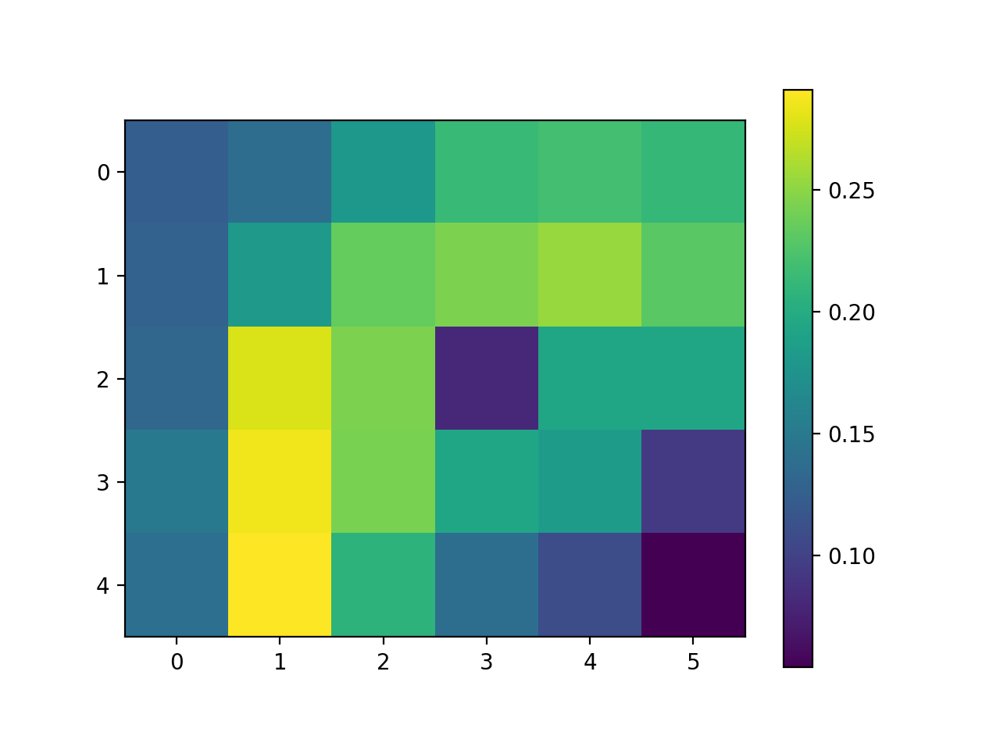

In [172]:
offset = 8
plt.figure()
plt.imshow((coupling[:,offset+0,0]+coupling[:,offset+3,0]).reshape((5,6)))
plt.colorbar()

In [161]:
Phi = calnet.utils.fprime_miller_troyer(Eta,Xi**2+1)
dH = np.zeros_like(Phi)
dH[:,np.arange(2,16,4)] = 1
Wlsq = np.linalg.pinv(dYY) @ (dYY/Phi - h*dH)

<IPython.core.display.Javascript object>


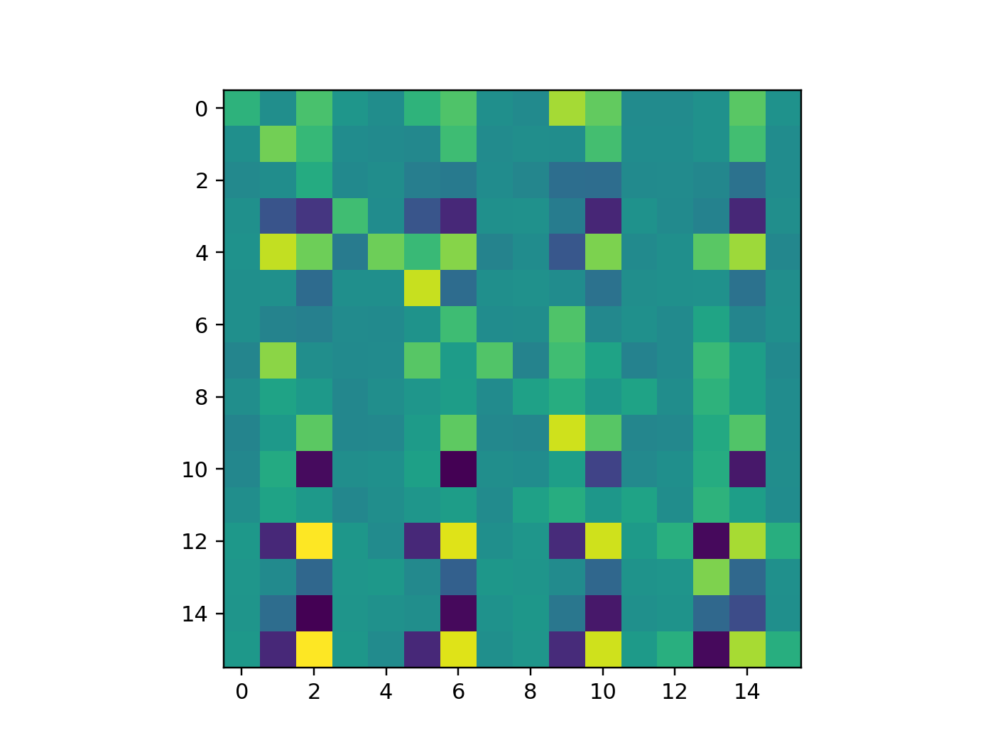

In [162]:
plt.figure()
plt.imshow(Wlsq)

<IPython.core.display.Javascript object>


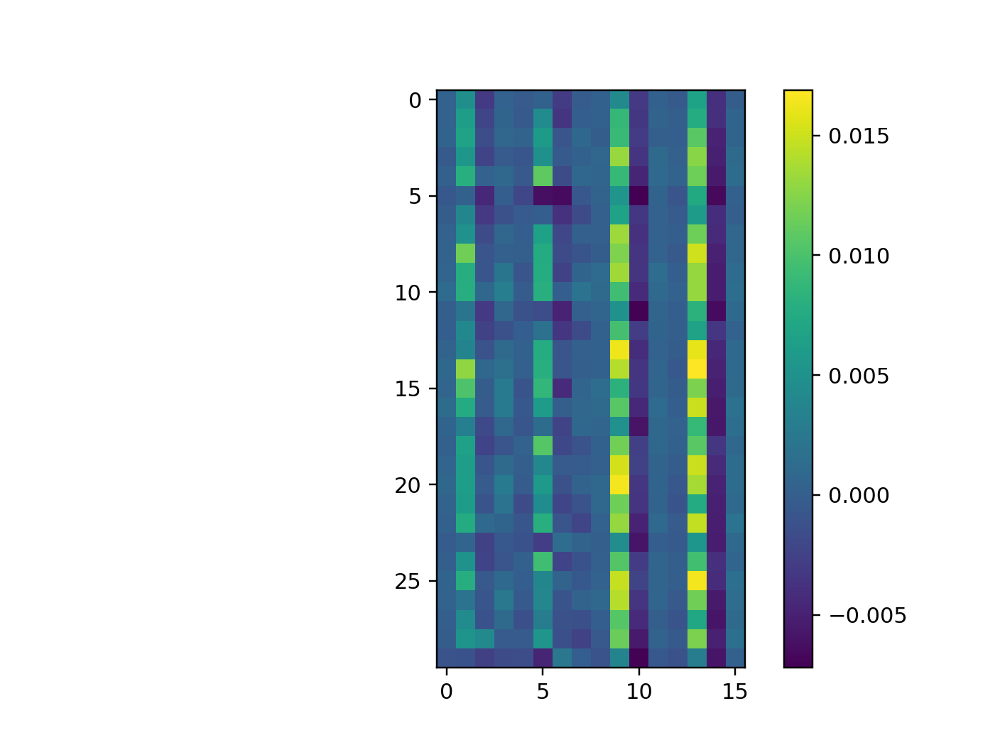

In [151]:
plt.figure()
difference = np.zeros((30,16))
for istim in range(30):
    Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+1))
    difference[istim] = dYY[istim] @ (np.eye(16) - WWmy @ Phi) @ np.linalg.inv(Phi)
plt.imshow(difference)
# plt.imshow(YY)
plt.colorbar()
#,vmin=-0.01,vmax=0)

<IPython.core.display.Javascript object>


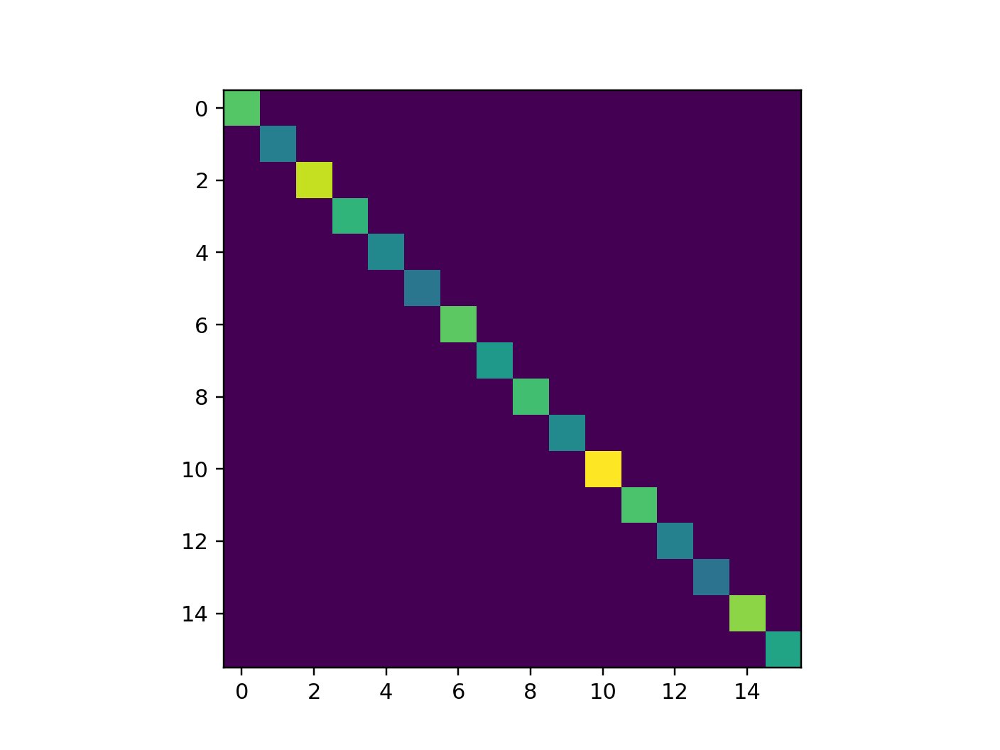

In [140]:
plt.figure()
plt.imshow(Phi)

<IPython.core.display.Javascript object>


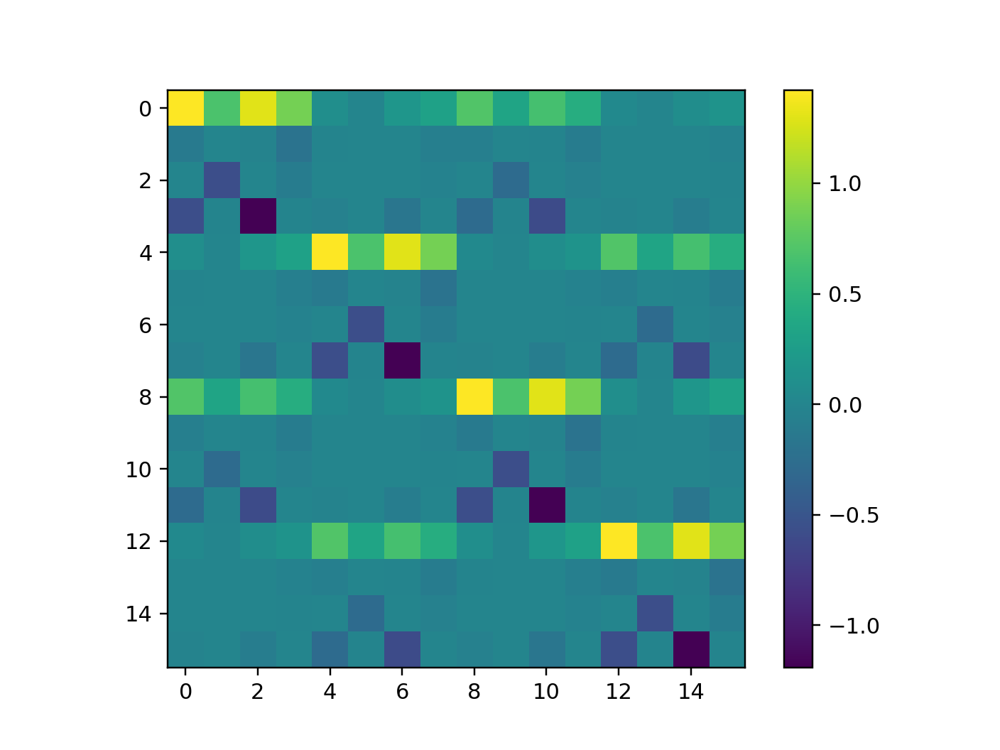

In [133]:
plt.figure()
plt.imshow(WWmy)
plt.colorbar()

<IPython.core.display.Javascript object>


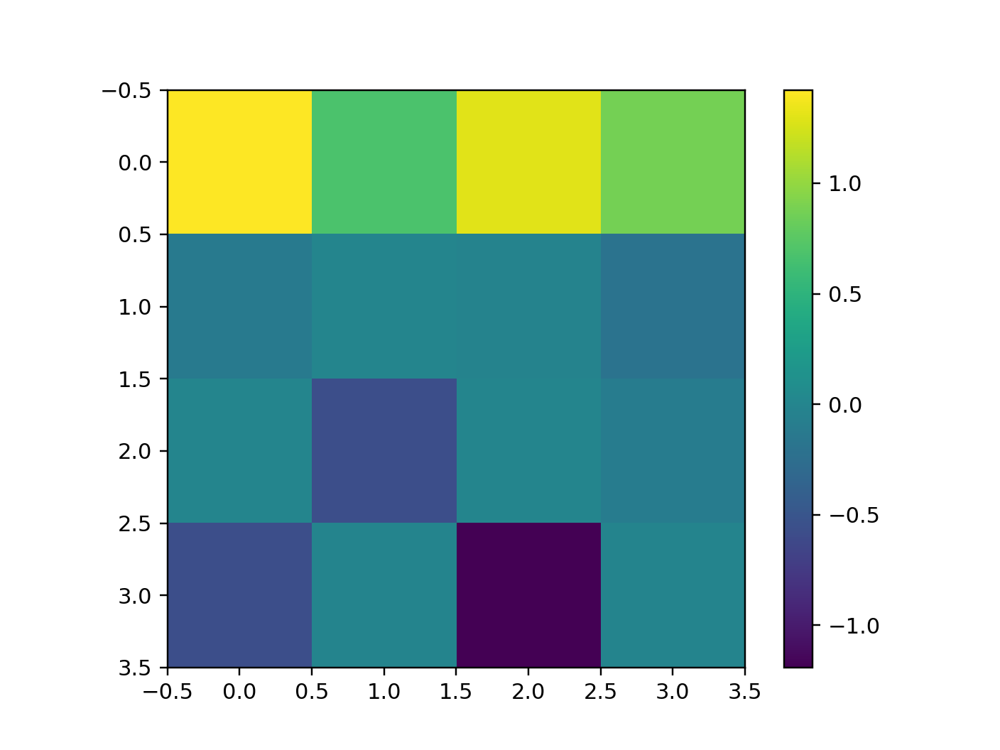

In [135]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()

In [120]:
Yhat[0][0].shape

(30, 4)

In [121]:
drH,prH = np.linalg.eig(hess)

LinAlgError: 0-dimensional array given. Array must be at least two-dimensional

In [122]:
compute_fprime_m_(Eta,Xi,s02)

array([[-2.93938946e-02,  2.75369280e-02,  9.08498007e-03,
         3.72153299e-03, -2.10674481e-02,  1.67982821e-03,
         4.71064945e-02,  4.35677928e-03, -4.49214988e-02,
        -5.89115025e-03, -6.39171088e-02,  5.31021460e-03,
        -1.65078591e-02, -3.87478400e-03,  4.57578558e-02,
         4.62755360e-03],
       [-2.22999881e-02,  3.03194114e-02, -7.02082757e-03,
         3.46448440e-03, -1.67515155e-02,  4.04586197e-03,
         4.82774184e-02,  3.08535500e-03, -4.42141691e-02,
        -4.10018318e-02, -6.27938658e-02,  6.16927104e-03,
        -1.96755697e-02, -9.60253163e-04,  4.62127404e-02,
         3.12653769e-03],
       [-1.05809605e-02,  3.65528054e-02, -4.78787391e-02,
         2.50561938e-03, -9.41529219e-03,  9.79845890e-03,
         4.68881849e-02,  1.96486279e-03, -2.97966770e-02,
         2.24333286e-03, -1.17349919e-01,  4.29500581e-03,
        -9.71788062e-03,  4.75992645e-03,  4.29238109e-02,
         2.20132829e-03],
       [-2.52148442e-02,  3.82061055e

In [103]:
# nH = drH.shape[0]
hessWy = np.zeros((nQ**2,nQ**2))
blankWlist = parse_W(np.zeros(nH,))
blankWlist[1][:] = 1
allhot = unparse_W(*blankWlist)
Wy_entries = slice(np.where(allhot)[0][0],np.where(allhot)[0][-1]+1)
hessWy = hess[Wy_entries,Wy_entries]
gradWy = gr[Wy_entries]
drH,prH = np.linalg.eig(hessWy)
plt.figure()
for iieig,ieig in enumerate(np.arange(16)):
    plt.subplot(4,4,iieig+1)
    plt.imshow(prH[:,ieig].reshape((nQ,nQ))*np.sign(prH[:,ieig].mean()),vmin=-0.6,vmax=0.6)
plt.figure()
for ieig in np.arange(-1,-5,-1):
    x = np.linspace(-1,1,100)
    y = x*(gradWy @ prH[:,ieig]) + 0.5*x**2*(prH[:,ieig] @ hessWy @ prH[:,ieig])
    plt.plot(x,y)

ValueError: too many values to unpack (expected 12)

In [46]:
hessW = np.zeros((nP*nQ+nQ**2,nP*nQ+nQ**2))
blankWlist = parse_W(np.zeros(nH,))
blankWlist[0][:] = 1
blankWlist[1][:] = 1
allhot = unparse_W(*blankWlist)
W_entries = slice(np.where(allhot)[0][0],np.where(allhot)[0][-1]+1)
hessW = hess[W_entries,W_entries]
gradW = gr[W_entries]
drHW,prHW = np.linalg.eig(hessW)

plt.figure()
for iieig,ieig in enumerate(np.arange(nP*nQ+nQ**2)):
    plt.subplot(6,4,iieig+1)
    these_wts = np.real(prHW[:,ieig])
    these_wx = these_wts[:nP*nQ].reshape((nP,nQ))
    these_wy = these_wts[nP*nQ:].reshape((nQ,nQ))
    these_w = np.concatenate((these_wy,these_wx),axis=0)
    plt.imshow(these_w*np.sign(these_w.mean()),vmin=-0.6,vmax=0.6)
plt.figure()
for ieig in np.arange(-1,-5,-1):
    x = np.linspace(-0.5,0.5,100)
    y = x*(gradW @ prHW[:,ieig]) + 0.5*x**2*(prHW[:,ieig] @ hessW @ prHW[:,ieig])
    plt.plot(x,y)

NameError: name 'nH' is not defined

<IPython.core.display.Javascript object>


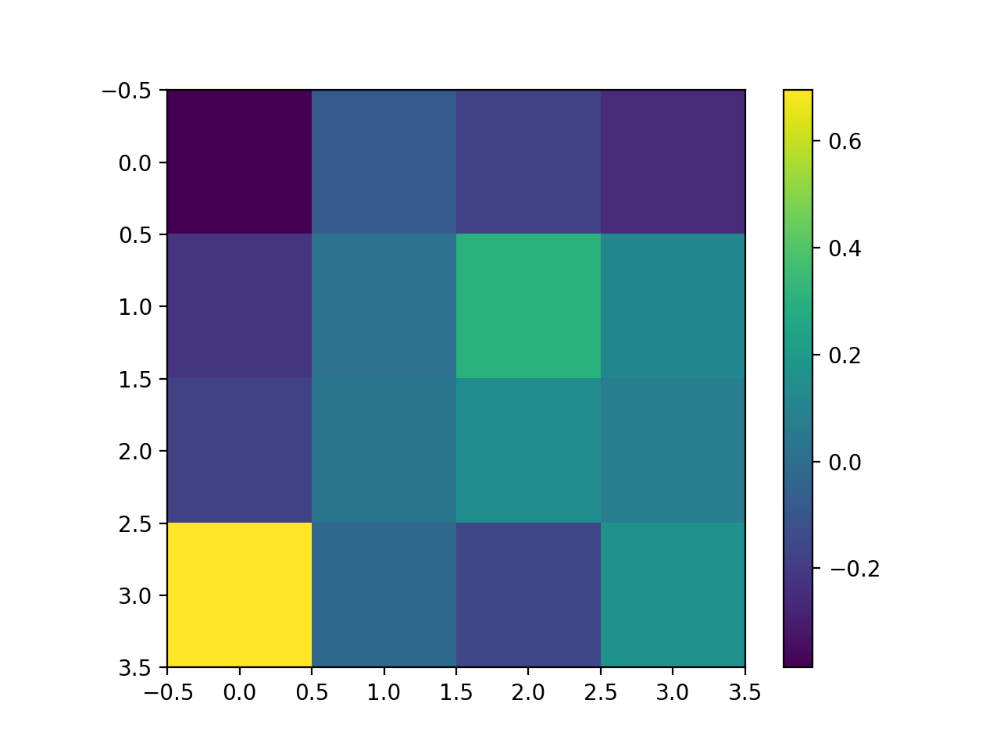

In [2079]:
plt.figure()
plt.imshow(prH[:,-3].reshape((nQ,nQ)))
plt.colorbar()

<IPython.core.display.Javascript object>


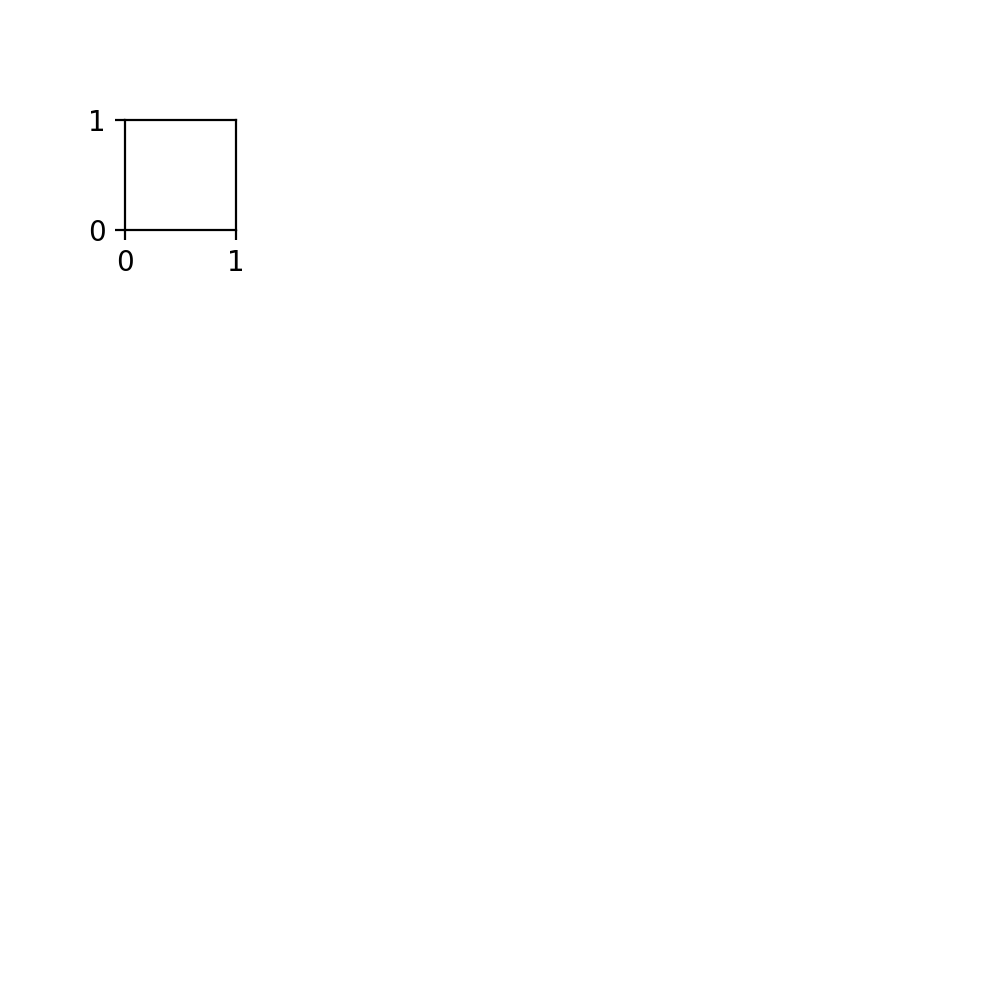

ValueError: cannot reshape array of size 8 into shape (4,4)

In [2080]:
mag = 1
plt.figure(figsize=(5*mag,5*mag))
for iidim,idim in enumerate(np.where(wheavy)[0]):
    plt.subplot(6,6,iidim+1)
    eiglist = parse_W(prH[:,idim])
    plt.imshow(np.real(eiglist[1])*np.sign(np.real(eiglist[1].sum())),vmin=-0.5,vmax=0.5)
    plt.axis('off')
    
mag = 1
plt.figure(figsize=(5*mag,5*mag))
for iidim,idim in enumerate(np.where(wheavy)[0]):
    plt.subplot(6,6,iidim+1)
    eiglist = parse_W(prH[:,idim])
    plt.imshow(np.real(eiglist[3])*np.sign(np.real(eiglist[3].sum())),vmin=-0.5,vmax=0.5)
    plt.axis('off')
#     plt.colorbar()
# plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


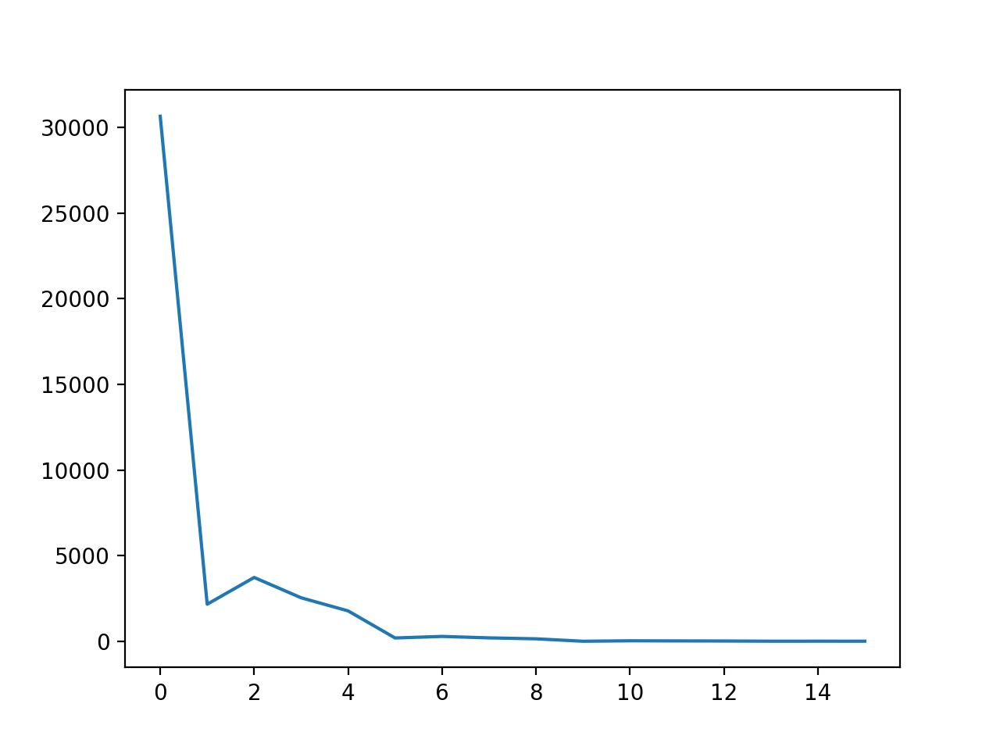

In [1796]:
plt.figure()
plt.plot(np.abs(drH))

In [1247]:
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,YY,Eta,Xi]
# nans: s02, XXp, Eta, Xi

In [1756]:
drW,prW = np.linalg.eig(Wmy-np.eye(Wmy.shape[0]))

In [66]:
len(Wt[0][0])

12

In [275]:
trystars_i = (0,)
trystars_j = (0,)
itry = 0
Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi,h = Wt[trystars_i[itry]][trystars_j[itry]]
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','kappa','T','XX','XXp','Eta','Xi','h']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wt[trystars_i[itry]][trystars_j[itry]][i]
Wstar_dict['as_list'] = [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi,h]
np.save('weights_from_opto_200702.npy',Wstar_dict)

In [72]:
Wstar_dict = np.load('weights_200607.npy',allow_pickle=True)[()]
Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi = Wstar_dict['as_list']

In [95]:
dYY = Yhat_opto[1::2]-Yhat_opto[0::2]

<IPython.core.display.Javascript object>


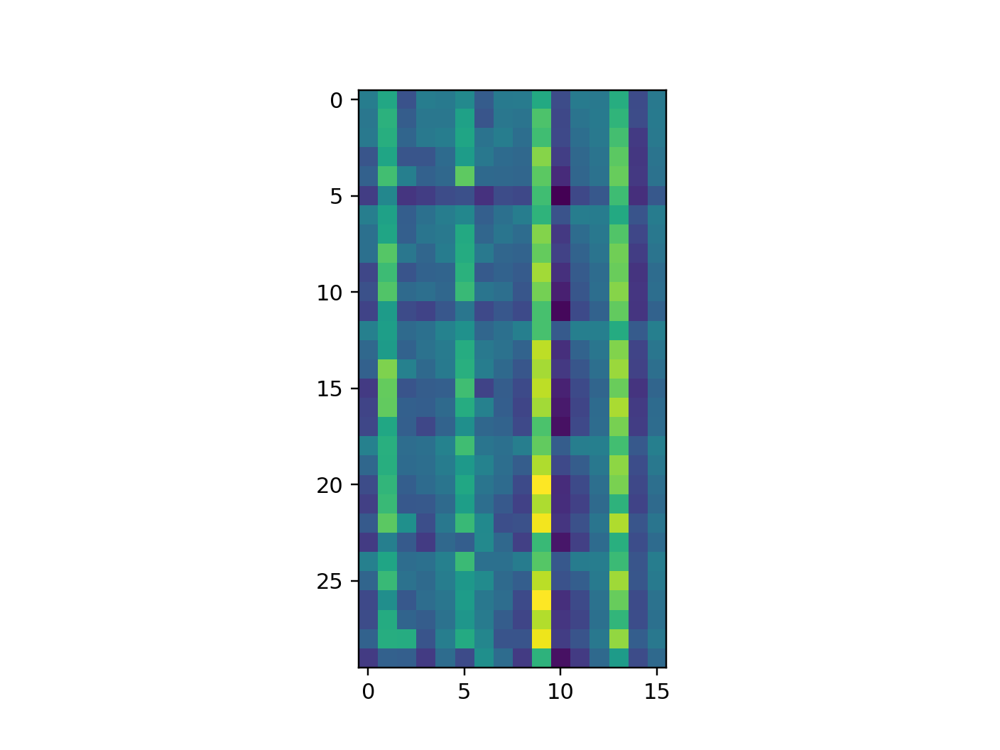

In [97]:
plt.figure()
plt.imshow(dYY)

In [117]:
reload(calnet.utils)
WWy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
Phi = compute_fprime_m_(Eta,Xi,s02)
dHH = np.zeros((30,16))
dHH[:,[2,6,10,14]] = -1
dYYz = 0*dYY
x = np.linspace(-0.02,0.02,100)
score = np.zeros_like(x)
for ix in range(len(x)):
    score[ix] = np.sum((dYYz - (dYYz @ WWy) * Phi - dHH * x[ix] * Phi)**2)

In [123]:
(Phi*dHH).mean()

0.002498112101476194

<IPython.core.display.Javascript object>


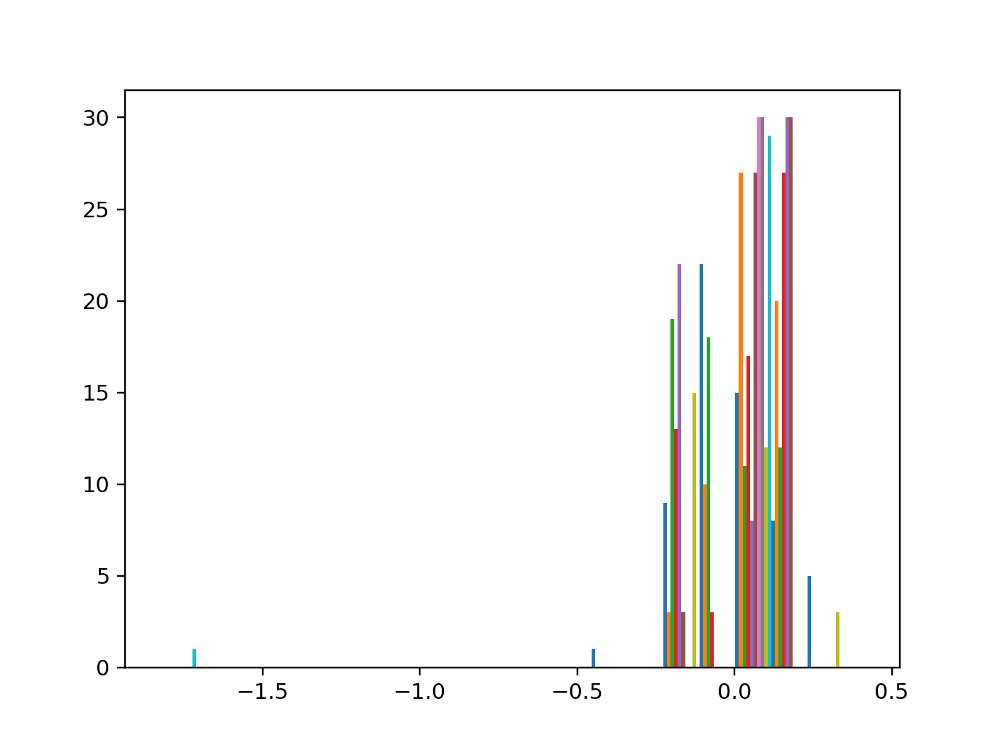

([array([ 0.,  0.,  0.,  0.,  0.,  0.,  1.,  9., 15.,  5.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  3., 27.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 19., 11.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 13., 17.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 22.,  8.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  3., 27.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 15., 12.,  3.]),
  array([ 1.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 29.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 22.,  8.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 10., 20.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0., 18., 12.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  3., 27.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.]),
  array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 30.,  0.])],
 array([-1.84833978, -1

In [122]:
plt.figure()
plt.hist(Phi)

<IPython.core.display.Javascript object>


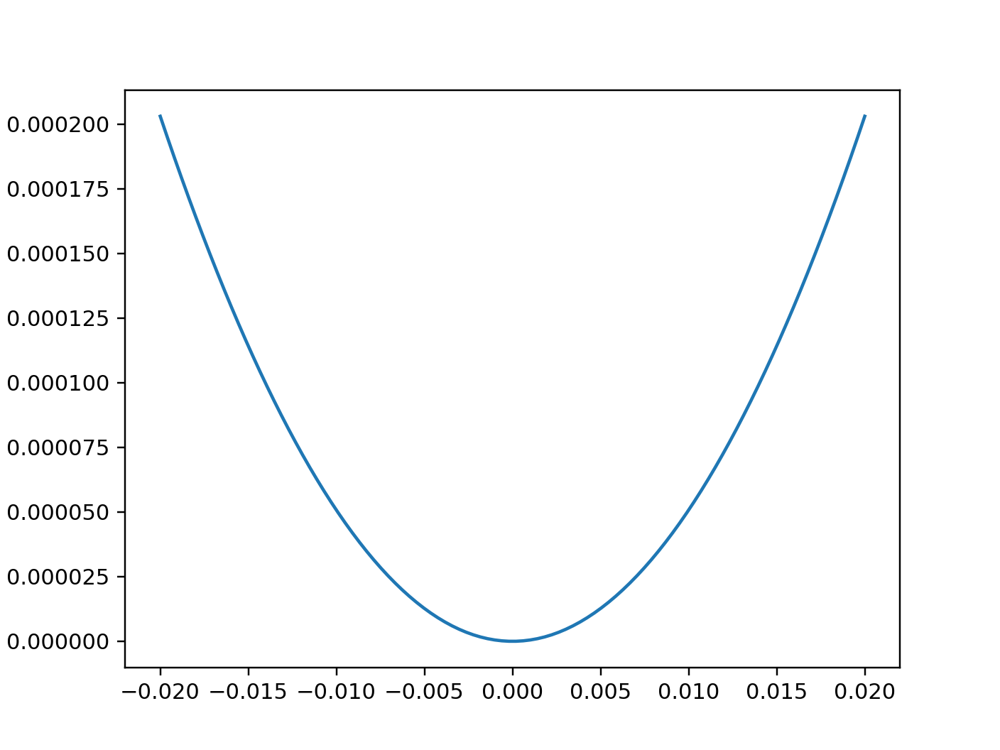

In [119]:
plt.figure()
plt.plot(x,score)

<IPython.core.display.Javascript object>


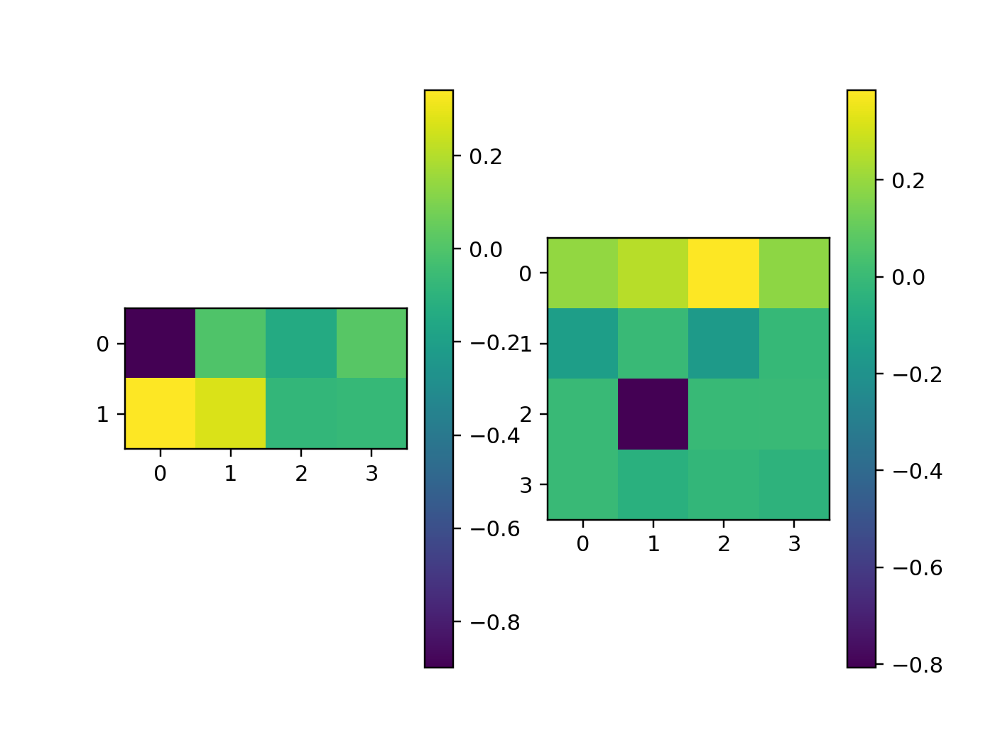

In [109]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(Wmx)
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(Wmy)
plt.colorbar()

In [110]:
def show_four_celltypes(YYstar):
    lbls = ['PC','SST','VIP','PV']
    mag = 2
    plt.figure(figsize=(mag*nQ,mag))
    for itype in range(nQ):
        plt.subplot(1,nQ,itype+1)
        plt.title(lbls[itype])
        sca.show_size_contrast(YYstar[:,itype].reshape((5,6)),flipud=True)
    plt.tight_layout()

<IPython.core.display.Javascript object>


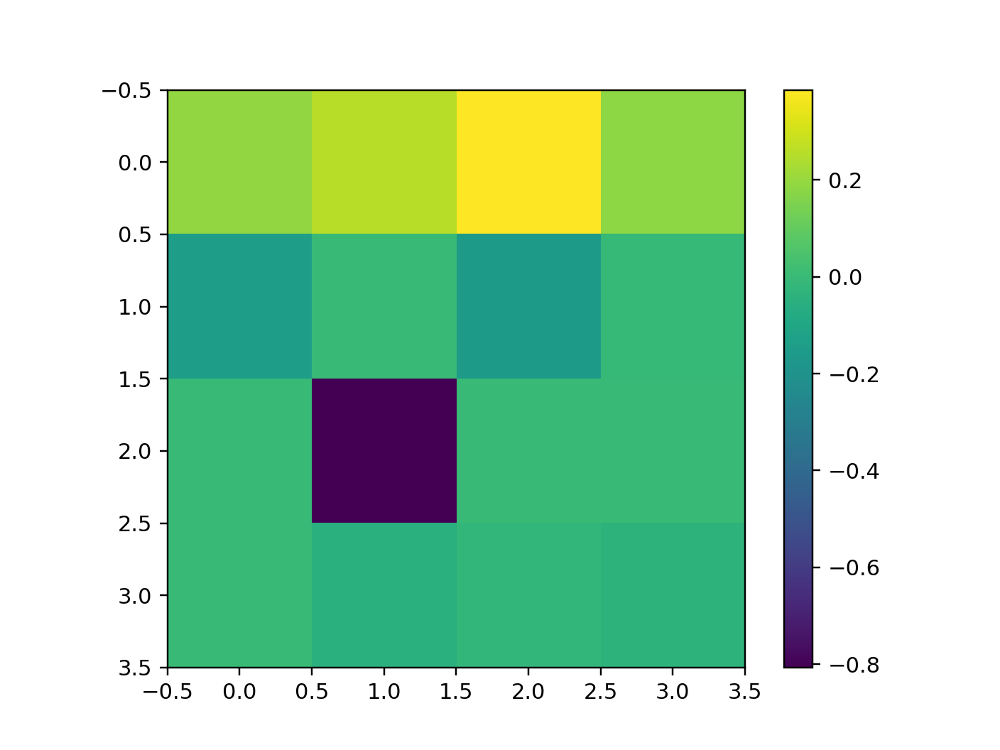

In [111]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()

In [88]:
for itry in range(1): #ntries): 
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi = Wt[trystars_i[itry]][trystars_j[itry]]
#     Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[0][itry]
    XXhat = np.concatenate(Xhat,axis=1)
    YYhat = np.concatenate(Yhat,axis=1)
    YY = compute_f_(Eta,Xi,s02)
    Etastar = u_fn(XX,YY,Wmx,Wmy,k,kappa,T)
    Xistar = u_fn(XX,YY,Wsx,Wsy,k,kappa,T)
    YYstar = compute_f_(Etastar,Xistar,s02)
    show_four_celltypes(YY)
#     mag = 2
#     plt.figure(figsize=(mag*nQ,mag))
#     for itype in range(nQ):
#         plt.subplot(1,nQ,itype+1)
#         plt.title(lbls[itype])
#         sca.show_size_contrast(YYstar[:,itype].reshape((5,6)),flipud=True)
#     plt.tight_layout()
#     plt.savefig('figures/modeled_four_cell_types.jpg',dpi=300)

NameError: name 'Wt' is not defined

In [ ]:
plt.plot(YY)

<IPython.core.display.Javascript object>


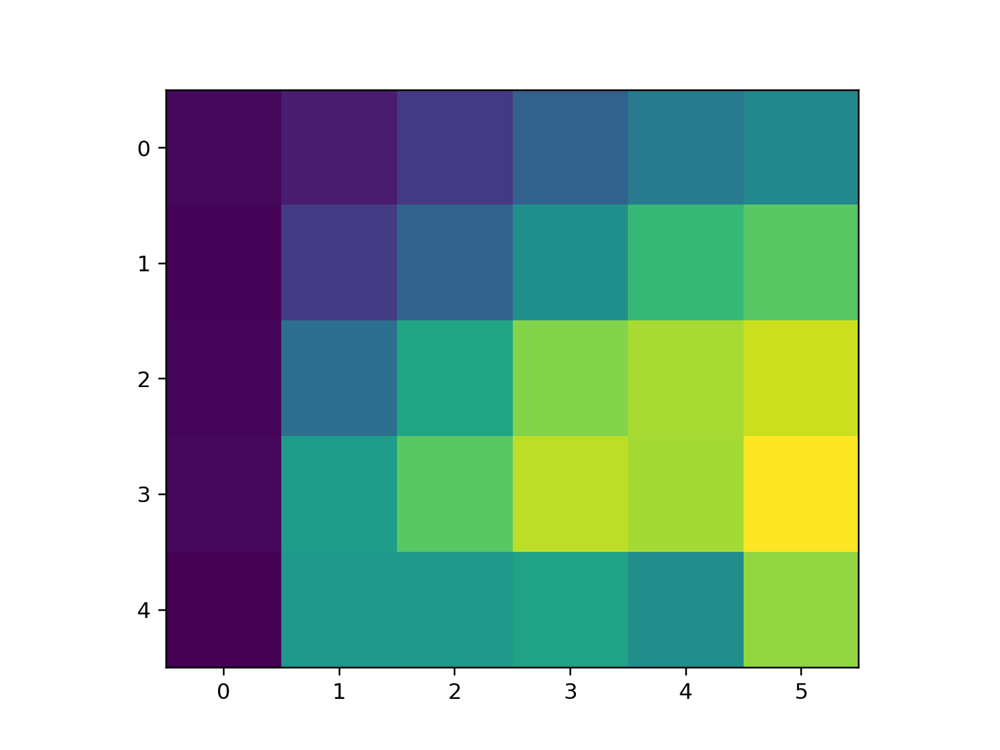

In [119]:
plt.figure()
plt.imshow(YY[:,0].reshape((5,6)))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


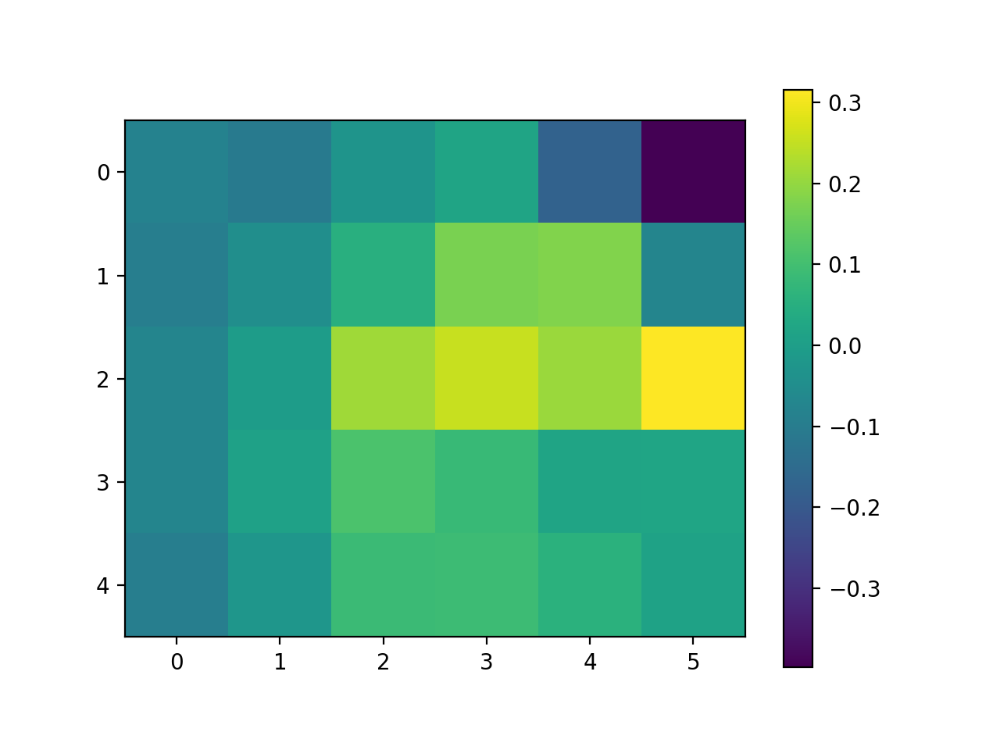

In [2088]:
plt.figure()
plt.imshow((YY-YYstar)[:,0].reshape((nsize,ncontrast)))
plt.colorbar()

In [2089]:
ww = gen_Weight(Wmy,k,kappa)
eig_actual = np.zeros((Etastar.shape[0],))
for istim in range(Etastar.shape[0]):
    eig_actual[istim] = np.max(np.real(np.linalg.eig(compute_fprime_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nQ))[0]))
#     eig_actual[istim] = np.max(np.real(np.linalg.eig(compute_fprime_(Etastar,Xistar,s02)[istim]@ww - np.eye(ww.shape[0]))[0]))
    eig_no_gain = np.max(np.real(np.linalg.eig(ww - np.eye(ww.shape[0]))[0]))
    print((eig_actual[istim],eig_no_gain))

(-0.9999999999999993, -0.009993623305414886)
(-0.9999999999999992, -0.009993623305414886)
(-0.9999999999999993, -0.009993623305414886)
(-0.2368478149902454, -0.009993623305414886)
(1.7106625867160918, -0.009993623305414886)
(3.1400013220281733, -0.009993623305414886)
(-0.9999999999999987, -0.009993623305414886)
(-0.9999999999999996, -0.009993623305414886)
(-0.9999999999999994, -0.009993623305414886)
(-0.9999999999999991, -0.009993623305414886)
(-0.2759527000179595, -0.009993623305414886)
(1.0103883331405459, -0.009993623305414886)
(-0.9999999999999998, -0.009993623305414886)
(-0.9999999999999993, -0.009993623305414886)
(-0.9999999999999996, -0.009993623305414886)
(-0.3950126606634954, -0.009993623305414886)
(-0.003739102238442815, -0.009993623305414886)
(2.0213250147711292, -0.009993623305414886)
(-0.9999999999999996, -0.009993623305414886)
(-0.9999999999999998, -0.009993623305414886)
(-0.9999999999999993, -0.009993623305414886)
(-0.9103041883195016, -0.009993623305414886)
(1.172059055

In [2090]:
istim = 29
drf,prf = np.linalg.eig(compute_fprime_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nQ))

In [2091]:
prf[:,1]

array([-0.99856234, -0.02025994, -0.02025994, -0.02025994, -0.02025994,
       -0.02025994, -0.02025994, -0.02025994])

In [2092]:
istim = -1
np.linalg.eig(compute_fprime_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nQ))[1][0]

array([-0.35355339, -0.99856234,  0.22670029, -0.41994402, -0.11058865,
       -0.05784502,  0.22710208, -0.6688424 ])

In [2093]:
(Wmy[1,2],Wmy[2,1],Wmy[3,0],Wmy[1,0])

(-0.6628473584947526,
 -1.1850025100315922,
 -1.9382457900390289,
 -0.07592391320035187)

In [2094]:
YY = compute_f_(Eta,Xi,s02)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


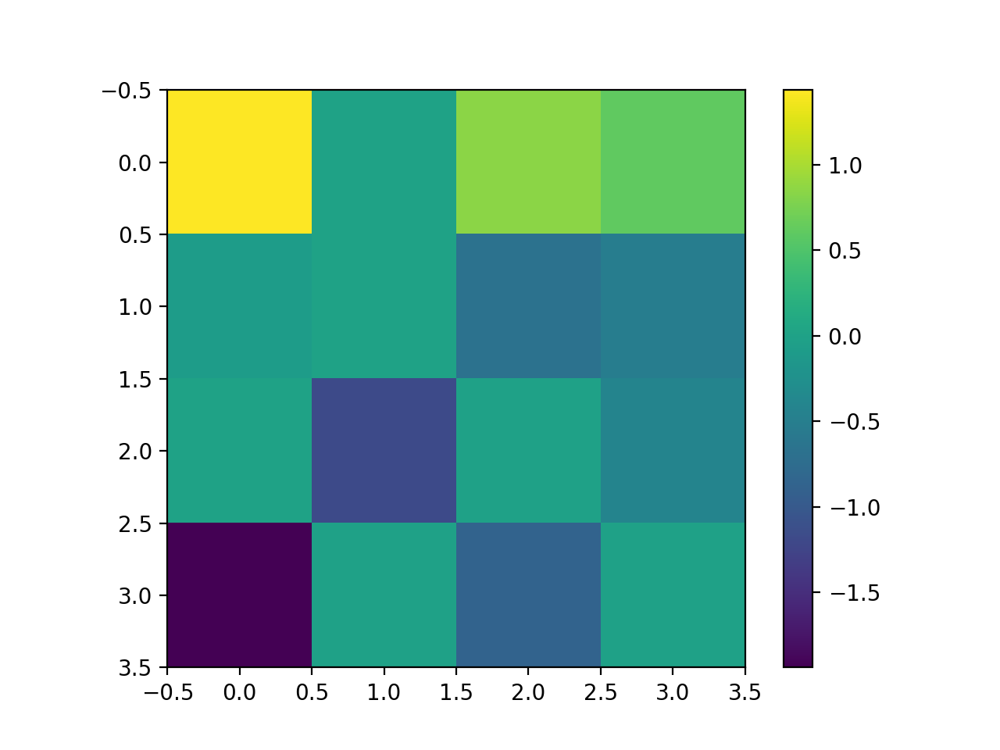

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


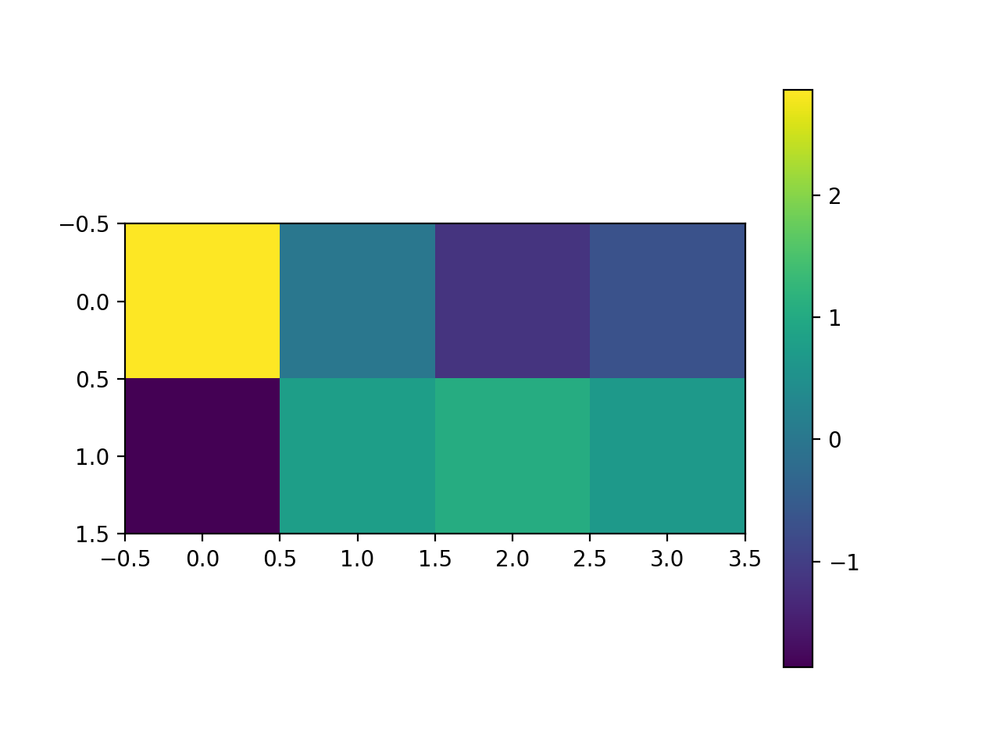

In [2095]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()
plt.figure()
plt.imshow(Wmx)#,vmin=-2,vmax=2)
plt.colorbar()

In [2096]:
Wmy_bounds

array([[ 2,  2,  2,  2],
       [-2,  0, -2, -2],
       [ 0, -2, -2, -2],
       [-2, -2, -2, -2]])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


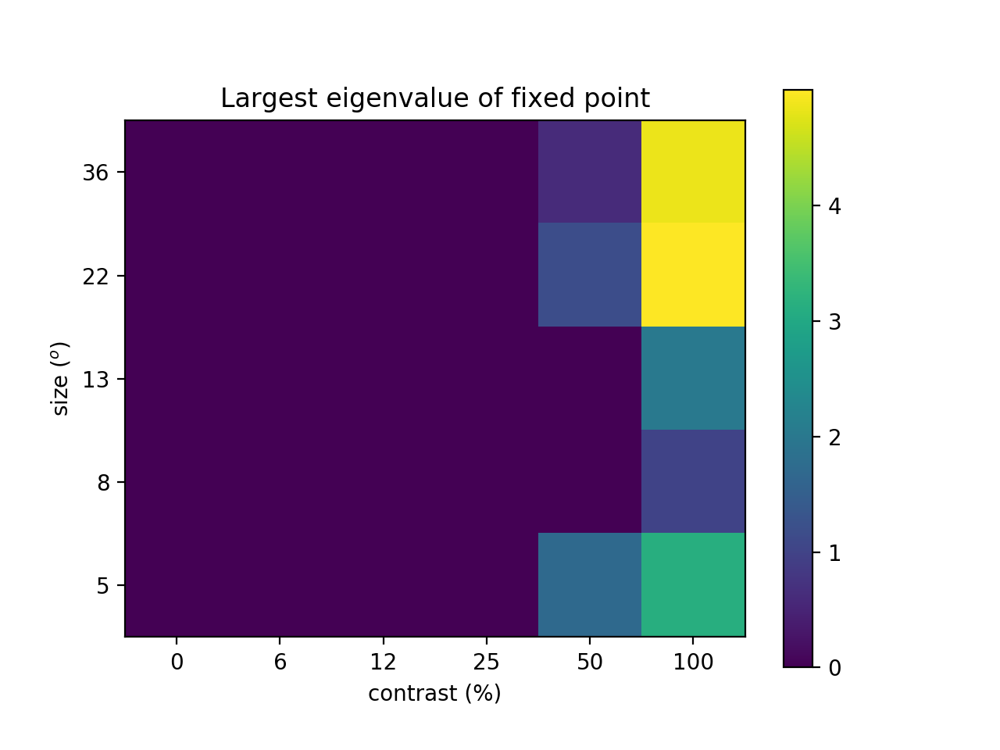

Text(0.5, 1.0, 'Largest eigenvalue of fixed point')

In [2097]:
plt.figure()
sca.show_size_contrast(eig_actual.reshape((nsize,ncontrast)),vmin=0,flipud=True)#,vmin=-1,vmax=1)
plt.colorbar()
plt.title('Largest eigenvalue of fixed point')
# plt.savefig('figures/possible_gamma_substrate.jpg',dpi=300)

In [1915]:
# Wstar_dict = np.load('weights_200111b.npy',allow_pickle=True)[()]

0
0
1
2
3
4
5
6
7
8
9


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


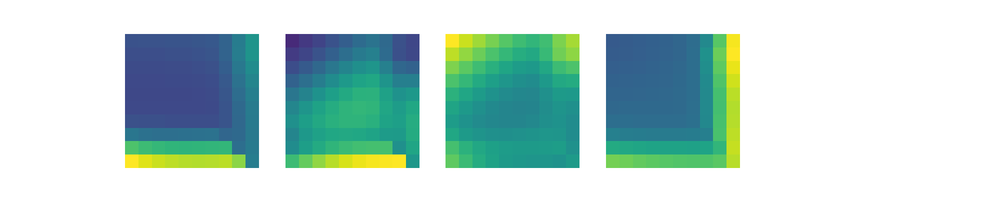

In [1945]:
nstar = len(trystars_i)
YY = [None for istar in range(nstar)]
Nvals = 10
max_val = 1
Niter = int(1e3)
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    def fY(XX,YY):
        return compute_f_(u_fn(XX,YY,Wmx,Wmy,k,kappa),u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY(XX,YY0,eta=1e-2):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    YY = np.zeros((Nvals,Nvals,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta[0],Xi[0],s02)
    XX = np.ones((Nvals,Nvals,4))
    XX[:,:,0],XX[:,:,2] = np.meshgrid(np.linspace(0,max_val,Nvals),np.linspace(0,max_val,Nvals),indexing='ij')
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for ival in range(Nvals):
        YY[ival,0] = predict_YY(XX[ival,0],YY0)
        print(ival)
        for jval in range(1,Nvals):
            YY[ival,jval] = predict_YY(XX[ival,jval],YY[ival-1,jval,-1])
            
    mag = 2
    plt.figure(figsize=(mag*ncelltypes,mag))
    for icelltype in range(nQ):
        plt.subplot(1,ncelltypes,icelltype+1)
        plt.imshow(YY[:,:,-1,icelltype],vmin=0)#,interpolation='bilinear')
        plt.axis('off')

In [1946]:
nstar = len(trystars_i)
YYsc = [None for istar in range(nstar)]
Niter = int(2e3)
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    def fY(XX,YY):
        return compute_f_(resEta[ival]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[ival]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY(XX,YY0,eta=2e-2):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YYsc[istar] = np.zeros((nN,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02) + 0.05*np.tile(np.array((0,1,0,0,0,1,0,0))[np.newaxis],(nN,1)) #*np.random.randn(nN,nS*nQ)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for ival in range(nN):
        YYsc[istar][ival] = predict_YY(XX[ival],YY0[ival])
        print(ival)
            
#     mag = 2
#     plt.figure(figsize=(mag*ncelltypes,mag))
#     for icelltype in range(nQ):
#         plt.subplot(1,ncelltypes,icelltype+1)
#         plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
#         plt.axis('off')

0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


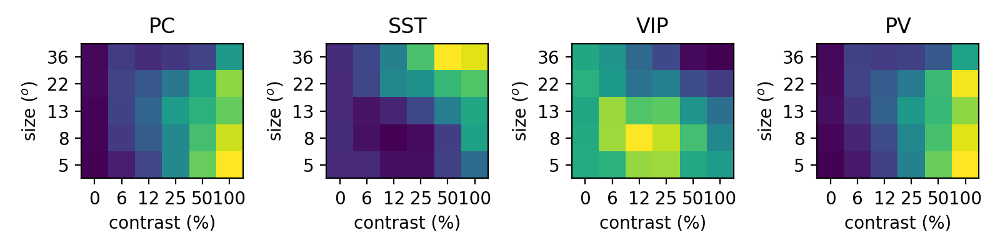

In [1947]:
show_four_celltypes(YYsc[0][:,-1])
# plt.savefig('figures/self_consistent_model_no_residual_currents.jpg',dpi=300)

In [1948]:
YY = compute_f_(Eta,Xi,s02)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


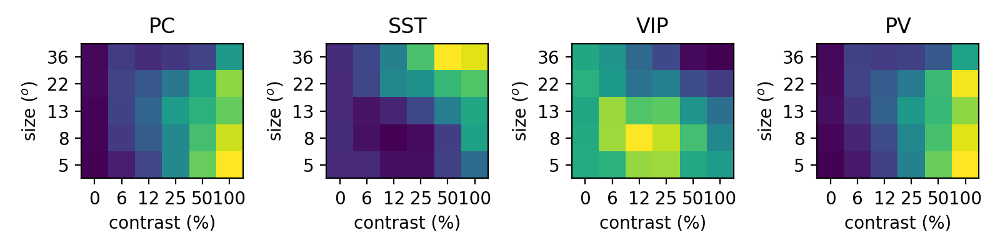

In [1949]:
show_four_celltypes(YY)#[0][:,-1])
# plt.savefig('figures/self_consistent_model_with_residual_currents.jpg',dpi=300)

In [2100]:
nstar = len(trystars_i)
Niter = int(3e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
#     ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    def fY(XX,YY):
        return compute_f_(resEta[stim_val]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[stim_val]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY_fix_dim(XX,YY0,eta=1e-2,fix_dim=None,run_backward=False):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            if not fix_dim is None:
                dYY[fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_ss = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ifix in range(Nfix):
                yy0 = YY0[stim_val] #+np.random.randn(yy0.shape)
                yy0[fix_dim[ifix]] = yval
                YY_ss[ifix,istim,iy] = predict_YY_fix_dim(XX[stim_val],yy0,fix_dim=fix_dim[ifix])

0
0


KeyboardInterrupt: 

In [1040]:
# YY_ss = YY.copy()

In [ ]:
# def u_fn(XX,YY,Wx,Wy,k,kappa):
#     WWx,WWy = [gen_Weight(W,k,kappa) for W in [Wx,Wy]]
#     return XX @ WWx + YY @ WWy

In [1527]:
reload(utils)
nstar = len(trystars_i)
Niter = int(4e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
Nx = 20
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
xvals = np.linspace(0,max_val,Nx)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    WWmx,WWmy = [gen_Weight(W,k,kappa) for W in [Wmx,Wmy]]
    WWsx,WWsy = [gen_Weight(W,k,kappa) for W in [Wsx,Wsy]]
    def u_fn_m(XX,YY):
        return u_fn_WW(XX,YY,WWx=WWmx,WWy=WWmy)
    def u_fn_s(XX,YY):
        return u_fn_WW(XX,YY,WWx=WWsx,WWy=WWsy)
    def dfYdY(XX,YY):
        # derivs: (nN,nS*nQ)
        # WWy: (nS*nQ,nS*nQ)
        # (dfYdY)ij = dfj(Y)/dYi
        deriv_m = compute_fprime_m_(resEta[stim_val]+u_fn_m(XX,YY),resXi[stim_val]+u_fn_s(XX,YY),s02)
        deriv_s = compute_fprime_s_(resEta[stim_val]+u_fn_m(XX,YY),resXi[stim_val]+u_fn_s(XX,YY),s02)
        return deriv_m[:,np.newaxis,:]*WWmy[np.newaxis,:,:] + deriv_s[:,np.newaxis,:]*WWsy[np.newaxis,:,:]
    def fY(XX,YY):
        return compute_f_(resEta[stim_val:stim_val+1]+u_fn_m(XX,YY),resXi[stim_val:stim_val+1]+u_fn_s(XX,YY),s02)
    def predict_YY_fix_dim(XX,YY0,eta=2e-1,fix_dim=0,run_backward=False):
        def F(YY):
            # YY: (nN,nS*nQ)
            # F: (nN,nS*nQ)
            return -YY + fY(XX,YY)
        def dFdYY(YY):
            # dFdYY: (nN,nS*nQ,nS*nQ)
            # (dFdYY)ij = dFj(Y)/dYi, inherited from dfYdY convention
            return -np.eye(nS*nQ)[np.newaxis,:,:] + dfYdY(XX,YY)
        def dF2dYY(YY):
            # dFdYY: (nN,nS*nQ,nS*nQ)
            # F: (nN,nS*nQ)
            # dF2dYY: (nN,nS*nQ)
            # (dFdYY)ij = dFj(Y)/dYi, so sum_j ( dFj(Y)/dYi Fj(Y) = sum_j (dFdYY)ij Fj) yields the right answer
            return np.einsum('hij,hj->hi',dFdYY(YY),F(YY))
        YY = np.zeros((1,Niter+1,nS*nQ))
        YY[:,0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[:,0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = -eta*dF2dYY(YY[:,iiter])
            dYY[:,fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[:,iiter+1] = YY[:,iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_F2 = np.zeros((Nfix,Nstim,Ny,Nx,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ix,xval in enumerate(xvals):
                for ifix in range(Nfix):
    #                 yy0 = YY0[stim_val] #+np.random.randn(yy0.shape)
                    yy0[:] = np.random.rand(*yy0.shape)
                    yy0[fix_dim[ifix]] = yval
                    YY_F2[ifix,istim:istim+1,iy,ix] = predict_YY_fix_dim(XX[stim_val:stim_val+1],yy0[np.newaxis],fix_dim=fix_dim[ifix])
    #             if np.remainder(iy,10)==0:
#                 print(iy)
            
#     mag = 2
#     plt.figure(figsize=(mag*ncelltypes,mag))
#     for icelltype in range(nQ):
#         plt.subplot(1,ncelltypes,icelltype+1)
#         plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
#         plt.axis('off')

0
0


KeyboardInterrupt: 

In [1057]:
pdb.pm()

> <ipython-input-1056-9146c9d1360a>(48)dF2dYY()
-> return dFdYY(YY) @ F(YY)
(Pdb) dFdYY.shape
*** AttributeError: 'function' object has no attribute 'shape'
(Pdb) dFdYY(YY).shape
(1, 8, 8)
(Pdb) F(YY).shape
(1, 8)
(Pdb) exit


<IPython.core.display.Javascript object>


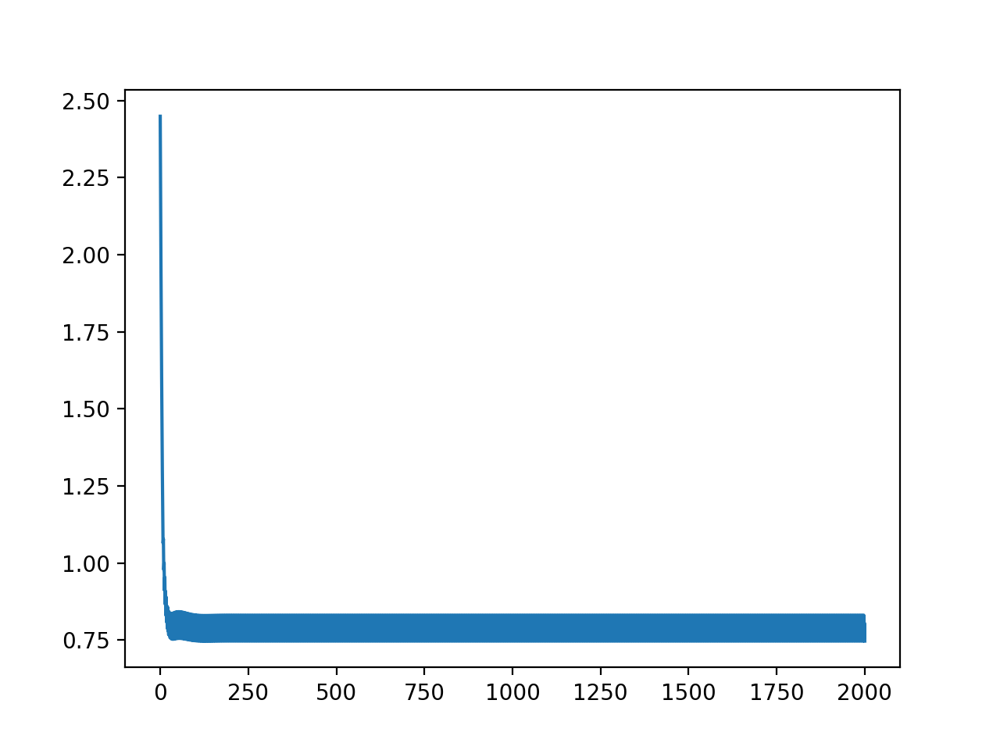

In [604]:
plt.figure()
plt.plot(YY[ix,istim,-1,:,iy])

In [1960]:
Wmy[2,1],Wmy[1,2]

(-2.144034644009146, -0.5218867289146812)

<IPython.core.display.Javascript object>


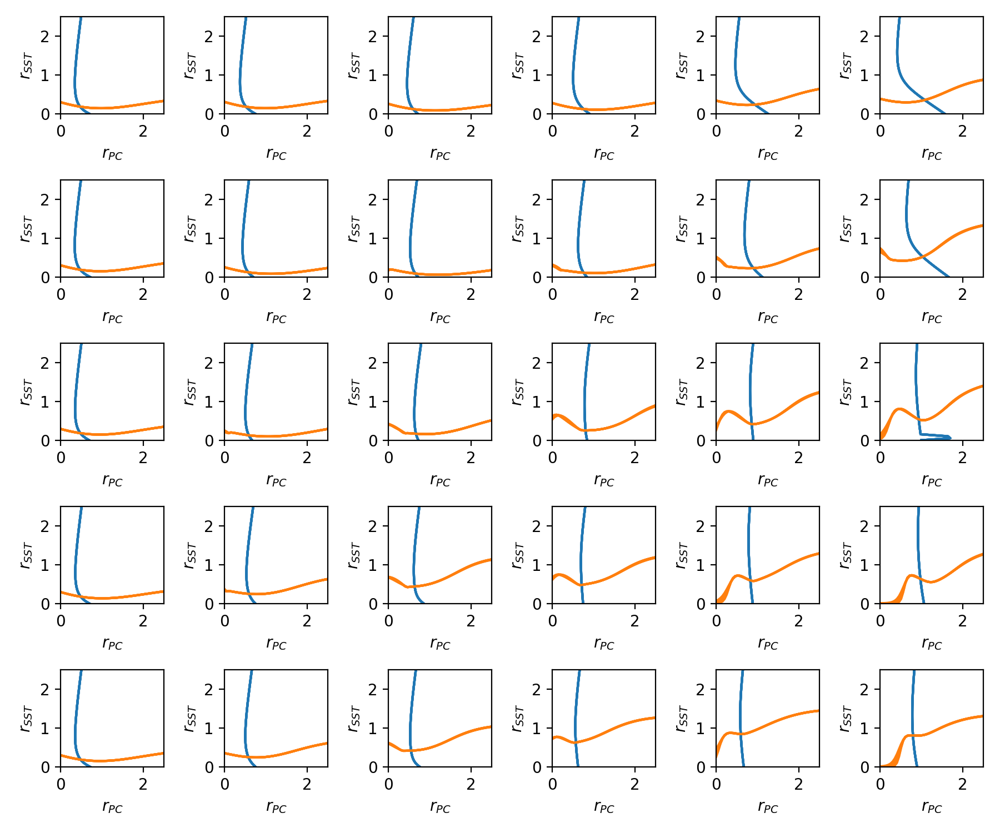

In [1986]:
mag = 1.5
plt.figure(figsize=(ncontrast*mag,nsize*mag))
# YY = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
ix = 0
iy = 1
for yy in [YY_ss]:#,YY_F2]:
    linestyles = ['solid','dashed']
    for istim in range(Nstim):
        plt.subplot(nsize,ncontrast,stim_vals[istim]+1)
        for it in np.arange(-1001,0,200):
            xvals = yy[iy,istim,:,it,ix]
            gd = xvals < max_val
            plt.plot(xvals[gd],yvals[gd],label='$dr_{PC}/dt=0$',c='C0',linestyle=linestyles[idir])
            xvals = yy[ix,istim,:,it,iy]
            gd = xvals < max_val
            plt.plot(yvals[gd],xvals[gd],label='$dr_{SST}/dt=0$',c='C1',linestyle=linestyles[idir])
    #     plt.legend()
        plt.xlabel('$r_{%s}$' % lbls[ix])
        plt.ylabel('$r_{%s}$' % lbls[iy])
#         plt.axis('equal')
        plt.ylim((0,1*max_val))
        plt.xlim((0,1*max_val))
    plt.tight_layout()

In [2101]:
nstar = len(trystars_i)
Niter = int(3e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
#     ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    YY_ctrl = compute_steady_state(Wstar_dict['as_list'],Niter=int(5e2),dt=1e-1,perturbation_size=5e-2,max_val=None,Ny=None,fix_dim=None,stim_vals=None)

0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


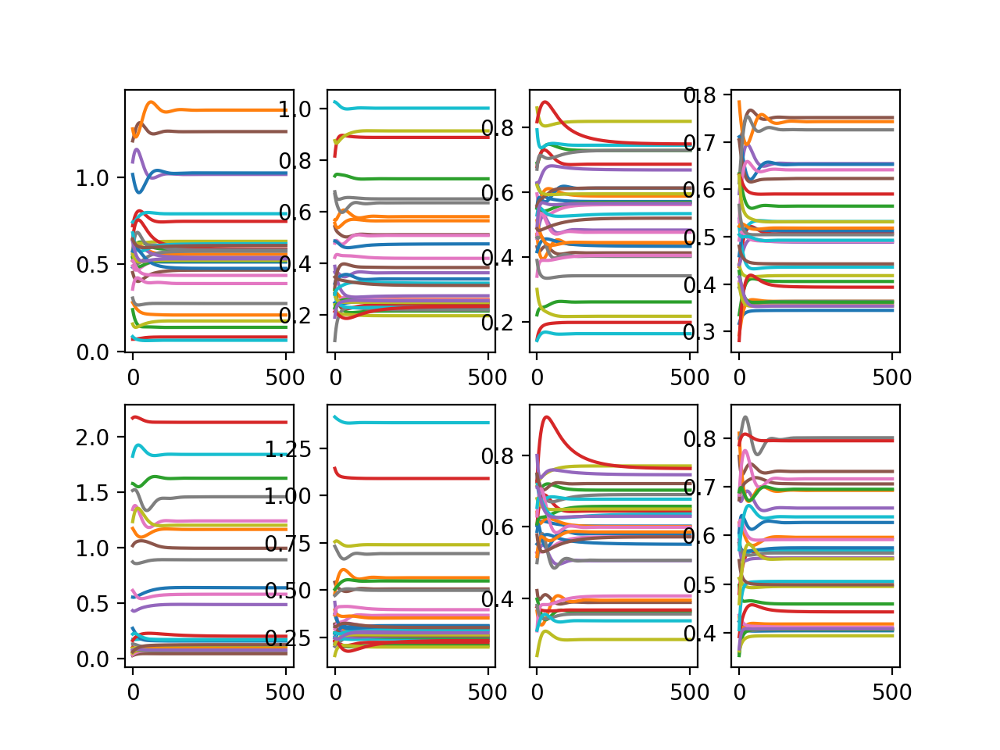

In [2104]:
plt.figure()
for icelltype in range(8):
    plt.subplot(2,4,icelltype+1)
    plt.plot(YY_ctrl[:,:,icelltype].T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


<IPython.core.display.Javascript object>


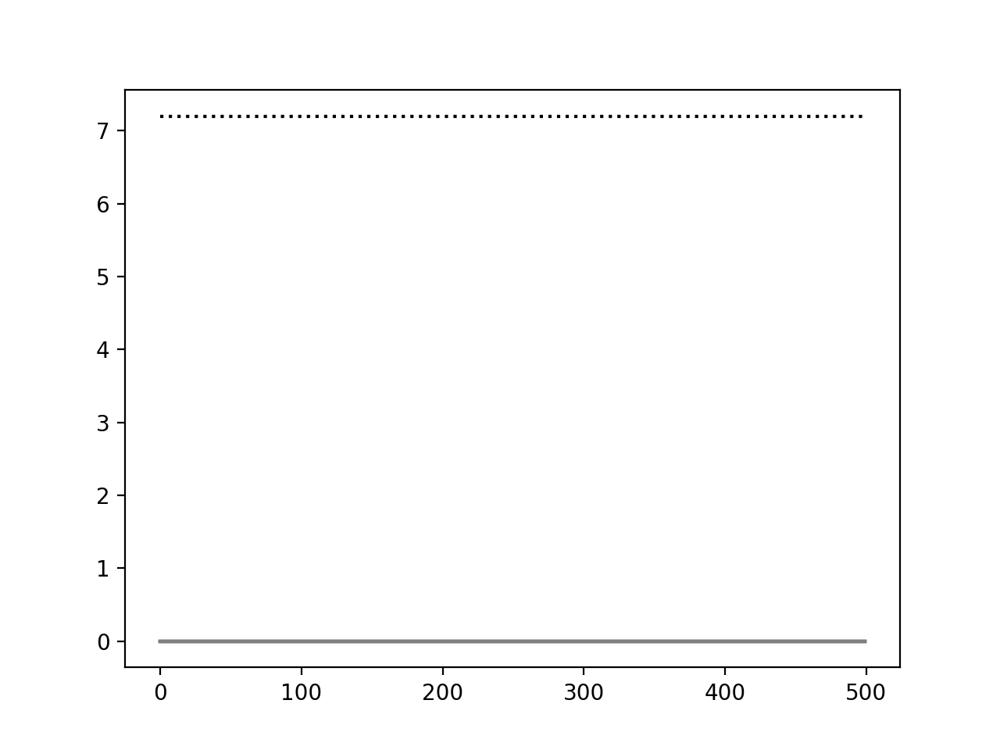

In [2105]:
istim = 29
iy = 0
others = np.arange(8)!=iy
# this_yy = YY_F2[iy,istim,:,iinit,:,:]
this_yy = YY_ss[iy,istim,:,:,:]
def fY(XX,YY):
    return compute_f_(resEta[istim]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[istim]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
speed = np.sum(np.abs(fY(XX[istim],this_yy)-this_yy)[:,:,others],-1)
plt.figure()
this_one = 25
plt.plot(speed[this_one,-500:].T,c='k',linestyle='dotted')
plt.plot(YY_ss[iy,istim,this_one,-500:,:])

In [1414]:
fY(XX[istim],this_yy).shape

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: overflow encountered in square
  


(50, 4001, 8)

<IPython.core.display.Javascript object>


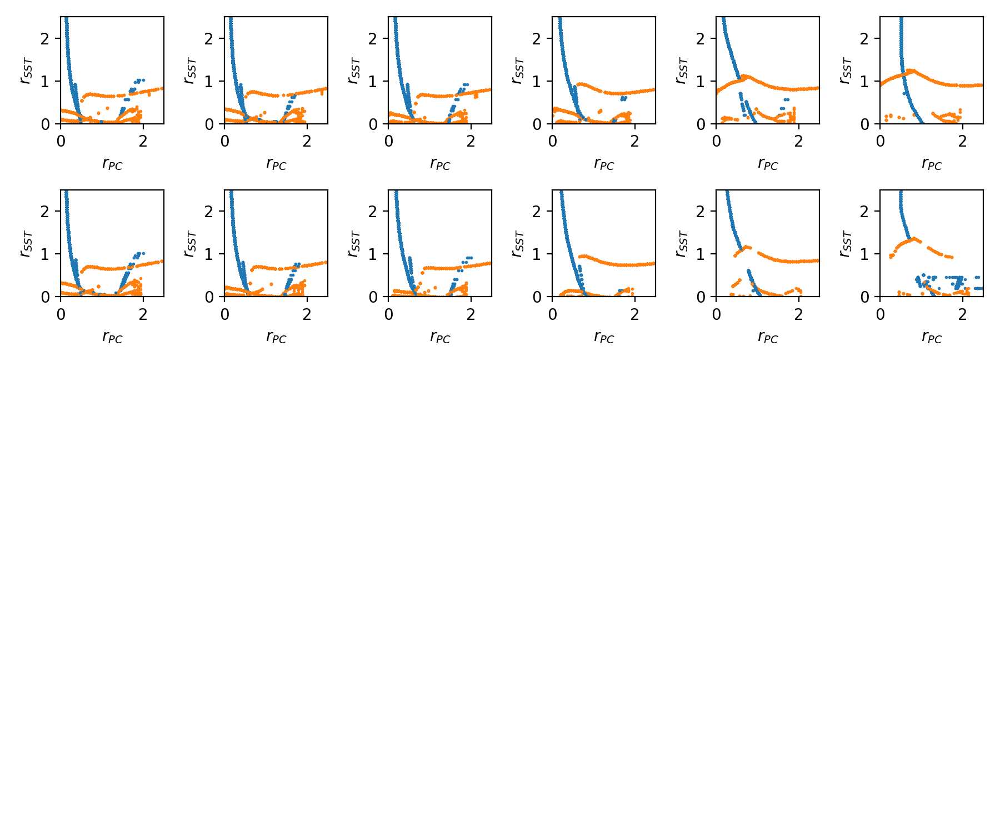

In [1399]:
mag = 1.5
plt.figure(figsize=(ncontrast*mag,nsize*mag))
# YY = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
ix = 0
iy = 1
idir = 0
for yy in [YY_F2]:
    linestyles = ['solid','dashed']
    for istim in range(12):#Nstim):
        def fY(YY):
            return compute_f_(resEta[stim_vals[istim]]+u_fn(XX[stim_vals[istim]],YY,Wmx,Wmy,k,kappa),resXi[stim_vals[istim]]+u_fn(XX[stim_vals[istim]],YY,Wsx,Wsy,k,kappa),s02)
        plt.subplot(nsize,ncontrast,stim_vals[istim]+1)
        for it in (-250,-100,-1):
            for iinit in range(Nx):
                this_yy = yy[iy,istim,:,iinit,it,:]
                xvals = yy[iy,istim,:,iinit,it,ix]
                gd = (xvals < max_val) & np.sum(np.abs(fY(this_yy)-this_yy),-1)<1e-4
                plt.scatter(xvals[gd],yvals[gd],label='$dr_{PC}/dt=0$',c='C0',linestyle=linestyles[idir],s=1)
                xvals = yy[ix,istim,:,iinit,it,iy]
                gd = xvals < max_val
                plt.scatter(yvals[gd],xvals[gd],label='$dr_{SST}/dt=0$',c='C1',linestyle=linestyles[idir],s=1)
    #     plt.legend()
        plt.xlabel('$r_{%s}$' % lbls[ix])
        plt.ylabel('$r_{%s}$' % lbls[iy])
#         plt.axis('equal')
        plt.ylim((0,1*max_val))
        plt.xlim((0,1*max_val))
    plt.tight_layout()

<IPython.core.display.Javascript object>


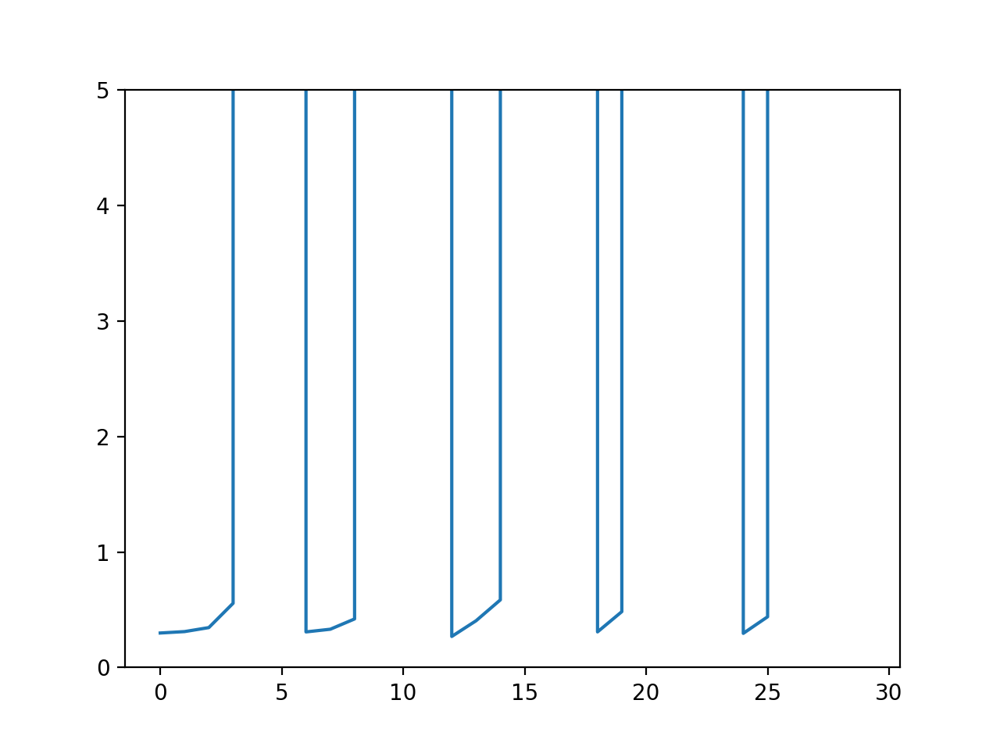

(0, 5)

In [873]:
plt.figure()
plt.plot(YY[iy,:,0,it,ix])
plt.ylim((0,5))

<IPython.core.display.Javascript object>


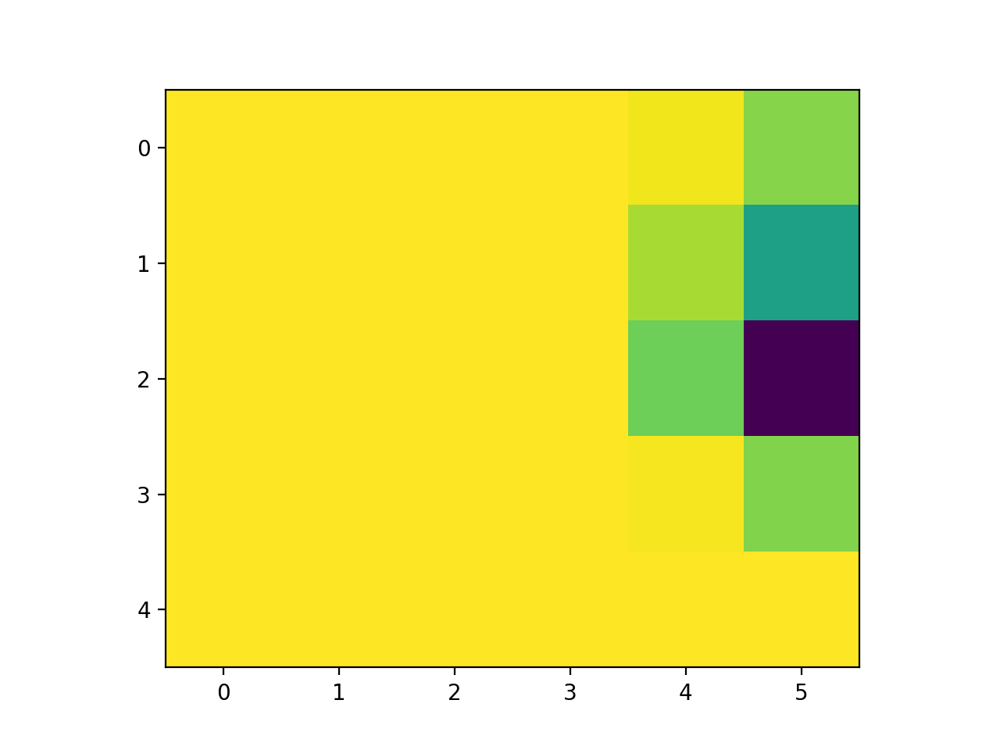

In [464]:
plt.figure()
istim = -12
plt.imshow((YY[0][:,1000,0]-YY[0][:,-1,0]).reshape((nsize,ncontrast)))

In [424]:
YY[0].shape

(30, 2001, 8)

<IPython.core.display.Javascript object>


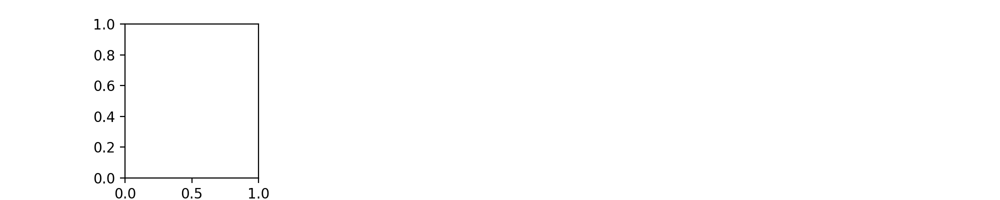

IndexError: too many indices for array

In [1268]:
mag = 2
plt.figure(figsize=(mag*ncelltypes,mag))
for icelltype in range(nQ):
    plt.subplot(1,ncelltypes,icelltype+1)
    plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
    plt.axis('off')

In [1278]:
nstar = len(trystars_i)
YY_no_vip = [None for istar in range(nstar)]
YY_no_sst = [None for istar in range(nstar)]
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    YY = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,YY,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,YY,Wsx,Wsy,k,kappa)
    def fY(XX,YY,resEta,resXi):
        return compute_f_(u_fn(XX,YY,Wmx,Wmy,k,kappa)+resEta,u_fn(XX,YY,Wsx,Wsy,k,kappa)+resXi,s02)
    def thisfY(YY0):
        return fY(XX,YY0,resEta,resXi)
    def predict_YY_silencing(YY0,XX,resEta,resXi,silenced,eta=1e-4):
        def dYYdt(YY):
            return -YY + thisfY(YY)
        YY = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.ones_like(YY)
        iiter = 0
        while iiter < 1e4: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            iiter = iiter+1
            dYY = eta*dYYdt(YY)
            YY = YY + dYY
            YY[:,silenced] = 0
        return YY
    silenced = np.array((0,0,1,0,0,0,1,0),dtype='bool')
    YY_no_vip[istar] = predict_YY_silencing(YY,XX,resEta,resXi,silenced)
    silenced = np.array((0,1,0,0,0,1,0,0),dtype='bool')
    YY_no_sst[istar] = predict_YY_silencing(YY,XX,resEta,resXi,silenced)

0


In [1224]:
# plt.figure()
# inputs = XXhat[:,[0,2]]
# sort_inp = np.argsort(inputs[:,0])
# plt.scatter(inputs[:,0],inputs[:,1])

<IPython.core.display.Javascript object>


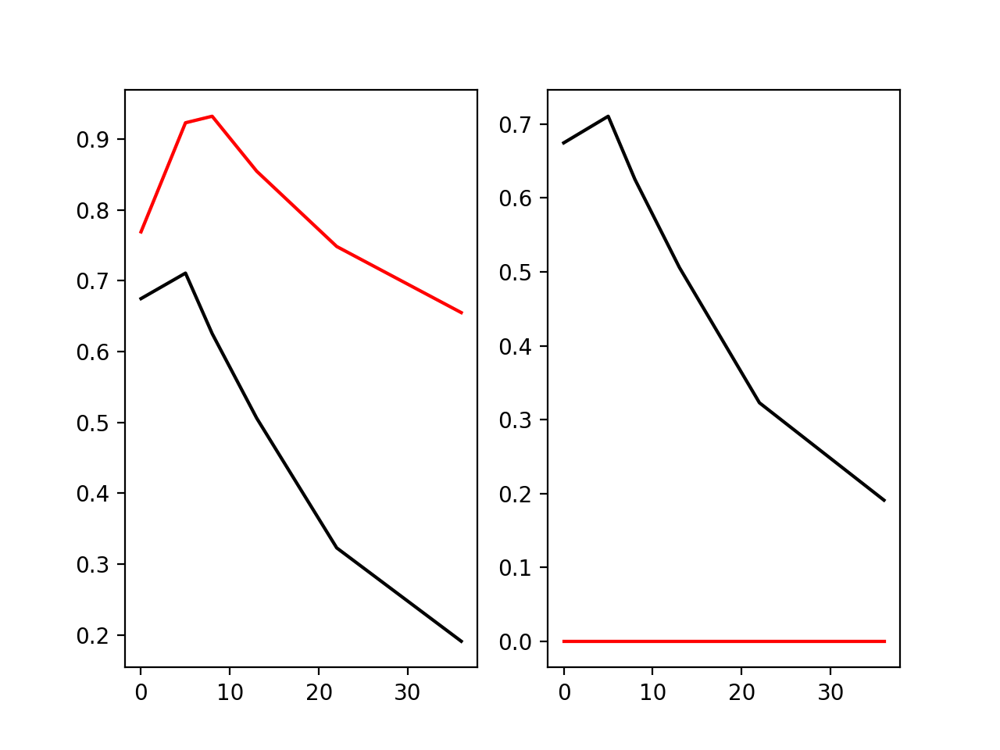

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


In [1270]:
plt.figure()
alpha1 = 0.25
ic = 2
icontrast = 5
colors = ['k','r']
def norm01(arr):
    return (arr-arr.min())/(arr.max()-arr.min())
for istar in range(nstar):
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    YY = compute_f_(Eta,Xi,s02)
    plt.subplot(1,2,1)
    usize0 = (0,5,8,13,22,36)
    sc = YY[:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    if istar == 0:
        avg_curves = np.zeros((2,2,)+to_plot.shape)
    avg_curves[0,0] = avg_curves[0,0] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[0],alpha=alpha1)
    sc = YY_no_sst[istar][:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[0,1] = avg_curves[0,1] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[1],alpha=alpha1)
    plt.subplot(1,2,2)
    usize0 = (0,5,8,13,22,36)
    sc = YY[:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[1,0] = avg_curves[1,0] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[0],alpha=alpha1)
    sc = YY_no_vip[istar][:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[1,1] = avg_curves[1,1] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[1],alpha=alpha1)
for imanip in range(2):
    plt.subplot(1,2,imanip+1)
    plt.plot(usize0,avg_curves[imanip,0],c=colors[0])
    plt.plot(usize0,avg_curves[imanip,1],c=colors[1])
    

<IPython.core.display.Javascript object>


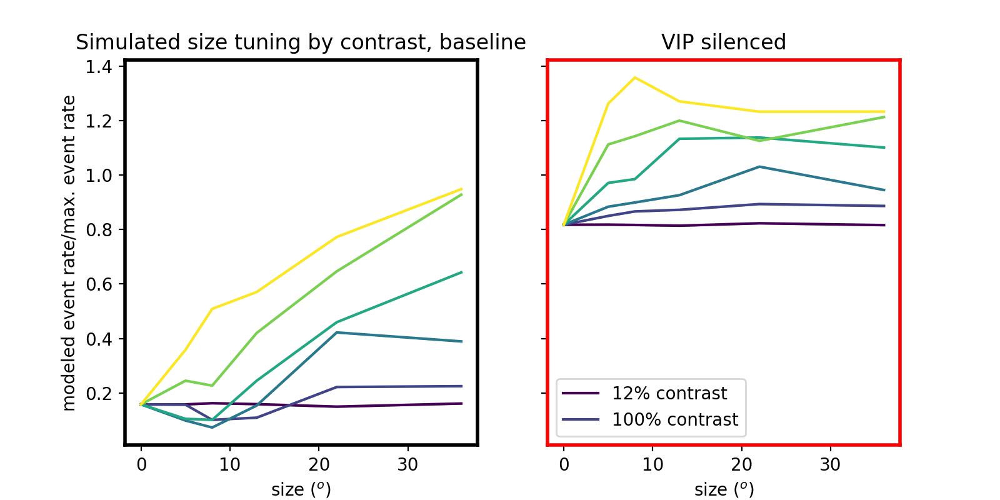

In [1281]:
fig,axes = plt.subplots(1,2,sharey=True,figsize=(8,4))
alpha1 = 0.25
ic = 1
icontrasts = np.arange(6)
colors = ['k','r']
colors = plt.cm.viridis(np.linspace(0,1,6))
nstar = 1
def norm01(arr):
    return (arr-arr.min())/(arr.max()-arr.min())
for icontrast in icontrasts:
    for istar in range(nstar):
        ti,tj = trystars_i[istar],trystars_j[istar]
        Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
        YY = compute_f_(Eta,Xi,s02)
        usize0 = (0,5,8,13,22,36)
        sc = YY[:,ic].reshape((nsize,ncontrast))
        to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
        if istar == 0:
            avg_curves = np.zeros((2,2,)+to_plot.shape)
            to_plots = [np.zeros((0,)+to_plot.shape) for il in range(2)]
        avg_curves[1,0] = avg_curves[1,0] + to_plot/nstar
#         plt.subplot(1,2,1)
        to_plots[0] = np.concatenate((to_plots[0],to_plot[np.newaxis]))
#         plt.plot(usize0,to_plot,c=colors[icontrast],alpha=alpha1)
        sc = YY_no_vip[istar][:,ic].reshape((nsize,ncontrast))
        to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
        avg_curves[1,1] = avg_curves[1,1] + to_plot/nstar
#         plt.subplot(1,2,2)
#         plt.plot(usize0,to_plot,c=colors[icontrast],alpha=alpha1)
        to_plots[1] = np.concatenate((to_plots[1],to_plot[np.newaxis]))
    for il in range(2):
#         plt.subplot(1,2,il+1)
        axes[il].plot(usize0,avg_curves[1,il],c=colors[icontrast])
        lb,ub = ut.bootstrap(to_plots[il],pct=(16,84),fn=np.nanmean,axis=0)
        axes[il].fill_between(usize0,lb,ub,color=colors[icontrast],alpha=alpha1)
# plt.subplot(1,2,1)
# plt.title('Center-aligned, response to 12% contrast')
# plt.subplot(1,2,1)
axes[0].set_ylabel('modeled event rate/max. event rate')
axes[0].set_xlabel('size ($^o$)')
axes[1].set_xlabel('size ($^o$)')
plt.setp(axes[0].spines.values(),color='k',linewidth=2)
plt.setp(axes[1].spines.values(),color='r',linewidth=2)
axes[0].set_title('Simulated size tuning by contrast, baseline')
axes[1].set_title('VIP silenced')
axes[1].legend(['12% contrast','100% contrast'])
# plt.savefig('figures/modeled_vip_halo_size_tuning_by_contrast_fill_between.jpg',dpi=300)

In [428]:
(ti,),(tj,) = np.where(loss==np.min(loss)) #2*loss.min()
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = Wt[ti][tj]

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


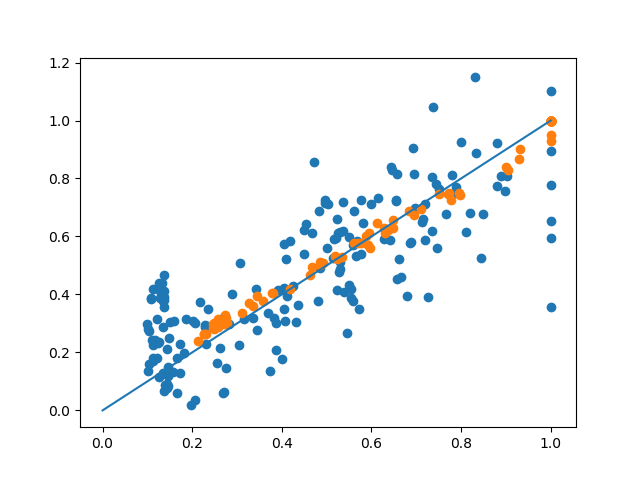

In [429]:
plt.figure()
XXhat = np.concatenate(Xhat,axis=1)
YYhat = np.concatenate(Yhat,axis=1)
plt.scatter(YYhat.flatten(),YY.flatten())
plt.scatter(XXhat.flatten(),XX.flatten())
plt.plot((0,1),(0,1))

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


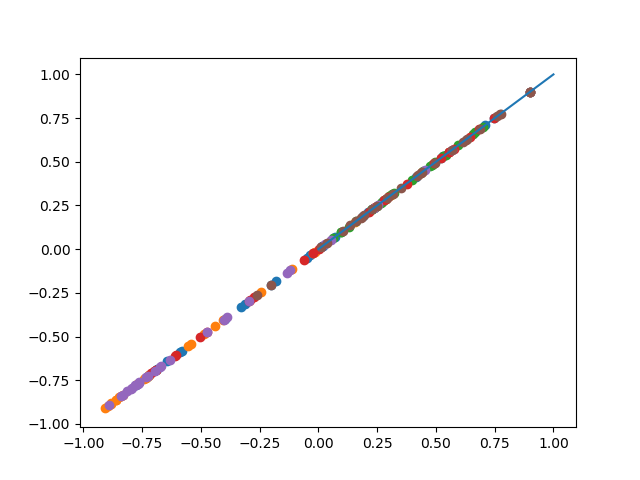

In [430]:
Etas = u_fn(XX,YY,Wmx,Wmy,k,kappa)
plt.figure()
for ic in range(6):
    plt.scatter(Eta[:,ic],Etas[:,ic])
plt.plot((0,1),(0,1))

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


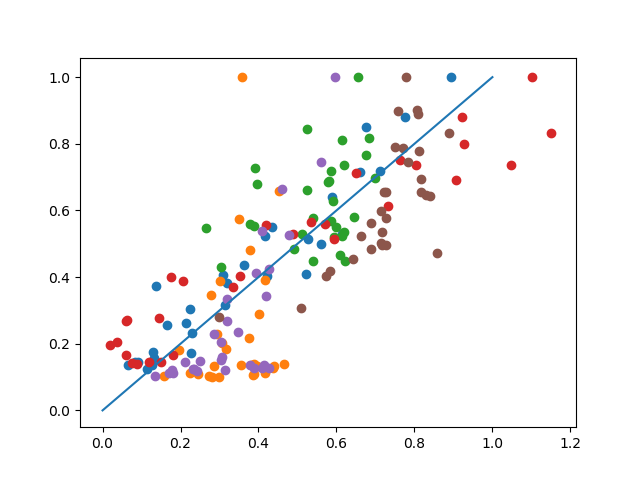

In [431]:
plt.figure()
YYs = compute_f_(Eta,Xi,s02)
for ic in range(6):
    plt.scatter(YY[:,ic],YYs[:,ic])
plt.plot((0,1),(0,1))

<IPython.core.display.Javascript object>


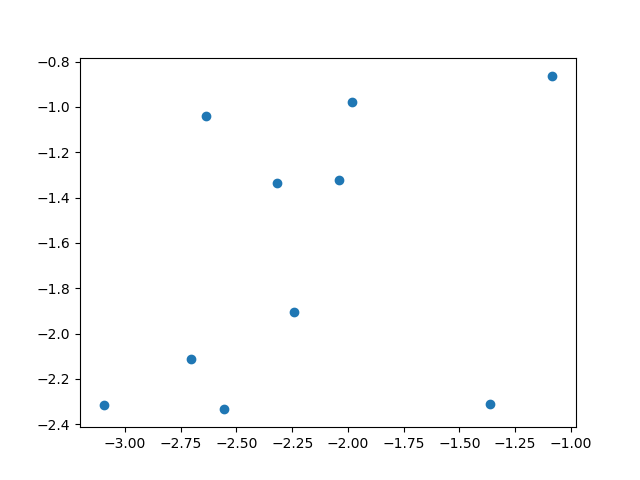

In [291]:
plt.figure()
plt.scatter(wmys[:,1,0],wmys[:,2,1])

In [514]:
wmys = np.concatenate([w[1][np.newaxis] for w in np.concatenate(Wt)],axis=0)
# trystar = np.argmax(wmys[:,1,0]*wmys[:,2,1])
# trystar = np.argmin(loss)

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


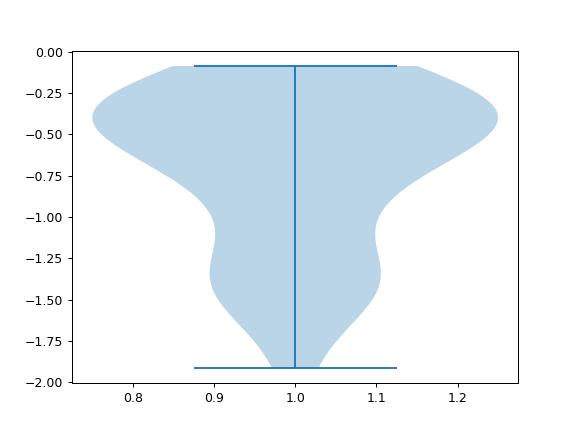

{'bodies': [<matplotlib.collections.PolyCollection at 0x7f1bdc083a90>],
 'cmaxes': <matplotlib.collections.LineCollection at 0x7f1bdb9cec50>,
 'cmins': <matplotlib.collections.LineCollection at 0x7f1bdc083790>,
 'cbars': <matplotlib.collections.LineCollection at 0x7f1bdc083990>}

In [516]:
plt.figure()
plt.violinplot(wmys[:,1,0])

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


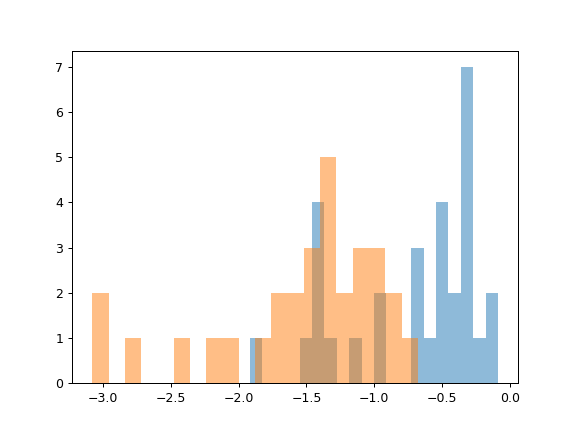

(array([2., 0., 1., 0., 0., 1., 0., 1., 1., 0., 1., 2., 2., 3., 5., 2., 3.,
        3., 2., 1.]),
 array([-3.08046601, -2.96038626, -2.84030651, -2.72022677, -2.60014702,
        -2.48006727, -2.35998753, -2.23990778, -2.11982804, -1.99974829,
        -1.87966854, -1.7595888 , -1.63950905, -1.51942931, -1.39934956,
        -1.27926981, -1.15919007, -1.03911032, -0.91903057, -0.79895083,
        -0.67887108]),
 <a list of 20 Patch objects>)

In [515]:
plt.figure()
plt.hist(wmys[:,1,0],bins=20,alpha=0.5)
plt.hist(wmys[:,2,1],bins=20,alpha=0.5)

In [518]:
ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws

In [541]:
ws = [np.concatenate([Wt[ti][tj][q][np.newaxis] for ti,tj in zip(trystars_i,trystars_j)],axis=0) for q in range(len(Wt[0][0]))]
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


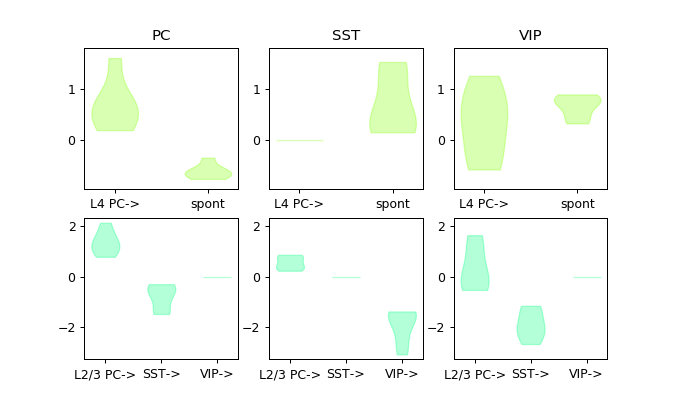

In [552]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(7.5,4.5))
for datas in [[Wmx,Wmy]]:#,[Wsx,Wsy]]:
    titles = ['PC','SST','VIP']
    data = datas[0]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L4 PC->','spont']
    for icelltype in range(3):
        plt.subplot(2,3,icelltype+1)
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.5,1,0.0])
            pc.set_edgecolor([0.5,1,0.0])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
        plt.title(titles[icelltype])
#     plt.figure(figsize=(7.5,2))
    data = datas[1]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC->','SST->','VIP->']
    for icelltype in range(3):
        plt.subplot(2,3,3+icelltype+1)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.0,1,0.5])
            pc.set_edgecolor([0.0,1,0.5])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
#         plt.title(titles[icelltype])
plt.savefig('violinplots_fit_weights.jpg',dpi=300)

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


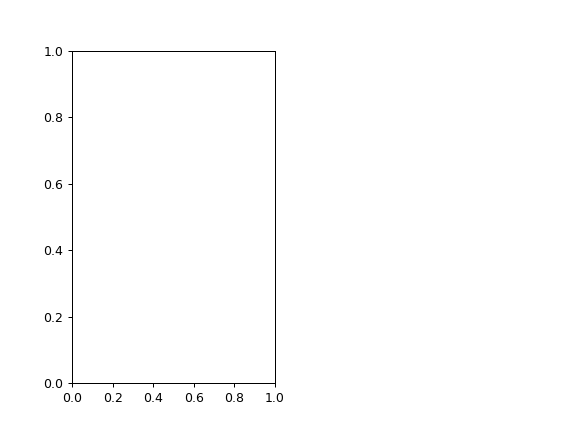

TypeError: list indices must be integers or slices, not tuple

In [543]:
plt.figure()
plt.subplot(1,2,1)
for ic in (0,):
    sca.scatter_size_contrast(YY[:,ic],YY_no_vip[:,ic])
    plt.plot((0,1),(0,1),c='k')
plt.axis('equal')
plt.subplot(1,2,2)
for ic in (0,):
    sca.scatter_size_contrast(YY[:,ic],YY_no_sst[:,ic])
    plt.plot((0,1),(0,1),c='k')
plt.axis('equal')

<IPython.core.display.Javascript object>


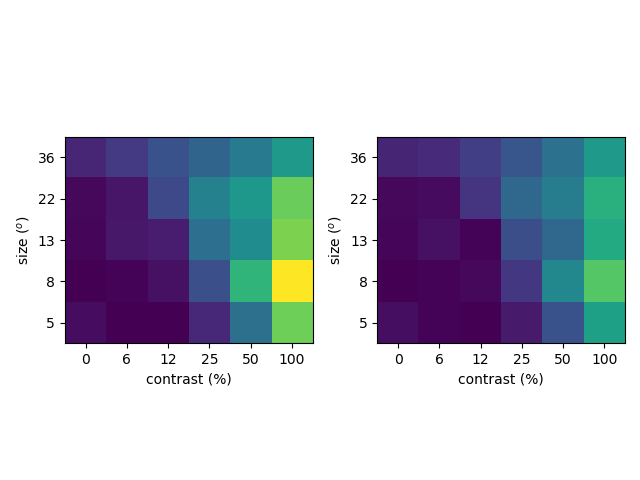

In [327]:
plt.figure()
ic = 0
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=YY[:,ic].max())
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_vip[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=YY[:,ic].max())
plt.tight_layout()

<IPython.core.display.Javascript object>


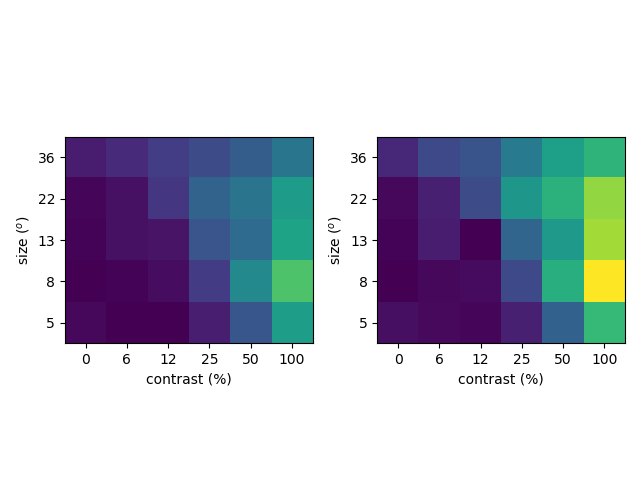

In [330]:
plt.figure()
ic = 0
mx = np.maximum(YY[:,ic].max(),YY_no_sst[:,ic].max())
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=mx)
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_sst[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=mx)
plt.tight_layout()

<IPython.core.display.Javascript object>


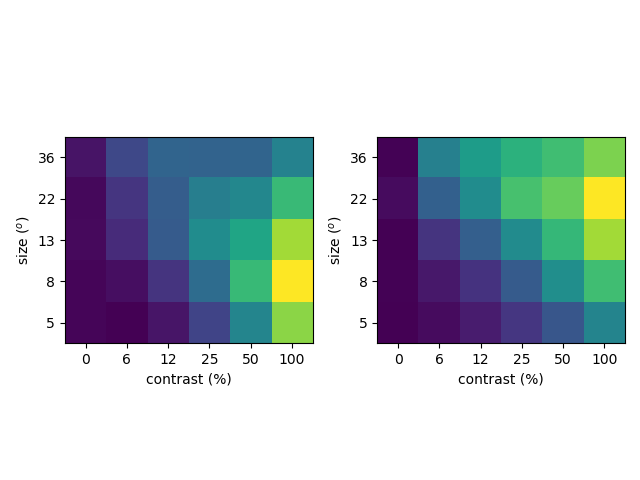

<IPython.core.display.Javascript object>


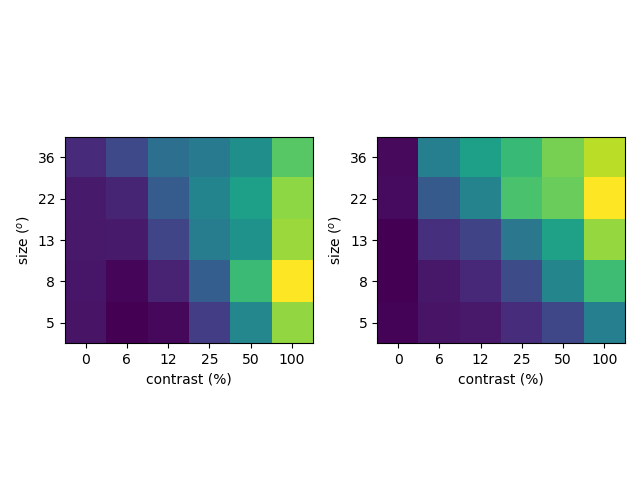

<IPython.core.display.Javascript object>


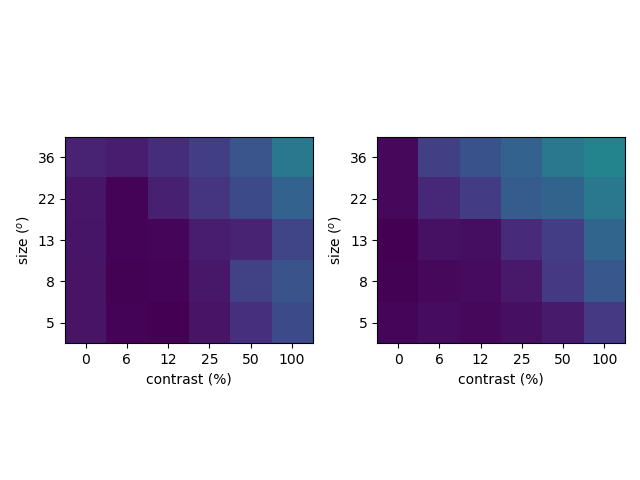

In [296]:
plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YYhat[:,0].reshape((5,6)),flipud=True)
plt.subplot(1,2,2)
sca.show_size_contrast(YYhat[:,3].reshape((5,6)),flipud=True)
plt.tight_layout()

plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,0].reshape((5,6)),flipud=True)
plt.subplot(1,2,2)
sca.show_size_contrast(YY[:,3].reshape((5,6)),flipud=True)
plt.tight_layout()

plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YY_no_vip[:,0].reshape((5,6)),flipud=True,vmax=YY[:,0].max())
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_vip[:,3].reshape((5,6)),flipud=True,vmax=YY[:,3].max())
plt.tight_layout()

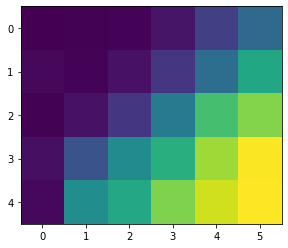

In [382]:
plt.figure()
plt.imshow(XX[:,2].reshape((5,6)))

In [383]:
vip_silencing = np.array((1,1,0,1,1,0))[np.newaxis,:]
Etas = u_fn(XX,YY,Wmx,Wmy,k)
Eta_no_vip = u_fn(XX,vip_silencing*YY,Wmx,Wmy,k) + Eta - Etas
YY_no_vip = compute_f_(Eta_no_vip,Xi,s02)*vip_silencing

In [ ]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [ ]:
evaluate_stability(W0my,k0)

In [ ]:
t = 999
W0mx,W0my,W0sx,W0sy,s020,k0 = [Wstar_t2[i][t].copy() for i in range(6)]

In [ ]:
nbeta = 51
loss = np.zeros((nbeta,))
stability = np.zeros((nbeta,))
betas = np.linspace(-1,1,nbeta)
vecY = np.random.randn(nQ,nQ)
vecX = np.random.randn(nP,nQ)
for ibeta,beta in enumerate(betas):
    perturbationY = beta*vecY
    perturbationX = beta*vecX
#     perturbationY = beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
#     perturbationX = beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
#     perturbationSY = 0*beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
    Wmy_beta = perturbationY+W0my.copy()
    Wmx_beta = perturbationX+W0mx.copy()
#     Wsy_beta = perturbationSY+W0sy.copy()
    loss[ibeta] = evaluate_LW(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=Wmx_beta,W0my=Wmy_beta,W0sx=W0sx.copy(),W0sy=W0sy,s020=s020.copy(),k0=k0.copy(),bounds=bounds,weight=weight)
    stability[ibeta] = evaluate_stability(Wmy_beta,k0)

In [ ]:
plt.figure()
lkat = stability < 0
plt.plot(betas[lkat],loss[lkat])
plt.plot(betas[lkat],stability[lkat])
plt.ylim(-1,0.5)

In [ ]:
(betas[lkat][np.argmin(loss[lkat])],np.min(loss[lkat]))

In [ ]:
beta_star = betas[lkat][np.argmin(loss[lkat])]

In [ ]:
niter = int(1e3)
eta = 0.3
gamma = 0.9
weight = np.array((0,1,0))
beta = 0
perturbationY = beta*beta_star*vecY*1e-2
perturbationX = beta*beta_star*vecX*1e-2
# perturbationY = 0*beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
# perturbationX = 0*beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
# # perturbationSY = beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
# thisY0 = np.ones_like(Y0)
Y0 = [np.concatenate([x.mean(0)[:,np.newaxis] for x in Yhat[ialign]],axis=1) for ialign in range(npixels)]
Wstar_t2 = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=perturbationX+W0mx.copy(),W0my=perturbationY+W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),k0=k0.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma,barrier_wt=100e-4)#,eta_decay=eta_decay)

In [ ]:
np.linalg.eig(Wstar_dict2['Wmy'][400]-np.eye(nQ))

In [ ]:
titles = ['PC','SST','VIP']
t = 500
plt.figure(figsize=(6,2))
lbl = 'Wmx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wmy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])
    
plt.figure(figsize=(6,2))
lbl = 'Wsx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wsy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])


In [ ]:
#Wstar_dict = np.load('w_over_time_miller_troyer_data_loss.npy',allow_pickle=True)[()]

In [ ]:
Wstar_t_init = [ww[-1].copy() for ww in Wstar_t2]
W0mx,W0my,W0sx,W0sy,s020 = [Wstar_t_init[i].copy() for i in range(5)]
Y0 = Wstar_t_init[-3].copy()

In [ ]:
niter = int(1e4)
eta = 1
gamma = 0.9
eta_decay = 1e-3
weight = np.array((1,1,1))
thisY0 = np.ones_like(Y0)
Wstar_t_novar = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=thisY0,W0mx=W0mx.copy(),W0my=W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma)#,eta_decay=eta_decay)

In [ ]:
# niter = int(1e3)
plt.figure()
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.plot(Wstar_t2[i].reshape((niter+1,-1)))
plt.figure()
plt.plot(Wstar_t2[4].reshape((niter+1,-1)))

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
# Wstar_dict = {}
# for i,label in enumerate(labels):
#     Wstar_dict[label] = Wstar_t[i]
# np.save('w_over_time_miller_troyer_data_loss.npy',Wstar_dict,allow_pickle=True)

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
#Wstar_dict = {}
#for i,label in enumerate(labels):
#    Wstar_dict[label] = Wstar_t[i]


In [ ]:
def plot_tuning_and_loss(this_Wstar):
    plt.figure()
    plt.plot((this_Wstar[-3]/this_Wstar[-3].sum(1)[:,np.newaxis]).reshape((niter+1,-1)))
    plt.figure()
    plt.plot(this_Wstar[-1].reshape((niter+1,-1)))

In [ ]:
#niter = 300
plot_tuning_and_loss([x[:niter+1] for x in Wstar_t2])

In [ ]:
def scatter_results_spatial(this_Wstar,t=-1):
    plt.figure(figsize=(9,6))
    celltype = ['PC','SST','VIP']
    ialign = 0
    for ialign in range(2):
        for i in range(3):
            plt.subplot(2,3,3*ialign+i+1)
            plt.title(celltype[i])
            xx = Yhat[ialign][i].mean(0)/Yhat[ialign][i].mean(0).sum()
            yy = this_Wstar[-3][t,:,3*ialign+i]/this_Wstar[-3][t,:,3*ialign+i].sum()
            sca.scatter_size_contrast(xx,yy)
            plt.plot((0,xx.max()),(0,xx.max()),c='k')
            plt.xlabel('measured')
            plt.ylabel('modeled')
            plt.tight_layout()

In [ ]:
t = 500
scatter_results_spatial(Wstar_t2,t=t) #int(5e3))
# plt.savefig('figures/pc_sst_vip_measured_modeled_miller_troyer.pdf')

In [ ]:
def gaussian_fn(mu,sigma):
    return lambda x: 1/np.sqrt(2*np.pi)/np.abs(sigma)*np.exp(-0.5*(x-mu)/sigma**2)
xs = np.linspace(0,1,100)
ipt = 0
# plt.figure()
# for icelltype in range(2):
#     plt.plot(xs,gaussian_fn(um_fn(X[ipt],Y[ipt])[icelltype],us_fn(X[ipt],Y[ipt])[icelltype])(xs))

In [224]:
iiter = -1
Wmx,Wmy,Wsx,Wsy = [Wstar_t[i][iiter] for i in range(4)]

def fXY(x,y):
    return f_miller_troyer(x @ Wmx + y @ Wmy, x @ Wsx + y @ Wsy)

def u_fn_fn(Wx,Wy):
    return lambda x,y: x @ Wx + y @ Wy

def um_fn(x,y):
    return u_fn_fn(Wmy,Wmx)(x,y)

def us_fn(x,y):
    return u_fn_fn(Wsy,Wsx)(x,y)

# Ysolns = compute_Y_nonlinear_t_evolution(X,Wmx,Wmy,Wsx,Wsy,f_miller_troyer,Y0=Wstar_t[-2][iiter+1].copy())

NameError: name 'Wstar_t' is not defined

In [327]:
Xlbl = [['L4','spont'],['PC','SST','VIP']]
Ylbl = ['PC','SST','VIP']

In [283]:
for i in range(2):
    values0 = np.round(Wstar_t_novar[i][-1],decimals=2)
    values1 = np.round(Wstar_t_novar[i+2][-1],decimals=2)
    to_print = np.zeros_like(values0,dtype='<U32')
    if np.mod(i,2)==0:
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Xlbl[0][i] + ' -> ' + Xlbl[1][j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    else: 
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Ylbl[i] + ' -> ' + Ylbl[j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    print(to_print)
    print('\n')
# for i in range(4,5):
#     values = np.round(Wstar_t[i][-1],decimals=2)
#     print(values)

NameError: name 'Wstar_t_novar' is not defined

<IPython.core.display.Javascript object>


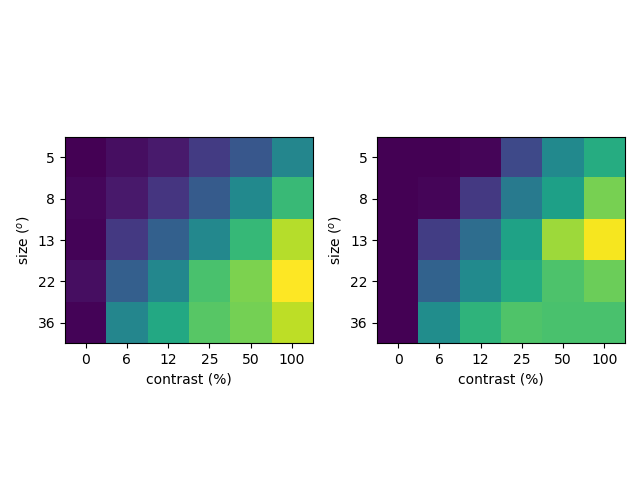

<IPython.core.display.Javascript object>


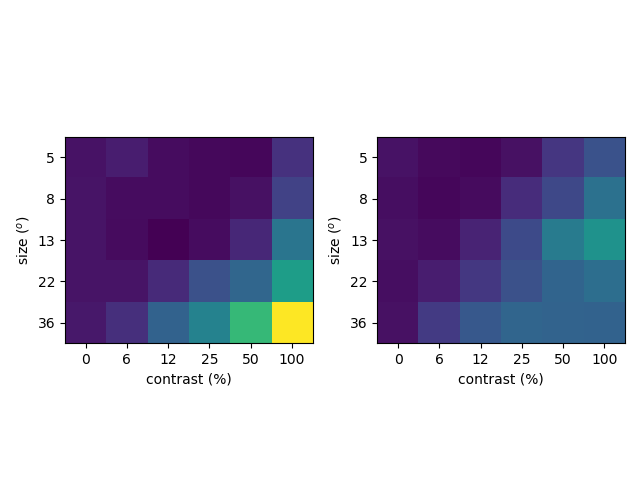

<IPython.core.display.Javascript object>


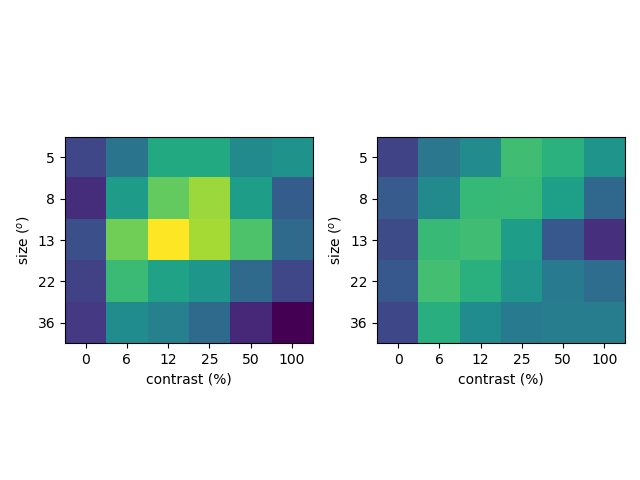

In [541]:
#lbl = ['pc','sst','vip']
#for icelltype in range(3):
#    this_Wstar = Wstar_t_novar
#    t = -1
#    display_model_fit(Yhat[icelltype].mean(0)/Yhat[icelltype].mean(0).sum(),this_Wstar[-3][t,:,icelltype]/this_Wstar[-3][t,:,icelltype].sum())
#    plt.savefig('figures/' + lbl[icelltype] + '_measured_modeled.pdf')

In [585]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [586]:
np.save('w_over_time_miller_troyer_data_loss_momentum.npy',Wstar_dict,allow_pickle=True)

In [270]:
def scatter_results(this_Wstar,t=-1):
    plt.figure(figsize=(9,3))
    celltype = ['PC','SST','VIP']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(celltype[i])
        xx = Yhat[i].mean(0)/Yhat[i].mean(0).sum()
        yy = this_Wstar[-3][t,:,i]/this_Wstar[-3][t,:,i].sum()
        sca.scatter_size_contrast(xx,yy)
        plt.plot((0,xx.max()),(0,xx.max()),c='k')
        plt.xlabel('measured')
        plt.ylabel('modeled')
        plt.tight_layout()

In [1]:
icelltype = 3
u,s,v = np.linalg.svd(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])])
# plt.figure()
# plt.imshow(Rs[1][])

NameError: name 'np' is not defined

<IPython.core.display.Javascript object>


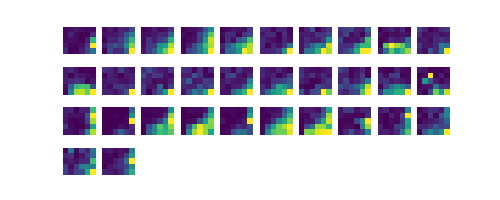

In [500]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


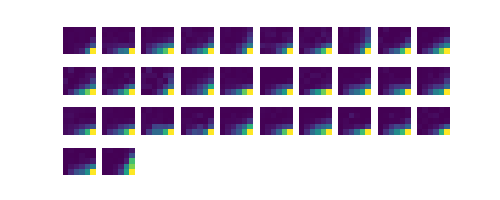

In [501]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]<np.percentile(u[:,0],5))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


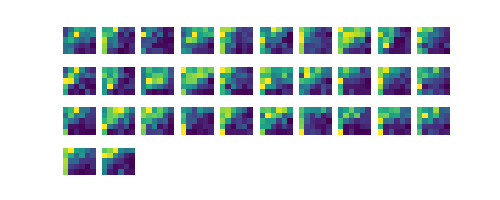

In [502]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


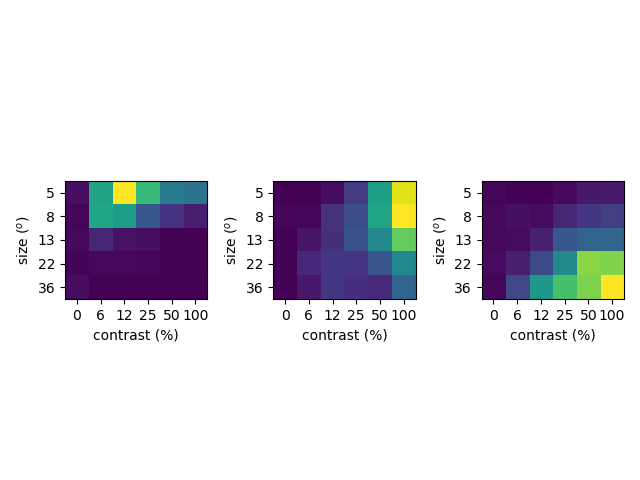

In [508]:
# ut.imshow_in_rows(Rs[1][~np.isnan(Rs[1][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))
lower = np.where(u[:,0]<np.percentile(u[:,0],5))[0][28]
middle = np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))[0][19]
upper = np.where(u[:,0]>np.percentile(u[:,0],95))[0][90]
plt.figure()
for i,thisone in enumerate([upper,middle,lower]):
    plt.subplot(1,3,i+1)
    sca.show_size_contrast(Rs[1][~np.isnan(Rs[1][:,0])][thisone].reshape((5,6)))
plt.tight_layout()
plt.savefig('figures/l23_pc_variability.pdf')

<IPython.core.display.Javascript object>


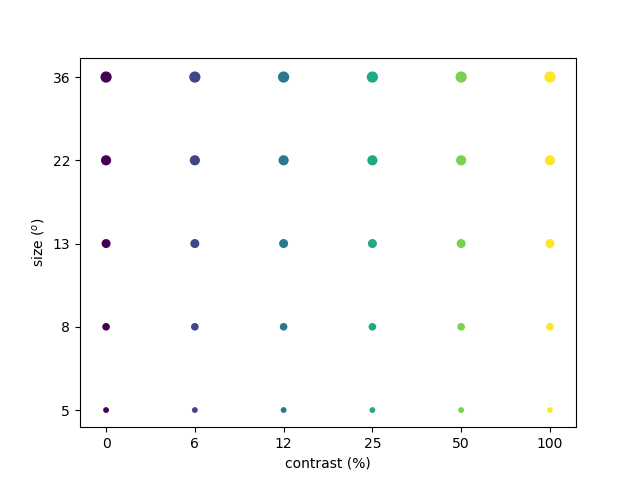

In [519]:
plt.figure()
xx,yy = np.meshgrid(np.arange(6),np.arange(5))
xx = xx.flatten()
yy = yy.flatten()
sca.scatter_size_contrast(xx,yy)
plt.xticks(np.arange(6),(0,6,12,25,50,100))
plt.xlabel('contrast (%)')
plt.yticks(np.arange(5),(5,8,13,22,36))
plt.ylabel('size ($^o$)')
plt.savefig('figures/measured_modeled_legend.pdf')
# plt.axis('off')

In [278]:
#niter = int(1e3)
#Ws = [Wstar_t[i][-1].copy() + 1e-2*np.random.randn(*Wstar_t[i][-1].shape) for i in range(4)]
#Wstar_t2 = fit_W_linearized_pointwise(X.copy(),Yhat.copy(),f_miller_troyer,Y0=Yhat.copy(),W0mx=Ws[0],W0my=Ws[1],W0sx=Ws[2],W0sy=Ws[3],bounds=bounds,niter=niter,weight=np.array((1,10,1)))
#scatter_results(Wstar_t2)

In [308]:
def pca_denoise(arr,Npc):
    u,s,v = np.linalg.svd(arr)
    return u[:,:Npc] @ np.diag(s[:Npc]) @ v[:Npc,:]

In [309]:
Rpc2 = pca_denoise(Rpc[~np.isnan(Rpc.sum(1))],10)

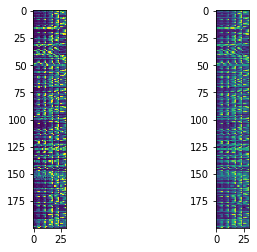

In [312]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(Rpc[:200])
plt.subplot(1,2,2)
plt.imshow(Rpc2[:200])